In [1]:
import numpy as np
import pandas as pd
pd.get_option("display.max_columns")
pd.set_option('display.max_columns', 1000)
pd.get_option("display.max_rows")
pd.set_option('display.max_rows', 1000)

f=open('aaindex1.dat', 'r')

fragI=0
raw=''
ID=''
ID_array=[]
AAall=[[]]

while True:
    data = f.readline()
    data = data.rstrip()
    if data == '':
        break    
    elif data.startswith('I'):
        fragI = 1
    elif data.startswith('H'):
        ID=data[2:]
    elif fragI==1 and not data.startswith('//'):
        raw+=data
    elif data.startswith('//'):
        if not 'NA' in raw:
            para = raw.split()
            AAall.append(para)
            ID_array.append(ID)
            raw=''
            fragI=0
        else:
            raw=''
            fragI=0
            
AAall.remove([])

columns=['A','R','N','D','C','Q','E','G','H','I','L','K','M','F','P','S','T','W','Y','V']

df_index=pd.DataFrame(AAall,index=ID_array,columns=columns)

df_index


,A,R,N,D,C,Q,E,G,H,I,L,K,M,F,P,S,T,W,Y,V
ANDN920101,4.35,4.38,4.75,4.76,4.65,4.37,4.29,3.97,4.63,3.95,4.17,4.36,4.52,4.66,4.44,4.50,4.35,4.70,4.60,3.95
ARGP820101,0.61,0.60,0.06,0.46,1.07,0.,0.47,0.07,0.61,2.22,1.53,1.15,1.18,2.02,1.95,0.05,0.05,2.65,1.88,1.32
ARGP820102,1.18,0.20,0.23,0.05,1.89,0.72,0.11,0.49,0.31,1.45,3.23,0.06,2.67,1.96,0.76,0.97,0.84,0.77,0.39,1.08
ARGP820103,1.56,0.45,0.27,0.14,1.23,0.51,0.23,0.62,0.29,1.67,2.93,0.15,2.96,2.03,0.76,0.81,0.91,1.08,0.68,1.14
BEGF750101,1.,0.52,0.35,0.44,0.06,0.44,0.73,0.35,0.60,0.73,1.,0.60,1.,0.60,0.06,0.35,0.44,0.73,0.44,0.82
BEGF750102,0.77,0.72,0.55,0.65,0.65,0.72,0.55,0.65,0.83,0.98,0.83,0.55,0.98,0.98,0.55,0.55,0.83,0.77,0.83,0.98
BEGF750103,0.37,0.84,0.97,0.97,0.84,0.64,0.53,0.97,0.75,0.37,0.53,0.75,0.64,0.53,0.97,0.84,0.75,0.97,0.84,0.37
BHAR880101,0.357,0.529,0.463,0.511,0.346,0.493,0.497,0.544,0.323,0.462,0.365,0.466,0.295,0.314,0.509,0.507,0.444,0.305,0.420,0.386
BIGC670101,52.6,109.1,75.7,68.4,68.3,89.7,84.7,36.3,91.9,102.0,102.0,105.1,97.7,113.9,73.6,54.9,71.2,135.4,116.2,85.1
BIOV880101,16.,-70.,-74.,-78.,168.,-73.,-106.,-13.,50.,151.,145.,-141.,124.,189.,-20.,-70.,-38.,145.,53.,123.


In [2]:
pm=open('purepm_98_TMR.fasta','r')

fas = [[]]

while True:
    reading = pm.readline()
    reading = reading.rstrip()

    if not reading.startswith('>'):
        if reading == '':
            break
        fas.append(list(reading))

fas.remove([])
columns=list(range(-25,26))
df_pm=pd.DataFrame(fas,columns=columns)

df_pm

,-25,-24,-23,-22,-21,-20,-19,-18,-17,-16,-15,-14,-13,-12,-11,-10,-9,-8,-7,-6,-5,-4,-3,-2,-1,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25
0,Q,P,G,A,S,V,L,V,R,Y,F,M,I,P,C,N,I,C,L,I,L,L,A,T,S,T,L,G,F,A,V,L,L,F,L,S,N,Y,K,P,G,I,H,F,T,A,A,P,S,M,P
1,E,P,G,A,S,M,L,V,R,Y,F,M,I,P,C,N,I,C,L,I,L,L,A,T,S,T,L,G,F,A,V,L,L,F,L,S,N,Y,K,P,G,I,H,F,T,P,A,P,P,T,P
2,X,X,X,X,X,X,X,A,K,G,F,Y,I,S,K,P,V,G,I,L,A,I,L,L,G,V,A,A,V,C,T,I,I,A,L,S,V,V,Y,S,Q,E,K,N,R,S,T,E,S,S,T
3,X,X,X,X,X,X,X,A,K,G,F,Y,I,S,K,S,L,G,I,L,G,I,L,L,G,V,A,A,V,C,T,I,I,A,L,S,V,V,Y,S,Q,E,K,N,K,N,A,N,S,S,P
4,X,X,X,X,X,X,X,A,K,G,F,Y,I,S,K,T,L,G,I,L,G,I,L,L,G,V,A,A,V,C,T,I,I,A,L,S,V,V,Y,A,Q,E,K,N,R,N,A,E,N,S,A
5,X,X,X,X,X,X,X,A,K,G,F,Y,I,S,K,A,L,G,I,L,G,I,L,L,G,V,A,A,V,A,T,I,I,A,L,S,V,V,Y,A,Q,E,K,N,K,N,A,E,H,V,P
6,X,X,X,X,X,X,X,A,K,G,F,Y,I,S,K,T,L,G,I,L,G,I,L,L,G,V,A,A,V,C,T,I,I,A,L,S,V,V,Y,A,Q,E,K,N,R,N,A,E,N,S,A
7,X,X,X,X,X,X,X,X,X,X,X,X,X,X,N,Q,K,T,I,L,V,L,L,I,L,A,V,I,T,I,F,A,L,V,C,V,L,L,V,G,R,G,G,D,G,G,E,P,S,Q,L
8,G,R,T,L,S,R,W,V,W,I,S,L,Y,Y,V,A,F,Y,V,V,M,S,G,I,F,A,L,C,I,Y,V,L,M,R,T,I,D,P,Y,T,P,D,Y,Q,D,Q,L,K,S,P,G
9,Y,N,Q,T,S,P,R,S,A,A,T,G,L,P,I,S,M,K,I,F,M,Y,L,L,T,V,F,L,I,T,Q,M,I,G,S,A,L,F,A,V,Y,L,H,R,R,L,D,K,I,E,D


In [3]:
ALLave=[[]]


k=0
while k<len(df_index.index):
    l=0
    value=[]
    NAcount=0

    while l<len(df_index.columns):
        if df_index.iat[k,l]=="NA":
            NAcount=1
            value.append('NA')
        else:
            value.append(float(df_index.iat[k,l]))
        l=l+1

    if NAcount==0:
        j=0
        AAnum=[[]]
        while j<len(df_pm.index):
            i=0
            AA=[]
            while i<=50:
                AA.append(df_pm.iat[j,i])
                if AA[i]=="A":
                    AA[i]=value[0]
                elif AA[i]=="R":
                    AA[i]=value[1]
                elif AA[i]=="N":
                    AA[i]=value[2]
                elif AA[i]=="D":
                    AA[i]=value[3]
                elif AA[i]=="C":
                    AA[i]=value[4]
                elif AA[i]=="Q":
                    AA[i]=value[5]
                elif AA[i]=="E":
                    AA[i]=value[6]
                elif AA[i]=="G":
                    AA[i]=value[7]
                elif AA[i]=="H":
                    AA[i]=value[8]
                elif AA[i]=="I":
                    AA[i]=value[9]
                elif AA[i]=="L":
                    AA[i]=value[10]
                elif AA[i]=="K":
                    AA[i]=value[11]
                elif AA[i]=="M":
                    AA[i]=value[12]
                elif AA[i]=="F":
                    AA[i]=value[13]
                elif AA[i]=="P":
                    AA[i]=value[14]
                elif AA[i]=="S":
                    AA[i]=value[15]
                elif AA[i]=="T":
                    AA[i]=value[16]
                elif AA[i]=="W":
                    AA[i]=value[17]
                elif AA[i]=="Y":
                    AA[i]=value[18]
                elif AA[i]=="V":
                    AA[i]=value[19]
                elif AA[i]=="X":
                    AA[i]=np.nan
                i=i+1
            AAnum.append(AA)
            j=j+1
    df_AAnum=pd.DataFrame(AAnum)
    print (df_AAnum)
    ave=df_AAnum.mean()
    ALLave.append(ave)
    k=k+1


      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   4.37  4.44  3.97  4.35  4.50  3.95  4.17  3.95  4.38  4.60  4.66  4.52   
2   4.29  4.44  3.97  4.35  4.50  4.52  4.17  3.95  4.38  4.60  4.66  4.52   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  4.35  4.36  3.97  4.66  4.60   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  4.35  4.36  3.97  4.66  4.60   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  4.35  4.36  3.97  4.66  4.60   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  4.35  4.36  3.97  4.66  4.60   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  4.35  4.36  3.97  4.66  4.60   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   3.97  4.38  4.35  4.17  4.50  4.38  4.70  3.95  4.70  3.95  4.50  4.17   
10  4.60  4.75  4.37  4.35  4.50  4.44  4.38  4.50  4.35  4.35  4.35  3.97   
11  4.35  4.37  4.38  4.29  4.50  4.37  4.36  4.37  4.36  4.38  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.72  0.76  0.49  1.18  0.97  1.08  3.23  1.08  0.20  0.39  1.96  2.67   
2   0.11  0.76  0.49  1.18  0.97  2.67  3.23  1.08  0.20  0.39  1.96  2.67   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.18  0.06  0.49  1.96  0.39   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.18  0.06  0.49  1.96  0.39   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.18  0.06  0.49  1.96  0.39   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.18  0.06  0.49  1.96  0.39   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.18  0.06  0.49  1.96  0.39   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.49  0.20  0.84  3.23  0.97  0.20  0.77  1.08  0.77  1.45  0.97  3.23   
10  0.39  0.23  0.72  0.84  0.97  0.76  0.20  0.97  1.18  1.18  0.84  0.49   
11  1.18  0.72  0.20  0.11  0.97  0.72  0.06  0.72  0.06  0.20  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.44  0.06  0.35  1.00  0.35  0.82  1.00  0.82  0.52  0.44  0.60  1.00   
2   0.73  0.06  0.35  1.00  0.35  1.00  1.00  0.82  0.52  0.44  0.60  1.00   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.00  0.60  0.35  0.60  0.44   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.00  0.60  0.35  0.60  0.44   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.00  0.60  0.35  0.60  0.44   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.00  0.60  0.35  0.60  0.44   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.00  0.60  0.35  0.60  0.44   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.35  0.52  0.44  1.00  0.35  0.52  0.73  0.82  0.73  0.73  0.35  1.00   
10  0.44  0.35  0.44  0.44  0.35  0.06  0.52  0.35  1.00  1.00  0.44  0.35   
11  1.00  0.44  0.52  0.73  0.35  0.44  0.60  0.44  0.60  0.52  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.64  0.97  0.97  0.37  0.84  0.37  0.53  0.37  0.84  0.84  0.53  0.64   
2   0.53  0.97  0.97  0.37  0.84  0.64  0.53  0.37  0.84  0.84  0.53  0.64   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.37  0.75  0.97  0.53  0.84   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.37  0.75  0.97  0.53  0.84   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.37  0.75  0.97  0.53  0.84   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.37  0.75  0.97  0.53  0.84   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.37  0.75  0.97  0.53  0.84   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.97  0.84  0.75  0.53  0.84  0.84  0.97  0.37  0.97  0.37  0.84  0.53   
10  0.84  0.97  0.64  0.75  0.84  0.97  0.84  0.84  0.37  0.37  0.75  0.97   
11  0.37  0.64  0.84  0.53  0.84  0.64  0.75  0.64  0.75  0.84  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    89.7   73.6   36.3   52.6   54.9   85.1  102.0   85.1  109.1  116.2   
2    84.7   73.6   36.3   52.6   54.9   97.7  102.0   85.1  109.1  116.2   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN   52.6  105.1   36.3   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN   52.6  105.1   36.3   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN   52.6  105.1   36.3   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN   52.6  105.1   36.3   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN   52.6  105.1   36.3   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9    36.3  109.1   71.2  102.0   54.9  109.1  135.4   85.1  135.4  102.0   
10  116.2   75.7   89.7   71.2   54.9   73.6  109.1   54.9   52.6   52.6   
11   52.6   89.7  109.1   84.7   54.9   89.7  105.1   89.7  105.1  109.1   
12   36.3  1

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1  -117.0  -36.0   -8.0   44.0  -60.0  117.0  108.0  117.0  -68.0   22.0   
2  -139.0  -36.0   -8.0   44.0  -60.0  121.0  108.0  117.0  -68.0   22.0   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN   44.0 -188.0   -8.0   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN   44.0 -188.0   -8.0   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN   44.0 -188.0   -8.0   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN   44.0 -188.0   -8.0   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN   44.0 -188.0   -8.0   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9    -8.0  -68.0  -54.0  108.0  -60.0  -68.0  163.0  117.0  163.0  100.0   
10   22.0  -72.0 -117.0  -54.0  -60.0  -36.0  -68.0  -60.0   44.0   44.0   
11   44.0 -117.0  -68.0 -139.0  -60.0 -117.0 -188.0 -117.0 -188.0  -68.0   
12   -8.0 -1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1    1.8   5.6  -2.3   3.9  -3.5   2.1  15.0   2.1   3.2   3.8  14.7   4.1   
2   -7.5   5.6  -2.3   3.9  -3.5   4.1  15.0   2.1   3.2   3.8  14.7   4.1   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   3.9  -2.5  -2.3  14.7   3.8   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   3.9  -2.5  -2.3  14.7   3.8   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   3.9  -2.5  -2.3  14.7   3.8   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   3.9  -2.5  -2.3  14.7   3.8   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   3.9  -2.5  -2.3  14.7   3.8   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   -2.3   3.2   1.1  15.0  -3.5   3.2  17.8   2.1  17.8  11.0  -3.5  15.0   
10   3.8  -2.8   1.8   1.1  -3.5   5.6   3.2  -3.5   3.9   3.9   1.1  -2.3   
11   3.9   1.8   3.2  -7.5  -3.5   1.8  -2.5   1.8  -2.5   3.2  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.649  0.730  0.592  0.691  0.594  0.777  0.842  0.777  0.728  0.743   
2   0.632  0.730  0.592  0.691  0.594  0.709  0.842  0.777  0.728  0.743   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.691  0.767  0.592   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.691  0.767  0.592   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.691  0.767  0.592   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.691  0.767  0.592   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.691  0.767  0.592   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   0.592  0.728  0.655  0.842  0.594  0.728  0.743  0.777  0.743  0.809   
10  0.743  0.596  0.649  0.655  0.594  0.730  0.728  0.594  0.691  0.691   
11  0.691  0.649  0.728  0.632  0.594  0.649  0.767  0.649  0.767  0.728   
12  0.592  0

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   4.373  4.471  3.972  4.349  4.498  4.184  4.385  4.184  4.396  4.604   
2   4.295  4.471  3.972  4.349  4.498  4.513  4.385  4.184  4.396  4.604   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  4.349  4.358  3.972   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  4.349  4.358  3.972   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  4.349  4.358  3.972   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  4.349  4.358  3.972   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  4.349  4.358  3.972   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   3.972  4.396  4.346  4.385  4.498  4.396  4.702  4.184  4.702  4.224   
10  4.604  4.755  4.373  4.346  4.498  4.471  4.396  4.498  4.349  4.349   
11  4.349  4.373  4.396  4.295  4.498  4.373  4.358  4.373  4.358  4.396   
12  3.972  4

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.418  0.208  0.120  0.486  0.200  0.379  0.420  0.379  0.262  0.161   
2   0.538  0.208  0.120  0.486  0.200  0.417  0.420  0.379  0.262  0.161   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.486  0.402  0.120   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.486  0.402  0.120   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.486  0.402  0.120   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.486  0.402  0.120   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.486  0.402  0.120   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   0.120  0.262  0.272  0.420  0.200  0.262  0.462  0.379  0.462  0.370   
10  0.161  0.193  0.418  0.272  0.200  0.208  0.262  0.200  0.486  0.486   
11  0.486  0.418  0.262  0.538  0.200  0.418  0.402  0.418  0.402  0.262   
12  0.120  0

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.68  0.36  0.00  0.52  0.53  0.76  0.98  0.76  0.68  0.70  0.70  0.78   
2   0.68  0.36  0.00  0.52  0.53  0.78  0.98  0.76  0.68  0.70  0.70  0.78   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.52  0.68  0.00  0.70  0.70   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.52  0.68  0.00  0.70  0.70   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.52  0.68  0.00  0.70  0.70   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.52  0.68  0.00  0.70  0.70   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.52  0.68  0.00  0.70  0.70   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.00  0.68  0.50  0.98  0.53  0.68  0.70  0.76  0.70  1.02  0.53  0.98   
10  0.70  0.76  0.68  0.50  0.53  0.36  0.68  0.53  0.52  0.52  0.50  0.00   
11  0.52  0.68  0.68  0.68  0.53  0.68  0.68  0.68  0.68  0.68  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.731 -2.240 -0.525 -0.368 -0.524  0.401  1.070  0.401 -1.030  4.910   
2   1.770 -2.240 -0.525 -0.368 -0.524  0.656  1.070  0.401 -1.030  4.910   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN -0.368  0.000 -0.525   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN -0.368  0.000 -0.525   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN -0.368  0.000 -0.525   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN -0.368  0.000 -0.525   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN -0.368  0.000 -0.525   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9  -0.525 -1.030  0.000  1.070 -0.524 -1.030  1.600  0.401  1.600  0.791   
10  4.910  0.000  0.731  0.000 -0.524 -2.240 -1.030 -0.524 -0.368 -0.368   
11 -0.368  0.731 -1.030  1.770 -0.524  0.731  0.000  0.731  0.000 -1.030   
12 -0.525  0

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1  -0.105  0.000  0.104 -0.118  0.225  0.513 -0.052  0.513  0.124  0.094   
2  -0.245  0.000  0.104 -0.118  0.225 -0.258 -0.052  0.513  0.124  0.094   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN -0.118  0.032  0.104   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN -0.118  0.032  0.104   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN -0.118  0.032  0.104   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN -0.118  0.032  0.104   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN -0.118  0.032  0.104   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   0.104  0.124  0.166 -0.052  0.225  0.124  0.158  0.513  0.158  0.230   
10  0.094  0.289 -0.105  0.166  0.225  0.000  0.124  0.225 -0.118 -0.118   
11 -0.118 -0.105  0.124 -0.245  0.225 -0.105  0.032 -0.105  0.032  0.124   
12  0.104  0

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   1.0  0.0  0.0  0.0  0.0  0.0  2.0  0.0  1.0  1.0  1.0  1.0  1.0  0.0  0.0   
2   1.0  0.0  0.0  0.0  0.0  1.0  2.0  0.0  1.0  1.0  1.0  1.0  1.0  0.0  0.0   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0  1.0  0.0  1.0  1.0  1.0  0.0  1.0   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0  1.0  0.0  1.0  1.0  1.0  0.0  1.0   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0  1.0  0.0  1.0  1.0  1.0  0.0  1.0   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0  1.0  0.0  1.0  1.0  1.0  0.0  1.0   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0  1.0  0.0  1.0  1.0  1.0  0.0  1.0   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.0   
9   0.0  1.0  0.0  2.0  0.0  1.0  1.0  0.0  1.0  1.0  0.0  2.0  1.0  1.0  0.0   
10  1.0  1.0  1.0  0.0  0.0  0.0  1.0  0.0  0.0  0.0  0.0  0.0  2.0  0.0  1.0   
11  0.0  1.0  1.0  1.0  0.0 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   0.0  0.0  1.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2   1.0  0.0  1.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0  0.0  1.0  0.0  0.0  0.0  0.0  0.0   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0  0.0  1.0  0.0  0.0  0.0  0.0  0.0   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0  0.0  1.0  0.0  0.0  0.0  0.0  0.0   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0  0.0  1.0  0.0  0.0  0.0  0.0  0.0   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0  0.0  1.0  0.0  0.0  0.0  0.0  0.0   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.0   
9   1.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
10  0.0  1.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  1.0  0.0  0.0  0.0   
11  0.0  0.0  0.0  1.0  0.0 

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   161.1  129.3   66.4   91.5   99.1  141.7  167.9  141.7  202.0  203.6   
2   155.1  129.3   66.4   91.5   99.1  170.8  167.9  141.7  202.0  203.6   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN   91.5  171.3   66.4   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN   91.5  171.3   66.4   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN   91.5  171.3   66.4   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN   91.5  171.3   66.4   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN   91.5  171.3   66.4   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9    66.4  202.0  122.1  167.9   99.1  202.0  237.6  141.7  237.6  168.8   
10  203.6  135.2  161.1  122.1   99.1  129.3  202.0   99.1   91.5   91.5   
11   91.5  161.1  202.0  155.1   99.1  161.1  171.3  161.1  171.3  202.0   
12   66.4  1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   71.0  50.0  23.0  25.0  44.0  18.0  23.0  18.0  90.0  60.0  24.0  31.0   
2   49.0  50.0  23.0  25.0  44.0  31.0  23.0  18.0  90.0  60.0  24.0  31.0   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  25.0  97.0  23.0  24.0  60.0   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  25.0  97.0  23.0  24.0  60.0   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  25.0  97.0  23.0  24.0  60.0   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  25.0  97.0  23.0  24.0  60.0   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  25.0  97.0  23.0  24.0  60.0   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   23.0  90.0  47.0  23.0  44.0  90.0  32.0  18.0  32.0  18.0  44.0  23.0   
10  60.0  63.0  71.0  47.0  44.0  50.0  90.0  44.0  25.0  25.0  47.0  23.0   
11  25.0  71.0  90.0  49.0  44.0  71.0  97.0  71.0  97.0  90.0  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.01  0.04  0.18  0.20  0.08  0.18  0.16  0.18  0.00  0.03  0.14  0.11   
2   0.03  0.04  0.18  0.20  0.08  0.11  0.16  0.18  0.00  0.03  0.14  0.11   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.20  0.00  0.18  0.14  0.03   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.20  0.00  0.18  0.14  0.03   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.20  0.00  0.18  0.14  0.03   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.20  0.00  0.18  0.14  0.03   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.20  0.00  0.18  0.14  0.03   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.18  0.00  0.08  0.16  0.08  0.00  0.04  0.18  0.04  0.19  0.08  0.16   
10  0.03  0.03  0.01  0.08  0.08  0.04  0.00  0.08  0.20  0.20  0.08  0.18   
11  0.20  0.01  0.00  0.03  0.08  0.01  0.00  0.01  0.00  0.00  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.11  0.57  0.57  1.42  0.77  1.06  1.21  1.06  0.98  0.69  1.13  1.45   
2   1.51  0.57  0.57  1.42  0.77  1.45  1.21  1.06  0.98  0.69  1.13  1.45   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.42  1.16  0.57  1.13  0.69   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.42  1.16  0.57  1.13  0.69   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.42  1.16  0.57  1.13  0.69   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.42  1.16  0.57  1.13  0.69   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.42  1.16  0.57  1.13  0.69   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.57  0.98  0.83  1.21  0.77  0.98  1.08  1.06  1.08  1.08  0.77  1.21   
10  0.69  0.67  1.11  0.83  0.77  0.57  0.98  0.77  1.42  1.42  0.83  0.57   
11  1.42  1.11  0.98  1.51  0.77  1.11  1.16  1.11  1.16  0.98  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.96  1.56  1.56  0.74  1.43  0.59  0.50  0.59  1.01  1.14  0.66  0.60   
2   0.95  1.56  1.56  0.74  1.43  0.60  0.50  0.59  1.01  1.14  0.66  0.60   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.74  1.19  1.56  0.66  1.14   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.74  1.19  1.56  0.66  1.14   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.74  1.19  1.56  0.66  1.14   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.74  1.19  1.56  0.66  1.14   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.74  1.19  1.56  0.66  1.14   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   1.56  1.01  0.98  0.50  1.43  1.01  0.60  0.59  0.60  0.47  1.43  0.50   
10  1.14  1.46  0.96  0.98  1.43  1.56  1.01  1.43  0.74  0.74  0.98  1.56   
11  0.74  0.96  1.01  0.95  1.43  0.96  1.19  0.96  1.19  1.01  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.22  0.00  0.42  1.20  0.96  1.25  1.13  1.25  1.25  0.73  1.10  1.57   
2   1.24  0.00  0.42  1.20  0.96  1.57  1.13  1.25  1.25  0.73  1.10  1.57   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.20  1.83  0.42  1.10  0.73   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.20  1.83  0.42  1.10  0.73   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.20  1.83  0.42  1.10  0.73   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.20  1.83  0.42  1.10  0.73   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.20  1.83  0.42  1.10  0.73   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.42  1.25  0.75  1.13  0.96  1.25  0.40  1.25  0.40  0.98  0.96  1.13   
10  0.73  0.59  1.22  0.75  0.96  0.00  1.25  0.96  1.20  1.20  0.75  0.42   
11  1.20  1.22  1.25  1.24  0.96  1.22  1.83  1.22  1.83  1.25  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.70  1.58  1.64  0.52  0.93  0.32  0.84  0.32  1.24  0.96  1.04  0.52   
2   0.59  1.58  1.64  0.52  0.93  0.52  0.84  0.32  1.24  0.96  1.04  0.52   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.52  1.49  1.64  1.04  0.96   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.52  1.49  1.64  1.04  0.96   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.52  1.49  1.64  1.04  0.96   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.52  1.49  1.64  1.04  0.96   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.52  1.49  1.64  1.04  0.96   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   1.64  1.24  0.86  0.84  0.93  1.24  0.16  0.32  0.16  0.87  0.93  0.84   
10  0.96  1.64  0.70  0.86  0.93  1.58  1.24  0.93  0.52  0.52  0.86  1.64   
11  0.52  0.70  1.24  0.59  0.93  0.70  1.49  0.70  1.49  1.24  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.65  0.40  0.74  0.75  0.79  1.79  1.27  1.79  0.90  1.96  1.50  0.95   
2   0.55  0.40  0.74  0.75  0.79  0.95  1.27  1.79  0.90  1.96  1.50  0.95   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.75  0.74  0.74  1.50  1.96   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.75  0.74  0.74  1.50  1.96   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.75  0.74  0.74  1.50  1.96   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.75  0.74  0.74  1.50  1.96   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.75  0.74  0.74  1.50  1.96   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.74  0.90  0.75  1.27  0.79  0.90  1.19  1.79  1.19  1.35  0.79  1.27   
10  1.96  1.21  0.65  0.75  0.79  0.40  0.90  0.79  0.75  0.75  0.75  0.74   
11  0.75  0.65  0.90  0.55  0.79  0.65  0.74  0.65  0.74  0.90  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.77  1.69  1.68  0.74  1.49  0.59  0.59  0.59  1.05  1.01  0.44  0.85   
2   0.85  1.69  1.68  0.74  1.49  0.85  0.59  0.59  1.05  1.01  0.44  0.85   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.74  0.82  1.68  0.44  1.01   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.74  0.82  1.68  0.44  1.01   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.74  0.82  1.68  0.44  1.01   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.74  0.82  1.68  0.44  1.01   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.74  0.82  1.68  0.44  1.01   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   1.68  1.05  1.16  0.59  1.49  1.05  1.59  0.59  1.59  0.53  1.49  0.59   
10  1.01  1.13  0.77  1.16  1.49  1.69  1.05  1.49  0.74  0.74  1.16  1.68   
11  0.74  0.77  1.05  0.85  1.49  0.77  0.82  0.77  0.82  1.05  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.098  0.301  0.085  0.076  0.139  0.048  0.025  0.048  0.106  0.065   
2   0.060  0.301  0.085  0.076  0.139  0.082  0.025  0.048  0.106  0.065   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.076  0.115  0.085   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.076  0.115  0.085   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.076  0.115  0.085   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.076  0.115  0.085   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.076  0.115  0.085   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   0.085  0.106  0.108  0.025  0.139  0.106  0.013  0.048  0.013  0.034   
10  0.065  0.083  0.098  0.108  0.139  0.301  0.106  0.139  0.076  0.076   
11  0.076  0.098  0.106  0.060  0.139  0.098  0.115  0.098  0.115  0.106   
12  0.085  0

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.84  2.04  1.63  0.64  1.52  0.43  0.36  0.43  1.05  1.08  0.62  0.51   
2   0.80  2.04  1.63  0.64  1.52  0.51  0.36  0.43  1.05  1.08  0.62  0.51   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.64  1.13  1.63  0.62  1.08   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.64  1.13  1.63  0.62  1.08   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.64  1.13  1.63  0.62  1.08   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.64  1.13  1.63  0.62  1.08   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.64  1.13  1.63  0.62  1.08   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   1.63  1.05  0.98  0.36  1.52  1.05  0.48  0.43  0.48  0.29  1.52  0.36   
10  1.08  1.56  0.84  0.98  1.52  2.04  1.05  1.52  0.64  0.64  0.98  1.63   
11  0.64  0.84  1.05  0.80  1.52  0.84  1.13  0.84  1.13  1.05  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.40 -0.01 -0.84 -0.08 -0.93  1.09  1.24  1.09 -0.09  1.53  1.53  1.27   
2  -1.31 -0.01 -0.84 -0.08 -0.93  1.27  1.24  1.09 -0.09  1.53  1.53  1.27   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.08 -0.09 -0.84  1.53  1.53   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.08 -0.09 -0.84  1.53  1.53   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.08 -0.09 -0.84  1.53  1.53   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.08 -0.09 -0.84  1.53  1.53   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.08 -0.09 -0.84  1.53  1.53   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9  -0.84 -0.09 -0.59  1.24 -0.93 -0.09  2.25  1.09  2.25  1.39 -0.93  1.24   
10  1.53 -0.70 -0.40 -0.59 -0.93 -0.01 -0.09 -0.93 -0.08 -0.08 -0.59 -0.84   
11 -0.08 -0.40 -0.09 -1.31 -0.93 -0.40 -0.09 -0.40 -0.09 -0.09  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -1.20 -0.21 -0.57  0.17 -0.83  1.21  0.96  1.21 -0.70  0.66  1.29  0.60   
2  -1.19 -0.21 -0.57  0.17 -0.83  0.60  0.96  1.21 -0.70  0.66  1.29  0.60   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.17 -0.62 -0.57  1.29  0.66   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.17 -0.62 -0.57  1.29  0.66   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.17 -0.62 -0.57  1.29  0.66   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.17 -0.62 -0.57  1.29  0.66   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.17 -0.62 -0.57  1.29  0.66   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9  -0.57 -0.70 -0.62  0.96 -0.83 -0.70  1.51  1.21  1.51  2.06 -0.83  0.96   
10  0.66 -0.90 -1.20 -0.62 -0.83 -0.21 -0.70 -0.83  0.17  0.17 -0.62 -0.57   
11  0.17 -1.20 -0.70 -1.19 -0.83 -1.20 -0.62 -1.20 -0.62 -0.70 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.67  0.76  0.64  0.75  0.68  0.86  0.90  0.86  0.70  0.71  0.77  0.75   
2   0.66  0.76  0.64  0.75  0.68  0.75  0.90  0.86  0.70  0.71  0.77  0.75   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.75  0.82  0.64  0.77  0.71   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.75  0.82  0.64  0.77  0.71   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.75  0.82  0.64  0.77  0.71   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.75  0.82  0.64  0.77  0.71   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.75  0.82  0.64  0.77  0.71   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.64  0.70  0.70  0.90  0.68  0.70  0.74  0.86  0.74  0.90  0.68  0.90   
10  0.71  0.61  0.67  0.70  0.68  0.76  0.70  0.68  0.75  0.75  0.70  0.64   
11  0.75  0.67  0.70  0.66  0.68  0.67  0.82  0.67  0.82  0.70  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.87  0.36  0.56  1.00  0.65  1.61  1.53  1.61  0.74  1.41  1.26  1.40   
2   0.37  0.36  0.56  1.00  0.65  1.40  1.53  1.61  0.74  1.41  1.26  1.40   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.00  1.18  0.56  1.26  1.41   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.00  1.18  0.56  1.26  1.41   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.00  1.18  0.56  1.26  1.41   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.00  1.18  0.56  1.26  1.41   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.00  1.18  0.56  1.26  1.41   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.56  0.74  1.15  1.53  0.65  0.74  0.84  1.61  0.84  1.75  0.65  1.53   
10  1.41  0.75  0.87  1.15  0.65  0.36  0.74  0.65  1.00  1.00  1.15  0.56   
11  1.00  0.87  0.74  0.37  0.65  0.87  1.18  0.87  1.18  0.74  

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   6.0  5.5  0.5  2.5  3.0  5.0  5.5  5.0  7.5  7.0  6.5  6.0  5.5  5.5  3.0   
2   5.0  5.5  0.5  2.5  3.0  6.0  5.5  5.0  7.5  7.0  6.5  6.0  5.5  5.5  3.0   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  2.5  7.0  0.5  6.5  7.0  5.5  3.0  7.0   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  2.5  7.0  0.5  6.5  7.0  5.5  3.0  7.0   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  2.5  7.0  0.5  6.5  7.0  5.5  3.0  7.0   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  2.5  7.0  0.5  6.5  7.0  5.5  3.0  7.0   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  2.5  7.0  0.5  6.5  7.0  5.5  3.0  7.0   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  5.0   
9   0.5  7.5  5.0  5.5  3.0  7.5  7.0  5.0  7.0  5.5  3.0  5.5  7.0  7.0  5.0   
10  7.0  5.0  6.0  5.0  3.0  5.5  7.5  3.0  2.5  2.5  5.0  0.5  5.5  5.5  5.5   
11  2.5  6.0  7.5  5.0  3.0 

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    93.0   56.0   49.0  100.0  120.0   74.0   40.0   74.0   65.0   41.0   
2   102.0   56.0   49.0  100.0  120.0   94.0   40.0   74.0   65.0   41.0   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  100.0   56.0   49.0   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  100.0   56.0   49.0   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  100.0   56.0   49.0   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  100.0   56.0   49.0   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  100.0   56.0   49.0   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9    49.0   65.0   97.0   40.0  120.0   65.0   18.0   74.0   18.0   96.0   
10   41.0  134.0   93.0   97.0  120.0   56.0   65.0  120.0  100.0  100.0   
11  100.0   93.0   65.0  102.0  120.0   93.0   56.0   93.0   56.0   65.0   
12   49.0   

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.39  0.54  1.08  1.26  0.98  1.33  1.36  1.33  0.38  0.89  1.46  1.52   
2   0.23  0.54  1.08  1.26  0.98  1.52  1.36  1.33  0.38  0.89  1.46  1.52   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.26  0.33  1.08  1.46  0.89   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.26  0.33  1.08  1.46  0.89   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.26  0.33  1.08  1.46  0.89   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.26  0.33  1.08  1.46  0.89   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.26  0.33  1.08  1.46  0.89   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   1.08  0.38  1.01  1.36  0.98  0.38  1.06  1.33  1.06  1.44  0.98  1.36   
10  0.89  0.59  0.39  1.01  0.98  0.54  0.38  0.98  1.26  1.26  1.01  1.08   
11  1.26  0.39  0.38  0.23  0.98  0.39  0.33  0.39  0.33  0.38  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.22  1.20  0.00  0.67  0.01  1.50  1.90  1.50 -2.10  1.60  2.30  2.40   
2  -0.76  1.20  0.00  0.67  0.01  2.40  1.90  1.50 -2.10  1.60  2.30  2.40   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.67 -0.57  0.00  2.30  1.60   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.67 -0.57  0.00  2.30  1.60   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.67 -0.57  0.00  2.30  1.60   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.67 -0.57  0.00  2.30  1.60   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.67 -0.57  0.00  2.30  1.60   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.00 -2.10  0.52  1.90  0.01 -2.10  2.60  1.50  2.60  1.90  0.01  1.90   
10  1.60 -0.60 -0.22  0.52  0.01  1.20 -2.10  0.01  0.67  0.67  0.52  0.00   
11  0.67 -0.22 -2.10 -0.76  0.01 -0.22 -0.57 -0.22 -0.57 -2.10  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -1.00  0.22  0.00  0.00 -0.67  0.84  0.89  0.84 -0.96 -0.93  0.92  0.94   
2  -0.89  0.22  0.00  0.00 -0.67  0.94  0.89  0.84 -0.96 -0.93  0.92  0.94   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.00 -0.99  0.00  0.92 -0.93   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.00 -0.99  0.00  0.92 -0.93   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.00 -0.99  0.00  0.92 -0.93   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.00 -0.99  0.00  0.92 -0.93   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.00 -0.99  0.00  0.92 -0.93   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.00 -0.96  0.09  0.89 -0.67 -0.96  0.67  0.84  0.67  0.99 -0.67  0.89   
10 -0.93 -0.86 -1.00  0.09 -0.67  0.22 -0.96 -0.67  0.00  0.00  0.09  0.00   
11  0.00 -1.00 -0.96 -0.89 -0.67 -1.00 -0.99 -1.00 -0.99 -0.96 -

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   185.0  222.0  290.0  297.0  228.0  293.0  337.0  293.0  238.0  344.0   
2   249.0  222.0  290.0  297.0  228.0  283.0  337.0  293.0  238.0  344.0   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  297.0  224.0  290.0   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  297.0  224.0  290.0   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  297.0  224.0  290.0   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  297.0  224.0  290.0   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  297.0  224.0  290.0   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   290.0  238.0  253.0  337.0  228.0  238.0  282.0  293.0  282.0  284.0   
10  344.0  236.0  185.0  253.0  228.0  222.0  238.0  228.0  297.0  297.0   
11  297.0  185.0  238.0  249.0  228.0  185.0  224.0  185.0  224.0  238.0   
12  290.0  2

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    9.13  10.64   9.78   9.69   9.21   9.62   9.60   9.62   8.99   9.11   
2    9.67  10.64   9.78   9.69   9.21   9.21   9.60   9.62   8.99   9.11   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN   9.69   9.18   9.78   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN   9.69   9.18   9.78   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN   9.69   9.18   9.78   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN   9.69   9.18   9.78   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN   9.69   9.18   9.78   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9    9.78   8.99   9.10   9.60   9.21   8.99   9.44   9.62   9.44   9.68   
10   9.11   8.80   9.13   9.10   9.21  10.64   8.99   9.21   9.69   9.69   
11   9.69   9.13   8.99   9.67   9.21   9.13   9.18   9.13   9.18   8.99   
12   9.78   

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.22  0.72  0.00  0.31 -0.04  1.22  1.70  1.22 -1.01  0.96  1.79  1.23   
2  -0.64  0.72  0.00  0.31 -0.04  1.23  1.70  1.22 -1.01  0.96  1.79  1.23   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.31 -0.99  0.00  1.79  0.96   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.31 -0.99  0.00  1.79  0.96   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.31 -0.99  0.00  1.79  0.96   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.31 -0.99  0.00  1.79  0.96   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.31 -0.99  0.00  1.79  0.96   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.00 -1.01  0.26  1.70 -0.04 -1.01  2.25  1.22  2.25  1.80 -0.04  1.70   
10  0.96 -0.60 -0.22  0.26 -0.04  0.72 -1.01 -0.04  0.31  0.31  0.26  0.00   
11  0.31 -0.22 -1.01 -0.64 -0.04 -0.22 -0.99 -0.22 -0.99 -1.01  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.71  0.00  0.00  0.53  0.55  0.89  0.92  0.89  0.69  0.71  0.71  0.77   
2   0.72  0.00  0.00  0.53  0.55  0.77  0.92  0.89  0.69  0.71  0.71  0.77   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.53  0.78  0.00  0.71  0.71   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.53  0.78  0.00  0.71  0.71   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.53  0.78  0.00  0.71  0.71   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.53  0.78  0.00  0.71  0.71   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.53  0.78  0.00  0.71  0.71   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.00  0.69  0.63  0.92  0.55  0.69  0.84  0.89  0.84  0.96  0.55  0.92   
10  0.71  0.58  0.71  0.63  0.55  0.00  0.69  0.55  0.53  0.53  0.63  0.00   
11  0.53  0.71  0.69  0.72  0.55  0.71  0.78  0.71  0.78  0.69  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   6.11  4.11  2.06  2.87  3.97  4.11  4.92  4.11  7.82  4.73  4.62  6.36   
2   5.97  4.11  2.06  2.87  3.97  6.36  4.92  4.11  7.82  4.73  4.62  6.36   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  2.87  6.89  2.06  4.62  4.73   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  2.87  6.89  2.06  4.62  4.73   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  2.87  6.89  2.06  4.62  4.73   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  2.87  6.89  2.06  4.62  4.73   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  2.87  6.89  2.06  4.62  4.73   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   2.06  7.82  4.11  4.92  3.97  7.82  7.68  4.11  7.68  4.92  3.97  4.92   
10  4.73  4.58  6.11  4.11  3.97  4.11  7.82  3.97  2.87  2.87  4.11  2.06   
11  2.87  6.11  7.82  5.97  3.97  6.11  6.89  6.11  6.89  7.82  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   3.53  4.31  1.00  2.04  2.70  3.17  4.45  3.17  6.24  6.72  6.02  4.80   
2   3.31  4.31  1.00  2.04  2.70  4.80  4.45  3.17  6.24  6.72  6.02  4.80   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  2.04  4.87  1.00  6.02  6.72   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  2.04  4.87  1.00  6.02  6.72   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  2.04  4.87  1.00  6.02  6.72   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  2.04  4.87  1.00  6.02  6.72   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  2.04  4.87  1.00  6.02  6.72   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   1.00  6.24  3.17  4.45  2.70  6.24  5.90  3.17  5.90  3.49  2.70  4.45   
10  6.72  4.37  3.53  3.17  2.70  4.31  6.24  2.70  2.04  2.04  3.17  1.00   
11  2.04  3.53  6.24  3.31  2.70  3.53  4.87  3.53  4.87  6.24  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.05  0.00  0.00 -0.01  0.11  0.01 -0.01  0.01  0.04  0.03  0.03  0.04   
2   0.07  0.00  0.00 -0.01  0.11  0.04 -0.01  0.01  0.04  0.03  0.03  0.04   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.01  0.00  0.00  0.03  0.03   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.01  0.00  0.00  0.03  0.03   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.01  0.00  0.00  0.03  0.03   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.01  0.00  0.00  0.03  0.03   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.01  0.00  0.00  0.03  0.03   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.00  0.04  0.04 -0.01  0.11  0.04  0.00  0.01  0.00 -0.01  0.11 -0.01   
10  0.03  0.06  0.05  0.04  0.11  0.00  0.04  0.11 -0.01 -0.01  0.04  0.00   
11 -0.01  0.05  0.04  0.07  0.11  0.05  0.00  0.05  0.00  0.04  

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   3.0  0.0  0.0  0.0  2.0  0.0  0.0  0.0  3.0  2.0  0.0  0.0  0.0  0.0  0.0   
2   4.0  0.0  0.0  0.0  2.0  0.0  0.0  0.0  3.0  2.0  0.0  0.0  0.0  0.0  0.0   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0  1.0  0.0  0.0  2.0  0.0  2.0  1.0   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0  1.0  0.0  0.0  2.0  0.0  2.0  1.0   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0  1.0  0.0  0.0  2.0  0.0  2.0  1.0   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0  1.0  0.0  0.0  2.0  0.0  2.0  1.0   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0  1.0  0.0  0.0  2.0  0.0  2.0  1.0   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  3.0   
9   0.0  3.0  2.0  0.0  2.0  3.0  0.0  0.0  0.0  0.0  2.0  0.0  2.0  2.0  0.0   
10  2.0  3.0  3.0  2.0  2.0  0.0  3.0  2.0  0.0  0.0  2.0  0.0  0.0  0.0  0.0   
11  0.0  3.0  3.0  4.0  2.0 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
2   1.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0   
9   0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
10  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   
11  0.0  0.0  0.0  1.0  0.0 

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.95  0.71  0.55  1.08  0.75  0.95  1.25  0.95  1.05  1.10  1.10  1.15   
2   1.15  0.71  0.55  1.08  0.75  1.15  1.25  0.95  1.05  1.10  1.10  1.15   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.08  1.15  0.55  1.10  1.10   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.08  1.15  0.55  1.10  1.10   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.08  1.15  0.55  1.10  1.10   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.08  1.15  0.55  1.10  1.10   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.08  1.15  0.55  1.10  1.10   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.55  1.05  0.75  1.25  0.75  1.05  1.10  0.95  1.10  1.05  0.75  1.25   
10  1.10  0.85  0.95  0.75  0.75  0.71  1.05  0.75  1.08  1.08  0.75  0.55   
11  1.08  0.95  1.05  1.15  0.75  0.95  1.15  0.95  1.15  1.05  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1    1.0  13.0   1.3   1.0   1.0   1.0   1.0   1.0   0.7   1.0   1.0   1.0   
2    1.7  13.0   1.3   1.0   1.0   1.0   1.0   1.0   0.7   1.0   1.0   1.0   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   1.0   0.7   1.3   1.0   1.0   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   1.0   0.7   1.3   1.0   1.0   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   1.0   0.7   1.3   1.0   1.0   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   1.0   0.7   1.3   1.0   1.0   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   1.0   0.7   1.3   1.0   1.0   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    1.3   0.7   1.0   1.0   1.0   0.7   1.0   1.0   1.0   1.0   1.0   1.0   
10   1.0   1.0   1.0   1.0   1.0  13.0   0.7   1.0   1.0   1.0   1.0   1.3   
11   1.0   1.0   0.7   1.7   1.0   1.0   0.7   1.0   0.7   0.7  

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   1.0  0.1  1.5  1.0  1.0  1.0  1.0  1.0  1.7  1.0  1.0  1.0  1.0  0.1  1.0   
2   0.7  0.1  1.5  1.0  1.0  1.0  1.0  1.0  1.7  1.0  1.0  1.0  1.0  0.1  1.0   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.0  1.7  1.5  1.0  1.0  1.0  1.0  1.7   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.0  1.7  1.5  1.0  1.0  1.0  1.0  1.7   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.0  1.7  1.5  1.0  1.0  1.0  1.0  1.7   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.0  1.7  1.5  1.0  1.0  1.0  1.0  1.7   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.0  1.7  1.5  1.0  1.0  1.0  1.0  1.7   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.0   
9   1.5  1.7  1.0  1.0  1.0  1.7  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0   
10  1.0  1.0  1.0  1.0  1.0  0.1  1.7  1.0  1.0  1.0  1.0  1.5  1.0  0.1  1.0   
11  1.0  1.0  1.7  0.7  1.0 

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.07  0.63  0.63  1.29  0.78  0.81  1.31  0.81  1.00  0.71  1.13  1.54   
2   1.49  0.63  0.63  1.29  0.78  1.54  1.31  0.81  1.00  0.71  1.13  1.54   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.29  1.33  0.63  1.13  0.71   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.29  1.33  0.63  1.13  0.71   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.29  1.33  0.63  1.13  0.71   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.29  1.33  0.63  1.13  0.71   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.29  1.33  0.63  1.13  0.71   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.63  1.00  0.77  1.31  0.78  1.00  1.18  0.81  1.18  1.05  0.78  1.31   
10  0.71  0.81  1.07  0.77  0.78  0.63  1.00  0.78  1.29  1.29  0.77  0.63   
11  1.29  1.07  1.00  1.49  0.78  1.07  1.33  1.07  1.33  1.00  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.13  0.21  0.59  1.55  1.01  0.64  1.25  0.64  0.20  1.08  0.40  1.37   
2   1.67  0.21  0.59  1.55  1.01  1.37  1.25  0.64  0.20  1.08  0.40  1.37   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.55  1.20  0.59  0.40  1.08   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.55  1.20  0.59  0.40  1.08   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.55  1.20  0.59  0.40  1.08   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.55  1.20  0.59  0.40  1.08   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.55  1.20  0.59  0.40  1.08   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.59  0.20  0.55  1.25  1.01  0.20  1.86  0.64  1.86  1.27  1.01  1.25   
10  1.08  1.20  1.13  0.55  1.01  0.21  0.20  1.01  1.55  1.55  0.55  0.59   
11  1.55  1.13  0.20  1.67  1.01  1.13  1.20  1.13  1.20  0.20  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.02  0.80  0.94  0.84  1.05  1.56  1.10  1.56  1.04  1.39  1.15  0.88   
2   0.57  0.80  0.94  0.84  1.05  0.88  1.10  1.56  1.04  1.39  1.15  0.88   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.84  0.86  0.94  1.15  1.39   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.84  0.86  0.94  1.15  1.39   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.84  0.86  0.94  1.15  1.39   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.84  0.86  0.94  1.15  1.39   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.84  0.86  0.94  1.15  1.39   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.94  1.04  1.20  1.10  1.05  1.04  1.15  1.56  1.15  1.29  1.05  1.10   
10  1.39  0.66  1.02  1.20  1.05  0.80  1.04  1.05  0.84  0.84  1.20  0.94   
11  0.84  1.02  1.04  0.57  1.05  1.02  0.86  1.02  0.86  1.04  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.90  0.65  0.91  0.91  0.93  1.58  1.23  1.58  0.99  1.21  1.26  0.96   
2   0.41  0.65  0.91  0.91  0.93  0.96  1.23  1.58  0.99  1.21  1.26  0.96   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.91  0.86  0.91  1.26  1.21   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.91  0.86  0.91  1.26  1.21   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.91  0.86  0.91  1.26  1.21   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.91  0.86  0.91  1.26  1.21   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.91  0.86  0.91  1.26  1.21   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.91  0.99  1.05  1.23  0.93  0.99  1.15  1.58  1.15  1.29  0.93  1.23   
10  1.21  0.72  0.90  1.05  0.93  0.65  0.99  0.93  0.91  0.91  1.05  0.91   
11  0.91  0.90  0.99  0.41  0.93  0.90  0.86  0.90  0.86  0.99  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.60  2.10  2.00  0.80  1.30  0.80  0.80  0.80  0.96  1.80  1.20  0.39   
2   0.40  2.10  2.00  0.80  1.30  0.39  0.80  0.80  0.96  1.80  1.20  0.39   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.80  0.94  2.00  1.20  1.80   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.80  0.94  2.00  1.20  1.80   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.80  0.94  2.00  1.20  1.80   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.80  0.94  2.00  1.20  1.80   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.80  0.94  2.00  1.20  1.80   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   2.00  0.96  0.60  0.80  1.30  0.96  0.00  0.80  0.00  0.85  1.30  0.80   
10  1.80  1.10  1.60  0.60  1.30  2.10  0.96  1.30  0.80  0.80  0.60  2.00   
11  0.80  1.60  0.96  0.40  1.30  1.60  0.94  1.60  0.94  0.96  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.83  1.67  1.45  0.93  1.25  0.62  0.59  0.62  1.01  0.98  0.71  0.60   
2   1.05  1.67  1.45  0.93  1.25  0.60  0.59  0.62  1.01  0.98  0.71  0.60   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.93  0.91  1.45  0.71  0.98   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.93  0.91  1.45  0.71  0.98   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.93  0.91  1.45  0.71  0.98   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.93  0.91  1.45  0.71  0.98   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.93  0.91  1.45  0.71  0.98   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   1.45  1.01  1.08  0.59  1.25  1.01  0.68  0.62  0.68  0.58  1.25  0.59   
10  0.98  1.36  0.83  1.08  1.25  1.67  1.01  1.25  0.93  0.93  1.08  1.45   
11  0.93  0.83  1.01  1.05  1.25  0.83  0.91  0.83  0.91  1.01  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   148.7  122.2   60.0   88.3   88.7  141.4  168.5  141.4  181.2  193.0   
2   140.5  122.2   60.0   88.3   88.7  162.2  168.5  141.4  181.2  193.0   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN   88.3  175.6   60.0   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN   88.3  175.6   60.0   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN   88.3  175.6   60.0   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN   88.3  175.6   60.0   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN   88.3  175.6   60.0   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9    60.0  181.2  118.2  168.5   88.7  181.2  227.0  141.4  227.0  168.5   
10  193.0  125.1  148.7  118.2   88.7  122.2  181.2   88.7   88.3   88.3   
11   88.3  148.7  181.2  140.5   88.7  148.7  175.6  148.7  175.6  181.2   
12   60.0  1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   10.5   8.0   9.0   8.1   9.2   5.9   4.9   5.9  10.5   6.2   5.2   5.7   
2   12.3   8.0   9.0   8.1   9.2   5.7   4.9   5.9  10.5   6.2   5.2   5.7   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   8.1  11.3   9.0   5.2   6.2   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   8.1  11.3   9.0   5.2   6.2   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   8.1  11.3   9.0   5.2   6.2   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   8.1  11.3   9.0   5.2   6.2   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   8.1  11.3   9.0   5.2   6.2   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    9.0  10.5   8.6   4.9   9.2  10.5   5.4   5.9   5.4   5.2   9.2   4.9   
10   6.2  11.6  10.5   8.6   9.2   8.0  10.5   9.2   8.1   8.1   8.6   9.0   
11   8.1  10.5  10.5  12.3   9.2  10.5  11.3  10.5  11.3  10.5  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.95  0.73  0.33  0.10  0.52 -1.27 -1.18 -1.27  1.91 -0.21 -2.12 -1.59   
2   0.83  0.73  0.33  0.10  0.52 -1.59 -1.18 -1.27  1.91 -0.21 -2.12 -1.59   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.10  1.40  0.33 -2.12 -0.21   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.10  1.40  0.33 -2.12 -0.21   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.10  1.40  0.33 -2.12 -0.21   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.10  1.40  0.33 -2.12 -0.21   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.10  1.40  0.33 -2.12 -0.21   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.33  1.91  0.07 -1.18  0.52  1.91 -0.51 -1.27 -0.51 -1.13  0.52 -1.18   
10 -0.21  0.48  0.95  0.07  0.52  0.73  1.91  0.52  0.10  0.10  0.07  0.33   
11  0.10  0.95  1.91  0.83  0.52  0.95  1.40  0.95  1.40  1.91 -

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   0.2  0.0  0.0 -0.5  0.3 -1.5 -1.8 -1.5  3.0 -2.3 -2.5 -1.3 -1.8  0.0 -1.0   
2   3.0  0.0  0.0 -0.5  0.3 -1.3 -1.8 -1.5  3.0 -2.3 -2.5 -1.3 -1.8  0.0 -1.0   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN -0.5  3.0  0.0 -2.5 -2.3 -1.8  0.3  3.0   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN -0.5  3.0  0.0 -2.5 -2.3 -1.8  0.3  3.0   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN -0.5  3.0  0.0 -2.5 -2.3 -1.8  0.3  3.0   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN -0.5  3.0  0.0 -2.5 -2.3 -1.8  0.3  3.0   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN -0.5  3.0  0.0 -2.5 -2.3 -1.8  0.3  3.0   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.2   
9   0.0  3.0 -0.4 -1.8  0.3  3.0 -3.4 -1.5 -3.4 -1.8  0.3 -1.8 -2.3 -2.3 -1.5   
10 -2.3  0.2  0.2 -0.4  0.3  0.0  3.0  0.3 -0.5 -0.5 -0.4  0.0 -1.8  0.0 -1.8   
11 -0.5  0.2  3.0  3.0  0.3 

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   46.62  39.21  24.74  30.88  35.65  42.75  50.62  42.75  68.43  51.15   
2   44.98  39.21  24.74  30.88  35.65  55.32  50.62  42.75  68.43  51.15   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  30.88  63.21  24.74   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  30.88  63.21  24.74   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  30.88  63.21  24.74   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  30.88  63.21  24.74   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  30.88  63.21  24.74   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   24.74  68.43  36.50  50.62  35.65  68.43  60.00  42.75  60.00  49.71   
10  51.15  41.70  46.62  36.50  35.65  39.21  68.43  35.65  30.88  30.88   
11  30.88  46.62  68.43  44.98  35.65  46.62  63.21  46.62  63.21  68.43   
12  24.74  6

76  1.53  1.26  1.07  
      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.89  1.16  0.70  0.86  1.09  1.40  1.01  1.40  0.98  1.28  1.16  1.06   
2   0.66  1.16  0.70  0.86  1.09  1.06  1.01  1.40  0.98  1.28  1.16  1.06   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.86  0.77  0.70  1.16  1.28   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.86  0.77  0.70  1.16  1.28   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.86  0.77  0.70  1.16  1.28   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.86  0.77  0.70  1.16  1.28   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.86  0.77  0.70  1.16  1.28   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.70  0.98  1.24  1.01  1.09  0.98  1.17  1.40  1.17  1.31  1.09  1.01   
10  1.28  0.74  0.89  1.24  1.09  1.16  0.98  1.09  0.86  0.86  1.24  0.70   
11  0.86  0.89  0.98  0.66  1.09  0.89  0

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.83  2.96  1.25  1.09  1.21  0.56  0.44  0.56  0.97  0.94  0.50  0.45   
2   0.92  2.96  1.25  1.09  1.21  0.45  0.44  0.56  0.97  0.94  0.50  0.45   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.09  1.25  1.25  0.50  0.94   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.09  1.25  1.25  0.50  0.94   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.09  1.25  1.25  0.50  0.94   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.09  1.25  1.25  0.50  0.94   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.09  1.25  1.25  0.50  0.94   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   1.25  0.97  1.33  0.44  1.21  0.97  0.62  0.56  0.62  0.66  1.21  0.44   
10  0.94  1.14  0.83  1.33  1.21  2.96  0.97  1.21  1.09  1.09  1.33  1.25   
11  1.09  0.83  0.97  0.92  1.21  0.83  1.25  0.83  1.25  0.97  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.09  1.78  0.27  1.09  1.20  0.77  1.30  0.77  1.07  0.69  0.80  0.55   
2   1.14  1.78  0.27  1.09  1.20  0.55  1.30  0.77  1.07  0.69  0.80  0.55   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.09  1.20  0.27  0.80  0.69   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.09  1.20  0.27  0.80  0.69   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.09  1.20  0.27  0.80  0.69   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.09  1.20  0.27  0.80  0.69   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.09  1.20  0.27  0.80  0.69   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.27  1.07  0.99  1.30  1.20  1.07  1.03  0.77  1.03  0.97  1.20  1.30   
10  0.69  0.88  1.09  0.99  1.20  1.78  1.07  1.20  1.09  1.09  0.99  0.27   
11  1.09  1.09  1.07  1.14  1.20  1.09  1.20  1.09  1.20  1.07  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.95  0.63  3.03  0.47  1.03  0.76  0.53  0.76  0.52  0.83  0.61  0.68   
2   0.64  0.63  3.03  0.47  1.03  0.68  0.53  0.76  0.52  0.83  0.61  0.68   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.47  0.98  3.03  0.61  0.83   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.47  0.98  3.03  0.61  0.83   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.47  0.98  3.03  0.61  0.83   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.47  0.98  3.03  0.61  0.83   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.47  0.98  3.03  0.61  0.83   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   3.03  0.52  0.39  0.53  1.03  0.52  0.63  0.76  0.63  0.62  1.03  0.53   
10  0.83  2.16  0.95  0.39  1.03  0.63  0.52  1.03  0.47  0.47  0.39  3.03   
11  0.47  0.95  0.52  0.64  1.03  0.95  0.98  0.95  0.98  0.52  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   16.0  25.0  52.0  51.0  35.0  64.0  60.0  64.0   5.0  24.0  58.0  52.0   
2   16.0  25.0  52.0  51.0  35.0  52.0  60.0  64.0   5.0  24.0  58.0  52.0   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  51.0   3.0  52.0  58.0  24.0   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  51.0   3.0  52.0  58.0  24.0   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  51.0   3.0  52.0  58.0  24.0   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  51.0   3.0  52.0  58.0  24.0   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  51.0   3.0  52.0  58.0  24.0   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   52.0   5.0  30.0  60.0  35.0   5.0  49.0  64.0  49.0  66.0  35.0  60.0   
10  24.0  22.0  16.0  30.0  35.0  25.0   5.0  35.0  51.0  51.0  30.0  52.0   
11  51.0  16.0   5.0  16.0  35.0  16.0   3.0  16.0   3.0   5.0  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.30  0.60  1.80  1.70  0.80  2.90  2.40  2.90  0.10  0.50  2.20  1.90   
2   0.30  0.60  1.80  1.70  0.80  1.90  2.40  2.90  0.10  0.50  2.20  1.90   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.70  0.05  1.80  2.20  0.50   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.70  0.05  1.80  2.20  0.50   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.70  0.05  1.80  2.20  0.50   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.70  0.05  1.80  2.20  0.50   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.70  0.05  1.80  2.20  0.50   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   1.80  0.10  0.70  2.40  0.80  0.10  1.60  2.90  1.60  3.10  0.80  2.40   
10  0.50  0.40  0.30  0.70  0.80  0.60  0.10  0.80  1.70  1.70  0.70  1.80   
11  1.70  0.30  0.10  0.30  0.80  0.30  0.05  0.30  0.05  0.10  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.00  2.77  0.10  0.87  0.07  1.87  2.17  1.87  0.85  2.67  2.87  1.67   
2   0.67  2.77  0.10  0.87  0.07  1.67  2.17  1.87  0.85  2.67  2.87  1.67   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.87  1.64  0.10  2.87  2.67   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.87  1.64  0.10  2.87  2.67   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.87  1.64  0.10  2.87  2.67   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.87  1.64  0.10  2.87  2.67   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.87  1.64  0.10  2.87  2.67   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.10  0.85  0.07  2.17  0.07  0.85  3.77  1.87  3.77  3.15  0.07  2.17   
10  2.67  0.09  0.00  0.07  0.07  2.77  0.85  0.07  0.87  0.87  0.07  0.10   
11  0.87  0.00  0.85  0.67  0.07  0.00  1.64  0.00  1.64  0.85  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    84.0   58.0   50.0  100.0  117.0   98.0   54.0   98.0   83.0   50.0   
2    77.0   58.0   50.0  100.0  117.0   93.0   54.0   98.0   83.0   50.0   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  100.0   72.0   50.0   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  100.0   72.0   50.0   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  100.0   72.0   50.0   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  100.0   72.0   50.0   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  100.0   72.0   50.0   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9    50.0   83.0  107.0   54.0  117.0   83.0   25.0   98.0   25.0  103.0   
10   50.0  104.0   84.0  107.0  117.0   58.0   83.0  117.0  100.0  100.0   
11  100.0   84.0   83.0   77.0  117.0   84.0   72.0   84.0   72.0   83.0   
12   50.0   

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   313.0  366.0  707.0  685.0  593.0  553.0  581.0  553.0  382.0  292.0   
2   427.0  366.0  707.0  685.0  593.0  132.0  581.0  553.0  382.0  292.0   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  685.0  575.0  707.0   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  685.0  575.0  707.0   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  685.0  575.0  707.0   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  685.0  575.0  707.0   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  685.0  575.0  707.0   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   707.0  382.0  490.0  581.0  593.0  382.0   99.0  553.0   99.0  394.0   
10  292.0  397.0  313.0  490.0  593.0  366.0  382.0  593.0  685.0  685.0   
11  685.0  313.0  382.0  427.0  593.0  313.0  575.0  313.0  575.0  382.0   
12  707.0  5

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.98  0.61  0.88  0.81  0.92  1.66  1.24  1.66  0.85  1.23  1.20  1.05   
2   0.53  0.61  0.88  0.81  0.92  1.05  1.24  1.66  0.85  1.23  1.20  1.05   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.81  0.77  0.88  1.20  1.23   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.81  0.77  0.88  1.20  1.23   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.81  0.77  0.88  1.20  1.23   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.81  0.77  0.88  1.20  1.23   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.81  0.77  0.88  1.20  1.23   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.88  0.85  1.18  1.24  0.92  0.85  1.18  1.66  1.18  1.48  0.92  1.24   
10  1.23  0.62  0.98  1.18  0.92  0.61  0.85  0.92  0.81  0.81  1.18  0.88   
11  0.81  0.98  0.85  0.53  0.92  0.98  0.77  0.98  0.77  0.85  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.75  0.52  0.83  0.75  0.82  2.00  1.56  2.00  0.79  1.08  1.37  0.86   
2   0.46  0.52  0.83  0.75  0.82  0.86  1.56  2.00  0.79  1.08  1.37  0.86   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.75  0.66  0.83  1.37  1.08   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.75  0.66  0.83  1.37  1.08   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.75  0.66  0.83  1.37  1.08   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.75  0.66  0.83  1.37  1.08   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.75  0.66  0.83  1.37  1.08   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.83  0.79  1.36  1.56  0.82  0.79  0.79  2.00  0.79  1.87  0.82  1.56   
10  1.08  0.33  0.75  1.36  0.82  0.52  0.79  0.82  0.75  0.75  1.36  0.83   
11  0.75  0.75  0.79  0.46  0.82  0.75  0.66  0.75  0.66  0.79  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   1.025  1.085  1.042  0.946  1.048  0.927  0.961  0.927  1.028  0.930   
2   1.036  1.085  1.042  0.946  1.048  0.862  0.961  0.927  1.028  0.930   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.946  1.082  1.042   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.946  1.082  1.042   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.946  1.082  1.042   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.946  1.082  1.042   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.946  1.082  1.042   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   1.042  1.028  1.051  0.961  1.048  1.028  0.917  0.927  0.917  0.892   
10  0.930  1.006  1.025  1.051  1.048  1.085  1.028  1.048  0.946  0.946   
11  0.946  1.025  1.028  1.036  1.048  1.025  1.082  1.025  1.082  1.028   
12  1.042  1

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    20.0   43.8   64.6   49.1   44.4   29.5   15.6   29.5  133.0    0.0   
2     0.0   43.8   64.6   49.1   44.4    6.8   15.6   29.5  133.0    0.0   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN   49.1    0.0   64.6   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN   49.1    0.0   64.6   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN   49.1    0.0   64.6   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN   49.1    0.0   64.6   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN   49.1    0.0   64.6   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9    64.6  133.0   31.0   15.6   44.4  133.0   70.5   29.5   70.5   18.9   
10    0.0   -3.6   20.0   31.0   44.4   43.8  133.0   44.4   49.1   49.1   
11   49.1   20.0  133.0    0.0   44.4   20.0    0.0   20.0    0.0  133.0   
12   64.6   

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   6.10  7.00  7.60  4.60  5.25  3.40  3.25  3.40  6.50  4.35  3.20  1.40   
2   5.60  7.00  7.60  4.60  5.25  1.40  3.25  3.40  6.50  4.35  3.20  1.40   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  4.60  7.90  7.60  3.20  4.35   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  4.60  7.90  7.60  3.20  4.35   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  4.60  7.90  7.60  3.20  4.35   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  4.60  7.90  7.60  3.20  4.35   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  4.60  7.90  7.60  3.20  4.35   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   7.60  6.50  4.80  3.25  5.25  6.50  4.00  3.40  4.00  2.60  5.25  3.25   
10  4.35  5.90  6.10  4.80  5.25  7.00  6.50  5.25  4.60  4.60  4.80  7.60   
11  4.60  6.10  6.50  5.60  5.25  6.10  7.90  6.10  7.90  6.50  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.39  0.46  0.28  0.28  0.27  0.22  0.16  0.22  0.34  0.25  0.10  0.08   
2   0.37  0.46  0.28  0.28  0.27  0.08  0.16  0.22  0.34  0.25  0.10  0.08   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.28  0.59  0.28  0.10  0.25   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.28  0.59  0.28  0.10  0.25   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.28  0.59  0.28  0.10  0.25   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.28  0.59  0.28  0.10  0.25   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.28  0.59  0.28  0.10  0.25   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.28  0.34  0.26  0.16  0.27  0.34  0.15  0.22  0.15  0.12  0.27  0.16   
10  0.25  0.31  0.39  0.26  0.27  0.46  0.34  0.27  0.28  0.28  0.26  0.28   
11  0.28  0.39  0.34  0.37  0.27  0.39  0.59  0.39  0.59  0.34  

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1  -3.5 -1.6 -0.4  1.8 -0.8  4.2  3.8  4.2 -4.5 -1.3  2.8  1.9  4.5 -1.6  2.5   
2  -3.5 -1.6 -0.4  1.8 -0.8  1.9  3.8  4.2 -4.5 -1.3  2.8  1.9  4.5 -1.6  2.5   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.8 -3.9 -0.4  2.8 -1.3  4.5 -0.8 -3.9   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.8 -3.9 -0.4  2.8 -1.3  4.5 -0.8 -3.9   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.8 -3.9 -0.4  2.8 -1.3  4.5 -0.8 -3.9   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.8 -3.9 -0.4  2.8 -1.3  4.5 -0.8 -3.9   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.8 -3.9 -0.4  2.8 -1.3  4.5 -0.8 -3.9   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN -3.5   
9  -0.4 -4.5 -0.7  3.8 -0.8 -4.5 -0.9  4.2 -0.9  4.5 -0.8  3.8 -1.3 -1.3  4.2   
10 -1.3 -3.5 -3.5 -0.7 -0.8 -1.6 -4.5 -0.8  1.8  1.8 -0.7 -0.4  3.8 -1.6  4.5   
11  1.8 -3.5 -4.5 -3.5 -0.8 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   0.2 -1.4  0.0 -0.5  0.3 -1.5 -1.8 -1.5  3.0 -2.3 -2.5 -1.3 -1.8 -1.4 -1.0   
2   2.5 -1.4  0.0 -0.5  0.3 -1.3 -1.8 -1.5  3.0 -2.3 -2.5 -1.3 -1.8 -1.4 -1.0   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN -0.5  3.0  0.0 -2.5 -2.3 -1.8  0.3  3.0   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN -0.5  3.0  0.0 -2.5 -2.3 -1.8  0.3  3.0   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN -0.5  3.0  0.0 -2.5 -2.3 -1.8  0.3  3.0   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN -0.5  3.0  0.0 -2.5 -2.3 -1.8  0.3  3.0   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN -0.5  3.0  0.0 -2.5 -2.3 -1.8  0.3  3.0   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.2   
9   0.0  3.0 -0.4 -1.8  0.3  3.0 -3.4 -1.5 -3.4 -1.8  0.3 -1.8 -2.3 -2.3 -1.5   
10 -2.3  0.2  0.2 -0.4  0.3 -1.4  3.0  0.3 -0.5 -0.5 -0.4  0.0 -1.8 -1.4 -1.8   
11 -0.5  0.2  3.0  2.5  0.3 

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   118.0   81.9    0.0  121.9  117.9  121.7  118.1  121.7  121.4  110.0   
2   118.2   81.9    0.0  121.9  117.9  113.1  118.1  121.7  121.4  110.0   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  121.9  122.0    0.0   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  121.9  122.0    0.0   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  121.9  122.0    0.0   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  121.9  122.0    0.0   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  121.9  122.0    0.0   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9     0.0  121.4  117.1  118.1  117.9  121.4  118.4  121.7  118.4  118.9   
10  110.0  117.5  118.0  117.1  117.9   81.9  121.4  117.9  121.9  121.9   
11  121.9  118.0  121.4  118.2  117.9  118.0  122.0  118.0  122.0  121.4   
12    0.0  1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.75  1.25  0.58  0.77  1.08  1.29  1.54  1.29  2.38  2.13  1.90  1.80   
2   1.77  1.25  0.58  0.77  1.08  1.80  1.54  1.29  2.38  2.13  1.90  1.80   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.77  2.08  0.58  1.90  2.13   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.77  2.08  0.58  1.90  2.13   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.77  2.08  0.58  1.90  2.13   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.77  2.08  0.58  1.90  2.13   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.77  2.08  0.58  1.90  2.13   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.58  2.38  1.24  1.54  1.08  2.38  2.21  1.29  2.21  1.56  1.08  1.54   
10  2.13  1.45  1.75  1.24  1.08  1.25  2.38  1.08  0.77  0.77  1.24  0.58   
11  0.77  1.75  2.38  1.77  1.08  1.75  2.08  1.75  2.08  2.38  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.100  0.170  0.025  0.025  0.025  0.150  0.190  0.150  0.200  0.390   
2   0.100  0.170  0.025  0.025  0.025  0.190  0.190  0.150  0.200  0.390   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.025  0.200  0.025   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.025  0.200  0.025   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.025  0.200  0.025   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.025  0.200  0.025   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.025  0.200  0.025   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   0.025  0.200  0.100  0.190  0.025  0.200  0.560  0.150  0.560  0.190   
10  0.390  0.100  0.100  0.100  0.025  0.170  0.200  0.025  0.025  0.025   
11  0.025  0.100  0.200  0.100  0.025  0.100  0.200  0.100  0.200  0.200   
12  0.025  0

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.80  0.64  0.92  0.90  0.95  1.49  1.02  1.49  0.99  1.25  1.32  0.97   
2   0.75  0.64  0.92  0.90  0.95  0.97  1.02  1.49  0.99  1.25  1.32  0.97   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.90  0.77  0.92  1.32  1.25   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.90  0.77  0.92  1.32  1.25   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.90  0.77  0.92  1.32  1.25   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.90  0.77  0.92  1.32  1.25   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.90  0.77  0.92  1.32  1.25   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.92  0.99  1.21  1.02  0.95  0.99  1.14  1.49  1.14  1.45  0.95  1.02   
10  1.25  0.76  0.80  1.21  0.95  0.64  0.99  0.95  0.90  0.90  1.21  0.92   
11  0.90  0.80  0.99  0.75  0.95  0.80  0.77  0.80  0.77  0.99  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.10  0.58  0.61  1.32  0.76  0.93  1.31  0.93  0.98  0.73  1.02  1.39   
2   1.44  0.58  0.61  1.32  0.76  1.39  1.31  0.93  0.98  0.73  1.02  1.39   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.32  1.25  0.61  1.02  0.73   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.32  1.25  0.61  1.02  0.73   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.32  1.25  0.61  1.02  0.73   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.32  1.25  0.61  1.02  0.73   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.32  1.25  0.61  1.02  0.73   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.61  0.98  0.79  1.31  0.76  0.98  0.97  0.93  0.97  0.93  0.76  1.31   
10  0.73  0.95  1.10  0.79  0.76  0.58  0.98  0.76  1.32  1.32  0.79  0.61   
11  1.32  1.10  0.98  1.44  0.76  1.10  1.25  1.10  1.25  0.98  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.92  1.78  1.67  0.79  1.30  0.46  0.57  0.46  0.90  0.93  0.77  0.51   
2   1.02  1.78  1.67  0.79  1.30  0.51  0.57  0.46  0.90  0.93  0.77  0.51   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.79  0.99  1.67  0.77  0.93   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.79  0.99  1.67  0.77  0.93   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.79  0.99  1.67  0.77  0.93   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.79  0.99  1.67  0.77  0.93   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.79  0.99  1.67  0.77  0.93   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   1.67  0.90  0.97  0.57  1.30  0.90  0.79  0.46  0.79  0.50  1.30  0.57   
10  0.93  1.25  0.92  0.97  1.30  1.78  0.90  1.30  0.79  0.79  0.97  1.67   
11  0.79  0.92  0.90  1.02  1.30  0.92  0.99  0.92  0.99  0.90  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.95  0.40  0.61  0.92  0.82  1.81  1.30  1.81  0.93  1.53  1.25  1.19   
2   0.61  0.40  0.61  0.92  0.82  1.19  1.30  1.81  0.93  1.53  1.25  1.19   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.92  0.70  0.61  1.25  1.53   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.92  0.70  0.61  1.25  1.53   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.92  0.70  0.61  1.25  1.53   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.92  0.70  0.61  1.25  1.53   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.92  0.70  0.61  1.25  1.53   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.61  0.93  1.12  1.30  0.82  0.93  1.54  1.81  1.54  1.81  0.82  1.30   
10  1.53  0.60  0.95  1.12  0.82  0.40  0.93  0.82  0.92  0.92  1.12  0.61   
11  0.92  0.95  0.93  0.61  0.82  0.95  0.70  0.95  0.70  0.93  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.18  0.42  0.56  0.90  0.87  1.53  1.26  1.53  1.02  1.68  1.23  1.09   
2   0.62  0.42  0.56  0.90  0.87  1.09  1.26  1.53  1.02  1.68  1.23  1.09   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.90  0.74  0.56  1.23  1.68   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.90  0.74  0.56  1.23  1.68   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.90  0.74  0.56  1.23  1.68   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.90  0.74  0.56  1.23  1.68   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.90  0.74  0.56  1.23  1.68   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.56  1.02  1.30  1.26  0.87  1.02  1.75  1.53  1.75  1.54  0.87  1.26   
10  1.68  0.62  1.18  1.30  0.87  0.42  1.02  0.87  0.90  0.90  1.30  0.56   
11  0.90  1.18  1.02  0.62  0.87  1.18  0.74  1.18  0.74  1.02  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.22  0.49  0.46  1.43  0.70  0.98  1.36  0.98  1.18  0.69  1.19  1.53   
2   1.67  0.49  0.46  1.43  0.70  1.53  1.36  0.98  1.18  0.69  1.19  1.53   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.43  1.27  0.46  1.19  0.69   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.43  1.27  0.46  1.19  0.69   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.43  1.27  0.46  1.19  0.69   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.43  1.27  0.46  1.19  0.69   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.43  1.27  0.46  1.19  0.69   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.46  1.18  0.78  1.36  0.70  1.18  1.01  0.98  1.01  1.04  0.70  1.36   
10  0.69  0.64  1.22  0.78  0.70  0.49  1.18  0.70  1.43  1.43  0.78  0.46   
11  1.43  1.22  1.18  1.67  0.70  1.22  1.27  1.22  1.27  1.18  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.80  0.50  0.63  0.64  1.01  0.87  0.37  0.87  0.62  1.31  0.86  1.07   
2   1.01  0.50  0.63  0.64  1.01  1.07  0.37  0.87  0.62  1.31  0.86  1.07   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.64  0.89  0.63  0.86  1.31   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.64  0.89  0.63  0.86  1.31   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.64  0.89  0.63  0.86  1.31   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.64  0.89  0.63  0.86  1.31   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.64  0.89  0.63  0.86  1.31   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.63  0.62  0.92  0.37  1.01  0.62  1.00  0.87  1.00  0.92  1.01  0.37   
10  1.31  3.14  0.80  0.92  1.01  0.50  0.62  1.01  0.64  0.64  0.92  0.63   
11  0.64  0.80  0.62  1.01  1.01  0.80  0.89  0.80  0.89  0.62  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.41  0.00  3.84  1.13  0.81  0.48  0.65  0.48  0.48  0.38  0.45  0.00   
2   1.02  0.00  3.84  1.13  0.81  0.00  0.65  0.48  0.48  0.38  0.45  0.00   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.13  1.13  3.84  0.45  0.38   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.13  1.13  3.84  0.45  0.38   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.13  1.13  3.84  0.45  0.38   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.13  1.13  3.84  0.45  0.38   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.13  1.13  3.84  0.45  0.38   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   3.84  0.48  0.71  0.65  0.81  0.48  0.93  0.48  0.93  0.40  0.81  0.65   
10  0.38  1.11  0.41  0.71  0.81  0.00  0.48  0.81  1.13  1.13  0.71  3.84   
11  1.13  0.41  0.48  1.02  0.81  0.41  1.13  0.41  1.13  0.48  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   17.56  10.93   0.00   4.34   6.35  13.92  18.78  13.92  26.66  31.53   
2   17.26  10.93   0.00   4.34   6.35  21.64  18.78  13.92  26.66  31.53   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN   4.34  21.29   0.00   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN   4.34  21.29   0.00   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN   4.34  21.29   0.00   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN   4.34  21.29   0.00   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN   4.34  21.29   0.00   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9    0.00  26.66  11.01  18.78   6.35  26.66  42.53  13.92  42.53  19.06   
10  31.53  13.28  17.56  11.01   6.35  10.93  26.66   6.35   4.34   4.34   
11   4.34  17.56  26.66  17.26   6.35  17.56  21.29  17.56  21.29  26.66   
12   0.00  2

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   -2.5   8.0  -0.5  -0.1  -3.7   3.3  10.0   3.3  -4.5   8.2  13.9   7.1   
2   -7.5   8.0  -0.5  -0.1  -3.7   7.1  10.0   3.3  -4.5   8.2  13.9   7.1   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  -0.1  -3.2  -0.5  13.9   8.2   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  -0.1  -3.2  -0.5  13.9   8.2   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  -0.1  -3.2  -0.5  13.9   8.2   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  -0.1  -3.2  -0.5  13.9   8.2   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  -0.1  -3.2  -0.5  13.9   8.2   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   -0.5  -4.5   1.5  10.0  -3.7  -4.5  18.1   3.3  18.1  11.8  -3.7  10.0   
10   8.2  -1.6  -2.5   1.5  -3.7   8.0  -4.5  -3.7  -0.1  -0.1   1.5  -0.5   
11  -0.1  -2.5  -4.5  -7.5  -3.7  -2.5  -3.2  -2.5  -3.2  -4.5  

      0    1     2     3    4    5     6     7     8     9     10    11    12  \
0    NaN  NaN   NaN   NaN  NaN  NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   -2.0  3.1   0.2   1.0 -2.9  4.6   9.6   4.6  -2.0   6.7  12.6   4.0   7.0   
2    1.1  3.1   0.2   1.0 -2.9  4.0   9.6   4.6  -2.0   6.7  12.6   4.0   7.0   
3    NaN  NaN   NaN   NaN  NaN  NaN   NaN   1.0  -3.0   0.2  12.6   6.7   7.0   
4    NaN  NaN   NaN   NaN  NaN  NaN   NaN   1.0  -3.0   0.2  12.6   6.7   7.0   
5    NaN  NaN   NaN   NaN  NaN  NaN   NaN   1.0  -3.0   0.2  12.6   6.7   7.0   
6    NaN  NaN   NaN   NaN  NaN  NaN   NaN   1.0  -3.0   0.2  12.6   6.7   7.0   
7    NaN  NaN   NaN   NaN  NaN  NaN   NaN   1.0  -3.0   0.2  12.6   6.7   7.0   
8    NaN  NaN   NaN   NaN  NaN  NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    0.2 -2.0  -0.6   9.6 -2.9 -2.0  15.1   4.6  15.1   7.0  -2.9   9.6   6.7   
10   6.7 -3.0  -2.0  -0.6 -2.9  3.1  -2.0  -2.9   1.0   1.0  -0.6   0.2   9.6   
11   1.0 -2.0  -2.0   1.1 -2

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.11  1.04  1.01  0.94  1.04  0.81  0.82  0.81  1.09  1.03  0.73  0.83   
2   1.12  1.04  1.01  0.94  1.04  0.83  0.82  0.81  1.09  1.03  0.73  0.83   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.94  1.23  1.01  0.73  1.03   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.94  1.23  1.01  0.73  1.03   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.94  1.23  1.01  0.73  1.03   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.94  1.23  1.01  0.73  1.03   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.94  1.23  1.01  0.73  1.03   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   1.01  1.09  1.02  0.82  1.04  1.09  0.87  0.81  0.87  0.76  1.04  0.82   
10  1.03  1.04  1.11  1.02  1.04  1.04  1.09  1.04  0.94  0.94  1.02  1.01   
11  0.94  1.11  1.09  1.12  1.04  1.11  1.23  1.11  1.23  1.09  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.75  1.89  2.06  2.36  1.81  3.49  3.93  3.49  1.92  2.91  4.37  4.22   
2   1.74  1.89  2.06  2.36  1.81  4.22  3.93  3.49  1.92  2.91  4.37  4.22   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  2.36  1.23  2.06  4.37  2.91   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  2.36  1.23  2.06  4.37  2.91   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  2.36  1.23  2.06  4.37  2.91   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  2.36  1.23  2.06  4.37  2.91   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  2.36  1.23  2.06  4.37  2.91   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   2.06  1.92  2.04  3.93  1.81  1.92  3.82  3.49  3.82  4.17  1.81  3.93   
10  2.91  1.70  1.75  2.04  1.81  1.89  1.92  1.81  2.36  2.36  2.04  2.06   
11  2.36  1.75  1.92  1.74  1.81  1.75  1.23  1.75  1.23  1.92  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.18  0.75  0.90  0.96  0.77  1.41  1.26  1.41  0.67  1.07  1.37  1.29   
2   0.33  0.75  0.90  0.96  0.77  1.29  1.26  1.41  0.67  1.07  1.37  1.29   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.96  0.81  0.90  1.37  1.07   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.96  0.81  0.90  1.37  1.07   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.96  0.81  0.90  1.37  1.07   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.96  0.81  0.90  1.37  1.07   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.96  0.81  0.90  1.37  1.07   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.90  0.67  1.23  1.26  0.77  0.67  1.13  1.41  1.13  1.54  0.77  1.26   
10  1.07  0.72  1.18  1.23  0.77  0.75  0.67  0.77  0.96  0.96  1.23  0.90   
11  0.96  1.18  0.67  0.33  0.77  1.18  0.81  1.18  0.81  0.67  

76  7.99  6.01  5.48  
      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   2.36  3.18  3.36  3.73  2.83  2.53  3.40  2.53  3.34  1.76  1.94  1.37   
2   3.00  3.18  3.36  3.73  2.83  1.37  3.40  2.53  3.34  1.76  1.94  1.37   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  3.73  3.36  3.36  1.94  1.76   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  3.73  3.36  3.36  1.94  1.76   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  3.73  3.36  3.36  1.94  1.76   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  3.73  3.36  3.36  1.94  1.76   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  3.73  3.36  3.36  1.94  1.76   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   3.36  3.34  2.63  3.40  2.83  3.34  1.15  2.53  1.15  2.52  2.83  3.40   
10  1.76  2.33  2.36  2.63  2.83  3.18  3.34  2.83  3.73  3.73  2.63  3.36   
11  3.73  2.36  3.34  3.00  2.83  2.36  3

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    2.30   4.79   5.66   5.74   7.55   5.12  15.36   5.12   1.92   4.08   
2    2.63   4.79   5.66   5.74   7.55   5.30  15.36   5.12   1.92   4.08   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN   5.74   3.20   5.66   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN   5.74   3.20   5.66   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN   5.74   3.20   5.66   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN   5.74   3.20   5.66   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN   5.74   3.20   5.66   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9    5.66   1.92   7.51  15.36   7.55   1.92   2.51   5.12   2.51   9.12   
10   4.08   5.25   2.30   7.51   7.55   4.79   1.92   7.55   5.74   5.74   
11   5.74   2.30   1.92   2.63   7.55   2.30   3.20   2.30   3.20   1.92   
12   5.66   

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    2.30   5.29   5.29   5.88   7.68   4.66  16.52   4.66   1.54   3.51   
2    2.60   5.29   5.29   5.88   7.68   6.00  16.52   4.66   1.54   3.51   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN   5.88   2.58   5.29   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN   5.88   2.58   5.29   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN   5.88   2.58   5.29   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN   5.88   2.58   5.29   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN   5.88   2.58   5.29   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9    5.29   1.54   8.38  16.52   7.68   1.54   2.89   4.66   2.89   8.78   
10   3.51   4.38   2.30   8.38   7.68   5.29   1.54   7.68   5.88   5.88   
11   5.88   2.30   1.54   2.60   7.68   2.30   2.58   2.30   2.58   1.54   
12   5.29   

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    2.31   3.62   6.52   5.39   7.24   6.18  12.64   6.18   2.81   5.42   
2    2.70   3.62   6.52   5.39   7.24   3.68  12.64   6.18   2.81   5.42   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN   5.39   4.67   6.52   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN   5.39   4.67   6.52   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN   5.39   4.67   6.52   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN   5.39   4.67   6.52   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN   5.39   4.67   6.52   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9    6.52   2.81   5.44  12.64   7.24   2.81   1.64   6.18   1.64   9.94   
10   5.42   7.31   2.31   5.44   7.24   3.62   2.81   7.24   5.39   5.39   
11   5.39   2.31   2.81   2.70   7.24   2.31   4.67   2.31   4.67   2.81   
12   6.52   

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    3.17   4.36   8.51   9.25   6.26   7.55  10.94   7.55   3.96   3.28   
2    4.80   4.36   8.51   9.25   6.26   3.14  10.94   7.55   3.96   3.28   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN   9.25   3.50   8.51   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN   9.25   3.50   8.51   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN   9.25   3.50   8.51   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN   9.25   3.50   8.51   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN   9.25   3.50   8.51   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9    8.51   3.96   5.66  10.94   6.26   3.96   2.22   7.55   2.22   6.47   
10   3.28   3.71   3.17   5.66   6.26   4.36   3.96   6.26   9.25   9.25   
11   9.25   3.17   3.96   4.80   6.26   3.17   3.50   3.17   3.50   3.96   
12   8.51   

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    1.57   2.24   8.87  10.17   5.38  11.44  16.22  11.44   1.21   2.68   
2    1.15   2.24   8.87  10.17   5.38   4.12  16.22  11.44   1.21   2.68   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  10.17   1.04   8.87   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  10.17   1.04   8.87   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  10.17   1.04   8.87   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  10.17   1.04   8.87   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  10.17   1.04   8.87   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9    8.87   1.21   5.61  16.22   5.38   1.21   2.67  11.44   2.67  10.91   
10   2.68   1.36   1.57   5.61   5.38   2.24   1.21   5.38  10.17  10.17   
11  10.17   1.57   1.21   1.15   5.38   1.57   1.04   1.57   1.04   1.21   
12   8.87   

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.61  0.67  3.12  1.61  0.68  1.30  1.37  1.30  0.40  0.67  1.24  1.59   
2   1.50  0.67  3.12  1.61  0.68  1.59  1.37  1.30  0.40  0.67  1.24  1.59   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.61  0.62  3.12  1.24  0.67   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.61  0.62  3.12  1.24  0.67   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.61  0.62  3.12  1.24  0.67   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.61  0.62  3.12  1.24  0.67   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.61  0.62  3.12  1.24  0.67   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   3.12  0.40  0.92  1.37  0.68  0.40  1.63  1.30  1.63  1.61  0.68  1.37   
10  0.67  0.73  0.61  0.92  0.68  0.67  0.40  0.68  1.61  1.61  0.92  3.12   
11  1.61  0.61  0.40  1.50  0.68  0.61  0.62  0.61  0.62  0.40  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    4.68   7.21   7.72  10.88   7.25   4.57   8.03   4.57   6.01   1.01   
2    9.34   7.21   7.72  10.88   7.25   3.79   8.03   4.57   6.01   1.01   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  10.88   6.11   7.72   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  10.88   6.11   7.72   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  10.88   6.11   7.72   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  10.88   6.11   7.72   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  10.88   6.11   7.72   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9    7.72   6.01   3.51   8.03   7.25   6.01   0.47   4.57   0.47   1.80   
10   1.01   5.75   4.68   3.51   7.25   7.21   6.01   7.25  10.88  10.88   
11  10.88   4.68   6.01   9.34   7.25   4.68   6.11   4.68   6.11   6.01   
12   7.72   

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   4.50  6.22  7.09  5.04  8.05  6.19  9.88  6.19  3.73  3.32  3.72  1.85   
2   6.07  6.22  7.09  5.04  8.05  1.85  9.88  6.19  3.73  3.32  3.72  1.85   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  5.04  6.31  7.09  3.72  3.32   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  5.04  6.31  7.09  3.72  3.32   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  5.04  6.31  7.09  3.72  3.32   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  5.04  6.31  7.09  3.72  3.32   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  5.04  6.31  7.09  3.72  3.32   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   7.09  3.73  5.20  9.88  8.05  3.73  2.10  6.19  2.10  4.32  8.05  9.88   
10  3.32  5.94  4.50  5.20  8.05  6.22  3.73  8.05  5.04  5.04  5.20  7.09   
11  5.04  4.50  3.73  6.07  8.05  4.50  6.31  4.50  6.31  3.73  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   5.39  5.20  6.32  6.69  7.40  5.27  8.23  5.27  6.65  2.75  3.59  2.46   
2   7.76  5.20  6.32  6.69  7.40  2.46  8.23  5.27  6.65  2.75  3.59  2.46   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  6.69  8.36  6.32  3.59  2.75   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  6.69  8.36  6.32  3.59  2.75   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  6.69  8.36  6.32  3.59  2.75   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  6.69  8.36  6.32  3.59  2.75   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  6.69  8.36  6.32  3.59  2.75   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   6.32  6.65  5.18  8.23  7.40  6.65  1.06  5.27  1.06  4.51  7.40  8.23   
10  2.75  4.49  5.39  5.18  7.40  5.20  6.65  7.40  6.69  6.69  5.18  6.32   
11  6.69  5.39  6.65  7.76  7.40  5.39  8.36  5.39  8.36  6.65  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    1.14   1.96   6.17   9.36   5.58  12.43  16.64  12.43   0.27   3.13   
2    0.94   1.96   6.17   9.36   5.58   3.93  16.64  12.43   0.27   3.13   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN   9.36   0.58   6.17   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN   9.36   0.58   6.17   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN   9.36   0.58   6.17   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN   9.36   0.58   6.17   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN   9.36   0.58   6.17   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9    6.17   0.27   4.68  16.64   5.58   0.27   2.20  12.43   2.20  13.73   
10   3.13   2.31   1.14   4.68   5.58   1.96   0.27   5.58   9.36   9.36   
11   9.36   1.14   0.27   0.94   5.58   1.14   0.58   1.14   0.58   0.27   
12   6.17   

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -2.76 -3.03 -1.62 -0.22 -2.84  4.45  5.01  4.45 -0.93  2.15  5.27  3.51   
2  -3.64 -3.03 -1.62 -0.22 -2.84  3.51  5.01  4.45 -0.93  2.15  5.27  3.51   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.22 -4.18 -1.62  5.27  2.15   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.22 -4.18 -1.62  5.27  2.15   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.22 -4.18 -1.62  5.27  2.15   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.22 -4.18 -1.62  5.27  2.15   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.22 -4.18 -1.62  5.27  2.15   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9  -1.62 -0.93 -1.20  5.01 -2.84 -0.93  5.20  4.45  5.20  5.58 -2.84  5.01   
10  2.15 -2.65 -2.76 -1.20 -2.84 -3.03 -0.93 -2.84 -0.22 -0.22 -1.20 -1.62   
11 -0.22 -2.76 -0.93 -3.64 -2.84 -2.76 -4.18 -2.76 -4.18 -0.93  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1  -1.521 -1.699 -1.898 -1.895 -1.753 -1.981 -1.966 -1.981 -1.475 -1.686   
2  -1.535 -1.699 -1.898 -1.895 -1.753 -1.963 -1.966 -1.981 -1.475 -1.686   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN -1.895 -1.374 -1.898   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN -1.895 -1.374 -1.898   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN -1.895 -1.374 -1.898   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN -1.895 -1.374 -1.898   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN -1.895 -1.374 -1.898   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9  -1.898 -1.475 -1.767 -1.966 -1.753 -1.475 -1.869 -1.981 -1.869 -1.951   
10 -1.686 -1.560 -1.521 -1.767 -1.753 -1.699 -1.475 -1.753 -1.895 -1.895   
11 -1.895 -1.521 -1.475 -1.535 -1.753 -1.521 -1.374 -1.521 -1.374 -1.475   
12 -1.898 -1

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1  -0.405 -0.463 -0.534 -0.491 -0.455 -0.728 -0.650 -0.728 -0.554 -0.656   
2  -0.371 -0.463 -0.534 -0.491 -0.455 -0.659 -0.650 -0.728 -0.554 -0.656   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN -0.491 -0.300 -0.534   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN -0.491 -0.300 -0.534   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN -0.491 -0.300 -0.534   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN -0.491 -0.300 -0.534   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN -0.491 -0.300 -0.534   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9  -0.534 -0.554 -0.515 -0.650 -0.455 -0.554 -0.839 -0.728 -0.839 -0.762   
10 -0.656 -0.382 -0.405 -0.515 -0.455 -0.463 -0.554 -0.455 -0.491 -0.491   
11 -0.491 -0.405 -0.554 -0.371 -0.455 -0.405 -0.300 -0.405 -0.300 -0.554   
12 -0.534 -0

        0       1       2       3       4       5       6       7       8   \
0      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
1  -10.044  -8.652  -5.456  -7.020  -7.782  -8.778 -10.520  -8.778 -10.131   
2  -10.467  -8.652  -5.456  -7.020  -7.782 -10.424 -10.520  -8.778 -10.131   
3      NaN     NaN     NaN     NaN     NaN     NaN     NaN  -7.020  -9.666   
4      NaN     NaN     NaN     NaN     NaN     NaN     NaN  -7.020  -9.666   
5      NaN     NaN     NaN     NaN     NaN     NaN     NaN  -7.020  -9.666   
6      NaN     NaN     NaN     NaN     NaN     NaN     NaN  -7.020  -9.666   
7      NaN     NaN     NaN     NaN     NaN     NaN     NaN  -7.020  -9.666   
8      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
9   -5.456 -10.131  -8.764 -10.520  -7.782 -10.131 -14.420  -8.778 -14.420   
10 -12.360  -9.424 -10.044  -8.764  -7.782  -8.652 -10.131  -7.782  -7.020   
11  -7.020 -10.044 -10.131 -10.467  -7.782 -10.044  -9.666 -10.0

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.49  2.12  2.07  1.34  0.94  1.32  0.54  1.32  0.95 -0.17  0.80  0.70   
2   2.20  2.12  2.07  1.34  0.94  0.70  0.54  1.32  0.95 -0.17  0.80  0.70   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.34  0.61  2.07  0.80 -0.17   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.34  0.61  2.07  0.80 -0.17   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.34  0.61  2.07  0.80 -0.17   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.34  0.61  2.07  0.80 -0.17   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.34  0.61  2.07  0.80 -0.17   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   2.07  0.95  1.09  0.54  0.94  0.95 -4.65  1.32 -4.65  0.66  0.94  0.54   
10 -0.17  2.49  1.49  1.09  0.94  2.12  0.95  0.94  1.34  1.34  1.09  2.07   
11  1.34  1.49  0.95  2.20  0.94  1.49  0.61  1.49  0.61  0.95  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    1.79   5.19  -0.56  -2.49  -1.60  -3.97  -7.16  -3.97   2.55   9.25   
2    4.04   5.19  -0.56  -2.49  -1.60  -4.96  -7.16  -3.97   2.55   9.25   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  -2.49  -9.97  -0.56   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  -2.49  -9.97  -0.56   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  -2.49  -9.97  -0.56   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  -2.49  -9.97  -0.56   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  -2.49  -9.97  -0.56   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   -0.56   2.55  -4.75  -7.16  -1.60   2.55 -17.84  -3.97 -17.84 -10.87   
10   9.25   2.27   1.79  -4.75  -1.60   5.19   2.55  -1.60  -2.49  -2.49   
11  -2.49   1.79   2.55   4.04  -1.60   1.79  -9.97   1.79  -9.97   2.55   
12  -0.56  -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.04  0.63  0.63  1.30  0.78  0.95  1.30  0.95  0.93  0.71  1.09  1.32   
2   1.43  0.63  0.63  1.30  0.78  1.32  1.30  0.95  0.93  0.71  1.09  1.32   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.30  1.23  0.63  1.09  0.71   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.30  1.23  0.63  1.09  0.71   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.30  1.23  0.63  1.09  0.71   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.30  1.23  0.63  1.09  0.71   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.30  1.23  0.63  1.09  0.71   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.63  0.93  0.80  1.30  0.78  0.93  1.03  0.95  1.03  0.87  0.78  1.30   
10  0.71  0.90  1.04  0.80  0.78  0.63  0.93  0.78  1.30  1.30  0.80  0.63   
11  1.30  1.04  0.93  1.43  0.78  1.04  1.23  1.04  1.23  0.93  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.03  0.75  0.94  0.81  1.02  1.44  1.03  1.44  1.03  1.35  1.13  0.96   
2   0.59  0.75  0.94  0.81  1.02  0.96  1.03  1.44  1.03  1.35  1.13  0.96   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.81  0.77  0.94  1.13  1.35   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.81  0.77  0.94  1.13  1.35   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.81  0.77  0.94  1.13  1.35   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.81  0.77  0.94  1.13  1.35   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.81  0.77  0.94  1.13  1.35   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.94  1.03  1.19  1.03  1.02  1.03  1.24  1.44  1.24  1.47  1.02  1.03   
10  1.35  0.81  1.03  1.19  1.02  0.75  1.03  1.02  0.81  0.81  1.19  0.94   
11  0.81  1.03  1.03  0.59  1.02  1.03  0.77  1.03  0.77  1.03  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.00  1.47  1.76  0.84  1.29  0.51  0.49  0.51  0.91  1.28  0.88  0.52   
2   0.78  1.47  1.76  0.84  1.29  0.52  0.49  0.51  0.91  1.28  0.88  0.52   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.84  0.95  1.76  0.88  1.28   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.84  0.95  1.76  0.88  1.28   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.84  0.95  1.76  0.88  1.28   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.84  0.95  1.76  0.88  1.28   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.84  0.95  1.76  0.88  1.28   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   1.76  0.91  1.05  0.49  1.29  0.91  0.88  0.51  0.88  0.55  1.29  0.49   
10  1.28  1.48  1.00  1.05  1.29  1.47  0.91  1.29  0.84  0.84  1.05  1.76   
11  0.84  1.00  0.91  0.78  1.29  1.00  0.95  1.00  0.95  0.91  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.95  0.91  0.85  1.08  0.95  1.03  1.04  1.03  0.93  0.80  0.96  1.11   
2   1.09  0.91  0.85  1.08  0.95  1.11  1.04  1.03  0.93  0.80  0.96  1.11   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.08  1.01  0.85  0.96  0.80   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.08  1.01  0.85  0.96  0.80   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.08  1.01  0.85  0.96  0.80   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.08  1.01  0.85  0.96  0.80   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.08  1.01  0.85  0.96  0.80   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.85  0.93  1.15  1.04  0.95  0.93  1.17  1.03  1.17  0.98  0.95  1.04   
10  0.80  1.05  0.95  1.15  0.95  0.91  0.93  0.95  1.08  1.08  1.15  0.85   
11  1.08  0.95  0.93  1.09  0.95  0.95  1.01  0.95  1.01  0.93  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.43  0.72  0.64  1.15  0.84  0.82  1.22  0.82  1.06  0.72  0.92  1.45   
2   1.37  0.72  0.64  1.15  0.84  1.45  1.22  0.82  1.06  0.72  0.92  1.45   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.15  1.20  0.64  0.92  0.72   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.15  1.20  0.64  0.92  0.72   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.15  1.20  0.64  0.92  0.72   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.15  1.20  0.64  0.92  0.72   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.15  1.20  0.64  0.92  0.72   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.64  1.06  0.97  1.22  0.84  1.06  1.11  0.82  1.11  0.99  0.84  1.22   
10  0.72  0.87  1.43  0.97  0.84  0.72  1.06  0.84  1.15  1.15  0.97  0.64   
11  1.15  1.43  1.06  1.37  0.84  1.43  1.20  1.43  1.20  1.06  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.01  0.69  0.94  0.82  0.65  1.22  0.94  1.22  0.99  1.26  1.56  1.30   
2   0.54  0.69  0.94  0.82  0.65  1.30  0.94  1.22  0.99  1.26  1.56  1.30   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.82  0.73  0.94  1.56  1.26   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.82  0.73  0.94  1.56  1.26   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.82  0.73  0.94  1.56  1.26   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.82  0.73  0.94  1.56  1.26   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.82  0.73  0.94  1.56  1.26   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.94  0.99  0.98  0.94  0.65  0.99  1.25  1.22  1.25  1.67  0.65  0.94   
10  1.26  1.27  1.01  0.98  0.65  0.69  0.99  0.65  0.82  0.82  0.98  0.94   
11  0.82  1.01  0.99  0.54  0.65  1.01  0.73  1.01  0.73  0.99  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.44  1.34  2.64  0.69  1.43  0.14  0.00  0.14  0.00  1.53  2.20  0.88   
2   0.63  1.34  2.64  0.69  1.43  0.88  0.00  0.14  0.00  1.53  2.20  0.88   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.69  1.18  2.64  2.20  1.53   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.69  1.18  2.64  2.20  1.53   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.69  1.18  2.64  2.20  1.53   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.69  1.18  2.64  2.20  1.53   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.69  1.18  2.64  2.20  1.53   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   2.64  0.00  0.28  0.00  1.43  0.00  0.00  0.14  0.00  0.43  1.43  0.00   
10  1.53  1.52  1.44  0.28  1.43  1.34  0.00  1.43  0.69  0.69  0.28  2.64   
11  0.69  1.44  0.00  0.63  1.43  1.44  1.18  1.44  1.18  0.00  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.06  1.62  1.61  0.91  1.34  0.52  0.77  0.52  0.77  1.24  0.37  0.76   
2   0.53  1.62  1.61  0.91  1.34  0.76  0.77  0.52  0.77  1.24  0.37  0.76   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.91  1.27  1.61  0.37  1.24   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.91  1.27  1.61  0.37  1.24   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.91  1.27  1.61  0.37  1.24   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.91  1.27  1.61  0.37  1.24   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.91  1.27  1.61  0.37  1.24   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   1.61  0.77  0.87  0.77  1.34  0.77  1.10  0.52  1.10  0.36  1.34  0.77   
10  1.24  1.32  1.06  0.87  1.34  1.62  0.77  1.34  0.91  0.91  0.87  1.61   
11  0.91  1.06  0.77  0.53  1.34  1.06  1.27  1.06  1.27  0.77  

      0    1     2     3     4     5     6     7     8     9     10    11  \
0    NaN  NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1    6.0  2.1   5.7   2.1   6.5  -3.7  -9.2  -3.7   4.2  -1.9  -9.2  -4.2   
2    7.8  2.1   5.7   2.1   6.5  -4.2  -9.2  -3.7   4.2  -1.9  -9.2  -4.2   
3    NaN  NaN   NaN   NaN   NaN   NaN   NaN   2.1   5.7   5.7  -9.2  -1.9   
4    NaN  NaN   NaN   NaN   NaN   NaN   NaN   2.1   5.7   5.7  -9.2  -1.9   
5    NaN  NaN   NaN   NaN   NaN   NaN   NaN   2.1   5.7   5.7  -9.2  -1.9   
6    NaN  NaN   NaN   NaN   NaN   NaN   NaN   2.1   5.7   5.7  -9.2  -1.9   
7    NaN  NaN   NaN   NaN   NaN   NaN   NaN   2.1   5.7   5.7  -9.2  -1.9   
8    NaN  NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    5.7  4.2   5.2  -9.2   6.5   4.2 -10.0  -3.7 -10.0  -8.0   6.5  -9.2   
10  -1.9  7.0   6.0   5.2   6.5   2.1   4.2   6.5   2.1   2.1   5.2   5.7   
11   2.1  6.0   4.2   7.8   6.5   6.0   5.7   6.0   5.7   4.2   2.1   5.7   

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   11.28  11.19  12.01  12.28  11.26  15.07  14.10  15.07  11.49  13.29   
2   11.19  11.19  12.01  12.28  11.26  14.33  14.10  15.07  11.49  13.29   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  12.28  10.80  12.01   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  12.28  10.80  12.01   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  12.28  10.80  12.01   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  12.28  10.80  12.01   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  12.28  10.80  12.01   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   12.01  11.49  11.65  14.10  11.26  11.49  12.95  15.07  12.95  14.77   
10  13.29  11.00  11.28  11.65  11.26  11.19  11.49  11.26  12.28  12.28   
11  12.28  11.28  11.49  11.19  11.26  11.28  10.80  11.28  10.80  11.49   
12  12.01  1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   2.45  2.46  2.55  2.63  2.60  3.21  2.98  3.21  2.45  2.79  3.02  3.18   
2   2.31  2.46  2.55  2.63  2.60  3.18  2.98  3.21  2.45  2.79  3.02  3.18   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  2.63  2.12  2.55  3.02  2.79   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  2.63  2.12  2.55  3.02  2.79   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  2.63  2.12  2.55  3.02  2.79   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  2.63  2.12  2.55  3.02  2.79   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  2.63  2.12  2.55  3.02  2.79   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   2.55  2.45  2.55  2.98  2.60  2.45  2.85  3.21  2.85  3.08  2.60  2.98   
10  2.79  2.27  2.45  2.55  2.60  2.46  2.45  2.60  2.63  2.63  2.55  2.55   
11  2.63  2.45  2.45  2.31  2.60  2.45  2.12  2.45  2.12  2.45  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   12.02  14.10  14.18  14.60  13.36  16.30  16.49  16.30  13.24  14.76   
2   13.59  14.10  14.18  14.60  13.36  16.23  16.49  16.30  13.24  14.76   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  14.60  13.28  14.18   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  14.60  13.28  14.18   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  14.60  13.28  14.18   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  14.60  13.28  14.18   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  14.60  13.28  14.18   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   14.18  13.24  14.50  16.49  13.36  13.24  13.90  16.30  13.90  14.10   
10  14.76  11.79  12.02  14.50  13.36  14.10  13.24  13.36  14.60  14.60   
11  14.60  12.02  13.24  13.59  13.36  12.02  13.28  12.02  13.28  13.24   
12  14.18  1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   2.70  2.12  3.13  3.70  2.43  7.14  5.88  7.14  2.53  3.03  6.60  5.21   
2   3.30  2.12  3.13  3.70  2.43  5.21  5.88  7.14  2.53  3.03  6.60  5.21   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  3.70  1.79  3.13  6.60  3.03   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  3.70  1.79  3.13  6.60  3.03   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  3.70  1.79  3.13  6.60  3.03   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  3.70  1.79  3.13  6.60  3.03   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  3.70  1.79  3.13  6.60  3.03   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   3.13  2.53  2.60  5.88  2.43  2.53  6.25  7.14  6.25  7.69  2.43  5.88   
10  3.03  2.12  2.70  2.60  2.43  2.12  2.53  2.43  3.70  3.70  2.60  3.13   
11  3.70  2.70  2.53  3.30  2.43  2.70  1.79  2.70  1.79  2.53  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.306  0.346  0.352  0.305  0.326  0.291  0.262  0.291  0.227  0.293   
2   0.282  0.346  0.352  0.305  0.326  0.280  0.262  0.291  0.227  0.293   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.305  0.391  0.352   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.305  0.391  0.352   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.305  0.391  0.352   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.305  0.391  0.352   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.305  0.391  0.352   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   0.352  0.227  0.251  0.262  0.326  0.227  0.291  0.291  0.291  0.278   
10  0.293  0.322  0.306  0.251  0.326  0.346  0.227  0.326  0.305  0.305   
11  0.305  0.306  0.227  0.282  0.326  0.306  0.391  0.306  0.391  0.227   
12  0.352  0

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   17.2   0.8  -4.2  -6.7  -2.5 -10.9 -11.7 -10.9  51.5   2.9 -15.5 -14.2   
2   34.3   0.8  -4.2  -6.7  -2.5 -14.2 -11.7 -10.9  51.5   2.9 -15.5 -14.2   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  -6.7  36.8  -4.2 -15.5   2.9   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  -6.7  36.8  -4.2 -15.5   2.9   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  -6.7  36.8  -4.2 -15.5   2.9   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  -6.7  36.8  -4.2 -15.5   2.9   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  -6.7  36.8  -4.2 -15.5   2.9   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   -4.2  51.5  -5.0 -11.7  -2.5  51.5  -7.9 -10.9  -7.9 -13.0  -2.5 -11.7   
10   2.9  20.1  17.2  -5.0  -2.5   0.8  51.5  -2.5  -6.7  -6.7  -5.0  -4.2   
11  -6.7  17.2  51.5  34.3  -2.5  17.2  36.8  17.2  36.8  51.5  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.80  0.64  0.92  0.90  0.95  1.49  1.02  1.49  0.99  1.25  1.32  0.97   
2   0.75  0.64  0.92  0.90  0.95  0.97  1.02  1.49  0.99  1.25  1.32  0.97   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.90  0.77  0.92  1.32  1.25   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.90  0.77  0.92  1.32  1.25   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.90  0.77  0.92  1.32  1.25   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.90  0.77  0.92  1.32  1.25   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.90  0.77  0.92  1.32  1.25   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.92  0.99  1.21  1.02  0.95  0.99  1.14  1.49  1.14  1.45  0.95  1.02   
10  1.25  0.76  0.80  1.21  0.95  0.64  0.99  0.95  0.90  0.90  1.21  0.92   
11  0.90  0.80  0.99  0.75  0.95  0.80  0.77  0.80  0.77  0.99  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.00  0.10  0.60  1.10  0.75  0.95  1.25  0.95  0.95  1.10  1.10  1.15   
2   1.00  0.10  0.60  1.10  0.75  1.15  1.25  0.95  0.95  1.10  1.10  1.15   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.10  1.00  0.60  1.10  1.10   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.10  1.00  0.60  1.10  1.10   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.10  1.00  0.60  1.10  1.10   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.10  1.00  0.60  1.10  1.10   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.10  1.00  0.60  1.10  1.10   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.60  0.95  0.75  1.25  0.75  0.95  1.10  0.95  1.10  1.10  0.75  1.25   
10  1.10  0.80  1.00  0.75  0.75  0.10  0.95  0.75  1.10  1.10  0.75  0.60   
11  1.10  1.00  0.95  1.00  0.75  1.00  1.00  1.00  1.00  0.95  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.03 -0.19 -0.02  0.12 -0.19 -0.03  0.05 -0.03  0.04 -0.14  0.05  0.00   
2  -0.02 -0.19 -0.02  0.12 -0.19  0.00  0.05 -0.03  0.04 -0.14  0.05  0.00   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.12  0.26 -0.02  0.05 -0.14   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.12  0.26 -0.02  0.05 -0.14   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.12  0.26 -0.02  0.05 -0.14   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.12  0.26 -0.02  0.05 -0.14   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.12  0.26 -0.02  0.05 -0.14   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9  -0.02  0.04 -0.04  0.05 -0.19  0.04 -0.06 -0.03 -0.06 -0.07 -0.19  0.05   
10 -0.14 -0.10 -0.03 -0.04 -0.19 -0.19  0.04 -0.19  0.12  0.12 -0.04 -0.02   
11  0.12 -0.03  0.04 -0.02 -0.19 -0.03  0.26 -0.03  0.26  0.04 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.23 -0.43 -0.09  0.64 -0.10 -0.01  0.41 -0.01 -0.10 -0.38 -0.03  0.13   
2   0.51 -0.43 -0.09  0.64 -0.10  0.13  0.41 -0.01 -0.10 -0.38 -0.03  0.13   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.64 -0.17 -0.09 -0.03 -0.38   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.64 -0.17 -0.09 -0.03 -0.38   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.64 -0.17 -0.09 -0.03 -0.38   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.64 -0.17 -0.09 -0.03 -0.38   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.64 -0.17 -0.09 -0.03 -0.38   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9  -0.09 -0.10 -0.07  0.41 -0.10 -0.10 -0.02 -0.01 -0.02 -0.22 -0.10  0.41   
10 -0.38  0.09 -0.23 -0.07 -0.10 -0.43 -0.10 -0.10  0.64  0.64 -0.07 -0.09   
11  0.64 -0.23 -0.10  0.51 -0.10 -0.23 -0.17 -0.23 -0.17 -0.10 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.15 -0.76 -0.73  0.68 -0.26  0.12  0.61  0.12 -0.22 -0.04  0.06  0.39   
2   0.44 -0.76 -0.73  0.68 -0.26  0.39  0.61  0.12 -0.22 -0.04  0.06  0.39   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.68  0.03 -0.73  0.06 -0.04   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.68  0.03 -0.73  0.06 -0.04   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.68  0.03 -0.73  0.06 -0.04   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.68  0.03 -0.73  0.06 -0.04   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.68  0.03 -0.73  0.06 -0.04   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9  -0.73 -0.22 -0.10  0.61 -0.26 -0.22  0.20  0.12  0.20 -0.08 -0.26  0.61   
10 -0.04 -0.09 -0.15 -0.10 -0.26 -0.76 -0.22 -0.26  0.68  0.68 -0.10 -0.73   
11  0.68 -0.15 -0.22  0.44 -0.26 -0.15  0.03 -0.15  0.03 -0.22 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.15 -1.12 -0.71  0.57 -0.47  0.31  0.48  0.31  0.23 -0.35  0.03  0.41   
2   0.26 -1.12 -0.71  0.57 -0.47  0.41  0.48  0.31  0.23 -0.35  0.03  0.41   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.57  0.16 -0.71  0.03 -0.35   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.57  0.16 -0.71  0.03 -0.35   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.57  0.16 -0.71  0.03 -0.35   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.57  0.16 -0.71  0.03 -0.35   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.57  0.16 -0.71  0.03 -0.35   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9  -0.71  0.23 -0.54  0.48 -0.47  0.23 -0.10  0.31 -0.10  0.00 -0.47  0.48   
10 -0.35 -0.36  0.15 -0.54 -0.47 -1.12  0.23 -0.47  0.57  0.57 -0.54 -0.71   
11  0.57  0.15  0.23  0.26 -0.47  0.15  0.16  0.15  0.16  0.23 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.12 -1.40 -0.39  0.13 -0.28  0.17  0.50  0.17  0.08 -0.10  0.15  0.63   
2   0.13 -1.40 -0.39  0.13 -0.28  0.63  0.50  0.17  0.08 -0.10  0.15  0.63   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.13  0.37 -0.39  0.15 -0.10   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.13  0.37 -0.39  0.15 -0.10   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.13  0.37 -0.39  0.15 -0.10   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.13  0.37 -0.39  0.15 -0.10   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.13  0.37 -0.39  0.15 -0.10   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9  -0.39  0.08 -0.21  0.50 -0.28  0.08  0.02  0.17  0.02  0.00 -0.28  0.50   
10 -0.10 -0.07  0.12 -0.21 -0.28 -1.40  0.08 -0.28  0.13  0.13 -0.21 -0.39   
11  0.13  0.12  0.08  0.13 -0.28  0.12  0.37  0.12  0.37  0.08  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.13 -1.03 -0.15  0.21 -0.28  0.00  0.70  0.00  0.07  0.16 -0.06  0.61   
2  -0.23 -1.03 -0.15  0.21 -0.28  0.61  0.70  0.00  0.07  0.16 -0.06  0.61   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.21  0.28 -0.15 -0.06  0.16   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.21  0.28 -0.15 -0.06  0.16   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.21  0.28 -0.15 -0.06  0.16   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.21  0.28 -0.15 -0.06  0.16   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.21  0.28 -0.15 -0.06  0.16   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9  -0.15  0.07 -0.25  0.70 -0.28  0.07  0.21  0.00  0.21  0.31 -0.28  0.70   
10  0.16 -0.04  0.13 -0.25 -0.28 -1.03  0.07 -0.28  0.21  0.21 -0.25 -0.15   
11  0.21  0.13  0.07 -0.23 -0.28  0.13  0.28  0.13  0.28  0.07  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.28 -0.42 -0.10 -0.08  0.07 -0.13  0.28 -0.13  0.05  0.00  0.00  0.11   
2  -0.19 -0.42 -0.10 -0.08  0.07  0.11  0.28 -0.13  0.05  0.00  0.00  0.11   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.08  0.45 -0.10  0.00  0.00   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.08  0.45 -0.10  0.00  0.00   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.08  0.45 -0.10  0.00  0.00   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.08  0.45 -0.10  0.00  0.00   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.08  0.45 -0.10  0.00  0.00   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9  -0.10  0.05 -0.33  0.28  0.07  0.05  0.36 -0.13  0.36 -0.01  0.07  0.28   
10  0.00 -0.08 -0.28 -0.33  0.07 -0.42  0.05  0.07 -0.08 -0.08 -0.33 -0.10   
11 -0.08 -0.28  0.05 -0.19  0.07 -0.28  0.45 -0.28  0.45  0.05  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.01  0.26  0.13 -0.01  0.44 -0.09 -0.25 -0.09  0.02  0.15 -0.12 -0.57   
2   0.09  0.26  0.13 -0.01  0.44 -0.57 -0.25 -0.09  0.02  0.15 -0.12 -0.57   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.01  0.08  0.13 -0.12  0.15   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.01  0.08  0.13 -0.12  0.15   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.01  0.08  0.13 -0.12  0.15   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.01  0.08  0.13 -0.12  0.15   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.01  0.08  0.13 -0.12  0.15   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.13  0.02  0.35 -0.25  0.44  0.02 -0.15 -0.09 -0.15 -0.27  0.44 -0.25   
10  0.15  0.41  0.01  0.35  0.44  0.26  0.02  0.44 -0.01 -0.01  0.35  0.13   
11 -0.01  0.01  0.02  0.09  0.44  0.01  0.08  0.01  0.08  0.02  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.11  0.02  0.46 -0.14 -0.12  0.29 -0.57  0.29  0.14  0.18  0.08  0.24   
2  -0.39  0.02  0.46 -0.14 -0.12  0.24 -0.57  0.29  0.14  0.18  0.08  0.24   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.14  0.04  0.46  0.08  0.18   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.14  0.04  0.46  0.08  0.18   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.14  0.04  0.46  0.08  0.18   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.14  0.04  0.46  0.08  0.18   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.14  0.04  0.46  0.08  0.18   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.46  0.14  0.00 -0.57 -0.12  0.14 -0.10  0.29 -0.10  0.16 -0.12 -0.57   
10  0.18 -0.27 -0.11  0.00 -0.12  0.02  0.14 -0.12 -0.14 -0.14  0.00  0.46   
11 -0.14 -0.11  0.14 -0.39 -0.12 -0.11  0.04 -0.11  0.04  0.14 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.04 -0.91 -0.45 -0.10 -0.12  0.76  0.32  0.76  0.19  0.42  0.36  0.43   
2  -0.34 -0.91 -0.45 -0.10 -0.12  0.43  0.32  0.76  0.19  0.42  0.36  0.43   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.10 -0.46 -0.45  0.36  0.42   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.10 -0.46 -0.45  0.36  0.42   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.10 -0.46 -0.45  0.36  0.42   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.10 -0.46 -0.45  0.36  0.42   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.10 -0.46 -0.45  0.36  0.42   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9  -0.45  0.19  0.49  0.32 -0.12  0.19  0.34  0.76  0.34  0.95 -0.12  0.32   
10  0.42 -0.89 -0.04  0.49 -0.12 -0.91  0.19 -0.12 -0.10 -0.10  0.49 -0.45   
11 -0.10 -0.04  0.19 -0.34 -0.12 -0.04 -0.46 -0.04 -0.46  0.19 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.33 -1.28 -0.56 -0.26 -0.28  0.67  0.25  0.67 -0.09  0.53  0.20 -0.05   
2  -0.75 -1.28 -0.56 -0.26 -0.28 -0.05  0.25  0.67 -0.09  0.53  0.20 -0.05   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.26 -0.55 -0.56  0.20  0.53   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.26 -0.55 -0.56  0.20  0.53   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.26 -0.55 -0.56  0.20  0.53   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.26 -0.55 -0.56  0.20  0.53   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.26 -0.55 -0.56  0.20  0.53   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9  -0.56 -0.09  0.08  0.25 -0.28 -0.09  0.22  0.67  0.22  0.94 -0.28  0.25   
10  0.53 -0.34 -0.33  0.08 -0.28 -1.28 -0.09 -0.28 -0.26 -0.26  0.08 -0.56   
11 -0.26 -0.33 -0.09 -0.75 -0.28 -0.33 -0.55 -0.33 -0.55 -0.09 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.58 -0.48  0.08 -0.44  0.27  0.06 -0.12  0.06 -0.13 -0.11 -0.13 -0.21   
2  -0.28 -0.48  0.08 -0.44  0.27 -0.21 -0.12  0.06 -0.13 -0.11 -0.13 -0.21   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.44 -0.33  0.08 -0.13 -0.11   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.44 -0.33  0.08 -0.13 -0.11   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.44 -0.33  0.08 -0.13 -0.11   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.44 -0.33  0.08 -0.13 -0.11   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.44 -0.33  0.08 -0.13 -0.11   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.08 -0.13  0.47 -0.12  0.27 -0.13 -0.22  0.06 -0.22 -0.04  0.27 -0.12   
10 -0.11  0.05 -0.58  0.47  0.27 -0.48 -0.13  0.27 -0.44 -0.44  0.47  0.08   
11 -0.44 -0.58 -0.13 -0.28  0.27 -0.58 -0.33 -0.58 -0.33 -0.13  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.17 -0.04  0.38 -0.02  0.41 -0.18 -0.26 -0.18  0.04 -0.08 -0.03 -0.14   
2   0.10 -0.04  0.38 -0.02  0.41 -0.14 -0.26 -0.18  0.04 -0.08 -0.03 -0.14   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.02 -0.39  0.38 -0.03 -0.08   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.02 -0.39  0.38 -0.03 -0.08   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.02 -0.39  0.38 -0.03 -0.08   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.02 -0.39  0.38 -0.03 -0.08   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.02 -0.39  0.38 -0.03 -0.08   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.38  0.04  0.36 -0.26  0.41  0.04 -0.01 -0.18 -0.01 -0.48  0.41 -0.26   
10 -0.08  0.03 -0.17  0.36  0.41 -0.04  0.04  0.41 -0.02 -0.02  0.36  0.38   
11 -0.02 -0.17  0.04  0.10  0.41 -0.17 -0.39 -0.17 -0.39  0.04 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.08  0.31 -0.14 -0.05 -0.11  0.04  0.04  0.04  0.06  0.33  0.09  0.25   
2  -0.02  0.31 -0.14 -0.05 -0.11  0.25  0.04  0.04  0.06  0.33  0.09  0.25   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.05 -0.42 -0.14  0.09  0.33   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.05 -0.42 -0.14  0.09  0.33   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.05 -0.42 -0.14  0.09  0.33   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.05 -0.42 -0.14  0.09  0.33   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.05 -0.42 -0.14  0.09  0.33   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9  -0.14  0.06 -0.06  0.04 -0.11  0.06  0.19  0.04  0.19  0.26 -0.11  0.04   
10  0.33  0.00 -0.08 -0.06 -0.11  0.31  0.06 -0.11 -0.05 -0.05 -0.06 -0.14   
11 -0.05 -0.08  0.06 -0.02 -0.11 -0.08 -0.42 -0.08 -0.42  0.06 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.14  0.28 -0.21 -0.43 -0.23 -0.10 -0.10 -0.10  0.06  0.09  0.25 -0.01   
2  -0.41  0.28 -0.21 -0.43 -0.23 -0.01 -0.10 -0.10  0.06  0.09  0.25 -0.01   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.43  0.33 -0.21  0.25  0.09   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.43  0.33 -0.21  0.25  0.09   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.43  0.33 -0.21  0.25  0.09   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.43  0.33 -0.21  0.25  0.09   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.43  0.33 -0.21  0.25  0.09   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9  -0.21  0.06 -0.26 -0.10 -0.23  0.06  0.15 -0.10  0.15  0.29 -0.23 -0.10   
10  0.09  0.00  0.14 -0.26 -0.23  0.28  0.06 -0.23 -0.43 -0.43 -0.26 -0.21   
11 -0.43  0.14  0.06 -0.41 -0.23  0.14  0.33  0.14  0.33  0.06  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.08  1.40  1.14 -0.27  0.40 -0.86 -0.54 -0.86 -0.40 -0.05 -0.47 -0.76   
2  -0.12  1.40  1.14 -0.27  0.40 -0.76 -0.54 -0.86 -0.40 -0.05 -0.47 -0.76   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.27  0.45  1.14 -0.47 -0.05   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.27  0.45  1.14 -0.47 -0.05   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.27  0.45  1.14 -0.47 -0.05   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.27  0.45  1.14 -0.47 -0.05   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.27  0.45  1.14 -0.47 -0.05   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   1.14 -0.40 -0.10 -0.54  0.40 -0.40 -0.46 -0.86 -0.46 -0.74  0.40 -0.54   
10 -0.05  0.71 -0.08 -0.10  0.40  1.40 -0.40  0.40 -0.27 -0.27 -0.10  1.14   
11 -0.27 -0.08 -0.40 -0.12  0.40 -0.08  0.45 -0.08  0.45 -0.40  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.01  2.27  0.85 -0.24  0.33 -0.99 -0.80 -0.99 -0.04 -0.49 -0.61 -0.71   
2   0.07  2.27  0.85 -0.24  0.33 -0.71 -0.80 -0.99 -0.04 -0.49 -0.61 -0.71   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.24  0.17  0.85 -0.61 -0.49   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.24  0.17  0.85 -0.61 -0.49   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.24  0.17  0.85 -0.61 -0.49   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.24  0.17  0.85 -0.61 -0.49   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.24  0.17  0.85 -0.61 -0.49   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.85 -0.04  0.13 -0.80  0.33 -0.04 -0.44 -0.99 -0.44 -0.65  0.33 -0.80   
10 -0.49  0.45  0.01  0.13  0.33  2.27 -0.04  0.33 -0.24 -0.24  0.13  0.85   
11 -0.24  0.01 -0.04  0.07  0.33  0.01  0.17  0.01  0.17 -0.04 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.24  0.77 -0.12 -0.30 -0.09 -0.06 -0.18 -0.06 -0.09 -0.25  0.11 -0.44   
2   0.18  0.77 -0.12 -0.30 -0.09 -0.44 -0.18 -0.06 -0.09 -0.25  0.11 -0.44   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.30  0.06 -0.12  0.11 -0.25   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.30  0.06 -0.12  0.11 -0.25   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.30  0.06 -0.12  0.11 -0.25   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.30  0.06 -0.12  0.11 -0.25   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.30  0.06 -0.12  0.11 -0.25   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9  -0.12 -0.09 -0.27 -0.18 -0.09 -0.09 -0.09 -0.06 -0.09 -0.07 -0.09 -0.18   
10 -0.25 -0.12  0.24 -0.27 -0.09  0.77 -0.09 -0.09 -0.30 -0.30 -0.27 -0.12   
11 -0.30  0.24 -0.09  0.18 -0.09  0.24  0.06  0.24  0.06 -0.09 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.48  0.16 -0.02  0.08 -0.35  0.18  0.24  0.18 -0.01 -0.20  0.34  0.16   
2   0.36  0.16 -0.02  0.08 -0.35  0.16  0.24  0.18 -0.01 -0.20  0.34  0.16   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.08 -0.27 -0.02  0.34 -0.20   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.08 -0.27 -0.02  0.34 -0.20   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.08 -0.27 -0.02  0.34 -0.20   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.08 -0.27 -0.02  0.34 -0.20   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.08 -0.27 -0.02  0.34 -0.20   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9  -0.02 -0.01 -0.04  0.24 -0.35 -0.01 -0.06  0.18 -0.06  0.09 -0.35  0.24   
10 -0.20 -0.06  0.48 -0.04 -0.35  0.16 -0.01 -0.35  0.08  0.08 -0.04 -0.02   
11  0.08  0.48 -0.01  0.36 -0.35  0.48 -0.27  0.48 -0.27 -0.01 -

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   1.150  1.093  1.055  0.941  1.082  0.817  0.798  0.817  1.112  1.050   
2   1.100  1.093  1.055  0.941  1.082  0.781  0.798  0.817  1.112  1.050   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.941  1.232  1.055   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.941  1.232  1.055   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.941  1.232  1.055   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.941  1.232  1.055   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.941  1.232  1.055   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   1.055  1.112  1.043  0.798  1.082  1.112  0.867  0.817  0.867  0.742   
10  1.050  1.038  1.150  1.043  1.082  1.093  1.112  1.082  0.941  0.941   
11  0.941  1.150  1.112  1.100  1.082  1.150  1.232  1.150  1.232  1.112   
12  1.055  1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.71  1.47  1.54  0.85  1.50  0.89  1.03  0.89  2.02  1.34  0.85  1.17   
2   1.79  1.47  1.54  0.85  1.50  1.17  1.03  0.89  2.02  1.34  0.85  1.17   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.85  0.88  1.54  0.85  1.34   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.85  0.88  1.54  0.85  1.34   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.85  0.88  1.54  0.85  1.34   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.85  0.88  1.54  0.85  1.34   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.85  0.88  1.54  0.85  1.34   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   1.54  2.02  1.96  1.03  1.50  2.02  0.83  0.89  0.83  0.67  1.50  1.03   
10  1.34  0.88  1.71  1.96  1.50  1.47  2.02  1.50  0.85  0.85  1.96  1.54   
11  0.85  1.71  2.02  1.79  1.50  1.71  0.88  1.71  0.88  2.02  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.00  0.00  1.63  0.82  1.23  1.62  0.00  1.62  2.60  1.90  0.00  0.00   
2   2.62  0.00  1.63  0.82  1.23  0.00  0.00  1.62  2.60  1.90  0.00  0.00   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.82  2.86  1.63  0.00  1.90   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.82  2.86  1.63  0.00  1.90   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.82  2.86  1.63  0.00  1.90   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.82  2.86  1.63  0.00  1.90   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.82  2.86  1.63  0.00  1.90   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   1.63  2.60  2.48  0.00  1.23  2.60  0.00  1.62  0.00  2.32  1.23  0.00   
10  1.90  2.07  0.00  2.48  1.23  0.00  2.60  1.23  0.82  0.82  2.48  1.63   
11  0.82  0.00  2.60  2.62  1.23  0.00  2.86  0.00  2.86  2.60  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.93  0.87  0.70  0.88  1.14  1.56  1.09  1.56  0.99  1.68  1.52  1.71   
2   1.01  0.87  0.70  0.88  1.14  1.71  1.09  1.56  0.99  1.68  1.52  1.71   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.88  0.83  0.70  1.52  1.68   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.88  0.83  0.70  1.52  1.68   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.88  0.83  0.70  1.52  1.68   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.88  0.83  0.70  1.52  1.68   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.88  0.83  0.70  1.52  1.68   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.70  0.99  0.96  1.09  1.14  0.99  1.96  1.56  1.96  1.61  1.14  1.09   
10  1.68  1.02  0.93  0.96  1.14  0.87  0.99  1.14  0.88  0.88  0.96  0.70   
11  0.88  0.93  0.99  1.01  1.14  0.93  0.83  0.93  0.83  0.99  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.50  0.38  1.89  0.40  0.92  0.95  0.57  0.95  1.20  1.79  1.27  0.00   
2   1.26  0.38  1.89  0.40  0.92  0.00  0.57  0.95  1.20  1.79  1.27  0.00   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.40  0.87  1.89  1.27  1.79   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.40  0.87  1.89  1.27  1.79   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.40  0.87  1.89  1.27  1.79   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.40  0.87  1.89  1.27  1.79   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.40  0.87  1.89  1.27  1.79   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   1.89  1.20  1.38  0.57  0.92  1.20  1.53  0.95  1.53  1.31  0.92  0.57   
10  1.79  1.24  0.50  1.38  0.92  0.38  1.20  0.92  0.40  0.40  1.38  1.89   
11  0.40  0.50  1.20  1.26  0.92  0.50  0.87  0.50  0.87  1.20  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.00  1.99  6.49  0.00  0.00  0.00  0.00  0.00  0.00  1.90  2.11  0.00   
2   0.00  1.99  6.49  0.00  0.00  0.00  0.00  0.00  0.00  1.90  2.11  0.00   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.00  0.00  6.49  2.11  1.90   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.00  0.00  6.49  2.11  1.90   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.00  0.00  6.49  2.11  1.90   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.00  0.00  6.49  2.11  1.90   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.00  0.00  6.49  2.11  1.90   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   6.49  0.00  1.24  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00   
10  1.90  4.14  0.00  1.24  0.00  1.99  0.00  0.00  0.00  0.00  1.24  6.49   
11  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  0.00  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.94  1.37  0.78  0.93  0.97  1.70  1.03  1.70  1.52  1.65  1.51  1.31   
2   0.73  1.37  0.78  0.93  0.97  1.31  1.03  1.70  1.52  1.65  1.51  1.31   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.93  1.00  0.78  1.51  1.65   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.93  1.00  0.78  1.51  1.65   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.93  1.00  0.78  1.51  1.65   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.93  1.00  0.78  1.51  1.65   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.93  1.00  0.78  1.51  1.65   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.78  1.52  1.38  1.03  0.97  1.52  1.12  1.70  1.12  1.74  0.97  1.03   
10  1.65  0.92  0.94  1.38  0.97  1.37  1.52  0.97  0.93  0.93  1.38  0.78   
11  0.93  0.94  1.52  0.73  0.97  0.94  1.00  0.94  1.00  1.52  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   15.42  23.94  38.14  17.05  19.95  17.06  10.89  17.06  21.25  26.49   
2   20.12  23.94  38.14  17.05  19.95  20.61  10.89  17.06  21.25  26.49   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  17.05  16.46  38.14   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  17.05  16.46  38.14   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  17.05  16.46  38.14   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  17.05  16.46  38.14   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  17.05  16.46  38.14   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   38.14  21.25  18.92  10.89  19.95  21.25  23.36  17.06  23.36  16.66   
10  26.49  34.81  15.42  18.92  19.95  23.94  21.25  19.95  17.05  17.05   
11  17.05  15.42  21.25  20.12  19.95  15.42  16.46  15.42  16.46  21.25   
12  38.14  1

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   -5.54   0.00   0.94   1.81  -3.40   4.04   4.92   4.04 -14.92  -0.14   
2   -6.81   0.00   0.94   1.81  -3.40   2.35   4.92   4.04 -14.92  -0.14   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN   1.81  -5.55   0.94   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN   1.81  -5.55   0.94   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN   1.81  -5.55   0.94   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN   1.81  -5.55   0.94   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN   1.81  -5.55   0.94   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9    0.94 -14.92  -2.57   4.92  -3.40 -14.92   2.33   4.04   2.33   4.92   
10  -0.14  -6.64  -5.54  -2.57  -3.40   0.00 -14.92  -3.40   1.81   1.81   
11   1.81  -5.54 -14.92  -6.81  -3.40  -5.54  -5.55  -5.54  -5.55 -14.92   
12   0.94  -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -3.84  0.00  1.45  0.13 -1.66 -2.05 -2.64 -2.05 -5.00 -5.97 -3.74 -3.83   
2  -3.43  0.00  1.45  0.13 -1.66 -3.83 -2.64 -2.05 -5.00 -5.97 -3.74 -3.83   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.13 -3.97  1.45 -3.74 -5.97   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.13 -3.97  1.45 -3.74 -5.97   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.13 -3.97  1.45 -3.74 -5.97   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.13 -3.97  1.45 -3.74 -5.97   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.13 -3.97  1.45 -3.74 -5.97   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   1.45 -5.00 -2.31 -2.64 -1.66 -5.00 -8.21 -2.05 -8.21 -2.77 -1.66 -2.64   
10 -5.97 -3.04 -3.84 -2.31 -1.66  0.00 -5.00 -1.66  0.13  0.13 -2.31  1.45   
11  0.13 -3.84 -5.00 -3.43 -1.66 -3.84 -3.97 -3.84 -3.97 -5.00 -

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   -9.31   0.00   2.39   1.42  -5.10   0.81   0.52   0.81 -18.60  -7.74   
2   -9.45   0.00   2.39   1.42  -5.10  -2.80   0.52   0.81 -18.60  -7.74   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN   1.42  -9.60   2.39   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN   1.42  -9.60   2.39   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN   1.42  -9.60   2.39   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN   1.42  -9.60   2.39   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN   1.42  -9.60   2.39   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9    2.39 -18.60  -5.15   0.52  -5.10 -18.60  -8.39   0.81  -8.39   0.11   
10  -7.74  -9.67  -9.31  -5.15  -5.10   0.00 -18.60  -5.10   1.42   1.42   
11   1.42  -9.31 -18.60  -9.45  -5.10  -9.31  -9.60  -9.31  -9.60 -18.60   
12   2.39  -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -1.53  0.00 -0.34 -0.29 -0.75  0.09 -0.12  0.09 -2.71 -1.02  0.00 -0.24   
2  -0.90  0.00 -0.34 -0.29 -0.75 -0.24 -0.12  0.09 -2.71 -1.02  0.00 -0.24   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.29 -2.05 -0.34  0.00 -1.02   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.29 -2.05 -0.34  0.00 -1.02   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.29 -2.05 -0.34  0.00 -1.02   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.29 -2.05 -0.34  0.00 -1.02   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.29 -2.05 -0.34  0.00 -1.02   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9  -0.34 -2.71 -0.71 -0.12 -0.75 -2.71 -0.59  0.09 -0.59  0.24 -0.75 -0.12   
10 -1.02 -1.18 -1.53 -0.71 -0.75  0.00 -2.71 -0.75 -0.29 -0.29 -0.71 -0.34   
11 -0.29 -1.53 -2.71 -0.90 -0.75 -1.53 -2.05 -1.53 -2.05 -2.71 -

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   1.0  0.7  1.6  0.7  1.6  0.7  0.9  0.7  0.4  1.9  1.2  0.3  0.9  0.7  0.6   
2   1.0  0.7  1.6  0.7  1.6  0.3  0.9  0.7  0.4  1.9  1.2  0.3  0.9  0.7  0.6   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.7  1.0  1.6  1.2  1.9  0.9  1.6  1.0   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.7  1.0  1.6  1.2  1.9  0.9  1.6  1.0   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.7  1.0  1.6  1.2  1.9  0.9  1.6  1.0   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.7  1.0  1.6  1.2  1.9  0.9  1.6  1.0   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.7  1.0  1.6  1.2  1.9  0.9  1.6  1.0   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.2   
9   1.6  0.4  0.3  0.9  1.6  0.4  1.1  0.7  1.1  0.9  1.6  0.9  1.9  1.9  0.7   
10  1.9  1.2  1.0  0.3  1.6  0.7  0.4  1.6  0.7  0.7  0.3  1.6  0.9  0.7  0.9   
11  0.7  1.0  0.4  1.0  1.6 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   0.4  0.8  1.8  0.5  2.3  0.1  0.2  0.1  0.4  0.8  0.2  0.8  0.2  0.8  0.6   
2   0.4  0.8  1.8  0.5  2.3  0.8  0.2  0.1  0.4  0.8  0.2  0.8  0.2  0.8  0.6   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.5  0.7  1.8  0.2  0.8  0.2  2.3  0.7   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.5  0.7  1.8  0.2  0.8  0.2  2.3  0.7   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.5  0.7  1.8  0.2  0.8  0.2  2.3  0.7   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.5  0.7  1.8  0.2  0.8  0.2  2.3  0.7   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.5  0.7  1.8  0.2  0.8  0.2  2.3  0.7   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  3.5   
9   1.8  0.4  1.6  0.2  2.3  0.4  0.3  0.1  0.3  0.2  2.3  0.2  0.8  0.8  0.1   
10  0.8  3.5  0.4  1.6  2.3  0.8  0.4  2.3  0.5  0.5  1.6  1.8  0.2  0.8  0.2   
11  0.5  0.4  0.4  0.4  2.3 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   0.8  0.5  0.9  1.6  0.8  0.6  0.3  0.6  0.9  0.4  0.9  1.0  0.7  0.5  1.2   
2   2.0  0.5  0.9  1.6  0.8  1.0  0.3  0.6  0.9  0.4  0.9  1.0  0.7  0.5  1.2   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.6  1.0  0.9  0.9  0.4  0.7  0.8  1.0   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.6  1.0  0.9  0.9  0.4  0.7  0.8  1.0   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.6  1.0  0.9  0.9  0.4  0.7  0.8  1.0   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.6  1.0  0.9  0.9  0.4  0.7  0.8  1.0   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.6  1.0  0.9  0.9  0.4  0.7  0.8  1.0   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.7   
9   0.9  0.9  0.7  0.3  0.8  0.9  1.7  0.6  1.7  0.7  0.8  0.3  0.4  0.4  0.6   
10  0.4  0.7  0.8  0.7  0.8  0.5  0.9  0.8  1.6  1.6  0.7  0.9  0.3  0.5  0.7   
11  1.6  0.8  0.9  2.0  0.8 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   1.3  0.1  0.4  1.1  0.4  1.5  2.6  1.5  1.5  0.6  1.9  1.7  1.1  0.1  1.1   
2   0.5  0.1  0.4  1.1  0.4  1.7  2.6  1.5  1.5  0.6  1.9  1.7  1.1  0.1  1.1   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.1  0.8  0.4  1.9  0.6  1.1  0.4  0.8   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.1  0.8  0.4  1.9  0.6  1.1  0.4  0.8   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.1  0.8  0.4  1.9  0.6  1.1  0.4  0.8   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.1  0.8  0.4  1.9  0.6  1.1  0.4  0.8   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.1  0.8  0.4  1.9  0.6  1.1  0.4  0.8   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0   
9   0.4  1.5  0.5  2.6  0.4  1.5  3.1  1.5  3.1  1.1  0.4  2.6  0.6  0.6  1.5   
10  0.6  0.0  1.3  0.5  0.4  0.1  1.5  0.4  1.1  1.1  0.5  0.4  2.6  0.1  1.1   
11  1.1  1.3  1.5  0.5  0.4 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   1.3  0.3  0.5  1.8  0.6  1.2  1.2  1.2  1.3  0.8  1.3  1.5  1.2  0.3  0.7   
2   0.8  0.3  0.5  1.8  0.6  1.5  1.2  1.2  1.3  0.8  1.3  1.5  1.2  0.3  0.7   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.8  1.1  0.5  1.3  0.8  1.2  0.6  1.1   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.8  1.1  0.5  1.3  0.8  1.2  0.6  1.1   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.8  1.1  0.5  1.3  0.8  1.2  0.6  1.1   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.8  1.1  0.5  1.3  0.8  1.2  0.6  1.1   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.8  1.1  0.5  1.3  0.8  1.2  0.6  1.1   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.9   
9   0.5  1.3  1.0  1.2  0.6  1.3  1.5  1.2  1.5  1.2  0.6  1.2  0.8  0.8  1.2   
10  0.8  0.9  1.3  1.0  0.6  0.3  1.3  0.6  1.8  1.8  1.0  0.5  1.2  0.3  1.2   
11  1.8  1.3  1.3  0.8  0.6 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   0.2  0.0  0.5  1.3  0.5  1.4  1.4  1.4  0.8  0.8  2.9  2.8  1.6  0.0  0.7   
2   0.7  0.0  0.5  1.3  0.5  2.8  1.4  1.4  0.8  0.8  2.9  2.8  1.6  0.0  0.7   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.3  1.0  0.5  2.9  0.8  1.6  0.5  1.0   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.3  1.0  0.5  2.9  0.8  1.6  0.5  1.0   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.3  1.0  0.5  2.9  0.8  1.6  0.5  1.0   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.3  1.0  0.5  2.9  0.8  1.6  0.5  1.0   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.3  1.0  0.5  2.9  0.8  1.6  0.5  1.0   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.6   
9   0.5  0.8  0.6  1.4  0.5  0.8  2.1  1.4  2.1  1.6  0.5  1.4  0.8  0.8  1.4   
10  0.8  0.6  0.2  0.6  0.5  0.0  0.8  0.5  1.3  1.3  0.6  0.5  1.4  0.0  1.6   
11  1.3  0.2  0.8  0.7  0.5 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   1.6  0.2  0.2  1.4  1.6  0.7  0.8  0.7  2.1  0.3  0.3  1.3  0.4  0.2  1.2   
2   1.7  0.2  0.2  1.4  1.6  1.3  0.8  0.7  2.1  0.3  0.3  1.3  0.4  0.2  1.2   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.4  1.9  0.2  0.3  0.3  0.4  1.6  1.9   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.4  1.9  0.2  0.3  0.3  0.4  1.6  1.9   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.4  1.9  0.2  0.3  0.3  0.4  1.6  1.9   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.4  1.9  0.2  0.3  0.3  0.4  1.6  1.9   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.4  1.9  0.2  0.3  0.3  0.4  1.6  1.9   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.9   
9   0.2  2.1  0.9  0.8  1.6  2.1  0.4  0.7  0.4  0.4  1.6  0.8  0.3  0.3  0.7   
10  0.3  0.9  1.6  0.9  1.6  0.2  2.1  1.6  1.4  1.4  0.9  0.2  0.8  0.2  0.4   
11  1.4  1.6  2.1  1.7  1.6 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   0.9  0.7  3.9  0.8  0.8  0.2  0.7  0.2  0.9  0.8  0.5  0.8  0.7  0.7  0.4   
2   0.3  0.7  3.9  0.8  0.8  0.8  0.7  0.2  0.9  0.8  0.5  0.8  0.7  0.7  0.4   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.8  1.3  3.9  0.5  0.8  0.7  0.8  1.3   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.8  1.3  3.9  0.5  0.8  0.7  0.8  1.3   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.8  1.3  3.9  0.5  0.8  0.7  0.8  1.3   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.8  1.3  3.9  0.5  0.8  0.7  0.8  1.3   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.8  1.3  3.9  0.5  0.8  0.7  0.8  1.3   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.6   
9   3.9  0.9  0.3  0.7  0.8  0.9  0.0  0.2  0.0  0.7  0.8  0.7  0.8  0.8  0.2   
10  0.8  1.6  0.9  0.3  0.8  0.7  0.9  0.8  0.8  0.8  0.3  3.9  0.7  0.7  0.7   
11  0.8  0.9  0.9  0.3  0.8 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   1.1  1.5  0.6  0.7  0.9  1.0  0.5  1.0  1.1  0.5  1.2  0.0  0.7  1.5  0.4   
2   0.7  1.5  0.6  0.7  0.9  0.0  0.5  1.0  1.1  0.5  1.2  0.0  0.7  1.5  0.4   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.7  1.3  0.6  1.2  0.5  0.7  0.9  1.3   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.7  1.3  0.6  1.2  0.5  0.7  0.9  1.3   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.7  1.3  0.6  1.2  0.5  0.7  0.9  1.3   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.7  1.3  0.6  1.2  0.5  0.7  0.9  1.3   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.7  1.3  0.6  1.2  0.5  0.7  0.9  1.3   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.5   
9   0.6  1.1  2.1  0.5  0.9  1.1  2.7  1.0  2.7  0.7  0.9  0.5  0.5  0.5  1.0   
10  0.5  1.5  1.1  2.1  0.9  1.5  1.1  0.9  0.7  0.7  2.1  0.6  0.5  1.5  0.7   
11  0.7  1.1  1.1  0.7  0.9 

      0     1     2     3     4     5     6     7    8     9    10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN  NaN   NaN  NaN   NaN   
1   -0.7   8.1  -5.2   2.3  -3.5  -4.4  -2.1  -4.4 -5.2  -3.7 -1.1  -3.5   
2   10.3   8.1  -5.2   2.3  -3.5  -3.5  -2.1  -4.4 -5.2  -3.7 -1.1  -3.5   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   2.3 -4.1  -5.2 -1.1  -3.7   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   2.3 -4.1  -5.2 -1.1  -3.7   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   2.3 -4.1  -5.2 -1.1  -3.7   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   2.3 -4.1  -5.2 -1.1  -3.7   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   2.3 -4.1  -5.2 -1.1  -3.7   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN  NaN   NaN  NaN   NaN   
9   -5.2  -5.2   2.3  -2.1  -3.5  -5.2  -0.9  -4.4 -0.9  -4.0 -3.5  -2.1   
10  -3.7   0.3  -0.7   2.3  -3.5   8.1  -5.2  -3.5  2.3   2.3  2.3  -5.2   
11   2.3  -0.7  -5.2  10.3  -3.5  -0.7  -4.1  -0.7 -4.1  -5.2 -2.8  -4.1   
12  -5.2  -4

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1    2.7 -24.4  -8.3   2.3  -1.9   2.3   0.1   2.3   1.4  -0.6   1.6   3.5   
2    2.5 -24.4  -8.3   2.3  -1.9   3.5   0.1   2.3   1.4  -0.6   1.6   3.5   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   2.3   7.3  -8.3   1.6  -0.6   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   2.3   7.3  -8.3   1.6  -0.6   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   2.3   7.3  -8.3   1.6  -0.6   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   2.3   7.3  -8.3   1.6  -0.6   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   2.3   7.3  -8.3   1.6  -0.6   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   -8.3   1.4  -3.7   0.1  -1.9   1.4  -0.9   2.3  -0.9  -0.5  -1.9   0.1   
10  -0.6  -3.3   2.7  -3.7  -1.9 -24.4   1.4  -1.9   2.3   2.3  -3.7  -8.3   
11   2.3   2.7   1.4   2.5  -1.9   2.7   7.3   2.7   7.3   1.4  

76 -2.4 -2.4  7.7 -2.7 -2.9  7.7  
     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   2.4  7.4 -3.4  0.0  1.3  2.7 -3.7  2.7  1.1  4.8  0.7 -2.1 -0.1  7.4  5.4   
2   3.1  7.4 -3.4  0.0  1.3 -2.1 -3.7  2.7  1.1  4.8  0.7 -2.1 -0.1  7.4  5.4   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0 -3.1 -3.4  0.7  4.8 -0.1  1.3 -3.1   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0 -3.1 -3.4  0.7  4.8 -0.1  1.3 -3.1   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0 -3.1 -3.4  0.7  4.8 -0.1  1.3 -3.1   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0 -3.1 -3.4  0.7  4.8 -0.1  1.3 -3.1   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0 -3.1 -3.4  0.7  4.8 -0.1  1.3 -3.1   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN -2.0   
9  -3.4  1.1  0.0 -3.7  1.3  1.1 -3.4  2.7 -3.4 -0.1  1.3 -3.7  4.8  4.8  2.7   
10  4.8 -2.0  2.4  0.0  1.3  7.4  1.1  1.3  0.0  0.0  0.0 -3.4 -3.7  7.4 -

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   0.4  2.6  5.7 -5.0  2.6 -6.0 -5.6 -6.0  2.1  2.9 -1.8 -4.8 -4.6  2.6  4.4   
2  -4.7  2.6  5.7 -5.0  2.6 -4.8 -5.6 -6.0  2.1  2.9 -1.8 -4.8 -4.6  2.6  4.4   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN -5.0  1.0  5.7 -1.8  2.9 -4.6  2.6  1.0   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN -5.0  1.0  5.7 -1.8  2.9 -4.6  2.6  1.0   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN -5.0  1.0  5.7 -1.8  2.9 -4.6  2.6  1.0   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN -5.0  1.0  5.7 -1.8  2.9 -4.6  2.6  1.0   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN -5.0  1.0  5.7 -1.8  2.9 -4.6  2.6  1.0   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  4.2   
9   5.7  2.1  0.3 -5.6  2.6  2.1  3.4 -6.0  3.4 -4.6  2.6 -5.6  2.9  2.9 -6.0   
10  2.9  4.2  0.4  0.3  2.6  2.6  2.1  2.6 -5.0 -5.0  0.3  5.7 -5.6  2.6 -4.6   
11 -5.0  0.4  2.1 -4.7  2.6 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1  -2.0  3.6  5.7 -4.7  2.1 -6.2 -6.2 -6.2  2.0  3.8 -3.7 -4.8 -7.0  3.6  6.2   
2  -4.2  3.6  5.7 -4.7  2.1 -4.8 -6.2 -6.2  2.0  3.8 -3.7 -4.8 -7.0  3.6  6.2   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN -4.7  2.8  5.7 -3.7  3.8 -7.0  2.1  2.8   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN -4.7  2.8  5.7 -3.7  3.8 -7.0  2.1  2.8   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN -4.7  2.8  5.7 -3.7  3.8 -7.0  2.1  2.8   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN -4.7  2.8  5.7 -3.7  3.8 -7.0  2.1  2.8   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN -4.7  2.8  5.7 -3.7  3.8 -7.0  2.1  2.8   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  3.9   
9   5.7  2.0  0.6 -6.2  2.1  2.0  3.3 -6.2  3.3 -7.0  2.1 -6.2  3.8  3.8 -6.2   
10  3.8  3.9 -2.0  0.6  2.1  3.6  2.0  2.1 -4.7 -4.7  0.6  5.7 -6.2  3.6 -7.0   
11 -4.7 -2.0  2.0 -4.2  2.1 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1  -0.5  5.8  4.9 -2.5  2.5 -3.5 -2.0 -3.5 -1.2 -0.6 -4.1 -4.1 -3.3  5.8 -4.7   
2  -4.4  5.8  4.9 -2.5  2.5 -4.1 -2.0 -3.5 -1.2 -0.6 -4.1 -4.1 -3.3  5.8 -4.7   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN -2.5 -0.8  4.9 -4.1 -0.6 -3.3  2.5 -0.8   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN -2.5 -0.8  4.9 -4.1 -0.6 -3.3  2.5 -0.8   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN -2.5 -0.8  4.9 -4.1 -0.6 -3.3  2.5 -0.8   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN -2.5 -0.8  4.9 -4.1 -0.6 -3.3  2.5 -0.8   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN -2.5 -0.8  4.9 -4.1 -0.6 -3.3  2.5 -0.8   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  4.6   
9   4.9 -1.2  1.7 -2.0  2.5 -1.2  1.2 -3.5  1.2 -3.3  2.5 -2.0 -0.6 -0.6 -3.5   
10 -0.6  4.6 -0.5  1.7  2.5  5.8 -1.2  2.5 -2.5 -2.5  1.7  4.9 -2.0  5.8 -3.3   
11 -2.5 -0.5 -1.2 -4.4  2.5 

76 -1.2 -1.2  4.0 -1.0 -0.9  4.0  
       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   119.2   92.9   62.9   86.6   85.6  141.0  164.1  141.0  162.2  177.7   
2   113.9   92.9   62.9   86.6   85.6  172.9  164.1  141.0  162.2  177.7   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN   86.6  115.5   62.9   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN   86.6  115.5   62.9   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN   86.6  115.5   62.9   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN   86.6  115.5   62.9   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN   86.6  115.5   62.9   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9    62.9  162.2  106.5  164.1   85.6  162.2  224.6  141.0  224.6  158.0   
10  177.7  103.3  119.2  106.5   85.6   92.9  162.2   85.6   86.6   86.6   
11   86.6  119.2  162.2  113.9   85.6  119.2  115.5  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.62  0.64  0.72  0.74  0.66  0.86  0.85  0.86  0.64  0.76  0.88  0.85   
2   0.62  0.64  0.72  0.74  0.66  0.85  0.85  0.86  0.64  0.76  0.88  0.85   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.74  0.52  0.72  0.88  0.76   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.74  0.52  0.72  0.88  0.76   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.74  0.52  0.72  0.88  0.76   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.74  0.52  0.72  0.88  0.76   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.74  0.52  0.72  0.88  0.76   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.72  0.64  0.70  0.85  0.66  0.64  0.85  0.86  0.85  0.88  0.66  0.85   
10  0.76  0.63  0.62  0.70  0.66  0.64  0.64  0.66  0.74  0.74  0.70  0.72   
11  0.74  0.62  0.64  0.62  0.66  0.62  0.52  0.62  0.52  0.64  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   2.12 -1.75  0.00 -0.67  0.10 -2.18 -3.02 -2.18  3.89  0.98 -3.24 -1.67   
2   1.78 -1.75  0.00 -0.67  0.10 -1.67 -3.02 -2.18  3.89  0.98 -3.24 -1.67   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.67  2.46  0.00 -3.24  0.98   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.67  2.46  0.00 -3.24  0.98   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.67  2.46  0.00 -3.24  0.98   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.67  2.46  0.00 -3.24  0.98   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.67  2.46  0.00 -3.24  0.98   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.00  3.89 -0.42 -3.02  0.10  3.89 -2.86 -2.18 -2.86 -3.02  0.10 -3.02   
10  0.98  2.27  2.12 -0.42  0.10 -1.75  3.89  0.10 -0.67 -0.67 -0.42  0.00   
11 -0.67  2.12  3.89  1.78  0.10  2.12  2.46  2.12  2.46  3.89  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.10  2.60  0.00  0.73  0.04  1.69  2.49  1.69  0.73  2.97  2.65  1.30   
2   0.55  2.60  0.00  0.73  0.04  1.30  2.49  1.69  0.73  2.97  2.65  1.30   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.73  1.50  0.00  2.65  2.97   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.73  1.50  0.00  2.65  2.97   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.73  1.50  0.00  2.65  2.97   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.73  1.50  0.00  2.65  2.97   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.73  1.50  0.00  2.65  2.97   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.00  0.73  0.44  2.49  0.04  0.73  3.00  1.69  3.00  2.97  0.04  2.49   
10  2.97 -0.01 -0.10  0.44  0.04  2.60  0.73  0.04  0.73  0.73  0.44  0.00   
11  0.73 -0.10  0.73  0.55  0.04 -0.10  1.50 -0.10  1.50  0.73  

76  0.149  
       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1  -0.067 -0.016 -0.073 -0.110 -0.153 -0.155 -0.008 -0.155  0.079  0.381   
2  -0.246 -0.016 -0.073 -0.110 -0.153 -0.041 -0.008 -0.155  0.079  0.381   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN -0.110  0.049 -0.073   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN -0.110  0.049 -0.073   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN -0.110  0.049 -0.073   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN -0.110  0.049 -0.073   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN -0.110  0.049 -0.073   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9  -0.073  0.079 -0.208 -0.008 -0.153  0.079  0.493 -0.155  0.493  0.001   
10  0.381 -0.136 -0.067 -0.208 -0.153 -0.016  0.079 -0.153 -0.110 -0.110   
11 -0.110 -0.067  0.079 -0.246 -0.153 -0.067  0.049 -0.067  0.049  0.079   


       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.977  0.659  0.591  1.071  0.760  0.950  1.140  0.950  1.033  1.020   
2   0.970  0.659  0.591  1.071  0.760  1.200  1.140  0.950  1.033  1.020   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  1.071  0.939  0.591   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  1.071  0.939  0.591   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  1.071  0.939  0.591   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  1.071  0.939  0.591   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  1.071  0.939  0.591   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   0.591  1.033  0.817  1.140  0.760  1.033  1.107  0.950  1.107  1.140   
10  1.020  0.784  0.977  0.817  0.760  0.659  1.033  0.760  1.071  1.071   
11  1.071  0.977  1.033  0.970  0.760  0.977  0.939  0.977  0.939  1.033   
12  0.591  0

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.91 -0.49 -0.67 -0.40 -0.55  0.91  1.22  0.91 -0.59  1.67  1.92  1.02   
2  -1.22 -0.49 -0.67 -0.40 -0.55  1.02  1.22  0.91 -0.59  1.67  1.92  1.02   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.40 -0.67 -0.67  1.92  1.67   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.40 -0.67 -0.67  1.92  1.67   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.40 -0.67 -0.67  1.92  1.67   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.40 -0.67 -0.67  1.92  1.67   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.40 -0.67 -0.67  1.92  1.67   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9  -0.67 -0.59 -0.28  1.22 -0.55 -0.59  0.50  0.91  0.50  1.25 -0.55  1.22   
10  1.67 -0.92 -0.91 -0.28 -0.55 -0.49 -0.59 -0.55 -0.40 -0.40 -0.28 -0.67   
11 -0.40 -0.91 -0.59 -1.22 -0.55 -0.91 -0.67 -0.91 -0.67 -0.59 -

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   1.615  2.093  0.360  0.946  0.523  0.409  1.192  0.409  1.128  0.802   
2   0.698  2.093  0.360  0.946  0.523  0.000  1.192  0.409  1.128  0.802   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.946  1.203  0.360   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.946  1.203  0.360   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.946  1.203  0.360   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.946  1.203  0.360   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.946  1.203  0.360   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   0.360  1.128  1.961  1.192  0.523  1.128  1.925  0.409  1.925  1.283   
10  0.802  0.432  1.615  1.961  0.523  2.093  1.128  0.523  0.946  0.946   
11  0.946  1.615  1.128  0.698  0.523  1.615  1.203  1.615  1.203  1.128   
12  0.360  1

76  0.603  
       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.711  0.179  1.848  0.497  1.151  0.654  0.656  0.654  0.677  1.283   
2   0.651  0.179  1.848  0.497  1.151  0.425  0.656  0.654  0.677  1.283   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.497  0.932  1.848   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.497  0.932  1.848   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.497  0.932  1.848   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.497  0.932  1.848   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.497  0.932  1.848   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   1.848  0.677  0.749  0.656  1.151  0.677  1.283  0.654  1.283  0.471   
10  1.283  2.072  0.711  0.749  1.151  0.179  0.677  1.151  0.497  0.497   
11  0.497  0.711  0.677  0.651  1.151  0.711  0.932  0.711  0.932  0.677   


       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   2.372  0.000  4.259  0.289  0.160  0.167  0.000  0.167  1.380  0.654   
2   0.285  0.000  4.259  0.289  0.160  0.000  0.000  0.167  1.380  0.654   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.289  1.288  4.259   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.289  1.288  4.259   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.289  1.288  4.259   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.289  1.288  4.259   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.289  1.288  4.259   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   4.259  1.380  0.218  0.000  0.160  1.380  0.000  0.167  0.000  0.262   
10  0.654  3.169  2.372  0.218  0.160  0.000  1.380  0.160  0.289  0.289   
11  0.289  2.372  1.380  0.285  0.160  2.372  1.288  2.372  1.288  1.380   
12  4.259  1

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.998  1.385  1.349  0.842  1.257  0.643  0.665  0.643  0.936  1.101   
2   0.758  1.385  1.349  0.842  1.257  0.668  0.665  0.643  0.936  1.101   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.842  1.045  1.349   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.842  1.045  1.349   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.842  1.045  1.349   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.842  1.045  1.349   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.842  1.045  1.349   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   1.349  0.936  1.055  0.665  1.257  0.936  0.881  0.643  0.881  0.459   
10  1.101  1.352  0.998  1.055  1.257  1.385  0.936  1.257  0.842  0.842   
11  0.842  0.998  0.936  0.758  1.257  0.998  1.045  0.998  1.045  0.936   
12  1.349  1

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.383  0.739  0.390  0.507  0.689  0.356  0.619  0.356  0.459  0.060   
2   0.445  0.739  0.390  0.507  0.689  0.431  0.619  0.356  0.459  0.060   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.507  0.559  0.390   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.507  0.559  0.390   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.507  0.559  0.390   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.507  0.559  0.390   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.507  0.559  0.390   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   0.390  0.459  0.785  0.619  0.689  0.459  0.160  0.356  0.160  0.111   
10  0.060  0.287  0.383  0.785  0.689  0.739  0.459  0.689  0.507  0.507   
11  0.507  0.383  0.459  0.445  0.689  0.383  0.559  0.383  0.559  0.459   
12  0.390  0

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   0.0  0.0  0.0  0.0  0.0  1.0  1.0  1.0  0.0  1.0  1.0  0.0  1.0  0.0  0.0   
2   0.0  0.0  0.0  0.0  0.0  0.0  1.0  1.0  0.0  1.0  1.0  0.0  1.0  0.0  0.0   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0  0.0  0.0  1.0  1.0  1.0  0.0  0.0   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0  0.0  0.0  1.0  1.0  1.0  0.0  0.0   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0  0.0  0.0  1.0  1.0  1.0  0.0  0.0   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0  0.0  0.0  1.0  1.0  1.0  0.0  0.0   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0  0.0  0.0  1.0  1.0  1.0  0.0  0.0   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.0   
9   0.0  0.0  0.0  1.0  0.0  0.0  1.0  1.0  1.0  1.0  0.0  1.0  1.0  1.0  1.0   
10  1.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  1.0  0.0  1.0   
11  0.0  0.0  0.0  0.0  0.0 

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    5.41   7.79   7.99  10.04   7.08   8.88   8.79   8.88   6.18   6.90   
2    5.37   7.79   7.99  10.04   7.08   9.15   8.79   8.88   6.18   6.90   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  10.04   4.40   7.99   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  10.04   4.40   7.99   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  10.04   4.40   7.99   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  10.04   4.40   7.99   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  10.04   4.40   7.99   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9    7.99   6.18   7.00   8.79   7.08   6.18   8.07   8.88   8.07   8.72   
10   6.90   5.63   5.41   7.00   7.08   7.79   6.18   7.08  10.04  10.04   
11  10.04   5.41   6.18   5.37   7.08   5.41   4.40   5.41   4.40   6.18   
12   7.99   

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.35  0.35  0.41  0.52  0.49  0.72  0.77  0.72  0.49  0.64  0.87  0.76   
2   0.38  0.35  0.41  0.52  0.49  0.76  0.77  0.72  0.49  0.64  0.87  0.76   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.52  0.31  0.41  0.87  0.64   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.52  0.31  0.41  0.87  0.64   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.52  0.31  0.41  0.87  0.64   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.52  0.31  0.41  0.87  0.64   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.52  0.31  0.41  0.87  0.64   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.41  0.49  0.38  0.77  0.49  0.49  0.86  0.72  0.86  0.79  0.49  0.77   
10  0.64  0.42  0.35  0.38  0.49  0.35  0.49  0.49  0.52  0.52  0.38  0.41   
11  0.52  0.35  0.49  0.38  0.49  0.35  0.31  0.35  0.31  0.49  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.06  0.11  0.36  0.15  0.13 -0.08  0.06 -0.08 -0.37  0.19  1.18  0.11   
2   0.14  0.11  0.36  0.15  0.13  0.11  0.06 -0.08 -0.37  0.19  1.18  0.11   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.15 -0.16  0.36  1.18  0.19   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.15 -0.16  0.36  1.18  0.19   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.15 -0.16  0.36  1.18  0.19   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.15 -0.16  0.36  1.18  0.19   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.15 -0.16  0.36  1.18  0.19   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.36 -0.37  0.28  0.06  0.13 -0.37 -0.12 -0.08 -0.12  0.02  0.13  0.06   
10  0.19  0.69 -0.06  0.28  0.13  0.11 -0.37  0.13  0.15  0.15  0.28  0.36   
11  0.15 -0.06 -0.37  0.14  0.13 -0.06 -0.16 -0.06 -0.16 -0.37 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1    8.6   6.6   7.9   7.0   7.5   5.6   4.9   5.6   9.1   5.7   5.0   5.3   
2   12.5   6.6   7.9   7.0   7.5   5.3   4.9   5.6   9.1   5.7   5.0   5.3   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   7.0  10.1   7.9   5.0   5.7   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   7.0  10.1   7.9   5.0   5.7   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   7.0  10.1   7.9   5.0   5.7   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   7.0  10.1   7.9   5.0   5.7   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   7.0  10.1   7.9   5.0   5.7   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    7.9   9.1   6.6   4.9   7.5   9.1   5.3   5.6   5.3   4.9   7.5   4.9   
10   5.7  10.0   8.6   6.6   7.5   6.6   9.1   7.5   7.0   7.0   6.6   7.9   
11   7.0   8.6   9.1  12.5   7.5   8.6  10.1   8.6  10.1   9.1  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   2.18 -1.22  2.23  0.07  1.96 -2.69 -4.19 -2.69  2.88 -1.39 -4.92 -2.49   
2   3.08 -1.22  2.23  0.07  1.96 -2.49 -4.19 -2.69  2.88 -1.39 -4.92 -2.49   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.07  2.84  2.23 -4.92 -1.39   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.07  2.84  2.23 -4.92 -1.39   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.07  2.84  2.23 -4.92 -1.39   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.07  2.84  2.23 -4.92 -1.39   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.07  2.84  2.23 -4.92 -1.39   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   2.23  2.88  0.92 -4.19  1.96  2.88 -4.75 -2.69 -4.75 -4.44  1.96 -4.19   
10 -1.39  3.22  2.18  0.92  1.96 -1.22  2.88  1.96  0.07  0.07  0.92  2.23   
11  0.07  2.18  2.88  3.08  1.96  2.18  2.84  2.18  2.84  2.88  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -1.14  2.23  0.30  0.09  0.57 -1.29 -0.98 -1.29 -3.44  0.01  0.45 -0.41   
2  -0.07  2.23  0.30  0.09  0.57 -0.41 -0.98 -1.29 -3.44  0.01  0.45 -0.41   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.09 -3.14  0.30  0.45  0.01   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.09 -3.14  0.30  0.45  0.01   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.09 -3.14  0.30  0.45  0.01   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.09 -3.14  0.30  0.45  0.01   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.09 -3.14  0.30  0.45  0.01   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.30 -3.44 -1.40 -0.98  0.57 -3.44  0.85 -1.29  0.85 -1.03  0.57 -0.98   
10  0.01  0.84 -1.14 -1.40  0.57  2.23 -3.44  0.57  0.09  0.09 -1.40  0.30   
11  0.09 -1.14 -3.44 -0.07  0.57 -1.14 -3.14 -1.14 -3.14 -3.44  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1    8.5   6.9   6.4   6.8   8.0   9.4  12.2   9.4   0.0   6.8   8.3   8.4   
2    4.9   6.9   6.4   6.8   8.0   8.4  12.2   9.4   0.0   6.8   8.3   8.4   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   6.8   7.5   6.4   8.3   6.8   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   6.8   7.5   6.4   8.3   6.8   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   6.8   7.5   6.4   8.3   6.8   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   6.8   7.5   6.4   8.3   6.8   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   6.8   7.5   6.4   8.3   6.8   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    6.4   0.0   7.0  12.2   8.0   0.0   5.7   9.4   5.7  10.0   8.0  12.2   
10   6.8   6.2   8.5   7.0   8.0   6.9   0.0   8.0   6.8   6.8   7.0   6.4   
11   6.8   8.5   0.0   4.9   8.0   8.5   7.5   8.5   7.5   0.0  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   18.51  18.77  18.57  18.56  18.06  18.98  19.01  18.98   0.00  18.23   
2   17.97  18.77  18.57  18.56  18.06  18.49  19.01  18.98   0.00  18.23   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  18.56  18.36  18.57   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  18.56  18.36  18.57   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  18.56  18.36  18.57   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  18.56  18.36  18.57   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  18.56  18.36  18.57   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   18.57   0.00  17.71  19.01  18.06   0.00  16.87  18.98  16.87  19.21   
10  18.23  18.24  18.51  17.71  18.06  18.77   0.00  18.06  18.56  18.56   
11  18.56  18.51   0.00  17.97  18.06  18.51  18.36  18.51  18.36   0.00   
12  18.57  1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.00  2.70  0.10  0.83  0.14  1.79  2.52  1.79  0.83  2.97  2.75  1.40   
2   0.65  2.70  0.10  0.83  0.14  1.40  2.52  1.79  0.83  2.97  2.75  1.40   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.83  1.60  0.10  2.75  2.97   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.83  1.60  0.10  2.75  2.97   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.83  1.60  0.10  2.75  2.97   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.83  1.60  0.10  2.75  2.97   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.83  1.60  0.10  2.75  2.97   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.10  0.83  0.54  2.52  0.14  0.83  0.31  1.79  0.31  3.07  0.14  2.52   
10  2.97  0.09  0.00  0.54  0.14  2.70  0.83  0.14  0.83  0.83  0.54  0.10   
11  0.83  0.00  0.83  0.65  0.14  0.00  1.60  0.00  1.60  0.83  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    3.53   1.58   0.00   0.00   1.67   0.13   0.13   0.13  52.00   1.61   
2   49.90   1.58   0.00   0.00   1.67   1.43   0.13   0.13  52.00   1.61   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN   0.00  49.50   0.00   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN   0.00  49.50   0.00   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN   0.00  49.50   0.00   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN   0.00  49.50   0.00   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN   0.00  49.50   0.00   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9    0.00  52.00   1.66   0.13   1.67  52.00   2.10   0.13   2.10   0.13   
10   1.61   3.38   3.53   1.66   1.67   1.58  52.00   1.67   0.00   0.00   
11   0.00   3.53  52.00  49.90   1.67   3.53  49.50   3.53  49.50  52.00   
12   0.00  4

76   9.9   3.5  17.1  
      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.94  1.18  1.18  0.94  0.69  0.90  0.95  0.90  1.15  1.04  1.06  0.88   
2   1.41  1.18  1.18  0.94  0.69  0.88  0.95  0.90  1.15  1.04  1.06  0.88   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.94  1.03  1.18  1.06  1.04   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.94  1.03  1.18  1.06  1.04   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.94  1.03  1.18  1.06  1.04   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.94  1.03  1.18  1.06  1.04   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.94  1.03  1.18  1.06  1.04   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   1.18  1.15  0.87  0.95  0.69  1.15  0.91  0.90  0.91  1.07  0.69  0.95   
10  1.04  0.79  0.94  0.87  0.69  1.18  1.15  0.69  0.94  0.94  0.87  1.18   
11  0.94  0.94  1.15  1.41  0.69  0.94  1

76  0.98  1.06  0.88  
      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.87  1.05  1.26  1.05  0.96  0.62  0.96  0.62  0.81  0.94  0.95  0.99   
2   1.11  1.05  1.26  1.05  0.96  0.99  0.96  0.62  0.81  0.94  0.95  0.99   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.05  0.97  1.26  0.95  0.94   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.05  0.97  1.26  0.95  0.94   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.05  0.97  1.26  0.95  0.94   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.05  0.97  1.26  0.95  0.94   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.05  0.97  1.26  0.95  0.94   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   1.26  0.81  1.03  0.96  0.96  0.81  1.06  0.62  1.06  0.95  0.96  0.96   
10  0.94  0.91  0.87  1.03  0.96  1.05  0.81  0.96  1.05  1.05  1.03  1.26   
11  1.05  0.87  0.81  1.11  0.96  0.87  0

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.08  1.33  1.14  0.75  1.20  0.58  1.01  0.58  0.90  0.80  0.88  1.02   
2   1.10  1.33  1.14  0.75  1.20  1.02  1.01  0.58  0.90  0.80  0.88  1.02   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.75  0.66  1.14  0.88  0.80   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.75  0.66  1.14  0.88  0.80   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.75  0.66  1.14  0.88  0.80   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.75  0.66  1.14  0.88  0.80   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.75  0.66  1.14  0.88  0.80   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   1.14  0.90  1.13  1.01  1.20  0.90  0.68  0.58  0.68  0.80  1.20  1.01   
10  0.80  1.24  1.08  1.13  1.20  1.33  0.90  1.20  0.75  0.75  1.13  1.14   
11  0.75  1.08  0.90  1.10  1.20  1.08  0.66  1.08  0.66  0.90  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.31  1.67  0.55  1.10  0.81  0.76  0.84  0.76  1.05  0.99  0.90  0.90   
2   2.30  1.67  0.55  1.10  0.81  0.90  0.84  0.76  1.05  0.99  0.90  0.90   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.10  1.08  0.55  0.90  0.99   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.10  1.08  0.55  0.90  0.99   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.10  1.08  0.55  0.90  0.99   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.10  1.08  0.55  0.90  0.99   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.10  1.08  0.55  0.90  0.99   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.55  1.05  0.77  0.84  0.81  1.05  1.26  0.76  1.26  1.06  0.81  0.84   
10  0.99  0.72  1.31  0.77  0.81  1.67  1.05  0.81  1.10  1.10  0.77  0.55   
11  1.10  1.31  1.05  2.30  0.81  1.31  1.08  1.31  1.08  1.05  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.43  0.15  0.56  1.43  0.61  1.14  1.52  1.14  1.33  0.65  1.10  1.68   
2   1.70  0.15  0.56  1.43  0.61  1.68  1.52  1.14  1.33  0.65  1.10  1.68   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.43  0.82  0.56  1.10  0.65   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.43  0.82  0.56  1.10  0.65   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.43  0.82  0.56  1.10  0.65   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.43  0.82  0.56  1.10  0.65   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.43  0.82  0.56  1.10  0.65   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.56  1.33  0.75  1.52  0.61  1.33  1.68  1.14  1.68  1.18  0.61  1.52   
10  0.65  0.55  1.43  0.75  0.61  0.15  1.33  0.61  1.43  1.43  0.75  0.56   
11  1.43  1.43  1.33  1.70  0.61  1.43  0.82  1.43  0.82  1.33  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.97  0.15  0.32  1.80  0.67  0.81  1.47  0.81  1.73  0.91  0.96  1.64   
2   1.73  0.15  0.32  1.80  0.67  1.64  1.47  0.81  1.73  0.91  0.96  1.64   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.80  1.24  0.32  0.96  0.91   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.80  1.24  0.32  0.96  0.91   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.80  1.24  0.32  0.96  0.91   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.80  1.24  0.32  0.96  0.91   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.80  1.24  0.32  0.96  0.91   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.32  1.73  0.70  1.47  0.67  1.73  0.68  0.81  0.68  1.09  0.67  1.47   
10  0.91  0.73  0.97  0.70  0.67  0.15  1.73  0.67  1.80  1.80  0.70  0.32   
11  1.80  0.97  1.73  1.73  0.67  0.97  1.24  0.97  1.24  1.73  

76  1.49  1.17  1.04  
      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.88  0.07  0.32  1.73  0.65  0.94  1.80  0.94  1.24  1.10  1.35  2.21   
2   1.16  0.07  0.32  1.73  0.65  2.21  1.80  0.94  1.24  1.10  1.35  2.21   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.73  1.22  0.32  1.35  1.10   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.73  1.22  0.32  1.35  1.10   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.73  1.22  0.32  1.35  1.10   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.73  1.22  0.32  1.35  1.10   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.73  1.22  0.32  1.35  1.10   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.32  1.24  0.46  1.80  0.65  1.24  1.57  0.94  1.57  1.15  0.65  1.80   
10  1.10  0.70  0.88  0.46  0.65  0.07  1.24  0.65  1.73  1.73  0.46  0.32   
11  1.73  0.88  1.24  1.16  0.65  0.88  1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.37  0.07  0.20  1.33  0.42  1.08  1.63  1.08  1.39  1.02  1.22  1.76   
2   1.43  0.07  0.20  1.33  0.42  1.76  1.63  1.08  1.39  1.02  1.22  1.76   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.33  1.71  0.20  1.22  1.02   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.33  1.71  0.20  1.22  1.02   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.33  1.71  0.20  1.22  1.02   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.33  1.71  0.20  1.22  1.02   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.33  1.71  0.20  1.22  1.02   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.20  1.39  0.57  1.63  0.42  1.39  1.00  1.08  1.00  1.58  0.42  1.63   
10  1.02  0.64  1.37  0.57  0.42  0.07  1.39  0.42  1.33  1.33  0.57  0.20   
11  1.33  1.37  1.39  1.43  0.42  1.37  1.71  1.37  1.71  1.39  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.43  0.10  0.74  1.19  1.02  0.46  1.36  0.46  1.45  1.06  1.20  1.35   
2   1.27  0.10  0.74  1.19  1.02  1.35  1.36  0.46  1.45  1.06  1.20  1.35   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.19  1.45  0.74  1.20  1.06   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.19  1.45  0.74  1.20  1.06   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.19  1.45  0.74  1.20  1.06   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.19  1.45  0.74  1.20  1.06   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.19  1.45  0.74  1.20  1.06   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.74  1.45  0.82  1.36  1.02  1.45  0.58  0.46  0.58  0.61  1.02  1.36   
10  1.06  1.33  1.43  0.82  1.02  0.10  1.45  1.02  1.19  1.19  0.82  0.74   
11  1.19  1.43  1.45  1.27  1.02  1.43  1.45  1.43  1.45  1.45  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.02  1.01  1.08  0.93  0.71  0.74  1.16  0.74  0.96  1.15  1.05  1.11   
2   1.07  1.01  1.08  0.93  0.71  1.11  1.16  0.74  0.96  1.15  1.05  1.11   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.93  1.27  1.08  1.05  1.15   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.93  1.27  1.08  1.05  1.15   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.93  1.27  1.08  1.05  1.15   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.93  1.27  1.08  1.05  1.15   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.93  1.27  1.08  1.05  1.15   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   1.08  0.96  0.84  1.16  0.71  0.96  1.06  0.74  1.06  1.14  0.71  1.16   
10  1.15  0.82  1.02  0.84  0.71  1.01  0.96  0.71  0.93  0.93  0.84  1.08   
11  0.93  1.02  0.96  1.07  0.71  1.02  1.27  1.02  1.27  0.96  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.870  1.700  1.070  0.710  0.650  1.120  0.840  1.120  1.090  0.850   
2   1.190  1.700  1.070  0.710  0.650  0.800  0.840  1.120  1.090  0.850   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.710  1.100  1.070   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.710  1.100  1.070   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.710  1.100  1.070   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.710  1.100  1.070   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.710  1.100  1.070   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   1.070  1.090  0.086  0.840  0.650  1.090  1.250  1.120  1.250  1.050   
10  0.850  0.950  0.870  0.086  0.650  1.700  1.090  0.650  0.710  0.710   
11  0.710  0.870  1.090  1.190  0.650  0.870  1.100  0.870  1.100  1.090   
12  1.070  1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.33  3.00  0.00 -0.77 -0.35 -0.14 -0.62 -0.14 -0.68 -0.17 -0.41 -0.50   
2  -0.27  3.00  0.00 -0.77 -0.35 -0.50 -0.62 -0.14 -0.68 -0.17 -0.41 -0.50   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.77 -0.65  0.00 -0.41 -0.17   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.77 -0.65  0.00 -0.41 -0.17   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.77 -0.65  0.00 -0.41 -0.17   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.77 -0.65  0.00 -0.41 -0.17   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.77 -0.65  0.00 -0.41 -0.17   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.00 -0.68 -0.11 -0.62 -0.35 -0.68 -0.45 -0.14 -0.45 -0.23 -0.35 -0.62   
10 -0.17 -0.07 -0.33 -0.11 -0.35  3.00 -0.68 -0.35 -0.77 -0.77 -0.11  0.00   
11 -0.77 -0.33 -0.68 -0.27 -0.35 -0.33 -0.65 -0.33 -0.65 -0.68 -

76  1.241  
       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   1.041  1.050  1.018  0.994  1.025  0.968  0.982  0.968  1.026  0.981   
2   1.052  1.050  1.018  0.994  1.025  0.963  0.982  0.968  1.026  0.981   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.994  1.029  1.018   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.994  1.029  1.018   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.994  1.029  1.018   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.994  1.029  1.018   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.994  1.029  1.018   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   1.018  1.026  0.998  0.982  1.025  1.026  0.938  0.968  0.938  0.977   
10  0.981  1.022  1.041  0.998  1.025  1.050  1.026  1.025  0.994  0.994   
11  0.994  1.041  1.026  1.052  1.025  1.041  1.029  1.041  1.029  1.026   


       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.594  1.945  1.162  0.423  0.928  0.706  0.494  0.706  0.503  0.778   
2   0.167  1.945  1.162  0.423  0.928  0.444  0.494  0.706  0.503  0.778   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.423  0.615  1.162   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.423  0.615  1.162   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.423  0.615  1.162   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.423  0.615  1.162   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.423  0.615  1.162   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   1.162  0.503  0.884  0.494  0.928  0.503  0.690  0.706  0.690  0.566   
10  0.778  0.906  0.594  0.884  0.928  1.945  0.503  0.928  0.423  0.423   
11  0.423  0.594  0.503  0.167  0.928  0.594  0.615  0.594  0.615  0.503   
12  1.162  0

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   1.050  1.412  1.104  1.080  0.987  0.546  0.789  0.546  0.976  0.665   
2   1.085  1.412  1.104  1.080  0.987  0.812  0.789  0.546  0.976  0.665   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  1.080  1.026  1.104   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  1.080  1.026  1.104   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  1.080  1.026  1.104   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  1.080  1.026  1.104   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  1.080  1.026  1.104   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   1.104  0.976  0.784  0.789  0.987  0.976  0.755  0.546  0.755  0.583   
10  0.665  1.197  1.050  0.784  0.987  1.412  0.976  0.987  1.080  1.080   
11  1.080  1.050  0.976  1.085  0.987  1.050  1.026  1.050  1.026  0.976   
12  1.104  1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.33  3.90  2.06  1.40  1.20  0.87  1.33  0.87  1.23  0.98  1.07  1.12   
2   1.42  3.90  2.06  1.40  1.20  1.12  1.33  0.87  1.23  0.98  1.07  1.12   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.40  1.34  2.06  1.07  0.98   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.40  1.34  2.06  1.07  0.98   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.40  1.34  2.06  1.07  0.98   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.40  1.34  2.06  1.07  0.98   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.40  1.34  2.06  1.07  0.98   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   2.06  1.23  0.99  1.33  1.20  1.23  1.10  0.87  1.10  1.02  1.20  1.33   
10  0.98  1.61  1.33  0.99  1.20  3.90  1.23  1.20  1.40  1.40  0.99  2.06   
11  1.40  1.33  1.23  1.42  1.20  1.33  1.34  1.33  1.34  1.23  

76 -0.35 -0.41 -0.56  
     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   1.6  1.7  1.3  0.5  0.7  0.5  0.4  0.5  1.7  0.6  0.4  0.5  0.6  1.7  0.6   
2   1.6  1.7  1.3  0.5  0.7  0.5  0.4  0.5  1.7  0.6  0.4  0.5  0.6  1.7  0.6   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.5  1.6  1.3  0.4  0.6  0.6  0.7  1.6   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.5  1.6  1.3  0.4  0.6  0.6  0.7  1.6   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.5  1.6  1.3  0.4  0.6  0.6  0.7  1.6   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.5  1.6  1.3  0.4  0.6  0.6  0.7  1.6   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.5  1.6  1.3  0.4  0.6  0.6  0.7  1.6   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.7   
9   1.3  1.7  0.4  0.4  0.7  1.7  0.7  0.5  0.7  0.6  0.7  0.4  0.6  0.6  0.5   
10  0.6  1.7  1.6  0.4  0.7  1.7  1.7  0.7  0.5  0.5  0.4  1.3  0.4  1.7  0.6   
11  0

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.80 -2.50  0.00  0.96  0.53  0.63  0.92  0.63  0.77  0.72  0.59  0.86   
2   0.53 -2.50  0.00  0.96  0.53  0.86  0.92  0.63  0.77  0.72  0.59  0.86   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.96  0.73  0.00  0.59  0.72   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.96  0.73  0.00  0.59  0.72   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.96  0.73  0.00  0.59  0.72   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.96  0.73  0.00  0.59  0.72   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.96  0.73  0.00  0.59  0.72   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.00  0.77  0.54  0.92  0.53  0.77  0.58  0.63  0.58  0.84  0.53  0.92   
10  0.72  0.39  0.80  0.54  0.53 -2.50  0.77  0.53  0.96  0.96  0.54  0.00   
11  0.96  0.80  0.77  0.53  0.53  0.80  0.73  0.80  0.73  0.77  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.436  0.354  0.374  0.320  0.376  0.294  0.340  0.294  0.327  0.287   
2   0.514  0.354  0.374  0.320  0.376  0.313  0.340  0.294  0.327  0.287   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.320  0.446  0.374   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.320  0.446  0.374   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.320  0.446  0.374   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.320  0.446  0.374   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.320  0.446  0.374   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   0.374  0.327  0.339  0.340  0.376  0.327  0.291  0.294  0.291  0.306   
10  0.287  0.384  0.436  0.339  0.376  0.354  0.327  0.376  0.320  0.320   
11  0.320  0.436  0.327  0.514  0.376  0.436  0.446  0.436  0.446  0.327   
12  0.374  0

76  5.5  5.5  6.0  9.2  6.5  6.0  
      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1    3.7   0.7   4.1  14.1   3.9   5.9   9.1   5.9   5.5   4.5   5.0   3.3   
2    8.8   0.7   4.1  14.1   3.9   3.3   9.1   5.9   5.5   4.5   5.0   3.3   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  14.1   7.7   4.1   5.0   4.5   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  14.1   7.7   4.1   5.0   4.5   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  14.1   7.7   4.1   5.0   4.5   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  14.1   7.7   4.1   5.0   4.5   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  14.1   7.7   4.1   5.0   4.5   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    4.1   5.5   4.4   9.1   3.9   5.5   1.2   5.9   1.2   7.1   3.9   9.1   
10   4.5   3.2   3.7   4.4   3.9   0.7   5.5   3.9  14.1  14.1   4.4   4.1   
11  14.1   3.7   5.5   8.8   

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1    4.8   1.3   4.6  13.4   3.8   7.1  10.6   7.1   3.9   3.3   4.5   3.0   
2    7.8   1.3   4.6  13.4   3.8   3.0  10.6   7.1   3.9   3.3   4.5   3.0   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  13.4   7.5   4.6   4.5   3.3   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  13.4   7.5   4.6   4.5   3.3   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  13.4   7.5   4.6   4.5   3.3   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  13.4   7.5   4.6   4.5   3.3   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  13.4   7.5   4.6   4.5   3.3   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    4.6   3.9   4.6  10.6   3.8   3.9   1.0   7.1   1.0   6.5   3.8  10.6   
10   3.3   3.7   4.8   4.6   3.8   1.3   3.9   3.8  13.4  13.4   4.6   4.6   
11  13.4   4.8   3.9   7.8   3.8   4.8   7.5   4.8   7.5   3.9  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.73  0.12  0.64  0.70  0.84  1.20  1.44  1.20  0.95  1.68  1.34  0.91   
2   0.96  0.12  0.64  0.70  0.84  0.91  1.44  1.20  0.95  1.68  1.34  0.91   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.70  0.91  0.64  1.34  1.68   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.70  0.91  0.64  1.34  1.68   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.70  0.91  0.64  1.34  1.68   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.70  0.91  0.64  1.34  1.68   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.70  0.91  0.64  1.34  1.68   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.64  0.95  0.74  1.44  0.84  0.95  1.80  1.20  1.80  1.29  0.84  1.44   
10  1.68  1.47  0.73  0.74  0.84  0.12  0.95  0.84  0.70  0.70  0.74  0.64   
11  0.70  0.73  0.95  0.96  0.84  0.73  0.91  0.73  0.91  0.95  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1  -128.0  -79.0  -13.0   51.0  -26.0  108.0  103.0  108.0 -144.0   11.0   
2  -115.0  -79.0  -13.0   51.0  -26.0   73.0  103.0  108.0 -144.0   11.0   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN   51.0 -205.0  -13.0   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN   51.0 -205.0  -13.0   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN   51.0 -205.0  -13.0   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN   51.0 -205.0  -13.0   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN   51.0 -205.0  -13.0   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   -13.0 -144.0   -3.0  103.0  -26.0 -144.0   69.0  108.0   69.0  106.0   
10   11.0  -84.0 -128.0   -3.0  -26.0  -79.0 -144.0  -26.0   51.0   51.0   
11   51.0 -128.0 -144.0 -115.0  -26.0 -128.0 -205.0 -128.0 -205.0 -144.0   
12  -13.0 -2

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   -95.0  -82.0  -22.0   32.0  -34.0  113.0  104.0  113.0  -95.0   44.0   
2   -74.0  -82.0  -22.0   32.0  -34.0   82.0  104.0  113.0  -95.0   44.0   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN   32.0 -124.0  -22.0   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN   32.0 -124.0  -22.0   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN   32.0 -124.0  -22.0   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN   32.0 -124.0  -22.0   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN   32.0 -124.0  -22.0   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   -22.0  -95.0   20.0  104.0  -34.0  -95.0  118.0  113.0  118.0  106.0   
10   44.0  -73.0  -95.0   20.0  -34.0  -82.0  -95.0  -34.0   32.0   32.0   
11   32.0  -95.0  -95.0  -74.0  -34.0  -95.0 -124.0  -95.0 -124.0  -95.0   
12  -22.0 -1

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   -67.0 -103.0  -47.0    5.0  -41.0  117.0   82.0  117.0  -57.0   27.0   
2    -8.0 -103.0  -47.0    5.0  -41.0   83.0   82.0  117.0  -57.0   27.0   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN    5.0  -38.0  -47.0   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN    5.0  -38.0  -47.0   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN    5.0  -38.0  -47.0   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN    5.0  -38.0  -47.0   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN    5.0  -38.0  -47.0   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   -47.0  -57.0   79.0   82.0  -41.0  -57.0  130.0  117.0  130.0   83.0   
10   27.0  -77.0  -67.0   79.0  -41.0 -103.0  -57.0  -41.0    5.0    5.0   
11    5.0  -67.0  -57.0   -8.0  -41.0  -67.0  -38.0  -67.0  -38.0  -57.0   
12  -47.0  -

76  0.9  0.9  0.5  0.4  1.4  0.5  
      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.02  0.00  1.24 -0.04  0.15 -0.06 -0.38 -0.06 -0.30  0.05 -0.01 -0.09   
2  -0.33  0.00  1.24 -0.04  0.15 -0.09 -0.38 -0.06 -0.30  0.05 -0.01 -0.09   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.04 -0.18  1.24 -0.01  0.05   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.04 -0.18  1.24 -0.01  0.05   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.04 -0.18  1.24 -0.01  0.05   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.04 -0.18  1.24 -0.01  0.05   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.04 -0.18  1.24 -0.01  0.05   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   1.24 -0.30  0.39 -0.38  0.15 -0.30  0.21 -0.06  0.21 -0.26  0.15 -0.38   
10  0.05  0.25 -0.02  0.39  0.15  0.00 -0.30  0.15 -0.04 -0.04  0.39  1.24   
11 -0.04 -0.02 -0.30 -0.33  0

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.67  0.00  0.76 -0.12  1.45 -0.70  0.15 -0.70  0.34 -0.49 -0.67 -0.71   
2   0.91  0.00  0.76 -0.12  1.45 -0.71  0.15 -0.70  0.34 -0.49 -0.67 -0.71   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.12  0.29  0.76 -0.67 -0.49   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.12  0.29  0.76 -0.67 -0.49   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.12  0.29  0.76 -0.67 -0.49   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.12  0.29  0.76 -0.67 -0.49   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.12  0.29  0.76 -0.67 -0.49   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.76  0.34 -0.70  0.15  1.45  0.34 -0.14 -0.70 -0.14 -0.77  1.45  0.15   
10 -0.49  1.05  1.67 -0.70  1.45  0.00  0.34  1.45 -0.12 -0.12 -0.70  0.76   
11 -0.12  1.67  0.34  0.91  1.45  1.67  0.29  1.67  0.29  0.34  

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   4.1  5.4  6.9  7.6  7.2  6.7  9.4  6.7  5.0  3.2  4.0  2.1  5.1  5.4  2.2   
2   6.2  5.4  6.9  7.6  7.2  2.1  9.4  6.7  5.0  3.2  4.0  2.1  5.1  5.4  2.2   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  7.6  5.8  6.9  4.0  3.2  5.1  7.2  5.8   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  7.6  5.8  6.9  4.0  3.2  5.1  7.2  5.8   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  7.6  5.8  6.9  4.0  3.2  5.1  7.2  5.8   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  7.6  5.8  6.9  4.0  3.2  5.1  7.2  5.8   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  7.6  5.8  6.9  4.0  3.2  5.1  7.2  5.8   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  4.4   
9   6.9  5.0  6.1  9.4  7.2  5.0  1.4  6.7  1.4  5.1  7.2  9.4  3.2  3.2  6.7   
10  3.2  4.4  4.1  6.1  7.2  5.4  5.0  7.2  7.6  7.6  6.1  6.9  9.4  5.4  5.1   
11  7.6  4.1  5.0  6.2  7.2 

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   4.4  5.3  7.1  7.9  6.6  6.8  8.6  6.8  4.9  3.1  3.9  2.4  5.2  5.3  1.9   
2   7.1  5.3  7.1  7.9  6.6  2.4  8.6  6.8  4.9  3.1  3.9  2.4  5.2  5.3  1.9   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  7.9  6.7  7.1  3.9  3.1  5.2  6.6  6.7   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  7.9  6.7  7.1  3.9  3.1  5.2  6.6  6.7   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  7.9  6.7  7.1  3.9  3.1  5.2  6.6  6.7   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  7.9  6.7  7.1  3.9  3.1  5.2  6.6  6.7   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  7.9  6.7  7.1  3.9  3.1  5.2  6.6  6.7   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  4.0   
9   7.1  4.9  5.3  8.6  6.6  4.9  1.2  6.8  1.2  5.2  6.6  8.6  3.1  3.1  6.8   
10  3.1  4.0  4.4  5.3  6.6  5.3  4.9  6.6  7.9  7.9  5.3  7.1  8.6  5.3  5.2   
11  7.9  4.4  4.9  7.1  6.6 

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    2.87   5.41   8.29   4.47   4.27   4.05   5.06   4.05   8.48   2.75   
2   16.56   5.41   8.29   4.47   4.27   1.71   5.06   4.05   8.48   2.75   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN   4.47  12.98   8.29   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN   4.47  12.98   8.29   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN   4.47  12.98   8.29   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN   4.47  12.98   8.29   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN   4.47  12.98   8.29   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9    8.29   8.48   3.83   5.06   4.27   8.48   0.67   4.05   0.67   3.30   
10   2.75   3.89   2.87   3.83   4.27   5.41   8.48   4.27   4.47   4.47   
11   4.47   2.87   8.48  16.56   4.27   2.87  12.98   2.87  12.98   8.48   
12   8.29  1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   5.42  5.60  9.40  7.43  9.60  3.10  2.74  3.10  4.51  3.26  1.18  0.60   
2   5.86  5.60  9.40  7.43  9.60  0.60  2.74  3.10  4.51  3.26  1.18  0.60   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  7.43  9.67  9.40  1.18  3.26   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  7.43  9.67  9.40  1.18  3.26   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  7.43  9.67  9.40  1.18  3.26   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  7.43  9.67  9.40  1.18  3.26   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  7.43  9.67  9.40  1.18  3.26   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   9.40  4.51  8.95  2.74  9.60  4.51  1.18  3.10  1.18  1.76  9.60  2.74   
10  3.26  9.12  5.42  8.95  9.60  5.60  4.51  9.60  7.43  7.43  8.95  9.40   
11  7.43  5.42  4.51  5.86  9.60  5.42  9.67  5.42  9.67  4.51  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    1.66   3.80   6.88   9.88   4.10  12.53  13.21  12.53   3.71   4.07   
2    4.02   3.80   6.88   9.88   4.10   2.44  13.21  12.53   3.71   4.07   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN   9.88   3.39   6.88   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN   9.88   3.39   6.88   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN   9.88   3.39   6.88   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN   9.88   3.39   6.88   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN   9.88   3.39   6.88   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9    6.88   3.71   4.98  13.21   4.10   3.71   1.11  12.53   1.11  10.08   
10   4.07   2.35   1.66   4.98   4.10   3.80   3.71   4.10   9.88   9.88   
11   9.88   1.66   3.71   4.02   4.10   1.66   3.39   1.66   3.39   3.71   
12   6.88   

76  9.95  2.00  7.73  
       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1    2.86   3.30   5.62   8.26   6.00  10.24  16.46  10.24   2.80   3.96   
2    2.67   3.30   5.62   8.26   6.00   2.67  16.46  10.24   2.80   3.96   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN   8.26   1.89   5.62   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN   8.26   1.89   5.62   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN   8.26   1.89   5.62   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN   8.26   1.89   5.62   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN   8.26   1.89   5.62   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9    5.62   2.80   5.00  16.46   6.00   2.80   2.01  10.24   2.01   8.95   
10   3.96   2.54   2.86   5.00   6.00   3.30   2.80   6.00   8.26   8.26   
11   8.26   2.86   2.80   2.67   6.00   2.86   1.89   2.86   1.89

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   2.22  4.54  7.53  7.39  4.18  8.62  9.45  8.62  5.91  3.46  3.91  2.10   
2   9.80  4.54  7.53  7.39  4.18  2.10  9.45  8.62  5.91  3.46  3.91  2.10   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  7.39  7.81  7.53  3.91  3.46   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  7.39  7.81  7.53  3.91  3.46   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  7.39  7.81  7.53  3.91  3.46   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  7.39  7.81  7.53  3.91  3.46   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  7.39  7.81  7.53  3.91  3.46   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   7.53  5.91  4.45  9.45  4.18  5.91  0.90  8.62  0.90  6.96  4.18  9.45   
10  3.46  3.06  2.22  4.45  4.18  4.54  5.91  4.18  7.39  7.39  4.45  7.53   
11  7.39  2.22  5.91  9.80  4.18  2.22  7.81  2.22  7.81  5.91  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   3.89  4.28  9.11  8.82  7.64  6.60  6.54  6.60  3.71  4.85  3.51  1.62   
2   4.05  4.28  9.11  8.82  7.64  1.62  6.54  6.60  3.71  4.85  3.51  1.62   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  8.82  5.45  9.11  3.51  4.85   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  8.82  5.45  9.11  3.51  4.85   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  8.82  5.45  9.11  3.51  4.85   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  8.82  5.45  9.11  3.51  4.85   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  8.82  5.45  9.11  3.51  4.85   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   9.11  3.71  7.12  6.54  7.64  3.71  1.96  6.60  1.96  5.05  7.64  6.54   
10  4.85  6.77  3.89  7.12  7.64  4.28  3.71  7.64  8.82  8.82  7.12  9.11   
11  8.82  3.89  3.71  4.05  7.64  3.89  5.45  3.89  5.45  3.71  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.25  0.00  0.00  0.00  0.00  0.00  0.00  0.00  2.45  5.06  0.00  0.00   
2   1.27  0.00  0.00  0.00  0.00  0.00  0.00  0.00  2.45  5.06  0.00  0.00   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.00  3.67  0.00  0.00  5.06   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.00  3.67  0.00  0.00  5.06   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.00  3.67  0.00  0.00  5.06   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.00  3.67  0.00  0.00  5.06   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.00  3.67  0.00  0.00  5.06   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.00  2.45  0.00  0.00  0.00  2.45  6.93  0.00  6.93  0.00  0.00  0.00   
10  5.06  0.00  1.25  0.00  0.00  0.00  2.45  0.00  0.00  0.00  0.00  0.00   
11  0.00  1.25  2.45  1.27  0.00  1.25  3.67  1.25  3.67  2.45  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   149.4  122.9   64.9   90.0   95.4  139.0  164.0  139.0  194.0  197.0   
2   142.2  122.9   64.9   90.0   95.4  167.0  164.0  139.0  194.0  197.0   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN   90.0  167.3   64.9   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN   90.0  167.3   64.9   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN   90.0  167.3   64.9   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN   90.0  167.3   64.9   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN   90.0  167.3   64.9   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9    64.9  194.0  121.5  164.0   95.4  194.0  228.2  139.0  228.2  163.9   
10  197.0  124.7  149.4  121.5   95.4  122.9  194.0   95.4   90.0   90.0   
11   90.0  149.4  194.0  142.2   95.4  149.4  167.3  149.4  167.3  194.0   
12   64.9  1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.42 -1.14  0.00  0.85 -0.52  2.53  1.99  2.53  0.20  1.37  1.69  1.42   
2  -0.79 -1.14  0.00  0.85 -0.52  1.42  1.99  2.53  0.20  1.37  1.69  1.42   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.85 -1.19  0.00  1.69  1.37   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.85 -1.19  0.00  1.69  1.37   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.85 -1.19  0.00  1.69  1.37   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.85 -1.19  0.00  1.69  1.37   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.85 -1.19  0.00  1.69  1.37   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.00  0.20 -0.08  1.99 -0.52  0.20  1.76  2.53  1.76  3.14 -0.52  1.99   
10  1.37 -0.48 -0.42 -0.08 -0.52 -1.14  0.20 -0.52  0.85  0.85 -0.08  0.00   
11  0.85 -0.42  0.20 -0.79 -0.52 -0.42 -1.19 -0.42 -1.19  0.20  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.04  3.12 -1.85 -1.64  1.59  0.52  0.83  0.52 -3.28  2.37 -1.36  4.26   
2   1.18  3.12 -1.85 -1.64  1.59  4.26  0.83  0.52 -3.28  2.37 -1.36  4.26   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN -1.64 -2.36 -1.85 -1.36  2.37   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN -1.64 -2.36 -1.85 -1.36  2.37   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN -1.64 -2.36 -1.85 -1.36  2.37   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN -1.64 -2.36 -1.85 -1.36  2.37   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN -1.64 -2.36 -1.85 -1.36  2.37   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9  -1.85 -3.28  2.31  0.83  1.59 -3.28  2.61  0.52  2.61  3.02  1.59  0.83   
10  2.37  0.83 -0.04  2.31  1.59  3.12 -3.28  1.59 -1.64 -1.64  2.31 -1.85   
11 -1.64 -0.04 -3.28  1.18  1.59 -0.04 -2.36 -0.04 -2.36 -3.28  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.19  0.69  0.68  0.78  1.00  0.51  0.56  0.51  1.58  1.00  0.47  0.66   
2   1.45  0.69  0.68  0.78  1.00  0.66  0.56  0.51  1.58  1.00  0.47  0.66   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.78  1.10  0.68  0.47  1.00   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.78  1.10  0.68  0.47  1.00   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.78  1.10  0.68  0.47  1.00   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.78  1.10  0.68  0.47  1.00   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.78  1.10  0.68  0.47  1.00   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.68  1.58  1.05  0.56  1.00  1.58  0.70  0.51  0.70  0.47  1.00  0.56   
10  1.00  1.20  1.19  1.05  1.00  0.69  1.58  1.00  0.78  0.78  1.05  0.68   
11  0.78  1.19  1.58  1.45  1.00  1.19  1.10  1.19  1.10  1.58  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -3.68 -1.90 -0.64  1.10 -0.50  4.20  3.80  4.20 -5.10 -1.30  2.80  1.90   
2  -3.20 -1.90 -0.64  1.10 -0.50  1.90  3.80  4.20 -5.10 -1.30  2.80  1.90   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.10 -4.11 -0.64  2.80 -1.30   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.10 -4.11 -0.64  2.80 -1.30   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.10 -4.11 -0.64  2.80 -1.30   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.10 -4.11 -0.64  2.80 -1.30   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  1.10 -4.11 -0.64  2.80 -1.30   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9  -0.64 -5.10 -0.70  3.80 -0.50 -5.10 -0.46  4.20 -0.46  4.50 -0.50  3.80   
10 -1.30 -3.50 -3.68 -0.70 -0.50 -1.90 -5.10 -0.50  1.10  1.10 -0.70 -0.64   
11  1.10 -3.68 -5.10 -3.20 -0.50 -3.68 -4.11 -3.68 -4.11 -5.10 -

        0       1       2       3       4       5       6       7       8   \
0      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
1   0.0246  0.0844  0.0248  0.1510  0.0040  0.3997  0.3926  0.3997 -0.0103   
2  -0.0639  0.0844  0.0248  0.1510  0.0040  0.2160  0.3926  0.3997 -0.0103   
3      NaN     NaN     NaN     NaN     NaN     NaN     NaN  0.1510 -0.0158   
4      NaN     NaN     NaN     NaN     NaN     NaN     NaN  0.1510 -0.0158   
5      NaN     NaN     NaN     NaN     NaN     NaN     NaN  0.1510 -0.0158   
6      NaN     NaN     NaN     NaN     NaN     NaN     NaN  0.1510 -0.0158   
7      NaN     NaN     NaN     NaN     NaN     NaN     NaN  0.1510 -0.0158   
8      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
9   0.0248 -0.0103  0.1462  0.3926  0.0040 -0.0103  0.2657  0.3997  0.2657   
10  0.2998  0.0381  0.0246  0.1462  0.0040  0.0844 -0.0103  0.0040  0.1510   
11  0.1510  0.0246 -0.0103 -0.0639  0.0040  0.0246 -0.0158  0.02

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.26  0.13  0.01 -0.17  0.05 -0.17 -0.28 -0.17  0.37 -0.09 -0.41 -0.26   
2   0.15  0.13  0.01 -0.17  0.05 -0.26 -0.28 -0.17  0.37 -0.09 -0.41 -0.26   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.17  0.32  0.01 -0.41 -0.09   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.17  0.32  0.01 -0.41 -0.09   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.17  0.32  0.01 -0.41 -0.09   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.17  0.32  0.01 -0.41 -0.09   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.17  0.32  0.01 -0.41 -0.09   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.01  0.37  0.02 -0.28  0.05  0.37 -0.15 -0.17 -0.15 -0.28  0.05 -0.28   
10 -0.09  0.18  0.26  0.02  0.05  0.13  0.37  0.05 -0.17 -0.17  0.02  0.01   
11 -0.17  0.26  0.37  0.15  0.05  0.26  0.32  0.26  0.32  0.37 -

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   1.047  1.299  0.835  0.964  0.947  0.955  1.085  0.955  1.143  1.000   
2   1.051  1.299  0.835  0.964  0.947  1.032  1.085  0.955  1.143  1.000   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.964  0.944  0.835   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.964  0.944  0.835   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.964  0.944  0.835   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.964  0.944  0.835   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.964  0.944  0.835   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   0.835  1.143  1.017  1.085  0.947  1.143  0.895  0.955  0.895  0.922   
10  1.000  0.944  1.047  1.017  0.947  1.299  1.143  0.947  0.964  0.964   
11  0.964  1.047  1.143  1.051  0.947  1.047  0.944  1.047  0.944  1.143   
12  0.835  0

        0       1       2       3       4       5      6       7       8   \
0      NaN     NaN     NaN     NaN     NaN     NaN    NaN     NaN     NaN   
1   0.9160  1.2660  0.8920  0.9380  0.9560  0.9590  1.000  0.9590  1.1370   
2   1.1390  1.2660  0.8920  0.9380  0.9560  1.0770  1.000  0.9590  1.1370   
3      NaN     NaN     NaN     NaN     NaN     NaN    NaN  0.9380  0.9520   
4      NaN     NaN     NaN     NaN     NaN     NaN    NaN  0.9380  0.9520   
5      NaN     NaN     NaN     NaN     NaN     NaN    NaN  0.9380  0.9520   
6      NaN     NaN     NaN     NaN     NaN     NaN    NaN  0.9380  0.9520   
7      NaN     NaN     NaN     NaN     NaN     NaN    NaN  0.9380  0.9520   
8      NaN     NaN     NaN     NaN     NaN     NaN    NaN     NaN     NaN   
9   0.8920  1.1370  1.0180  1.0000  0.9560  1.1370  0.971  0.9590  0.9710   
10  1.1570  0.9020  0.9160  1.0180  0.9560  1.2660  1.137  0.9560  0.9380   
11  0.9380  0.9160  1.1370  1.1390  0.9560  0.9160  0.952  0.9160  0.9520   

76  1.189  
       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.999  1.314  0.785  0.990  0.911  0.957  1.106  0.957  1.132  1.090   
2   1.053  1.314  0.785  0.990  0.911  1.093  1.106  0.957  1.132  1.090   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.990  1.003  0.785   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.990  1.003  0.785   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.990  1.003  0.785   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.990  1.003  0.785   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  0.990  1.003  0.785   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   0.785  1.132  0.988  1.106  0.911  1.132  0.939  0.957  0.939  0.950   
10  1.090  0.873  0.999  0.988  0.911  1.314  1.132  0.911  0.990  0.990   
11  0.990  0.999  1.132  1.053  0.911  0.999  1.003  0.999  1.003  1.132   


       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   1.124  0.800  0.698  1.092  0.886  0.908  1.276  0.908  1.239  1.075   
2   1.199  0.800  0.698  1.092  0.886  1.171  1.276  0.908  1.239  1.075   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  1.092  1.008  0.698   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  1.092  1.008  0.698   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  1.092  1.008  0.698   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  1.092  1.008  0.698   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  1.092  1.008  0.698   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   0.698  1.239  0.832  1.276  0.886  1.239  0.981  0.908  0.981  0.912   
10  1.075  0.927  1.124  0.832  0.886  0.800  1.239  0.886  1.092  1.092   
11  1.092  1.124  1.239  1.199  0.886  1.124  1.008  1.124  1.008  1.239   
12  0.698  1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   2.16  2.09  1.17  2.18  1.66  3.77  4.71  3.77  2.71  5.01  5.88  3.63   
2   1.89  2.09  1.17  2.18  1.66  3.63  4.71  3.77  2.71  5.01  5.88  3.63   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  2.18  2.12  1.17  5.88  5.01   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  2.18  2.12  1.17  5.88  5.01   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  2.18  2.12  1.17  5.88  5.01   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  2.18  2.12  1.17  5.88  5.01   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  2.18  2.12  1.17  5.88  5.01   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   1.17  2.71  2.18  4.71  1.66  2.71  6.46  3.77  6.46  4.50  1.66  4.71   
10  5.01  1.85  2.16  2.18  1.66  2.09  2.71  1.66  2.18  2.18  2.18  1.17   
11  2.18  2.16  2.71  1.89  1.66  2.16  2.12  2.16  2.12  2.71  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1    8.5   9.9   7.0  13.4   8.2  19.5  20.8  19.5   8.5  19.5  23.9  15.7   
2    7.3   9.9   7.0  13.4   8.2  15.7  20.8  19.5   8.5  19.5  23.9  15.7   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  13.4   6.1   7.0  23.9  19.5   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  13.4   6.1   7.0  23.9  19.5   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  13.4   6.1   7.0  23.9  19.5   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  13.4   6.1   7.0  23.9  19.5   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  13.4   6.1   7.0  23.9  19.5   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    7.0   8.5  10.3  20.8   8.2   8.5  24.5  19.5  24.5  20.3   8.2  20.8   
10  19.5   7.6   8.5  10.3   8.2   9.9   8.5   8.2  13.4  13.4  10.3   7.0   
11  13.4   8.5   8.5   7.3   8.2   8.5   6.1   8.5   6.1   8.5  

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   149.4  123.1   63.8   90.1   94.2  139.1  164.6  139.1  192.8  231.7   
2   140.8  123.1   63.8   90.1   94.2  167.7  164.6  139.1  192.8  231.7   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN   90.1  170.0   63.8   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN   90.1  170.0   63.8   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN   90.1  170.0   63.8   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN   90.1  170.0   63.8   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN   90.1  170.0   63.8   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9    63.8  192.8  120.0  164.6   94.2  192.8  197.1  139.1  197.1  164.9   
10  231.7  127.5  149.4  120.0   94.2  123.1  192.8   94.2   90.1   90.1   
11   90.1  149.4  192.8  140.8   94.2  149.4  170.0  149.4  170.0  192.8   
12   63.8  1

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   0.729  0.820  1.346  1.076  1.342  1.131  1.054  1.131  1.361  0.531   
2   1.118  0.820  1.346  1.076  1.342  0.974  1.054  1.131  1.361  0.531   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  1.076  1.105  1.346   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  1.076  1.105  1.346   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  1.076  1.105  1.346   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  1.076  1.105  1.346   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  1.076  1.105  1.346   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   1.346  1.361  0.871  1.054  1.342  1.361  0.666  1.131  0.666  0.926   
10  0.531  1.056  0.729  0.871  1.342  0.820  1.361  1.342  1.076  1.076   
11  1.076  0.729  1.361  1.118  1.342  0.729  1.105  0.729  1.105  1.361   
12  1.346  1

76  1.38  0.15  2.32  
      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   1.10 -0.75 -0.16 -0.27  0.42 -0.40 -1.10 -0.40  1.87 -0.56 -1.43 -0.73   
2   1.17 -0.75 -0.16 -0.27  0.42 -0.73 -1.10 -0.40  1.87 -0.56 -1.43 -0.73   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.27  1.70 -0.16 -1.43 -0.56   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.27  1.70 -0.16 -1.43 -0.56   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.27  1.70 -0.16 -1.43 -0.56   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.27  1.70 -0.16 -1.43 -0.56   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.27  1.70 -0.16 -1.43 -0.56   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9  -0.16  1.87  0.63 -1.10  0.42  1.87 -1.57 -0.40 -1.57 -0.77  0.42 -1.10   
10 -0.56  0.81  1.10  0.63  0.42 -0.75  1.87  0.42 -0.27 -0.27  0.63 -0.16   
11 -0.27  1.10  1.87  1.17  0.42  1.10  1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.70  0.34 -0.33 -0.31  0.10 -0.62 -0.53 -0.62  1.30  0.40 -0.45 -0.38   
2   0.68  0.34 -0.33 -0.31  0.10 -0.38 -0.53 -0.62  1.30  0.40 -0.45 -0.38   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.31  1.79 -0.33 -0.45  0.40   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.31  1.79 -0.33 -0.45  0.40   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.31  1.79 -0.33 -0.45  0.40   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.31  1.79 -0.33 -0.45  0.40   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.31  1.79 -0.33 -0.45  0.40   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9  -0.33  1.30  0.21 -0.53  0.10  1.30 -0.27 -0.62 -0.27 -0.66  0.10 -0.53   
10  0.40  0.49  0.70  0.21  0.10  0.34  1.30  0.10 -0.31 -0.31  0.21 -0.33   
11 -0.31  0.70  1.30  0.68  0.10  0.70  1.79  0.70  1.79  1.30  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -1.22 -0.20  0.09  0.18 -0.40  0.32  0.41  0.32 -5.40 -0.08  0.50  0.44   
2  -2.10 -0.20  0.09  0.18 -0.40  0.44  0.41  0.32 -5.40 -0.08  0.50  0.44   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.18 -2.53  0.09  0.50 -0.08   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.18 -2.53  0.09  0.50 -0.08   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.18 -2.53  0.09  0.50 -0.08   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.18 -2.53  0.09  0.50 -0.08   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.18 -2.53  0.09  0.50 -0.08   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.09 -5.40 -0.34  0.41 -0.40 -5.40 -0.01  0.32 -0.01  0.37 -0.40  0.41   
10 -0.08 -1.30 -1.22 -0.34 -0.40 -0.20 -5.40 -0.40  0.18  0.18 -0.34  0.09   
11  0.18 -1.22 -5.40 -2.10 -0.40 -1.22 -2.53 -1.22 -2.53 -5.40 -

     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1  -1.1 -1.0 -0.1  0.2 -0.7  0.7  0.5  0.7 -0.7  0.5  1.0  0.5  1.4 -1.0  1.9   
2  -1.3 -1.0 -0.1  0.2 -0.7  0.5  0.5  0.7 -0.7  0.5  1.0  0.5  1.4 -1.0  1.9   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.2 -1.6 -0.1  1.0  0.5  1.4 -0.7 -1.6   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.2 -1.6 -0.1  1.0  0.5  1.4 -0.7 -1.6   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.2 -1.6 -0.1  1.0  0.5  1.4 -0.7 -1.6   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.2 -1.6 -0.1  1.0  0.5  1.4 -0.7 -1.6   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  0.2 -1.6 -0.1  1.0  0.5  1.4 -0.7 -1.6   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN -0.5   
9  -0.1 -0.7 -0.4  0.5 -0.7 -0.7  1.6  0.7  1.6  1.4 -0.7  0.5  0.5  0.5  0.7   
10  0.5 -0.5 -1.1 -0.4 -0.7 -1.0 -0.7 -0.7  0.2  0.2 -0.4 -0.1  0.5 -1.0  1.4   
11  0.2 -1.1 -0.7 -1.3 -0.7 

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1  -0.905 -0.503 -0.684 -0.414 -0.563  0.899  1.215  0.899 -0.584  1.699   
2  -1.218 -0.503 -0.684 -0.414 -0.563  1.020  1.215  0.899 -0.584  1.699   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN -0.414 -0.670 -0.684   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN -0.414 -0.670 -0.684   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN -0.414 -0.670 -0.684   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN -0.414 -0.670 -0.684   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN -0.414 -0.670 -0.684   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9  -0.684 -0.584 -0.289  1.215 -0.563 -0.584  0.514  0.899  0.514  1.237   
10  1.699 -0.916 -0.905 -0.289 -0.563 -0.503 -0.584 -0.563 -0.414 -0.414   
11 -0.414 -0.905 -0.584 -1.218 -0.563 -0.905 -0.670 -0.905 -0.670 -0.584   
12 -0.684 -0

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1  -0.83 -0.62 -0.40 -0.26 -0.55  1.15  1.52  1.15  0.08  0.69  1.09  1.09   
2  -0.73 -0.62 -0.40 -0.26 -0.55  1.09  1.52  1.15  0.08  0.69  1.09  1.09   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.26 -1.01 -0.40  1.09  0.69   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.26 -1.01 -0.40  1.09  0.69   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.26 -1.01 -0.40  1.09  0.69   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.26 -1.01 -0.40  1.09  0.69   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.26 -1.01 -0.40  1.09  0.69   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9  -0.40  0.08 -0.71  1.52 -0.55  0.08 -0.13  1.15 -0.13  1.10 -0.55  1.52   
10  0.69 -0.46 -0.83 -0.71 -0.55 -0.62  0.08 -0.55 -0.26 -0.26 -0.71 -0.40   
11 -0.26 -0.83  0.08 -0.73 -0.55 -0.83 -1.01 -0.83 -1.01  0.08 -

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   -1.34 -10.86  -5.82  -1.35  -6.21   8.20   9.88   8.20  -3.89   7.61   
2   -4.56 -10.86  -5.82  -1.35  -6.21   7.47   9.88   8.20  -3.89   7.61   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  -1.35 -11.92  -5.82   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  -1.35 -11.92  -5.82   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  -1.35 -11.92  -5.82   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  -1.35 -11.92  -5.82   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  -1.35 -11.92  -5.82   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   -5.82  -3.89  -4.83   9.88  -6.21  -3.89   1.80   8.20   1.80  10.93   
10   7.61 -10.96  -1.34  -4.83  -6.21 -10.86  -3.89  -6.21  -1.35  -1.35   
11  -1.35  -1.34  -3.89  -4.56  -6.21  -1.34 -11.92  -1.34 -11.92  -3.89   
12  -5.82 -1

76  1.37  7.70 -7.92  
      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.56  0.47  0.38 -0.02  0.55 -1.34 -2.29 -1.34  0.44 -0.88 -2.22 -1.36   
2   0.74  0.47  0.38 -0.02  0.55 -1.36 -2.29 -1.34  0.44 -0.88 -2.22 -1.36   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.02  1.01  0.38 -2.22 -0.88   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.02  1.01  0.38 -2.22 -0.88   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.02  1.01  0.38 -2.22 -0.88   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.02  1.01  0.38 -2.22 -0.88   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.02  1.01  0.38 -2.22 -0.88   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.38  0.44  0.25 -2.29  0.55  0.44 -1.28 -1.34 -1.28 -1.89  0.55 -2.29   
10 -0.88  0.63  0.56  0.25  0.55  0.47  0.44  0.55 -0.02 -0.02  0.25  0.38   
11 -0.02  0.56  0.44  0.74  0.55  0.56  1

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.09  0.08  0.06  0.00  0.09 -0.22 -0.37 -0.22  0.07 -0.14 -0.36 -0.22   
2   0.12  0.08  0.06  0.00  0.09 -0.22 -0.37 -0.22  0.07 -0.14 -0.36 -0.22   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.00  0.17  0.06 -0.36 -0.14   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.00  0.17  0.06 -0.36 -0.14   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.00  0.17  0.06 -0.36 -0.14   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.00  0.17  0.06 -0.36 -0.14   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  0.00  0.17  0.06 -0.36 -0.14   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.06  0.07  0.04 -0.37  0.09  0.07 -0.21 -0.22 -0.21 -0.31  0.09 -0.37   
10 -0.14  0.10  0.09  0.04  0.09  0.08  0.07  0.09  0.00  0.00  0.04  0.06   
11  0.00  0.09  0.07  0.12  0.09  0.09  0.17  0.09  0.17  0.07  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   0.14  0.19  0.09 -0.04  0.12 -0.29 -0.37 -0.29  0.07 -0.29 -0.38 -0.30   
2   0.23  0.19  0.09 -0.04  0.12 -0.30 -0.37 -0.29  0.07 -0.29 -0.38 -0.30   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.04  0.33  0.09 -0.38 -0.29   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.04  0.33  0.09 -0.38 -0.29   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.04  0.33  0.09 -0.38 -0.29   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.04  0.33  0.09 -0.38 -0.29   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN -0.04  0.33  0.09 -0.38 -0.29   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   0.09  0.07  0.03 -0.37  0.12  0.07 -0.33 -0.29 -0.33 -0.34  0.12 -0.37   
10 -0.29  0.13  0.14  0.03  0.12  0.19  0.07  0.12 -0.04 -0.04  0.03  0.09   
11 -0.04  0.14  0.07  0.23  0.12  0.14  0.33  0.14  0.33  0.07 -

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1    4.1   0.2  -1.0  -1.6  -0.6  -2.6  -2.8  -2.6  12.3   0.7  -3.7  -3.4   
2    8.2   0.2  -1.0  -1.6  -0.6  -3.4  -2.8  -2.6  12.3   0.7  -3.7  -3.4   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN  -1.6   8.8  -1.0  -3.7   0.7   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN  -1.6   8.8  -1.0  -3.7   0.7   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN  -1.6   8.8  -1.0  -3.7   0.7   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN  -1.6   8.8  -1.0  -3.7   0.7   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN  -1.6   8.8  -1.0  -3.7   0.7   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   -1.0  12.3  -1.2  -2.8  -0.6  12.3  -1.9  -2.6  -1.9  -3.1  -0.6  -2.8   
10   0.7   4.8   4.1  -1.2  -0.6   0.2  12.3  -0.6  -1.6  -1.6  -1.2  -1.0   
11  -1.6   4.1  12.3   8.2  -0.6   4.1   8.8   4.1   8.8  12.3  

     0    1     2    3    4    5     6     7     8     9     10    11    12  \
0   NaN  NaN   NaN  NaN  NaN  NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   6.0  4.0   1.0  2.0  3.0  4.0   5.0   4.0   8.0   9.0   8.0   5.0   5.0   
2   6.0  4.0   1.0  2.0  3.0  5.0   5.0   4.0   8.0   9.0   8.0   5.0   5.0   
3   NaN  NaN   NaN  NaN  NaN  NaN   NaN   2.0   6.0   1.0   8.0   9.0   5.0   
4   NaN  NaN   NaN  NaN  NaN  NaN   NaN   2.0   6.0   1.0   8.0   9.0   5.0   
5   NaN  NaN   NaN  NaN  NaN  NaN   NaN   2.0   6.0   1.0   8.0   9.0   5.0   
6   NaN  NaN   NaN  NaN  NaN  NaN   NaN   2.0   6.0   1.0   8.0   9.0   5.0   
7   NaN  NaN   NaN  NaN  NaN  NaN   NaN   2.0   6.0   1.0   8.0   9.0   5.0   
8   NaN  NaN   NaN  NaN  NaN  NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9   1.0  8.0   4.0  5.0  3.0  8.0  11.0   4.0  11.0   5.0   3.0   5.0   9.0   
10  9.0  5.0   6.0  4.0  3.0  4.0   8.0   3.0   2.0   2.0   4.0   1.0   5.0   
11  2.0  6.0   8.0  6.0  3.0  6.0   6.0   6.0   6.0 

76   2.0  10.0   8.0  
     0    1    2    3    4    5    6    7    8    9    10   11   12   13   14  \
0   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN   
1   4.0  4.0  1.0  1.0  2.0  3.0  4.0  3.0  6.0  7.0  6.0  4.0  4.0  4.0  2.0   
2   5.0  4.0  1.0  1.0  2.0  4.0  4.0  3.0  6.0  7.0  6.0  4.0  4.0  4.0  2.0   
3   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.0  4.0  1.0  6.0  7.0  4.0  2.0  4.0   
4   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.0  4.0  1.0  6.0  7.0  4.0  2.0  4.0   
5   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.0  4.0  1.0  6.0  7.0  4.0  2.0  4.0   
6   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.0  4.0  1.0  6.0  7.0  4.0  2.0  4.0   
7   NaN  NaN  NaN  NaN  NaN  NaN  NaN  1.0  4.0  1.0  6.0  7.0  4.0  2.0  4.0   
8   NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  4.0   
9   1.0  6.0  3.0  4.0  2.0  6.0  8.0  3.0  8.0  4.0  2.0  4.0  7.0  7.0  3.0   
10  7.0  4.0  4.0  3.0  2.0  4.0  6.0  2.0  1.0  1.0  3.0  1.0  4.0  4.0  4.0   
11  1

      0     1      2     3     4     5      6      7      8      9      10  \
0    NaN   NaN    NaN   NaN   NaN   NaN    NaN    NaN    NaN    NaN    NaN   
1   5.86  4.00   0.00  1.00  1.67  3.25   5.00   3.25   8.12   8.88   7.00   
2   6.00  4.00   0.00  1.00  1.67  5.40   5.00   3.25   8.12   8.88   7.00   
3    NaN   NaN    NaN   NaN   NaN   NaN    NaN   1.00   7.00   0.00   7.00   
4    NaN   NaN    NaN   NaN   NaN   NaN    NaN   1.00   7.00   0.00   7.00   
5    NaN   NaN    NaN   NaN   NaN   NaN    NaN   1.00   7.00   0.00   7.00   
6    NaN   NaN    NaN   NaN   NaN   NaN    NaN   1.00   7.00   0.00   7.00   
7    NaN   NaN    NaN   NaN   NaN   NaN    NaN   1.00   7.00   0.00   7.00   
8    NaN   NaN    NaN   NaN   NaN   NaN    NaN    NaN    NaN    NaN    NaN   
9   0.00  8.12   3.25  5.00  1.67  8.12  11.10   3.25  11.10   3.25   1.67   
10  8.88  5.00   5.86  3.25  1.67  4.00   8.12   1.67   1.00   1.00   3.25   
11  1.00  5.86   8.12  6.00  1.67  5.86   7.00   5.86   7.00   8

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1    8.0   4.0   0.0   1.0   3.0   4.0   6.0   4.0  12.0  13.0  11.0   7.0   
2    8.0   4.0   0.0   1.0   3.0   7.0   6.0   4.0  12.0  13.0  11.0   7.0   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   1.0   9.0   0.0  11.0  13.0   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   1.0   9.0   0.0  11.0  13.0   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   1.0   9.0   0.0  11.0  13.0   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   1.0   9.0   0.0  11.0  13.0   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   1.0   9.0   0.0  11.0  13.0   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    0.0  12.0   4.0   6.0   3.0  12.0  14.0   4.0  14.0   6.0   3.0   6.0   
10  13.0   6.0   8.0   4.0   3.0   4.0  12.0   3.0   1.0   1.0   4.0   0.0   
11   1.0   8.0  12.0   8.0   3.0   8.0   9.0   8.0   9.0  12.0  

        0       1       2       3       4       5       6       7       8   \
0      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
1   12.207  12.000   0.000   2.000   5.000   9.928  11.029   9.928  12.499   
2   11.530  12.000   0.000   2.000   5.000   9.490  11.029   9.928  12.499   
3      NaN     NaN     NaN     NaN     NaN     NaN     NaN   2.000  10.363   
4      NaN     NaN     NaN     NaN     NaN     NaN     NaN   2.000  10.363   
5      NaN     NaN     NaN     NaN     NaN     NaN     NaN   2.000  10.363   
6      NaN     NaN     NaN     NaN     NaN     NaN     NaN   2.000  10.363   
7      NaN     NaN     NaN     NaN     NaN     NaN     NaN   2.000  10.363   
8      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
9    0.000  12.499   9.928  11.029   5.000  12.499  13.511   9.928  13.511   
10  12.868  11.539  12.207   9.928   5.000  12.000  12.499   5.000   2.000   
11   2.000  12.207  12.499  11.530   5.000  12.207  10.363  12.2

       0      1      2      3      4      5      6      7      8      9   \
0     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
1   3.333  4.000  0.000  1.000  2.000  3.000  3.200  3.000  3.500  4.333   
2   3.333  4.000  0.000  1.000  2.000  2.800  3.200  3.000  3.500  4.333   
3     NaN    NaN    NaN    NaN    NaN    NaN    NaN  1.000  3.000  0.000   
4     NaN    NaN    NaN    NaN    NaN    NaN    NaN  1.000  3.000  0.000   
5     NaN    NaN    NaN    NaN    NaN    NaN    NaN  1.000  3.000  0.000   
6     NaN    NaN    NaN    NaN    NaN    NaN    NaN  1.000  3.000  0.000   
7     NaN    NaN    NaN    NaN    NaN    NaN    NaN  1.000  3.000  0.000   
8     NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
9   0.000  3.500  3.000  3.200  2.000  3.500  4.000  3.000  4.000  1.800   
10  4.333  3.200  3.333  3.000  2.000  4.000  3.500  2.000  1.000  1.000   
11  1.000  3.333  3.500  3.333  2.000  3.333  3.000  3.333  3.000  3.500   
12  0.000  3

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   12.0  12.0   1.0   6.0   6.0   6.0  12.0   6.0  19.0  18.0  18.0  18.0   
2   12.0  12.0   1.0   6.0   6.0  18.0  12.0   6.0  19.0  18.0  18.0  18.0   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   6.0  12.0   1.0  18.0  18.0   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   6.0  12.0   1.0  18.0  18.0   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   6.0  12.0   1.0  18.0  18.0   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   6.0  12.0   1.0  18.0  18.0   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   6.0  12.0   1.0  18.0  18.0   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    1.0  19.0   6.0  12.0   6.0  19.0  24.0   6.0  24.0  12.0   6.0  12.0   
10  18.0  12.0  12.0   6.0   6.0  12.0  19.0   6.0   6.0   6.0   6.0   1.0   
11   6.0  12.0  19.0  12.0   6.0  12.0  12.0  12.0  12.0  19.0  

      0     1     2     3     4     5     6     7     8     9     10    11  \
0    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
1   15.0  12.0   1.0   6.0   8.0   6.0  12.0   6.0  20.0  20.0  18.0  18.0   
2   14.0  12.0   1.0   6.0   8.0  18.0  12.0   6.0  20.0  20.0  18.0  18.0   
3    NaN   NaN   NaN   NaN   NaN   NaN   NaN   6.0  18.0   1.0  18.0  20.0   
4    NaN   NaN   NaN   NaN   NaN   NaN   NaN   6.0  18.0   1.0  18.0  20.0   
5    NaN   NaN   NaN   NaN   NaN   NaN   NaN   6.0  18.0   1.0  18.0  20.0   
6    NaN   NaN   NaN   NaN   NaN   NaN   NaN   6.0  18.0   1.0  18.0  20.0   
7    NaN   NaN   NaN   NaN   NaN   NaN   NaN   6.0  18.0   1.0  18.0  20.0   
8    NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
9    1.0  20.0   8.0  12.0   8.0  20.0  18.0   6.0  18.0  12.0   8.0  12.0   
10  20.0  14.0  15.0   8.0   8.0  12.0  20.0   8.0   6.0   6.0   8.0   1.0   
11   6.0  15.0  20.0  14.0   8.0  15.0  18.0  15.0  18.0  20.0  

        0       1       2       3       4       5       6       7       8   \
0      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
1   39.000  24.000   7.000  12.000  22.000  24.007  30.000  24.007  45.000   
2   40.000  24.000   7.000  12.000  22.000  40.000  30.000  24.007  45.000   
3      NaN     NaN     NaN     NaN     NaN     NaN     NaN  12.000  37.000   
4      NaN     NaN     NaN     NaN     NaN     NaN     NaN  12.000  37.000   
5      NaN     NaN     NaN     NaN     NaN     NaN     NaN  12.000  37.000   
6      NaN     NaN     NaN     NaN     NaN     NaN     NaN  12.000  37.000   
7      NaN     NaN     NaN     NaN     NaN     NaN     NaN  12.000  37.000   
8      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
9    7.000  45.000  27.000  30.000  22.000  45.000  68.000  24.007  68.000   
10  56.000  33.007  39.000  27.000  22.000  24.000  45.000  22.000  12.000   
11  12.000  39.000  45.000  40.000  22.000  39.000  37.000  39.0

        0       1       2       3       4       5       6       7       8   \
0      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
1   27.831  24.000   7.000  12.000  20.000  24.000  25.021  24.000  23.343   
2   28.731  24.000   7.000  12.000  20.000  31.344  25.021  24.000  23.343   
3      NaN     NaN     NaN     NaN     NaN     NaN     NaN  12.000  22.739   
4      NaN     NaN     NaN     NaN     NaN     NaN     NaN  12.000  22.739   
5      NaN     NaN     NaN     NaN     NaN     NaN     NaN  12.000  22.739   
6      NaN     NaN     NaN     NaN     NaN     NaN     NaN  12.000  22.739   
7      NaN     NaN     NaN     NaN     NaN     NaN     NaN  12.000  22.739   
8      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
9    7.000  23.343  23.819  25.021  20.000  23.343  29.778  24.000  29.778   
10  28.252  27.708  27.831  23.819  20.000  24.000  23.343  20.000  12.000   
11  12.000  27.831  23.343  28.731  20.000  27.831  22.739  27.8

        0       1       2       3       4       5       6       7       8   \
0      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
1   10.500  12.000   3.500   6.000   8.667   9.000   9.600   9.000  10.667   
2   10.667  12.000   3.500   6.000   8.667  13.600   9.600   9.000  10.667   
3      NaN     NaN     NaN     NaN     NaN     NaN     NaN   6.000  10.167   
4      NaN     NaN     NaN     NaN     NaN     NaN     NaN   6.000  10.167   
5      NaN     NaN     NaN     NaN     NaN     NaN     NaN   6.000  10.167   
6      NaN     NaN     NaN     NaN     NaN     NaN     NaN   6.000  10.167   
7      NaN     NaN     NaN     NaN     NaN     NaN     NaN   6.000  10.167   
8      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
9    3.500  10.667   9.000   9.600   8.667  10.667  12.750   9.000  12.750   
10  12.222  10.000  10.500   9.000   8.667  12.000  10.667   8.667   6.000   
11   6.000  10.500  10.667  10.667   8.667  10.500  10.167  10.5

In [4]:

columns=list(range(-25,26))
ID_array.insert(0,'0')
pmave=pd.DataFrame(ALLave,index=ID_array,columns=columns)

pmave


,-25,-24,-23,-22,-21,-20,-19,-18,-17,-16,-15,-14,-13,-12,-11,-10,-9,-8,-7,-6,-5,-4,-3,-2,-1,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ANDN920101,4.365517,4.339667,4.332097,4.360952,4.356032,4.310635,4.289841,4.328088,4.406667,4.347681,4.416761,4.446389,4.362361,4.346667,4.362973,4.377237,4.329079,4.294605,4.174737,4.204868,4.166316,4.221316,4.210789,4.188421,4.160658,4.200000,4.257632,4.180526,4.160132,4.267763,4.242105,4.217368,4.115263,4.337368,4.304474,4.340789,4.239079,4.292237,4.342500,4.351974,4.388421,4.346447,4.382368,4.405921e+00,4.378933,4.418649,4.406892,4.367568,4.407568,4.384189,4.360405
ARGP820101,0.711724,0.788833,0.747258,0.775556,0.584603,0.815714,0.870794,0.790441,0.822754,0.793188,1.141972,1.193333,1.004722,1.063194,1.097568,1.002895,1.136579,0.700263,1.560658,1.329474,1.336579,1.200000,1.246711,1.210263,1.179474,1.162237,1.300263,1.127895,1.332368,1.115526,1.139211,1.350263,1.520263,0.848684,1.170395,0.859474,1.164079,1.151842,1.107105,1.122237,0.881842,0.988289,0.945658,7.131579e-01,0.875733,0.661486,0.710811,0.912297,0.812703,0.713108,0.739324
ARGP820102,0.863276,0.765833,0.777097,0.812857,0.675714,0.939683,0.888254,0.774118,0.802609,0.761449,0.955211,0.952778,0.942778,1.161944,1.004730,1.013816,1.252763,0.922632,2.013947,2.032895,1.764605,1.707500,1.918684,1.926184,1.685789,1.723026,1.875395,1.745526,1.720263,1.652895,1.545263,1.925921,1.873421,1.095000,1.687632,1.302895,1.638684,1.098026,1.348026,1.270263,1.066053,0.885789,0.881842,8.030263e-01,1.023067,0.800541,0.908378,0.999459,0.997973,0.975135,0.875270
ARGP820103,0.918966,0.835167,0.858871,0.873175,0.714762,0.945238,0.974762,0.832941,0.854493,0.858116,1.031127,0.993472,1.014167,1.175139,1.060135,1.084079,1.272763,1.007500,1.971579,2.010789,1.778289,1.775658,1.878158,1.905263,1.668158,1.723553,1.866579,1.763289,1.762368,1.624737,1.563421,1.937368,1.910658,1.205526,1.679342,1.311842,1.623289,1.185658,1.340658,1.291974,1.053947,0.958684,0.939474,8.431579e-01,1.070000,0.836892,0.959189,1.005811,1.003784,0.948514,0.917973
BEGF750101,0.540172,0.507500,0.592742,0.537778,0.546508,0.586032,0.616667,0.509265,0.542319,0.544638,0.475493,0.478472,0.587222,0.514722,0.595270,0.596447,0.618947,0.518421,0.774605,0.835263,0.747500,0.803421,0.783816,0.797368,0.737368,0.763947,0.819605,0.791316,0.792500,0.657763,0.704605,0.787895,0.840132,0.613947,0.720921,0.608158,0.722105,0.622500,0.632632,0.644474,0.543158,0.591842,0.597368,5.585526e-01,0.637200,0.495676,0.580135,0.565000,0.543514,0.526486,0.534459
BEGF750102,0.710517,0.696333,0.725323,0.703968,0.666508,0.711429,0.716349,0.703529,0.664348,0.714203,0.716338,0.688333,0.755694,0.714306,0.725541,0.729474,0.751184,0.712895,0.880395,0.845263,0.874211,0.840658,0.854079,0.841053,0.831842,0.847368,0.833816,0.831053,0.876053,0.800789,0.850263,0.863289,0.886842,0.768289,0.839474,0.750132,0.823158,0.797500,0.782763,0.740658,0.746842,0.715921,0.717632,6.900000e-01,0.719867,0.681486,0.710270,0.702703,0.693649,0.696757,0.710946
BEGF750103,0.736724,0.724167,0.697419,0.714444,0.701905,0.682698,0.672540,0.747941,0.737681,0.753913,0.748310,0.783194,0.688889,0.778333,0.696081,0.719211,0.686184,0.789211,0.494868,0.500000,0.543816,0.509474,0.530000,0.538947,0.562500,0.531316,0.542368,0.527368,0.483289,0.608421,0.553816,0.526711,0.463947,0.721053,0.607237,0.665395,0.596974,0.654211,0.672368,0.673421,0.695000,0.691711,0.696579,7.289474e-01,0.715867,0.748514,0.684324,0.700135,0.719595,0.722027,0.739730
BHAR880101,0.459966,0.460867,0.456645,0.457714,0.470460,0.453063,0.452810,0.460500,0.450464,0.451855,0.438549,0.443083,0.443694,0.450472,0.429824,0.431987,0.420368,0.456961,0.391342,0.383908,0.402329,0.392882,0.392197,0.401303,0.407895,0.400553,0.378632,0.405197,0.399618,0.401592,0.404342,0.397355,0.398382,0.423711

In [5]:
npm=open('npm_98_TMR.fasta','r')

fas = [[]]

while True:
    reading = npm.readline()
    reading = reading.rstrip()

    if not reading.startswith('>'):
        if reading == '':
            break
        fas.append(list(reading))

fas.remove([])
columns=list(range(-25,26))
df_npm=pd.DataFrame(fas,columns=columns)

df_npm

,-25,-24,-23,-22,-21,-20,-19,-18,-17,-16,-15,-14,-13,-12,-11,-10,-9,-8,-7,-6,-5,-4,-3,-2,-1,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25
0,X,X,A,L,K,E,G,L,R,A,W,K,R,I,F,W,R,Q,I,L,L,T,L,G,L,L,G,L,F,L,Y,G,L,P,K,F,R,H,L,E,A,L,I,P,M,G,V,C,P,S,A
1,R,Q,R,G,P,G,K,P,T,W,G,L,S,R,A,K,K,R,L,L,W,R,F,F,L,S,A,F,G,F,L,G,L,Y,H,Y,R,F,I,I,I,R,L,I,E,G,S,I,P,M,G
2,F,G,L,L,G,L,Y,H,Y,W,F,K,I,F,R,L,F,E,V,F,I,P,M,G,I,C,P,M,A,I,M,P,L,L,K,D,N,F,T,G,V,L,R,H,W,A,R,P,E,V,L
3,D,L,L,L,R,L,L,R,G,A,P,R,Q,R,V,C,T,L,F,I,I,G,F,K,F,T,F,F,V,S,I,M,I,Y,W,H,V,V,G,E,P,K,E,K,G,Q,L,Y,N,L,P
4,D,C,L,L,R,M,L,R,G,T,P,R,Q,R,V,F,T,F,F,I,I,S,F,K,F,M,F,L,I,S,I,L,I,Y,W,H,T,V,G,A,P,K,D,Q,R,E,Y,S,L,P,V
5,D,C,L,P,R,M,L,R,G,T,P,R,Q,R,V,F,T,L,F,I,I,S,F,K,F,T,F,L,V,S,I,L,I,Y,W,H,T,V,G,A,P,K,D,Q,R,R,Q,Y,S,L,P
6,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,L,K,E,I,Y,L,S,L,S,L,V,L,V,F,A,C,G,L,L,Y,Q,L,T,M,R,S,Q,C,F,F,A,C,L,P,P,F
7,X,X,X,X,X,X,X,X,X,X,X,X,X,R,K,K,Y,F,G,F,L,I,L,G,V,L,L,A,G,Y,I,Y,V,P,L,P,D,N,V,E,E,P,W,K,I,M,L,L,N,T,F
8,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,G,K,T,I,S,L,L,I,S,V,V,L,V,A,Y,Y,L,Y,I,P,L,P,D,A,I,E,E,P,W,K,V,V,W,E,T
9,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,X,G,R,T,I,F,L,L,I,S,V,V,L,V,A,Y,Y,I,Y,I,P,L,P,D,D,I,E,E,P,W,K,I,I,L,G,N


In [6]:
ALLave=[[]]


k=0
while k<len(df_index.index):
    l=0
    value=[]
    NAcount=0
    
    while l<len(df_index.columns):
        if df_index.iat[k,l]=="NA":
            NAcount=1
            value.append('NA')
        else:
            value.append(float(df_index.iat[k,l]))
        l=l+1

    if NAcount==0:
        j=0
        AAnum=[[]]
        while j<len(df_npm.index):
            i=0
            AA=[]
            while i<=50:
                AA.append(df_npm.iat[j,i])
                if AA[i]=="A":
                    AA[i]=value[0]
                elif AA[i]=="R":
                    AA[i]=value[1]
                elif AA[i]=="N":
                    AA[i]=value[2]
                elif AA[i]=="D":
                    AA[i]=value[3]
                elif AA[i]=="C":
                    AA[i]=value[4]
                elif AA[i]=="Q":
                    AA[i]=value[5]
                elif AA[i]=="E":
                    AA[i]=value[6]
                elif AA[i]=="G":
                    AA[i]=value[7]
                elif AA[i]=="H":
                    AA[i]=value[8]
                elif AA[i]=="I":
                    AA[i]=value[9]
                elif AA[i]=="L":
                    AA[i]=value[10]
                elif AA[i]=="K":
                    AA[i]=value[11]
                elif AA[i]=="M":
                    AA[i]=value[12]
                elif AA[i]=="F":
                    AA[i]=value[13]
                elif AA[i]=="P":
                    AA[i]=value[14]
                elif AA[i]=="S":
                    AA[i]=value[15]
                elif AA[i]=="T":
                    AA[i]=value[16]
                elif AA[i]=="W":
                    AA[i]=value[17]
                elif AA[i]=="Y":
                    AA[i]=value[18]
                elif AA[i]=="V":
                    AA[i]=value[19]
                elif AA[i]=="X":
                    AA[i]=np.nan
                i=i+1
            AAnum.append(AA)
            j=j+1
    df_AAnum=pd.DataFrame(AAnum)
    ave=df_AAnum.mean()
    ALLave.append(ave)
    k=k+1

In [7]:

columns=list(range(-25,26))
npmave=pd.DataFrame(ALLave,index=ID_array,columns=columns)

npmave


,-25,-24,-23,-22,-21,-20,-19,-18,-17,-16,-15,-14,-13,-12,-11,-10,-9,-8,-7,-6,-5,-4,-3,-2,-1,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ANDN920101,4.364182,4.343540,4.322975,4.351954,4.374116,4.340714,4.349119,4.339688,4.338325,4.355465,4.329819,4.352303,4.366167,4.373352,4.381779,4.371489,4.375432,4.402759,4.226221,4.230053,4.228877,4.264123,4.247860,4.252684,4.262351,4.259088,4.298895,4.242439,4.234667,4.273175,4.285000,4.252754,4.249860e+00,4.460246,4.356754,4.385281,4.356204,4.356872,4.362865,4.395501,4.398436,4.378699,4.360299,4.387047,4.344868,4.365413,4.348180,4.330689,4.358746,4.362155,4.341466
ARGP820101,0.848318,0.911150,0.995909,0.881686,0.872996,1.004014,1.007508,0.968329,0.954372,0.965060,0.975959,0.986598,0.960175,0.946384,0.929891,0.937004,0.967443,0.898840,1.319736,1.303691,1.325368,1.173211,1.227895,1.256386,1.180211,1.229789,1.252772,1.191754,1.174053,1.183860,1.295053,1.422877,1.511614e+00,1.052298,1.001316,1.045246,0.957803,0.973550,0.990176,0.852935,0.890158,0.872671,0.884376,0.904025,0.908699,0.869139,0.952350,0.916873,0.956784,0.872880,0.915442
ARGP820102,1.022545,0.913009,1.165702,1.018238,0.976426,1.180714,1.082462,1.029065,1.003979,1.106563,1.153521,1.067365,1.068210,1.082147,0.943993,0.988422,0.981658,0.871318,2.006204,2.007083,2.010421,1.899474,1.976368,1.940842,1.765930,1.778649,1.891491,1.701123,1.748596,1.739421,1.747772,1.948000,2.014649e+00,0.985737,1.257702,1.157684,1.116134,0.990791,1.167926,0.842197,0.946309,0.828383,0.924534,1.025026,1.046678,0.976678,0.979311,1.036890,1.010742,0.955530,0.937067
ARGP820103,1.087045,0.963186,1.217397,1.046743,1.054368,1.220782,1.092097,1.085496,1.044791,1.149857,1.192325,1.133527,1.112043,1.117476,1.020980,1.030266,1.035908,0.930721,1.972689,1.945202,1.962684,1.891772,1.937947,1.908053,1.745789,1.752842,1.819877,1.698737,1.745491,1.733158,1.750860,1.946684,1.977789e+00,1.059491,1.274053,1.181614,1.132777,1.033005,1.183568,0.894025,0.965782,0.880738,0.979438,1.045518,1.094482,1.016942,1.024859,1.084205,1.028498,0.993710,0.994046
BEGF750101,0.609955,0.528628,0.646198,0.577893,0.588736,0.608027,0.537751,0.571133,0.573613,0.598425,0.597585,0.610207,0.596712,0.576704,0.587169,0.574362,0.581041,0.552004,0.800457,0.792900,0.802070,0.799386,0.782175,0.770526,0.739158,0.745614,0.716702,0.729649,0.770088,0.713351,0.731070,0.802053,7.835614e-01,0.560000,0.619228,0.593211,0.585483,0.555800,0.569649,0.544886,0.549367,0.525483,0.573708,0.542953,0.594675,0.570211,0.553198,0.583516,0.538410,0.528975,0.565601
BEGF750102,0.735091,0.695310,0.748926,0.729349,0.706931,0.730986,0.717386,0.731105,0.718822,0.725346,0.732777,0.750104,0.727179,0.727872,0.737731,0.732872,0.736420,0.699121,0.855466,0.846257,0.841982,0.817421,0.835474,0.828719,0.827123,0.840193,0.812175,0.840632,0.830526,0.823860,0.834386,0.863018,8.819298e-01,0.740982,0.759895,0.760088,0.751757,0.734341,0.730650,0.702373,0.702513,0.714482,0.716081,0.722390,0.720035,0.708084,0.705459,0.718180,0.714258,0.717703,0.716890
BEGF750103,0.705091,0.738584,0.670413,0.700920,0.707220,0.710714,0.734650,0.713428,0.720759,0.707637,0.703815,0.701680,0.724630,0.716949,0.712995,0.720355,0.731834,0.760931,0.532636,0.529473,0.539421,0.539351,0.562456,0.556772,0.573509,0.554333,0.596018,0.560175,0.540702,0.594509,0.580105,0.545719,5.255263e-01,0.760667,0.682439,0.706088,0.702583,0.710879,0.712531,0.731511,0.721125,0.726485,0.704025,0.712337,0.699684,0.729174,0.718127,0.708657,0.729152,0.731661,0.699682
BHAR880101,0.437400,0.458451,0.431008,0.444467,0.445361,0.441684,0.448313,0.446184,0.447814,0.439971,0.439201,0.441432,0.441712,0.445968,0.440532,0.440592,0.433466,0.441415,0.385193,0.382250,0.388260,0.387700,0.387511,0.389161,0.394954,0.387886,0.390707,0.398544,0.392809,0.400812,0.391375,0.382174,3.791281e-01,0.42

0


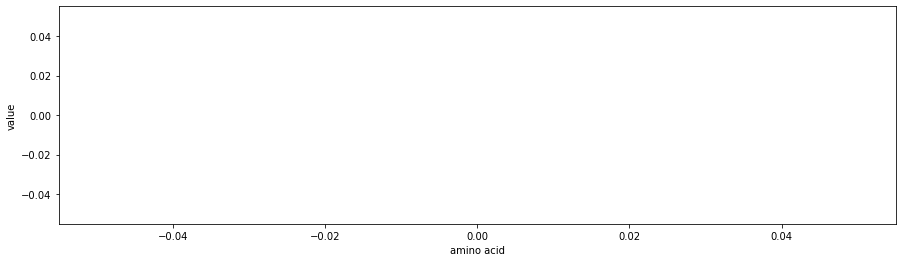

ANDN920101


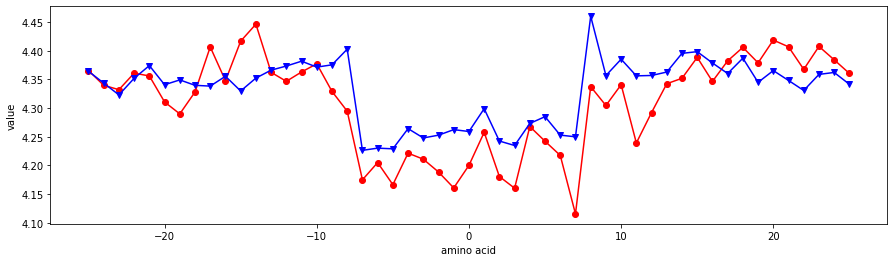

ARGP820101


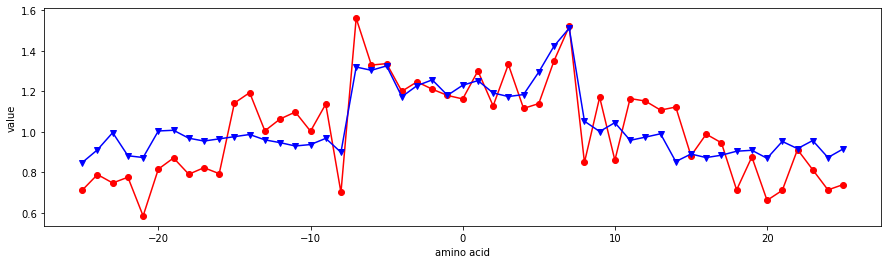

ARGP820102


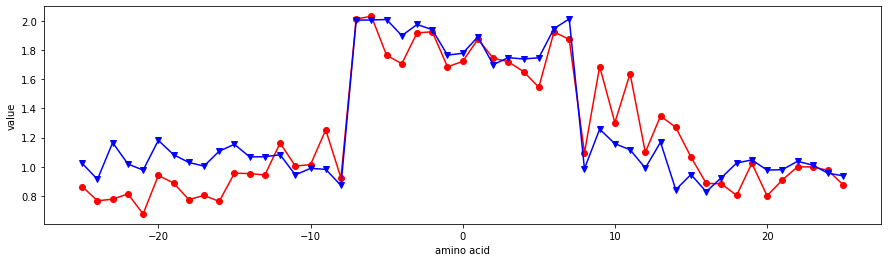

ARGP820103


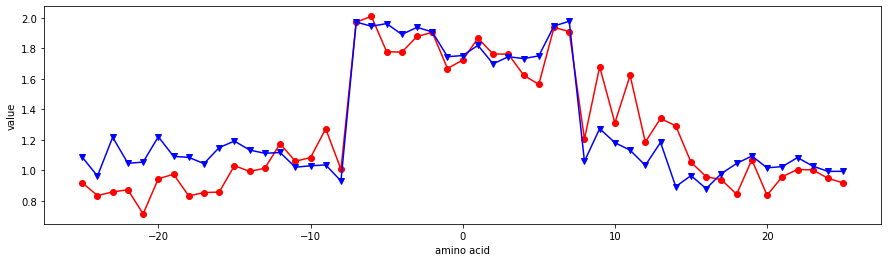

BEGF750101


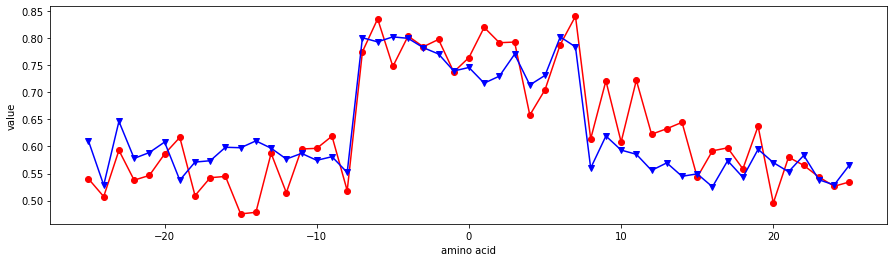

BEGF750102


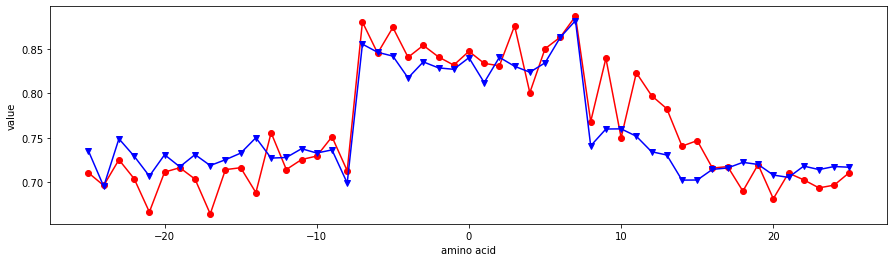

BEGF750103


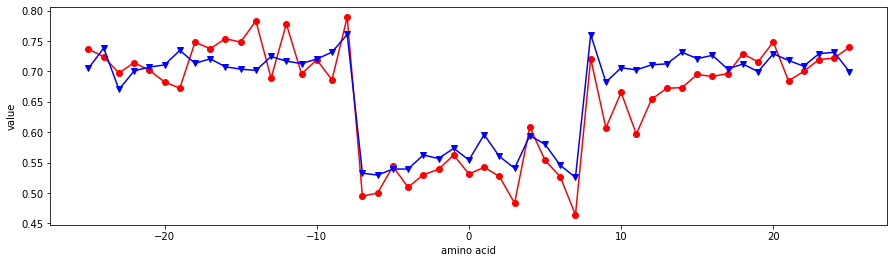

BHAR880101


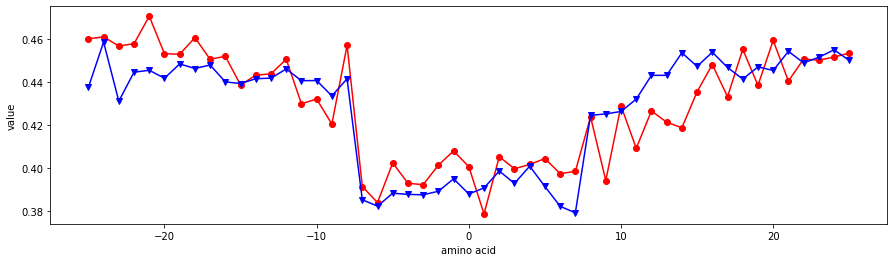

BIGC670101


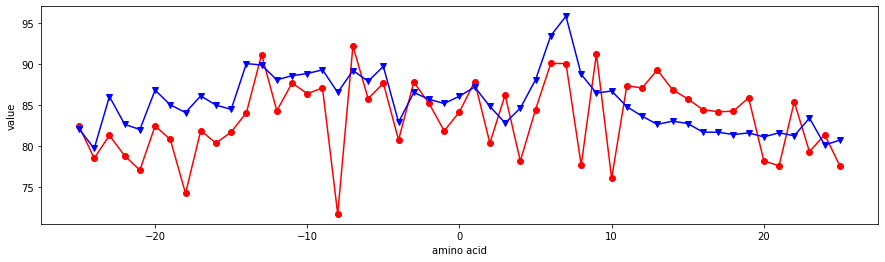

BIOV880101


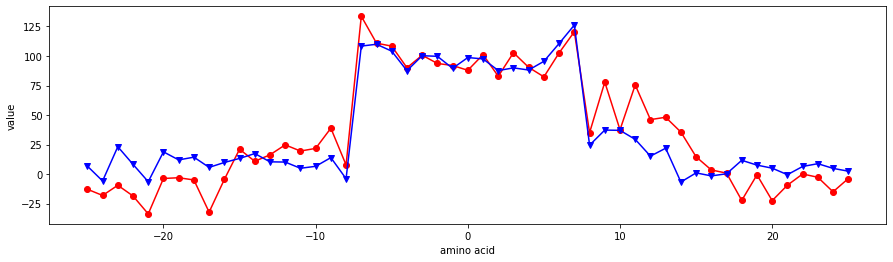

BIOV880102


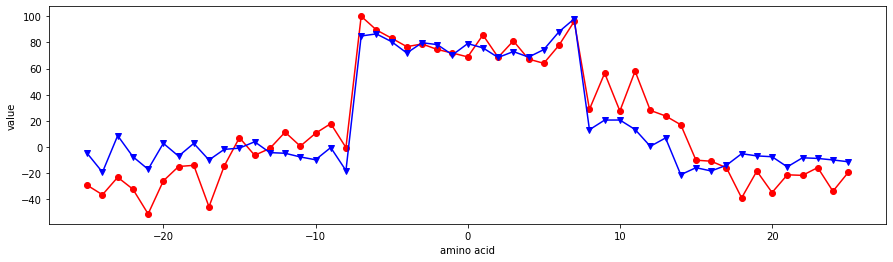

BROC820101


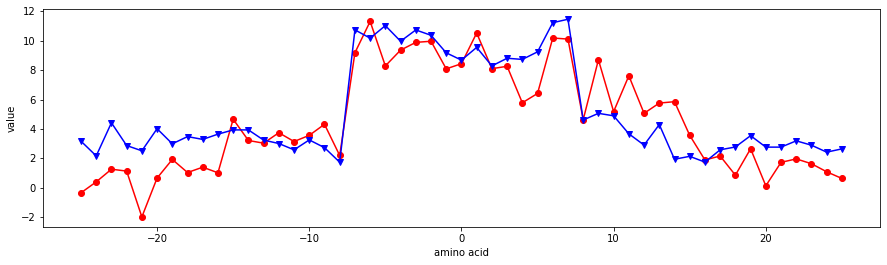

BROC820102


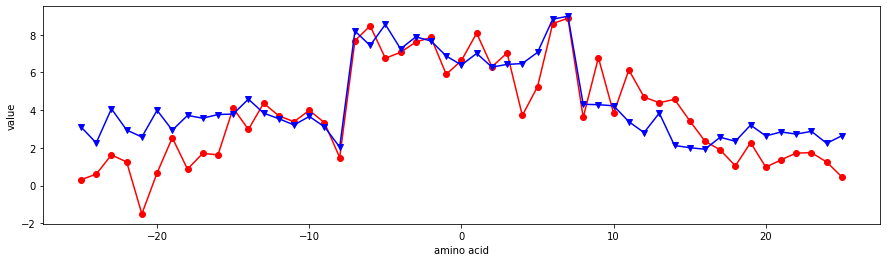

BULH740101


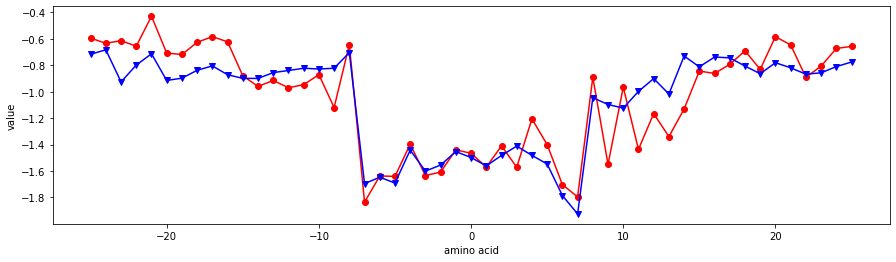

BULH740102


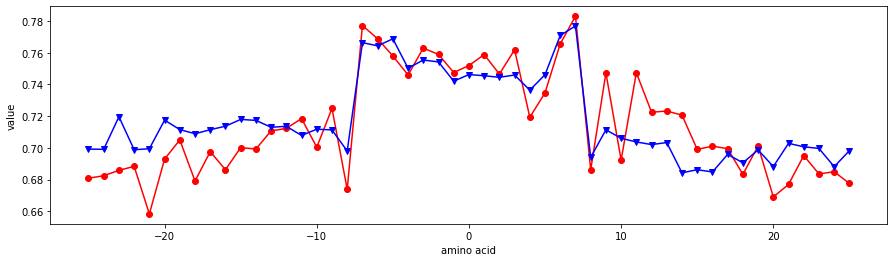

BUNA790101


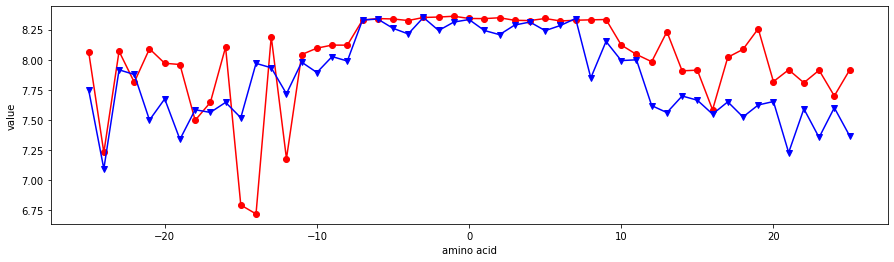

BUNA790102


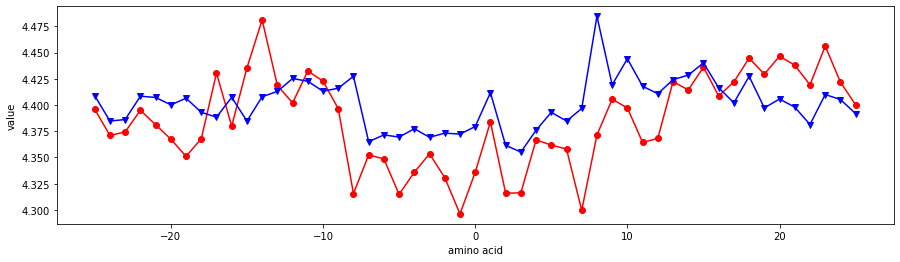

BUNA790103


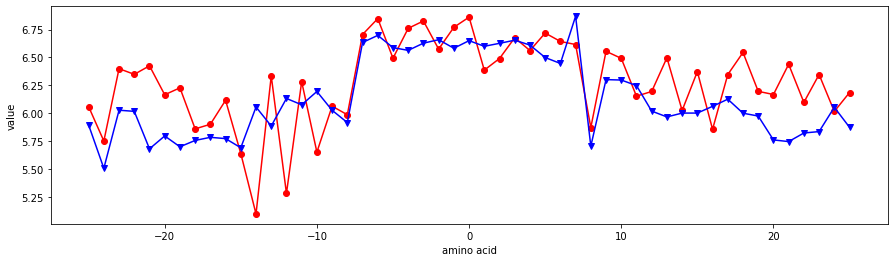

BURA740101


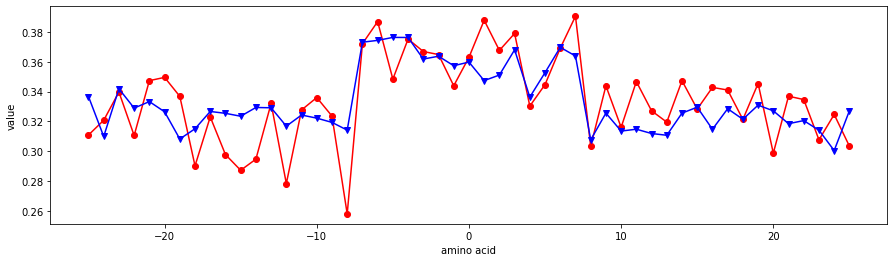

BURA740102


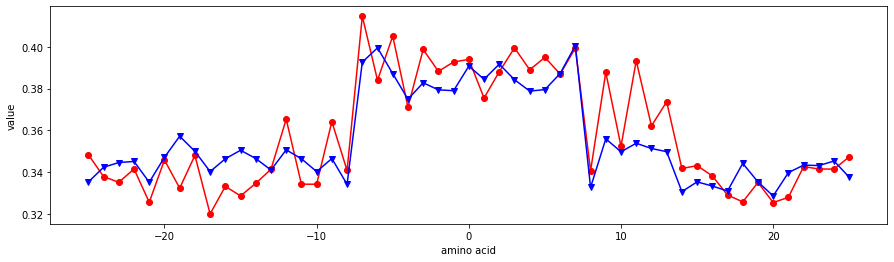

CHAM810101


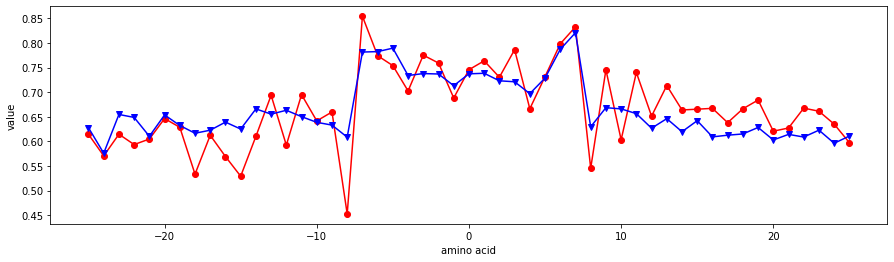

CHAM820101


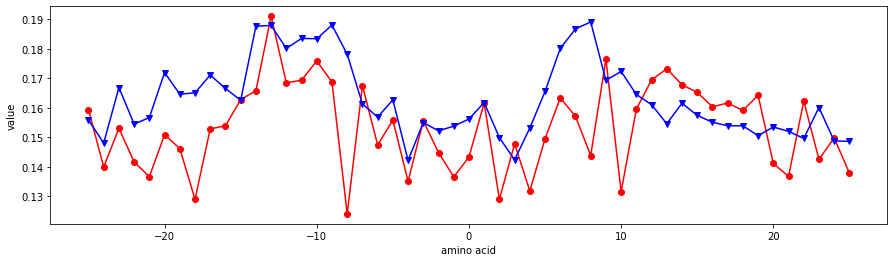

CHAM820102


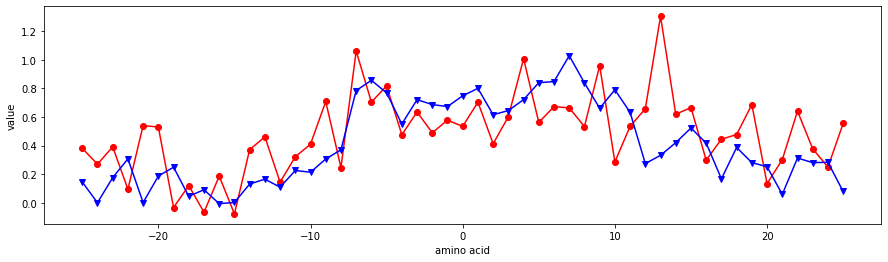

CHAM830101


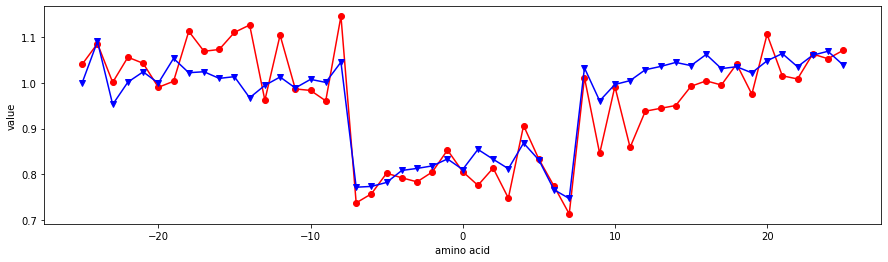

CHAM830102


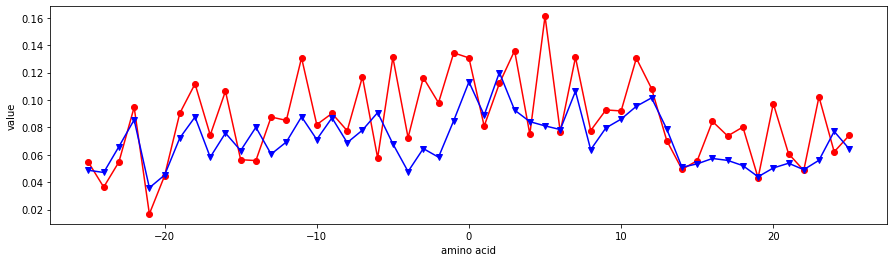

CHAM830103


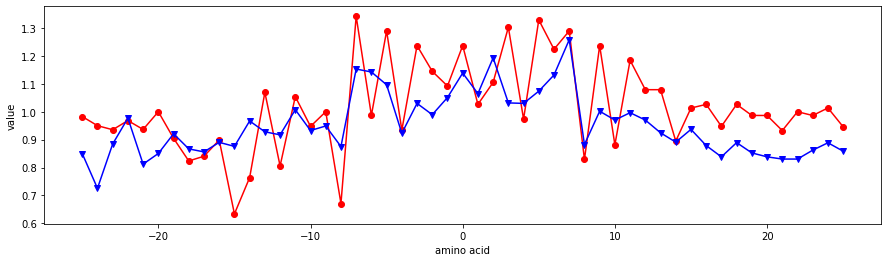

CHAM830104


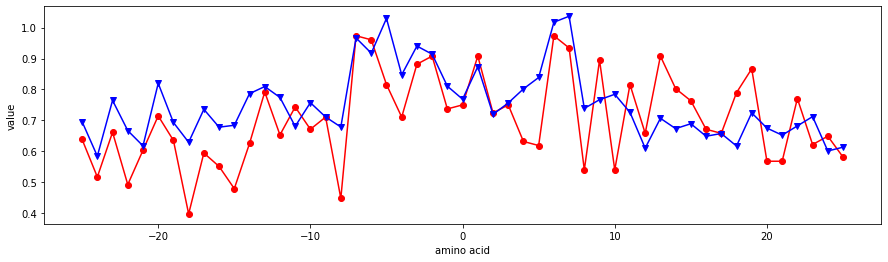

CHAM830105


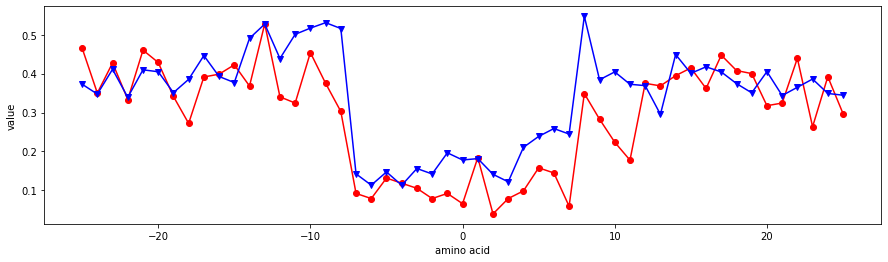

CHAM830106


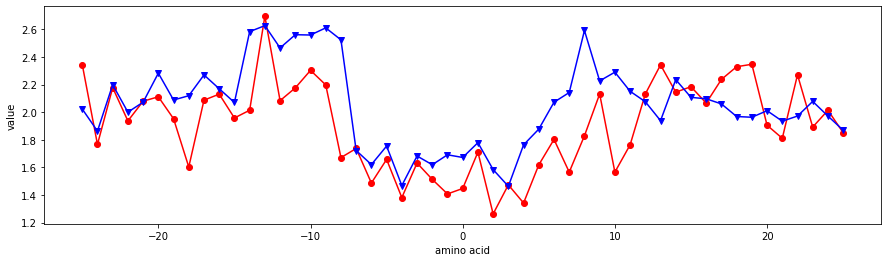

CHAM830107


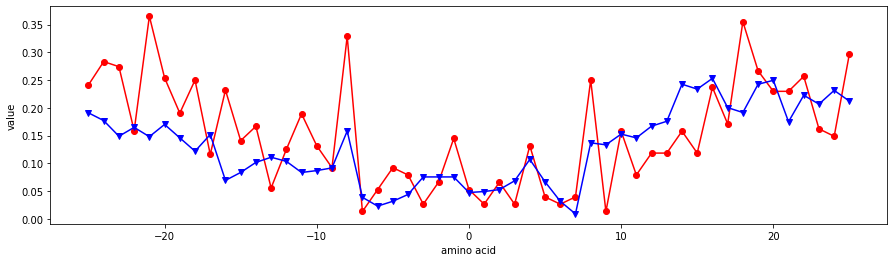

CHAM830108


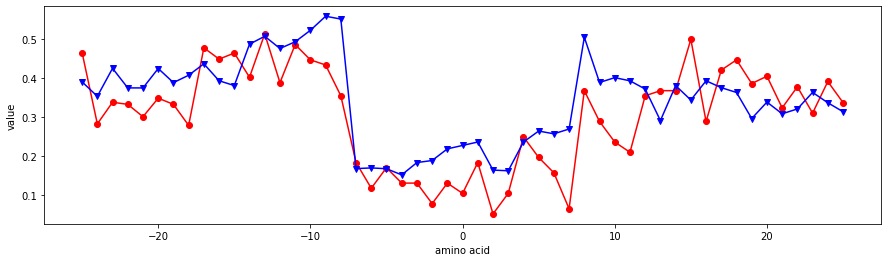

CHOC750101


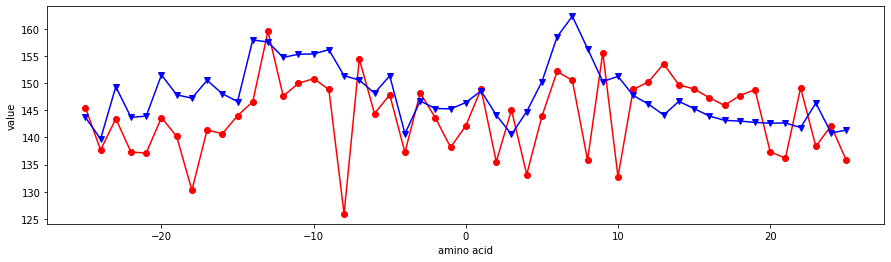

CHOC760101


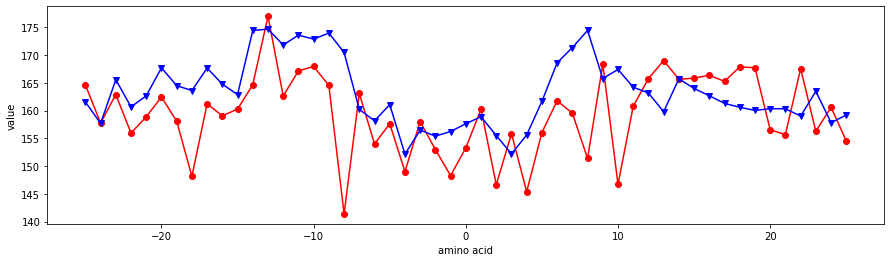

CHOC760102


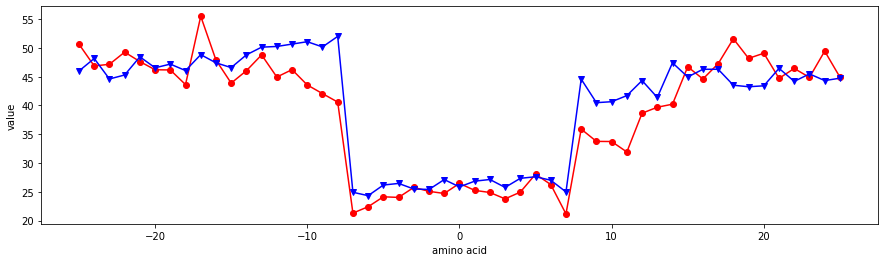

CHOC760103


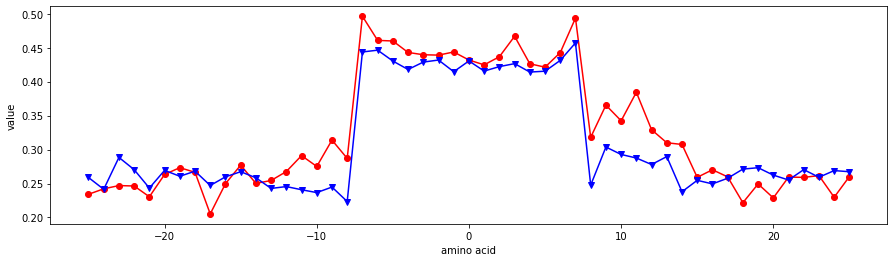

CHOC760104


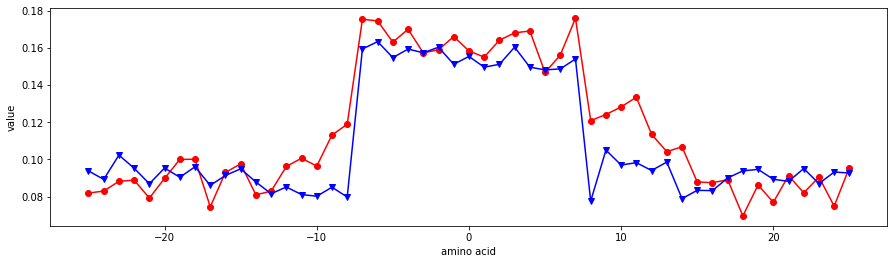

CHOP780101


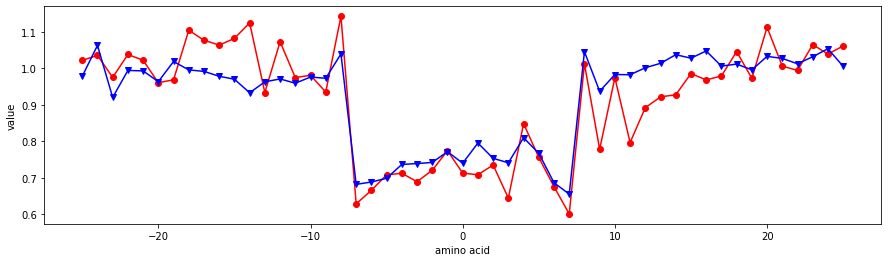

CHOP780201


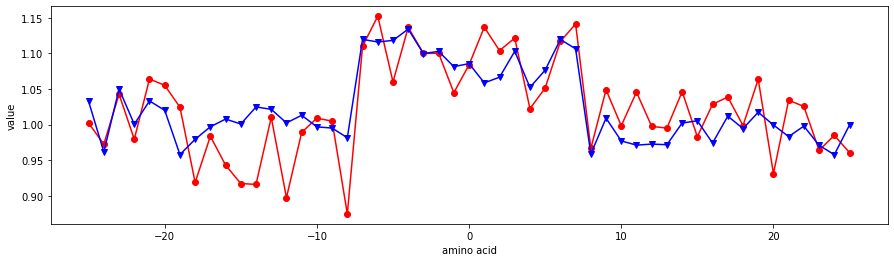

CHOP780202


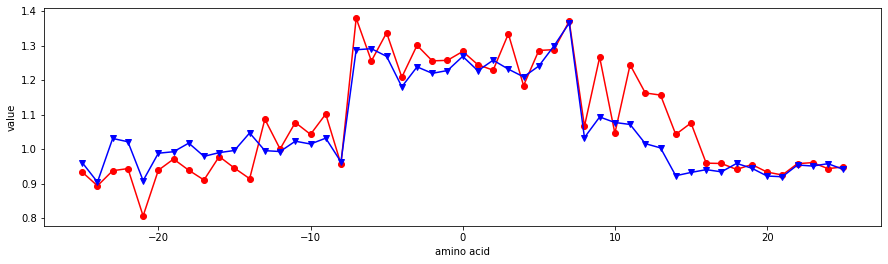

CHOP780203


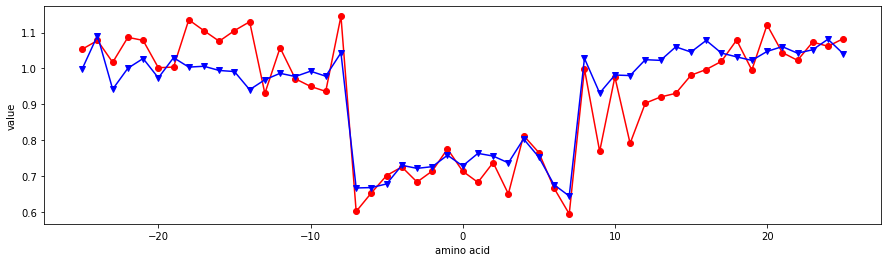

CHOP780204


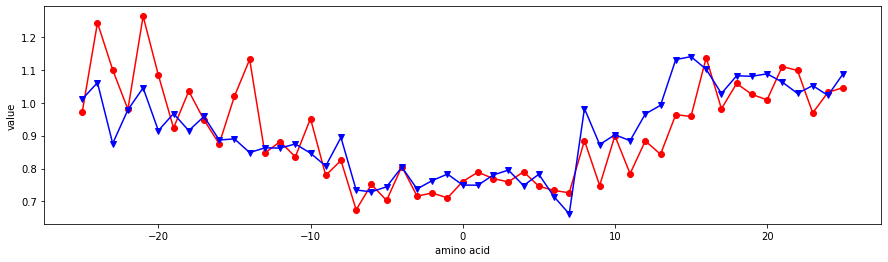

CHOP780205


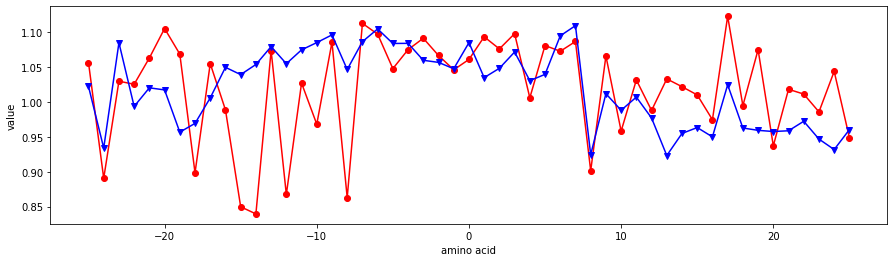

CHOP780206


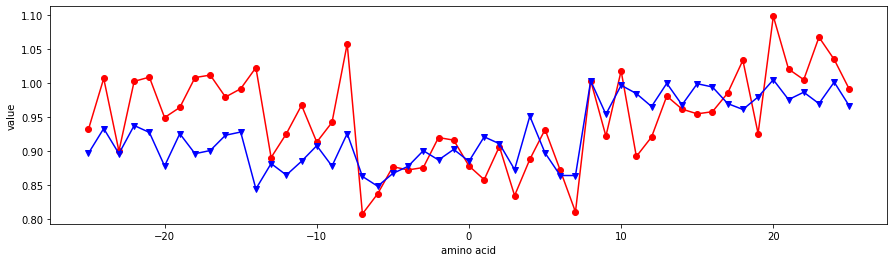

CHOP780207


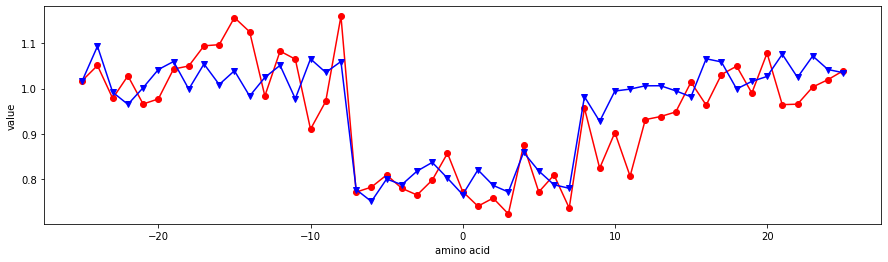

CHOP780208


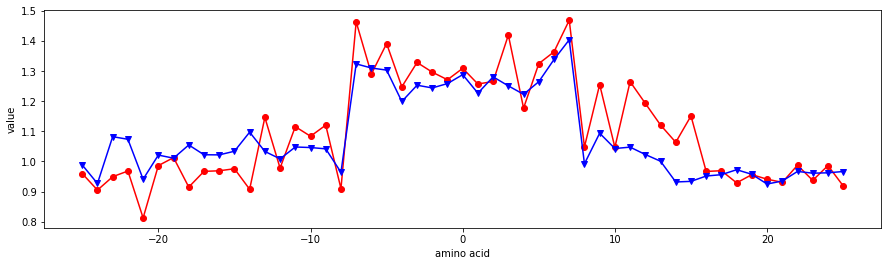

CHOP780209


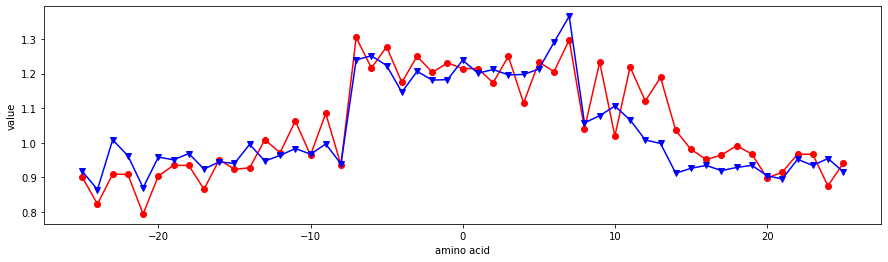

CHOP780210


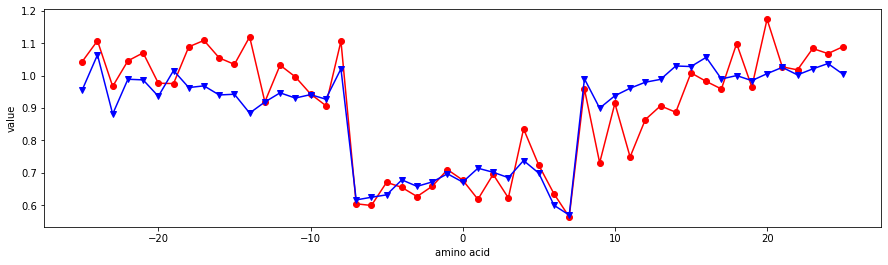

CHOP780211


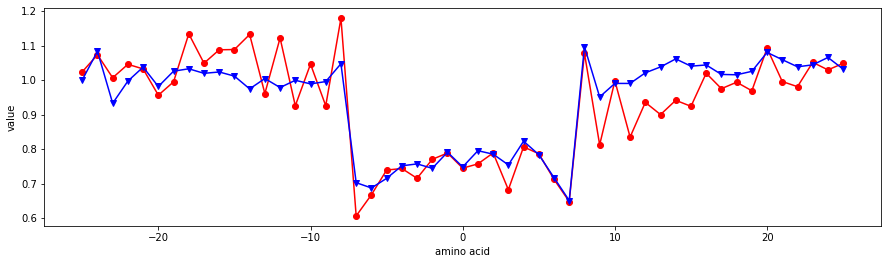

CHOP780212


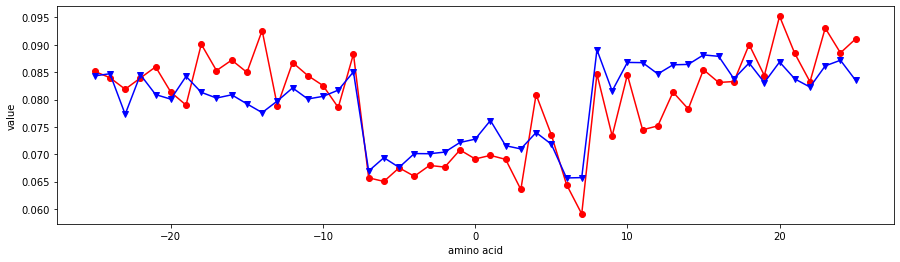

CHOP780213


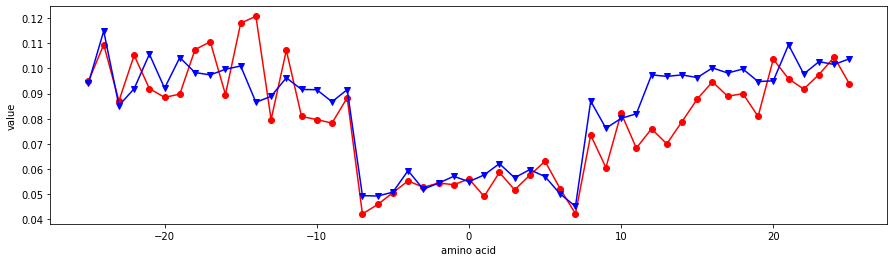

CHOP780214


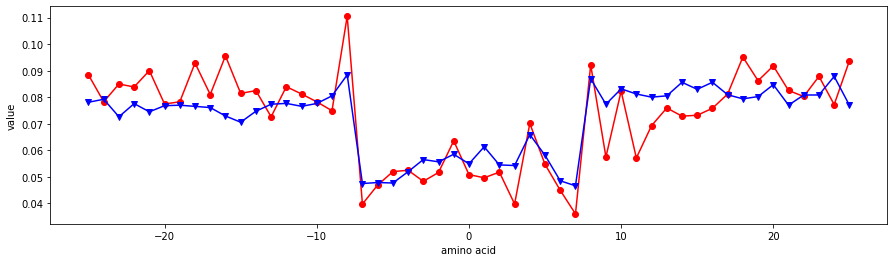

CHOP780215


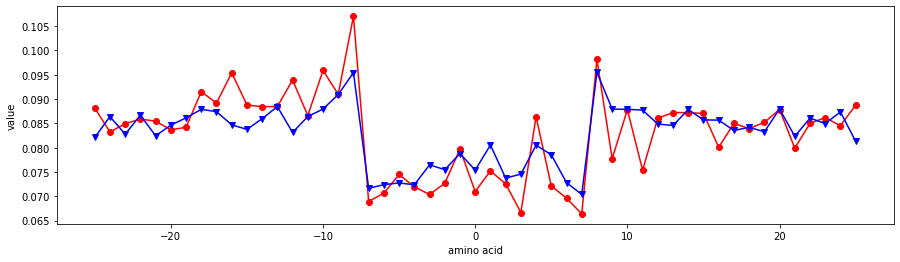

CHOP780216


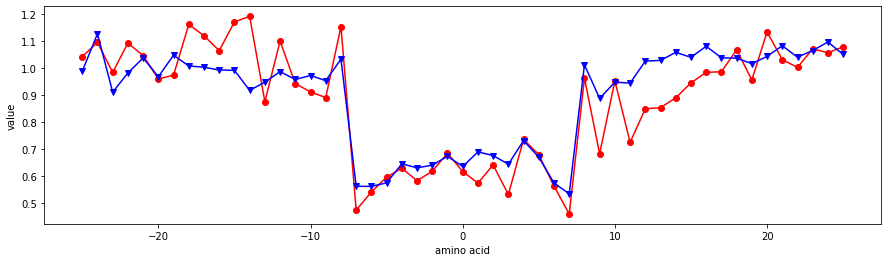

CIDH920101


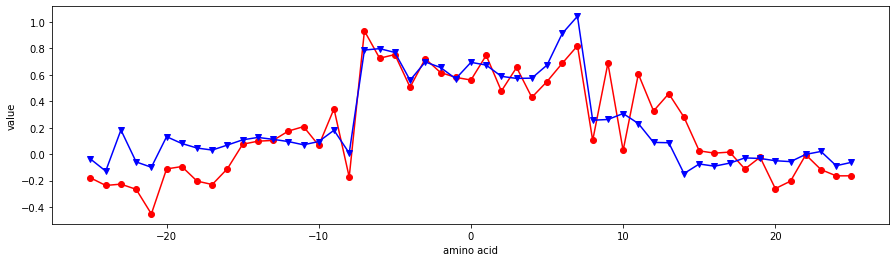

CIDH920102


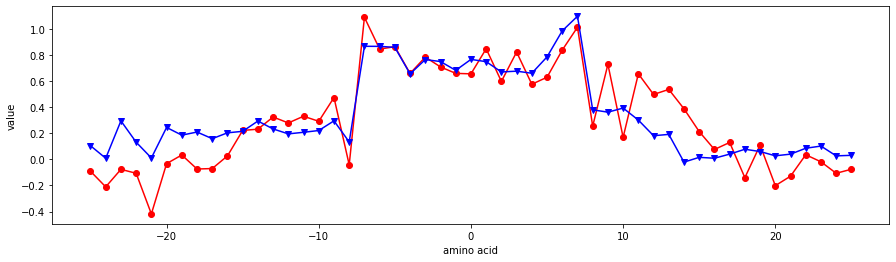

CIDH920103


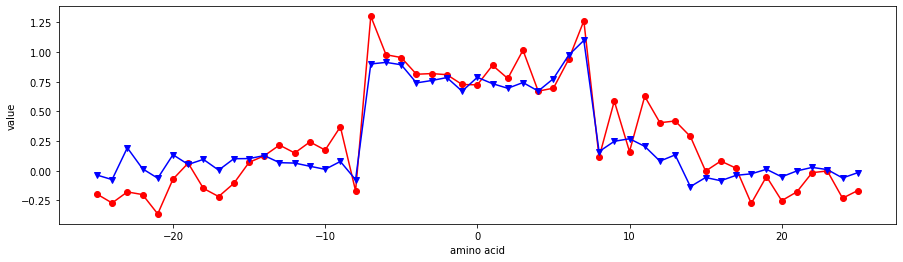

CIDH920104


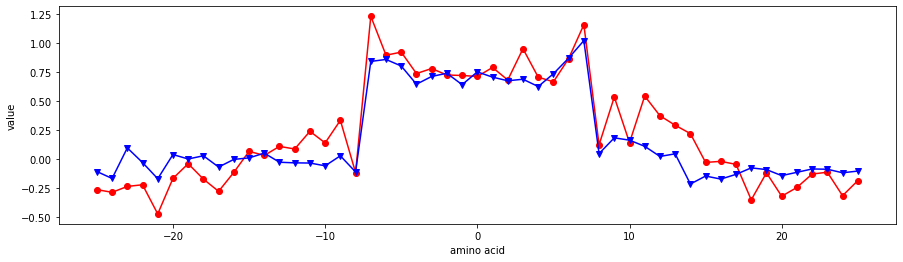

CIDH920105


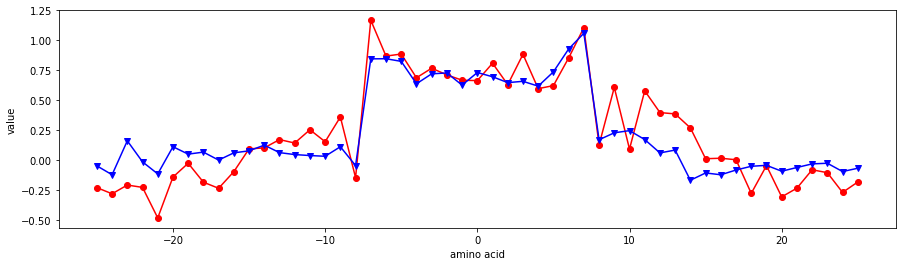

COHE430101


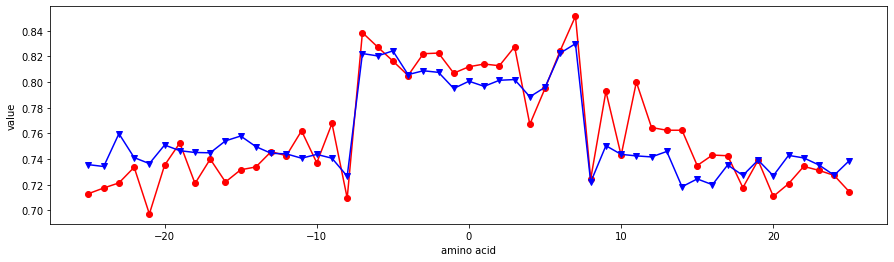

CRAJ730101


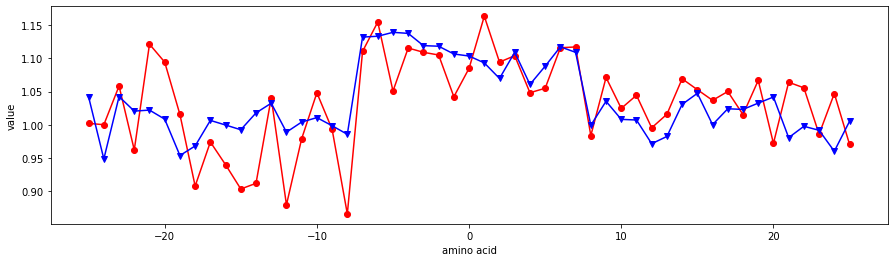

CRAJ730102


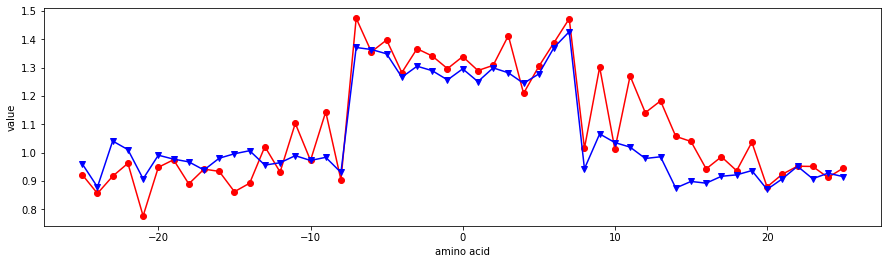

CRAJ730103


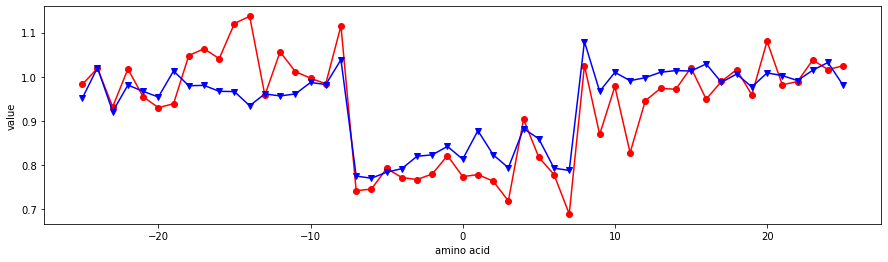

DAWD720101


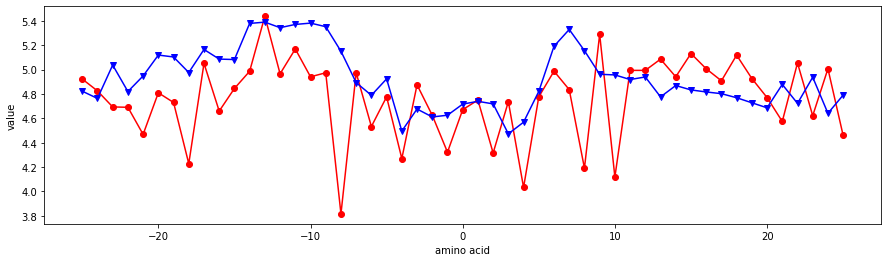

DAYM780101


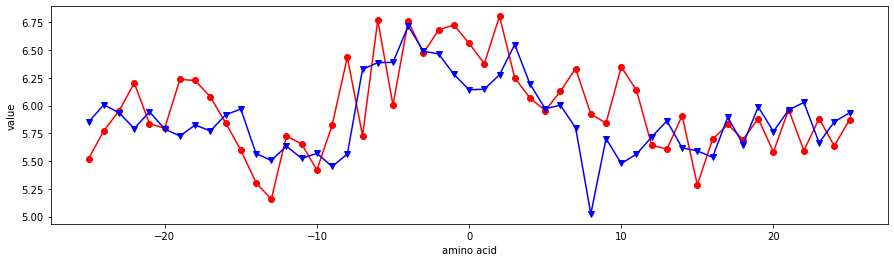

DAYM780201


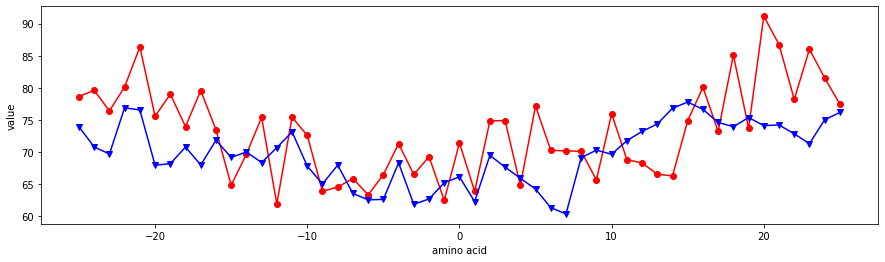

DESM900101


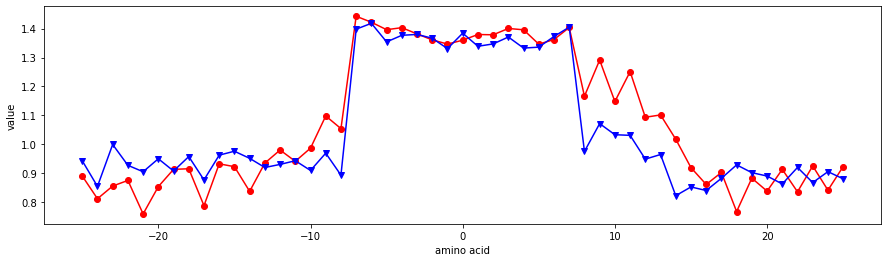

DESM900102


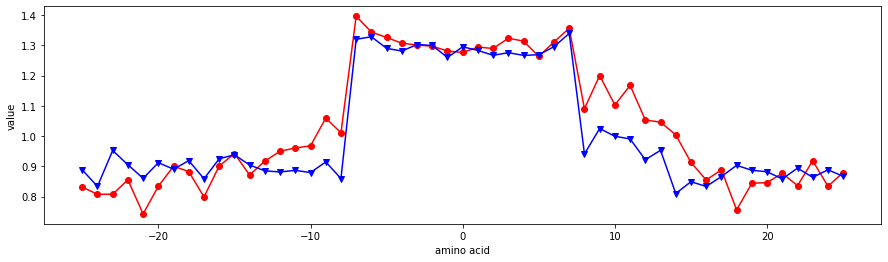

EISD840101


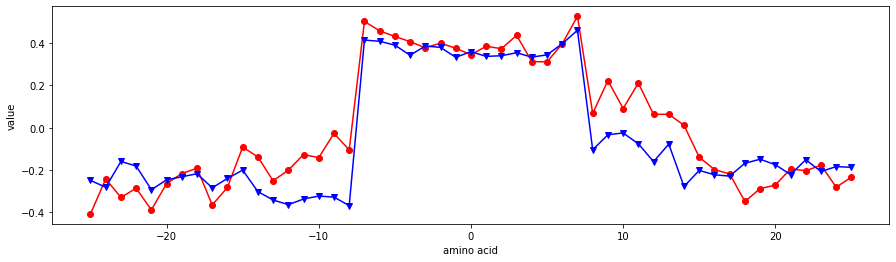

EISD860101


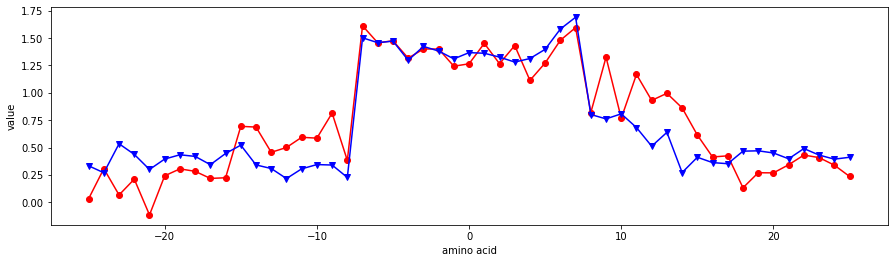

EISD860102


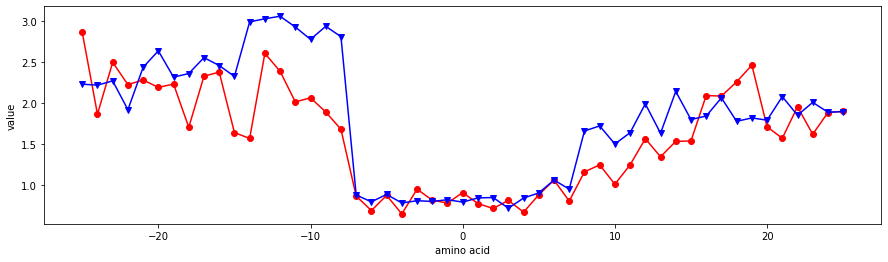

EISD860103


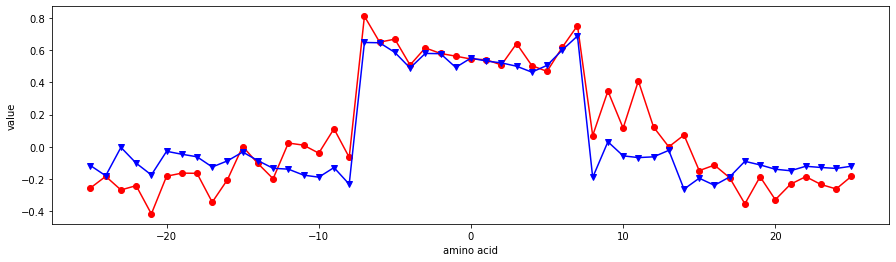

FASG760101


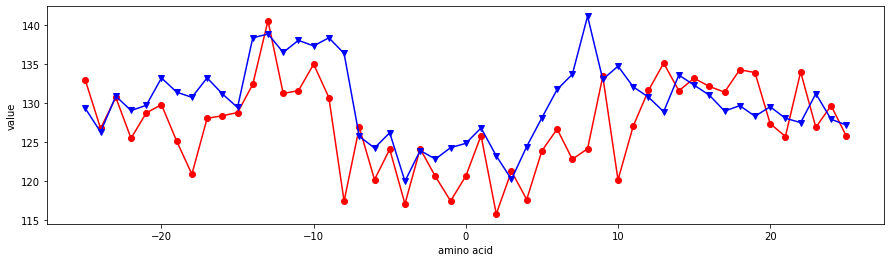

FASG760102


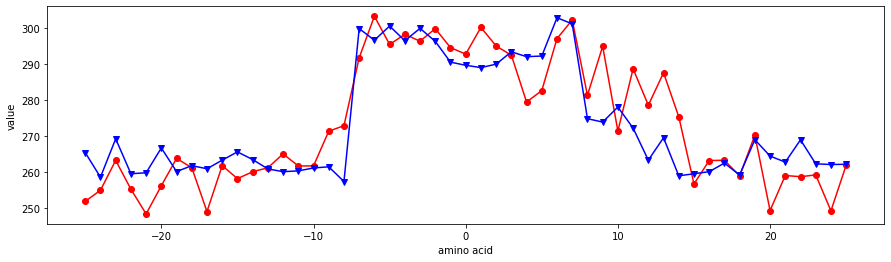

FASG760103


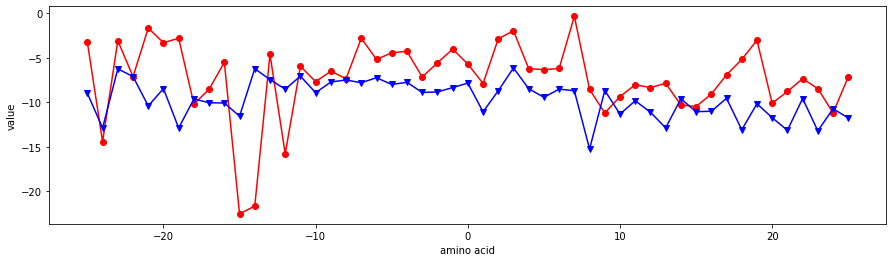

FASG760104


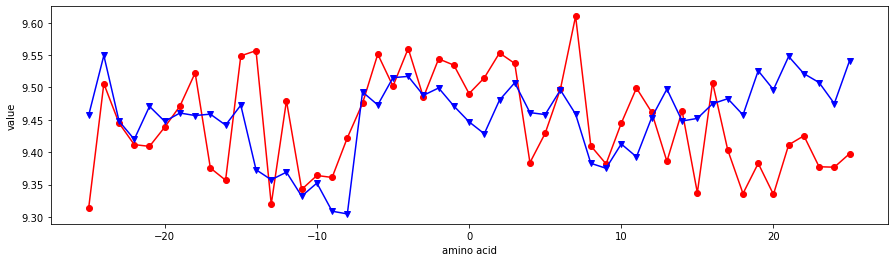

FASG760105


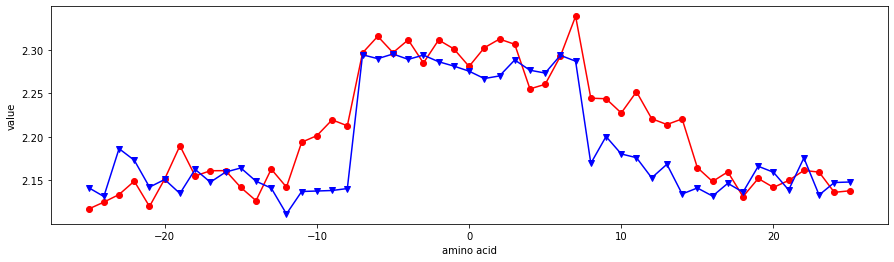

FAUJ830101


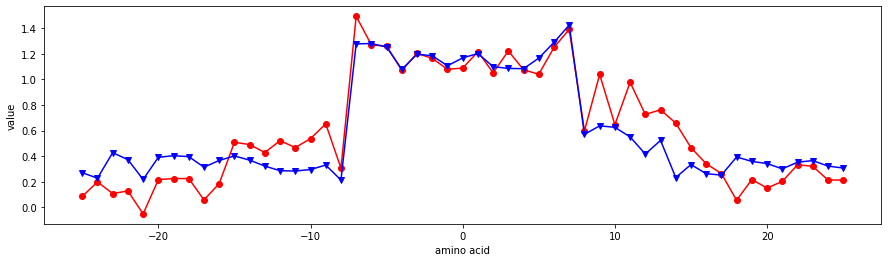

FAUJ880101


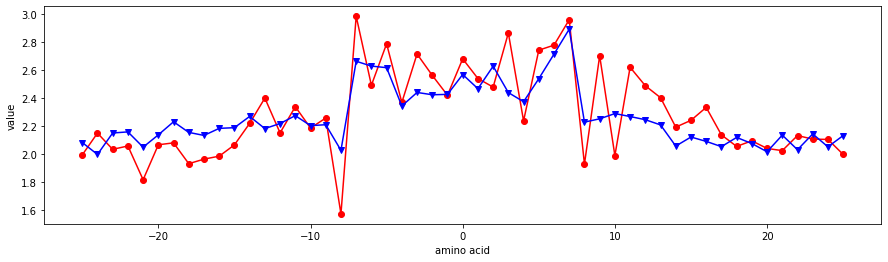

FAUJ880102


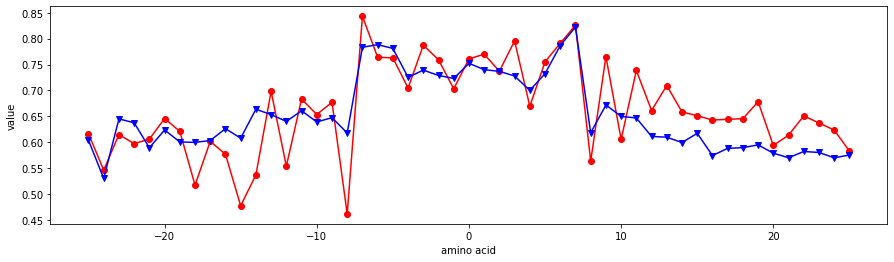

FAUJ880103


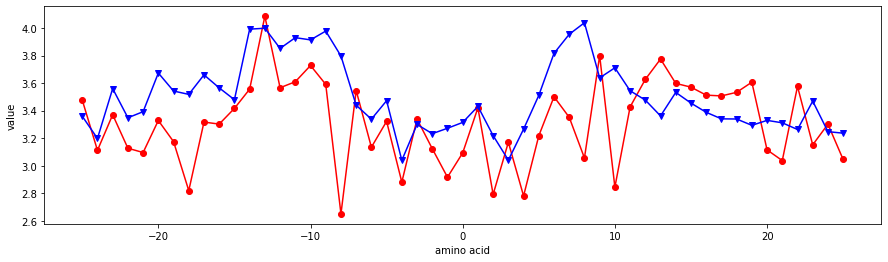

FAUJ880104


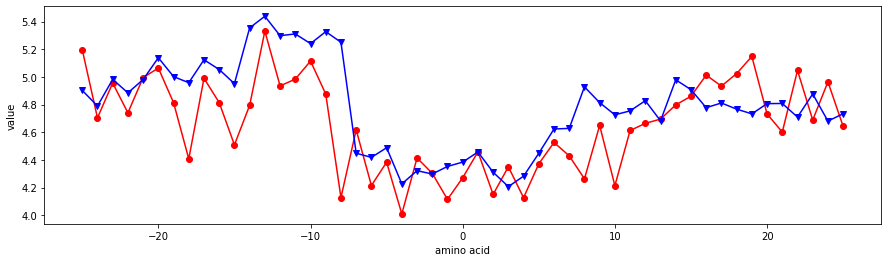

FAUJ880105


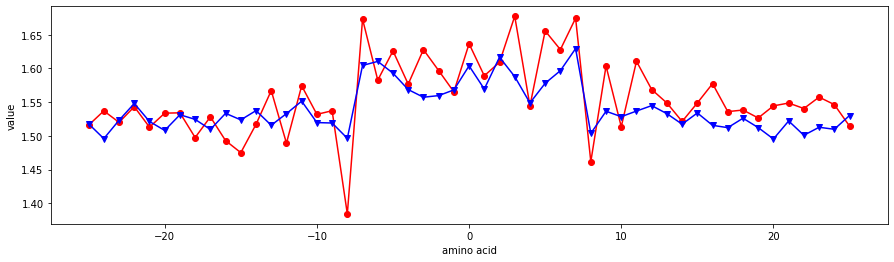

FAUJ880106


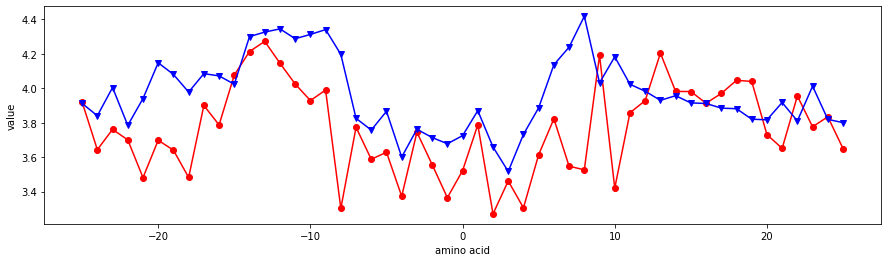

FAUJ880107


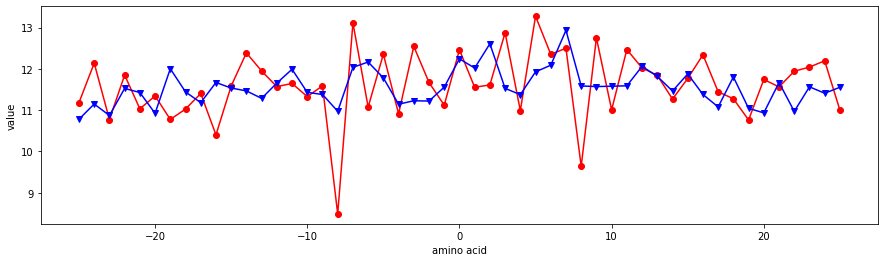

FAUJ880108


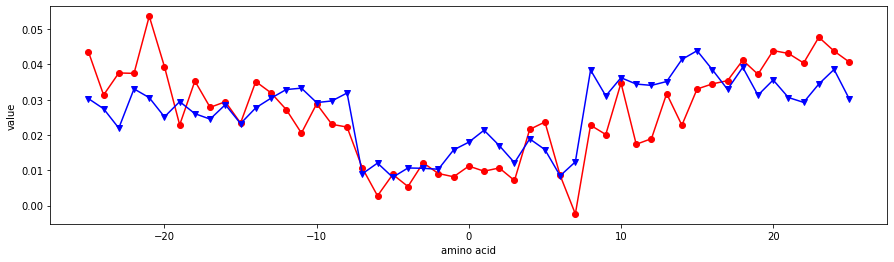

FAUJ880109


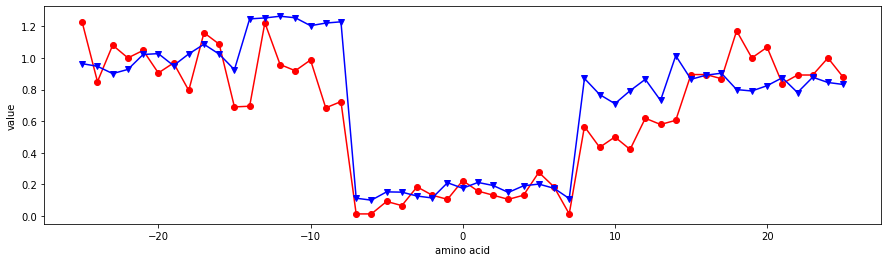

FAUJ880110


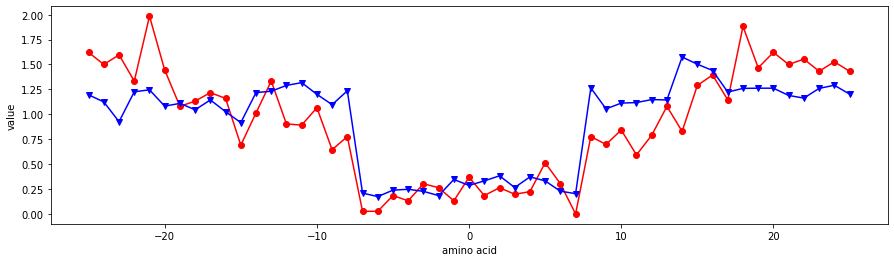

FAUJ880111


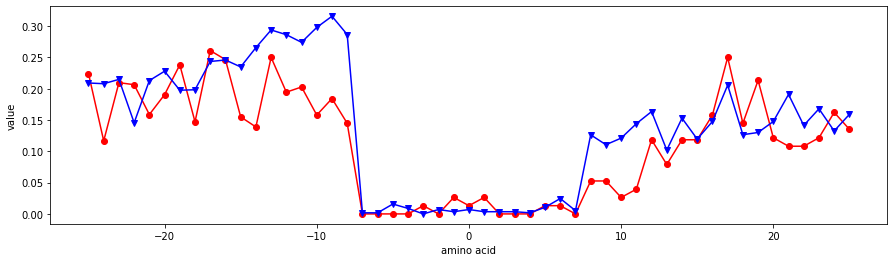

FAUJ880112


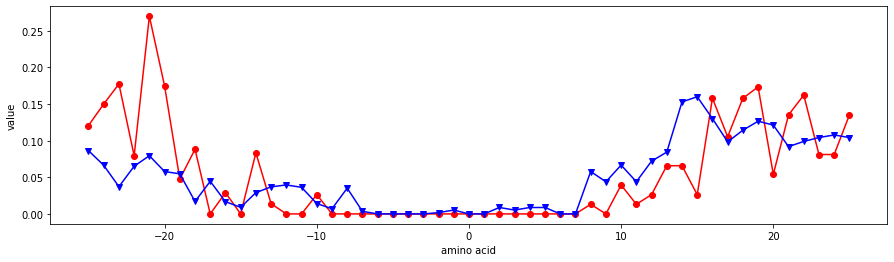

FAUJ880113


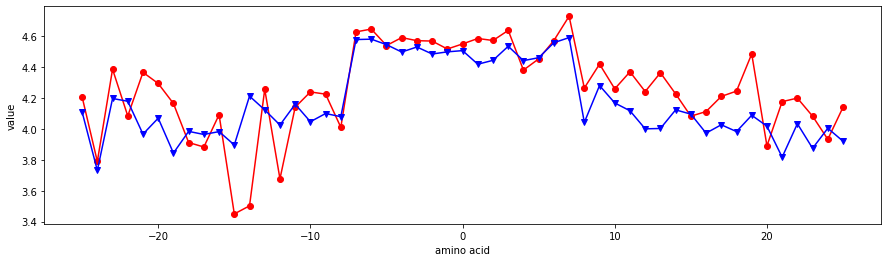

FINA770101


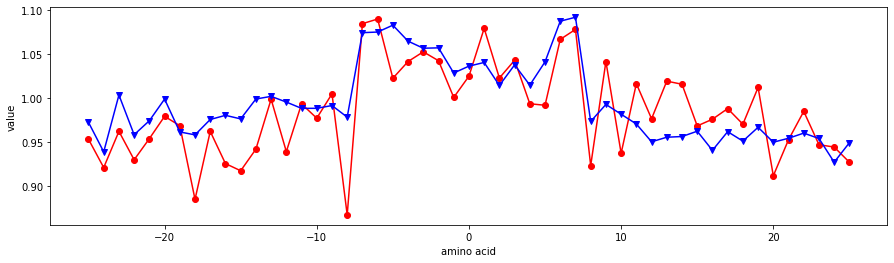

FINA910101


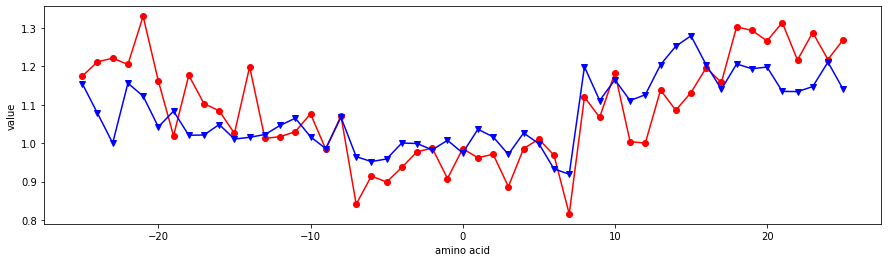

FINA910102


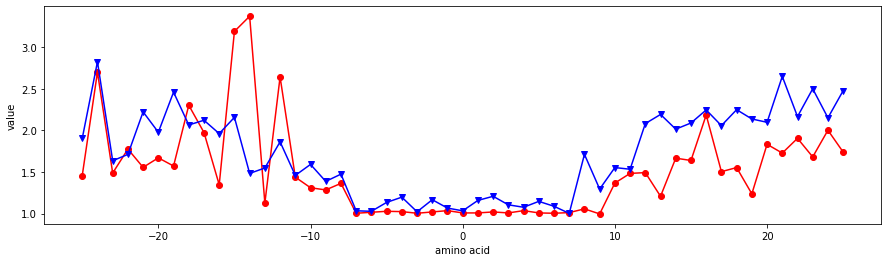

FINA910103


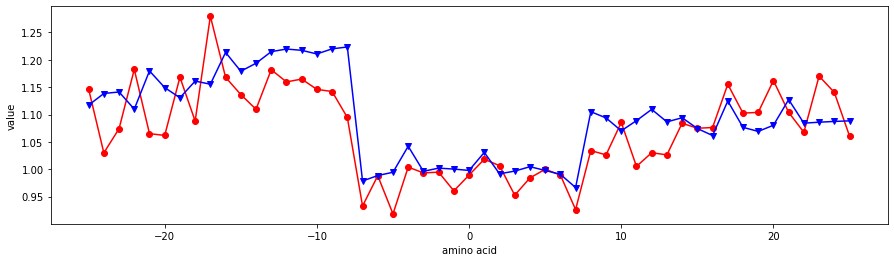

FINA910104


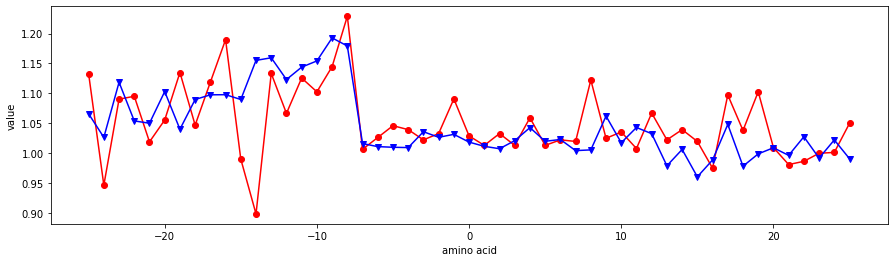

GARJ730101


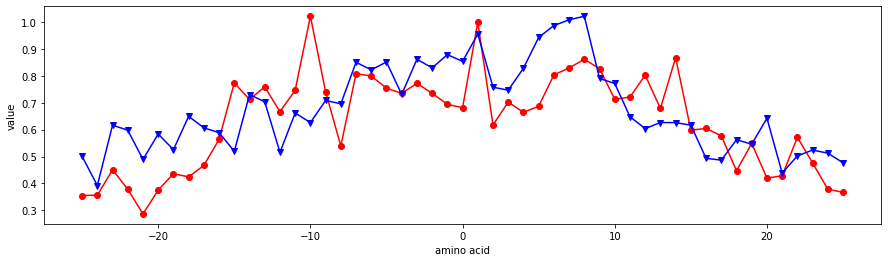

GEIM800101


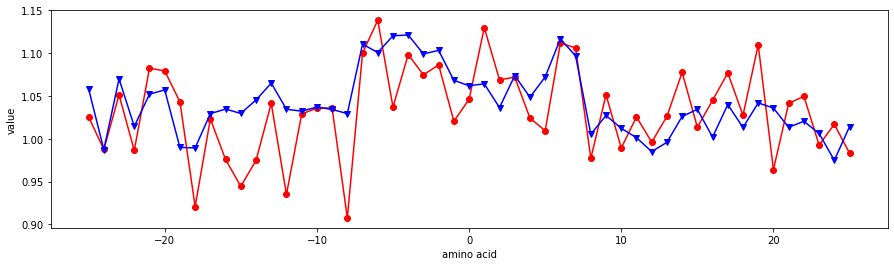

GEIM800102


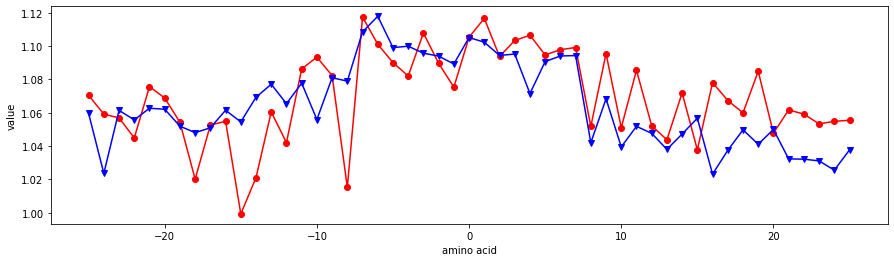

GEIM800103


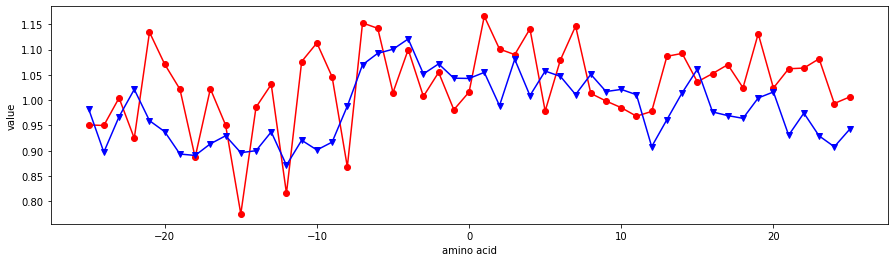

GEIM800104


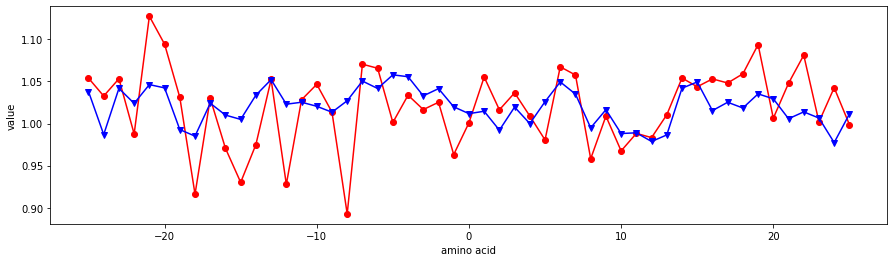

GEIM800105


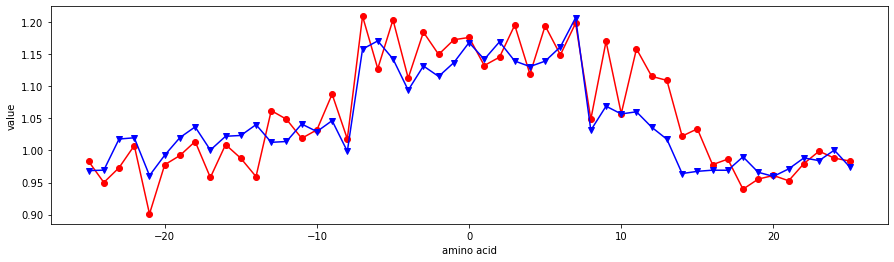

GEIM800106


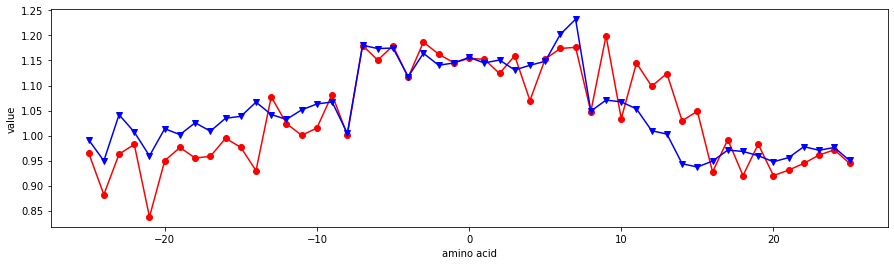

GEIM800107


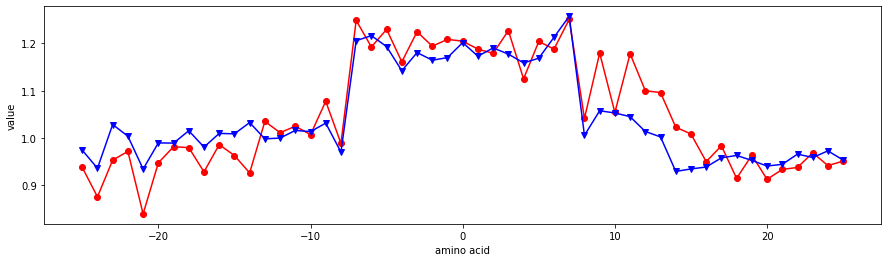

GEIM800108


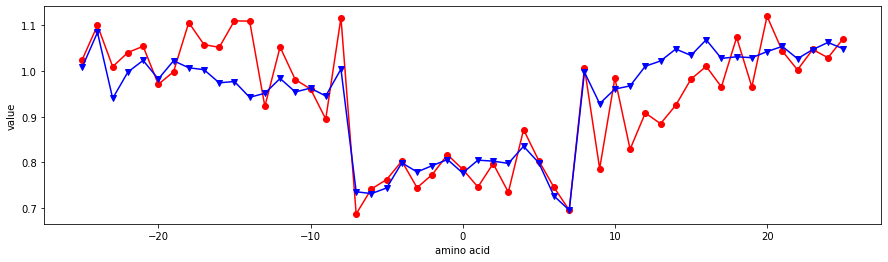

GEIM800109


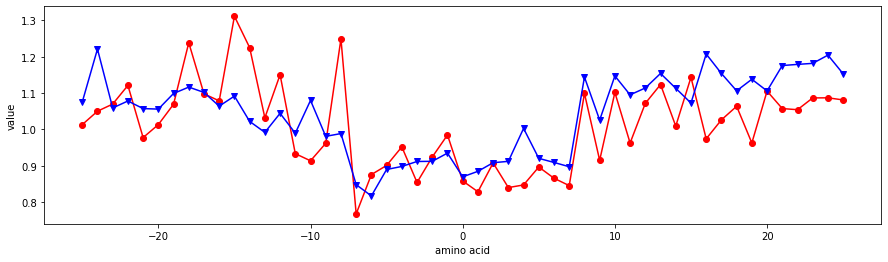

GEIM800110


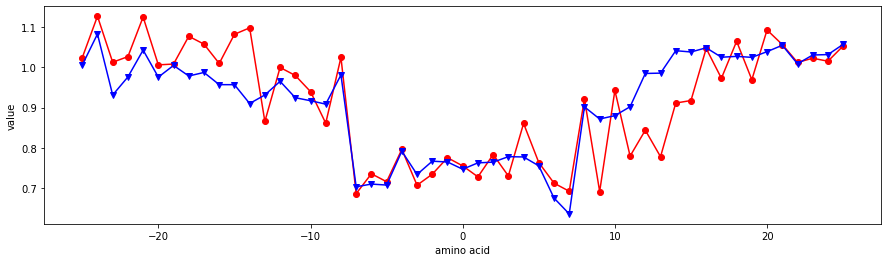

GEIM800111


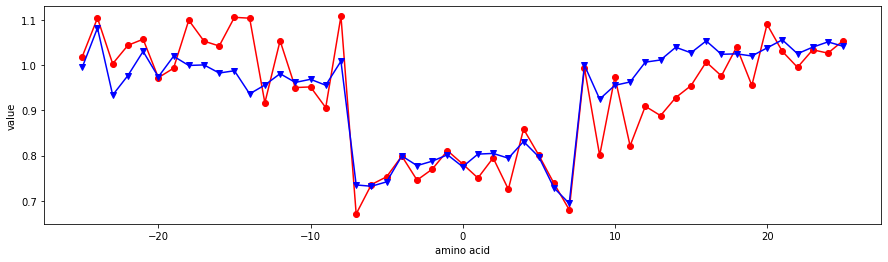

GOLD730101


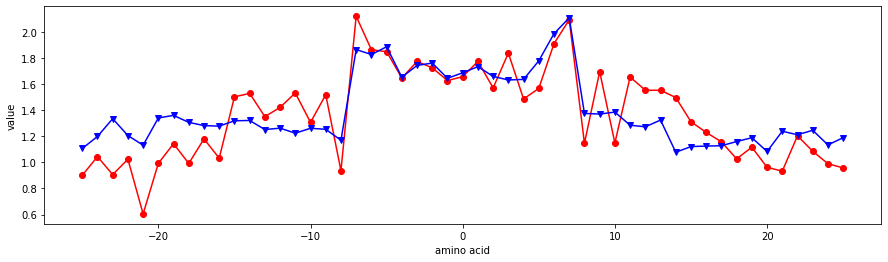

GOLD730102


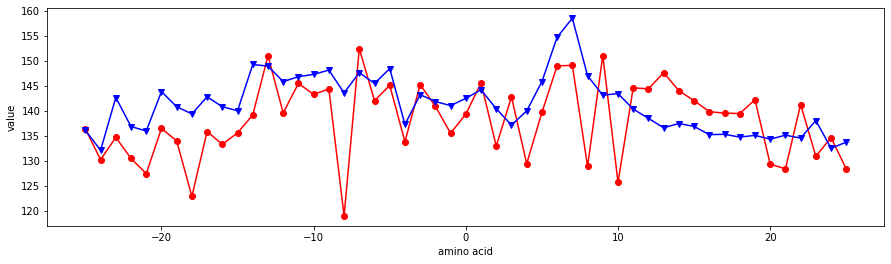

GRAR740101


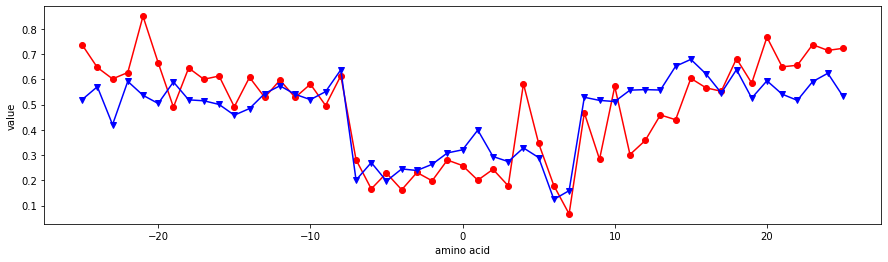

GRAR740102


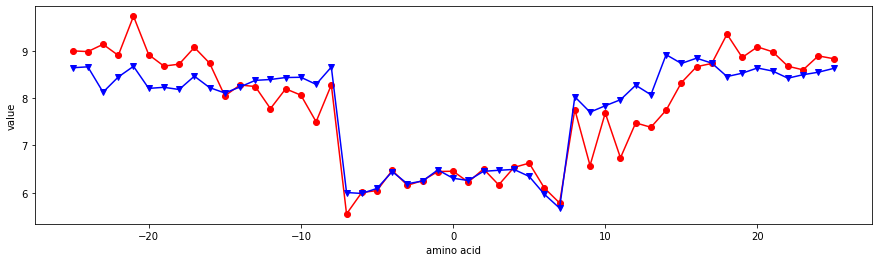

GRAR740103


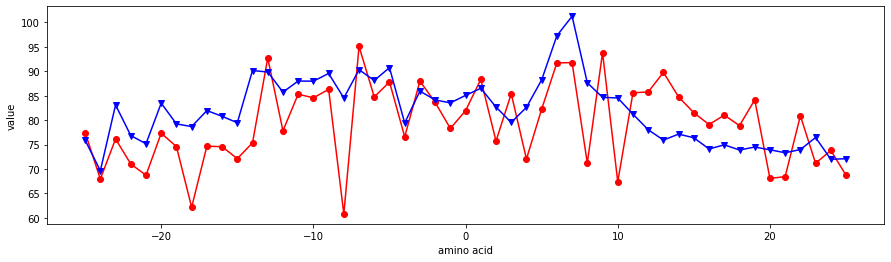

GUYH850101


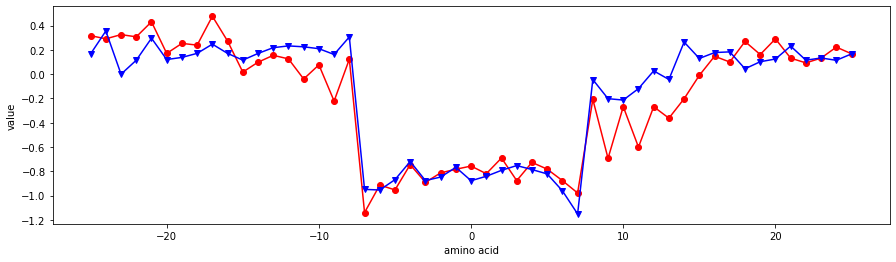

HOPA770101


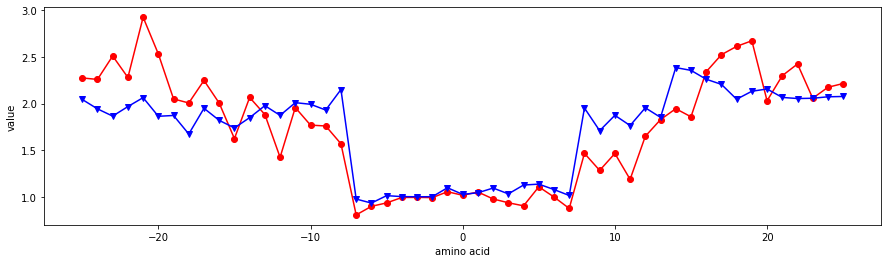

HOPT810101


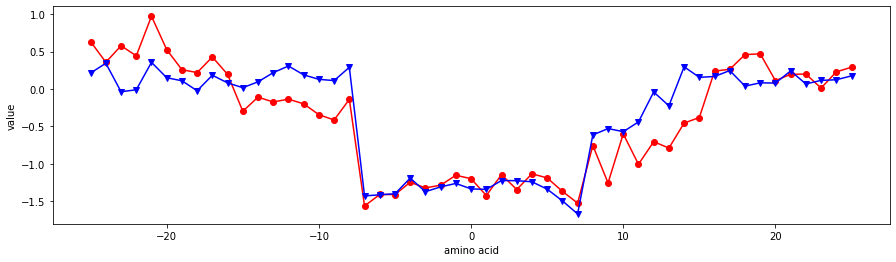

HUTJ700101


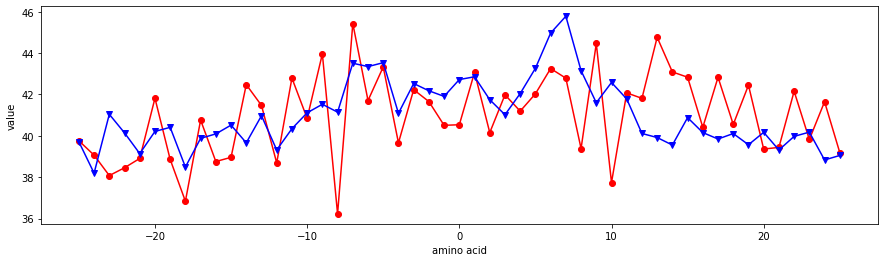

HUTJ700102


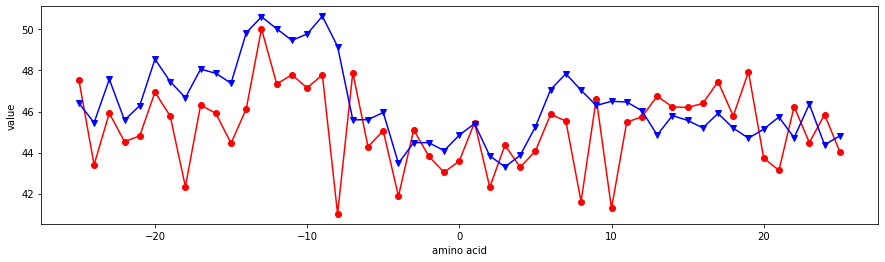

HUTJ700103


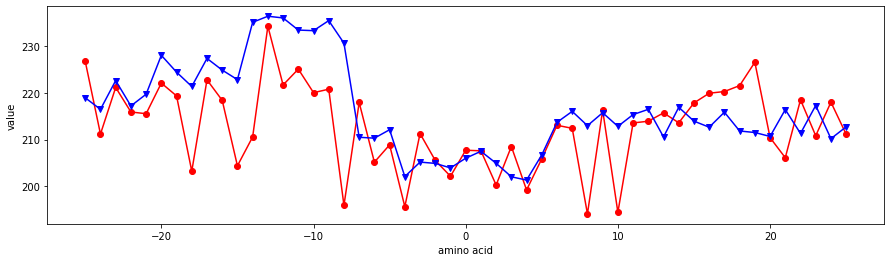

ISOY800101


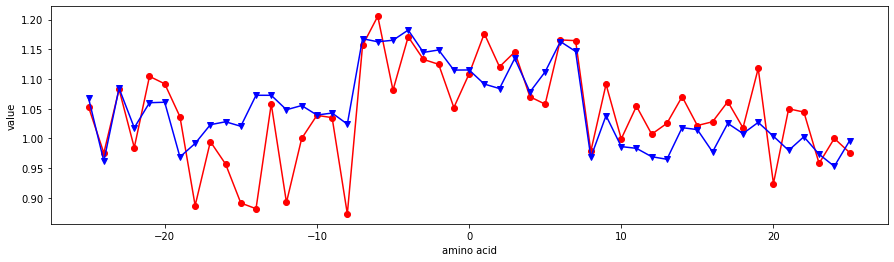

ISOY800102


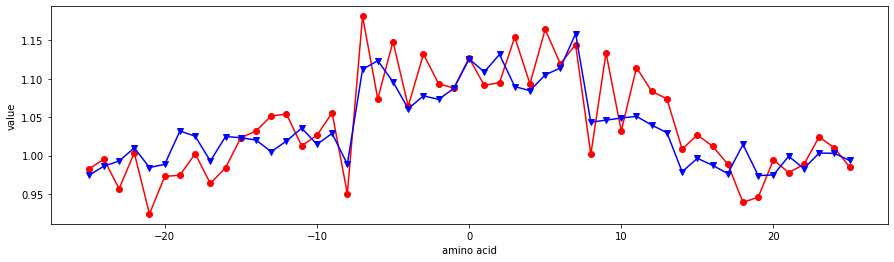

ISOY800103


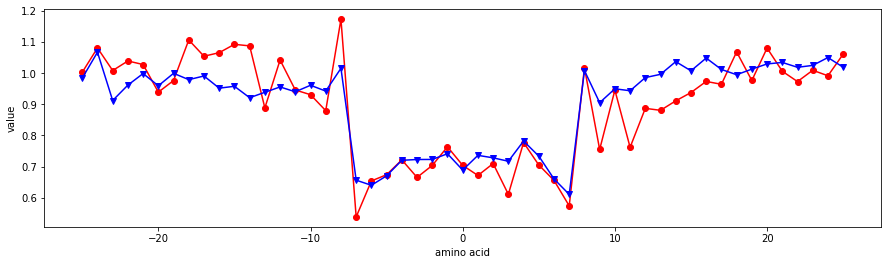

ISOY800104


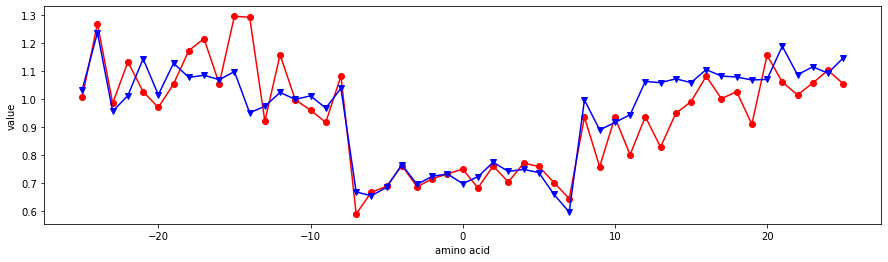

ISOY800105


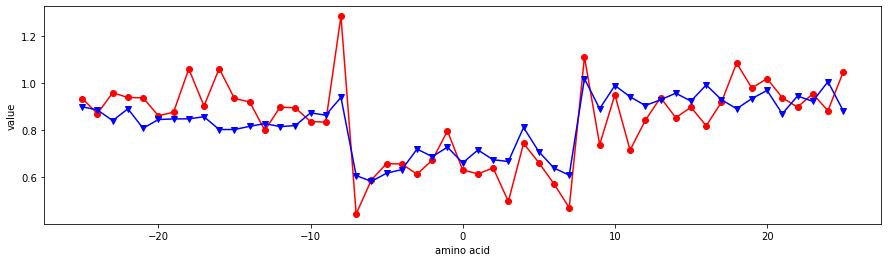

ISOY800106


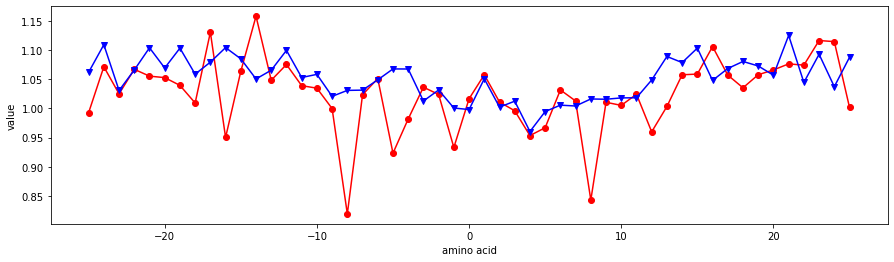

ISOY800107


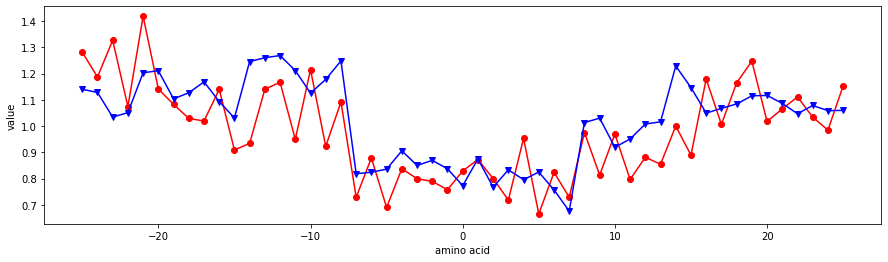

ISOY800108


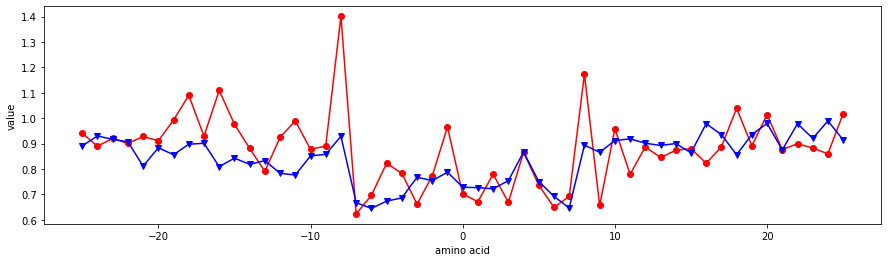

JANJ780101


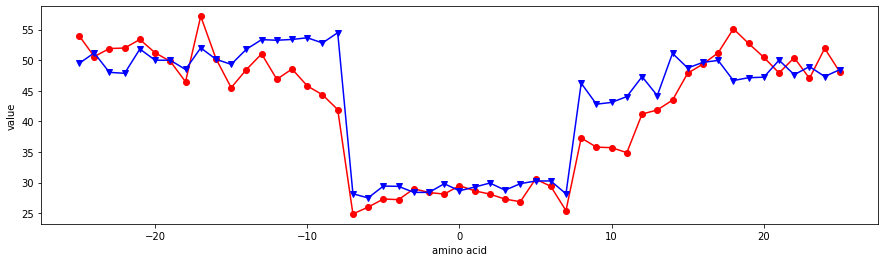

JANJ780102


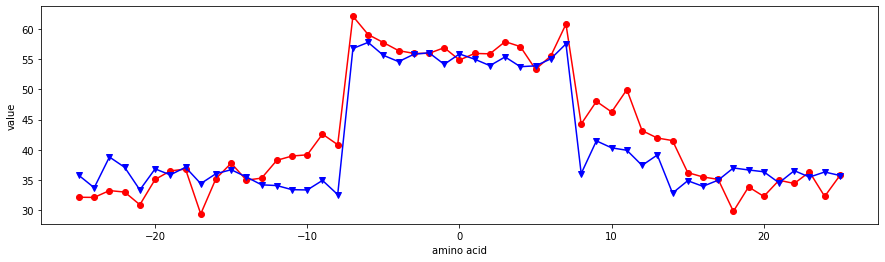

JANJ780103


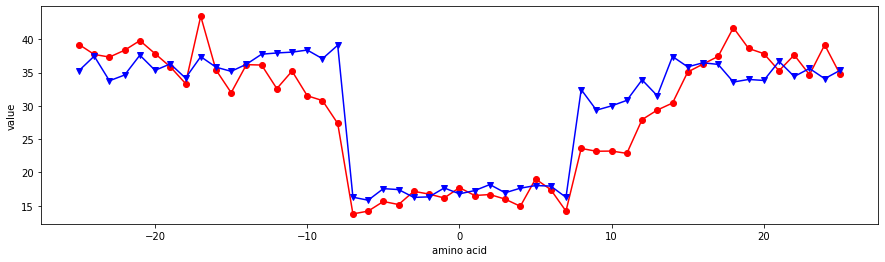

JANJ790101


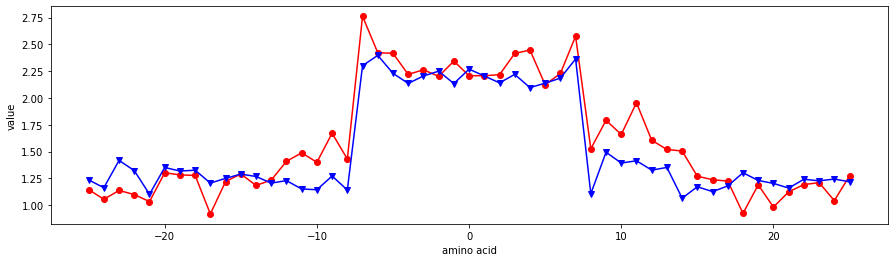

JANJ790102


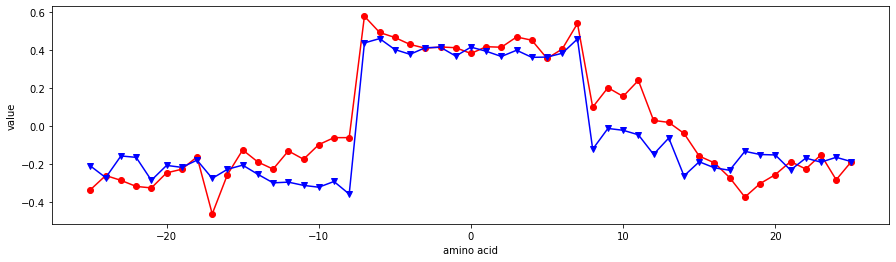

JOND750101


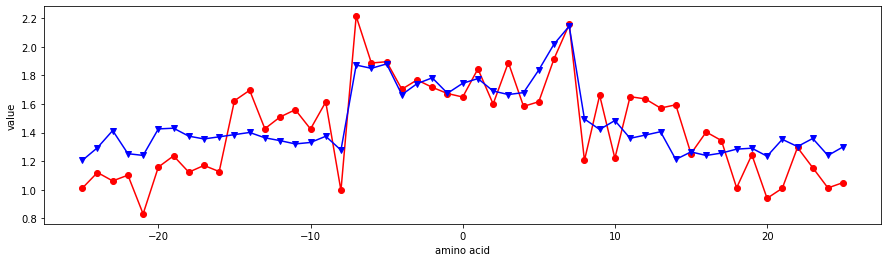

JOND750102


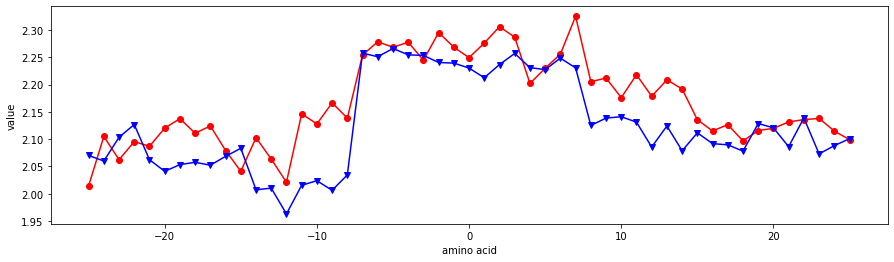

JOND920101


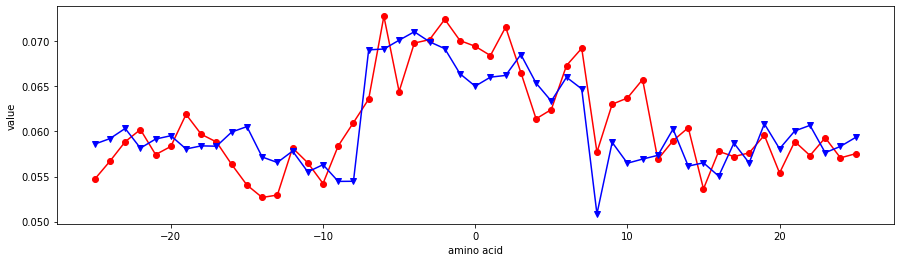

JOND920102


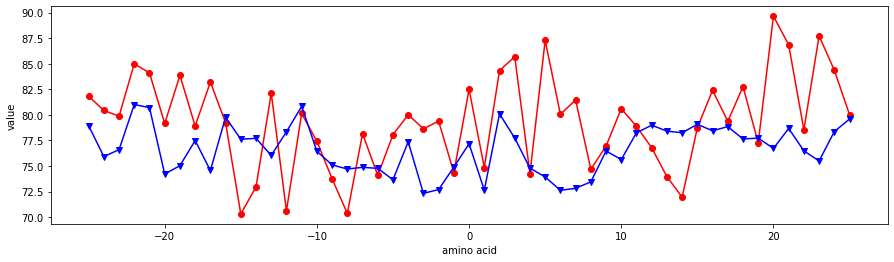

JUKT750101


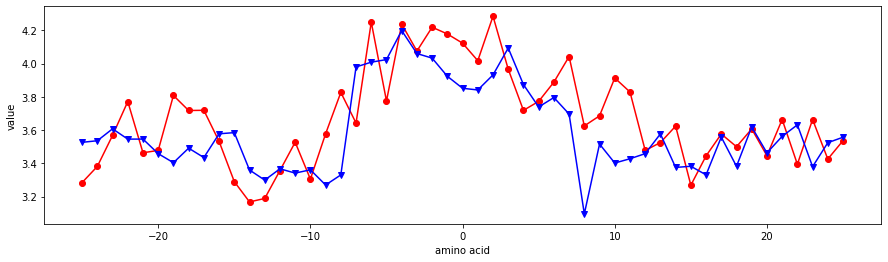

JUNJ780101


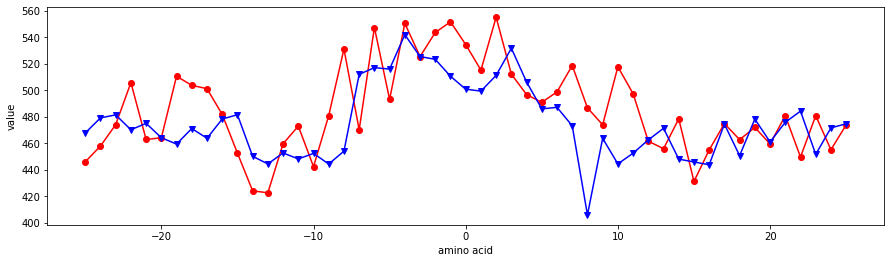

KANM800101


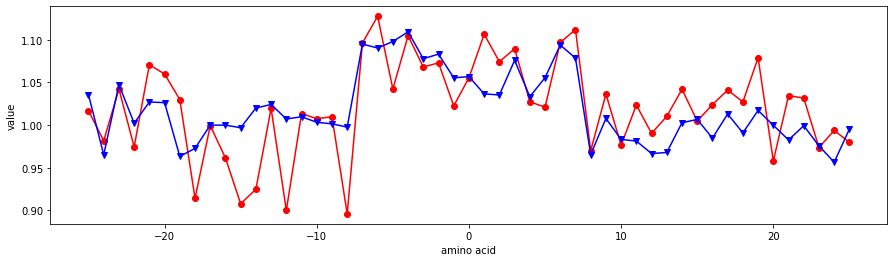

KANM800102


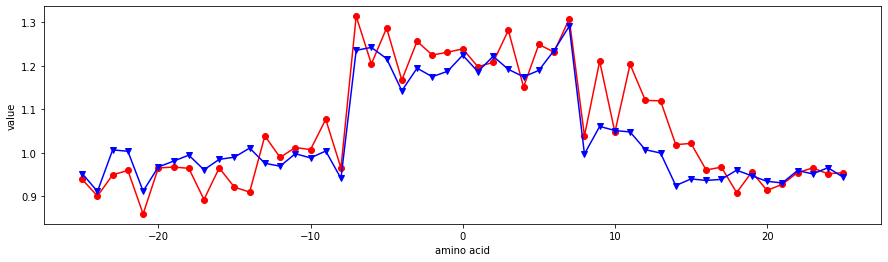

KANM800103


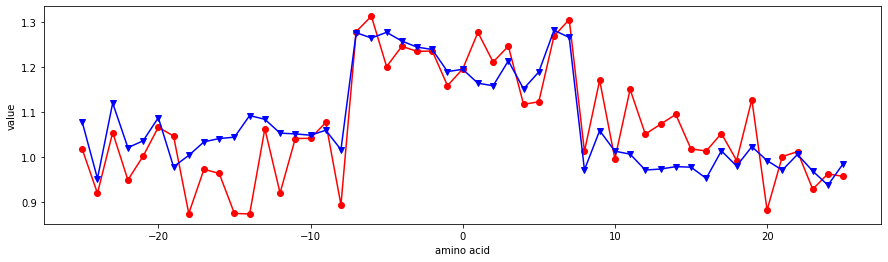

KANM800104


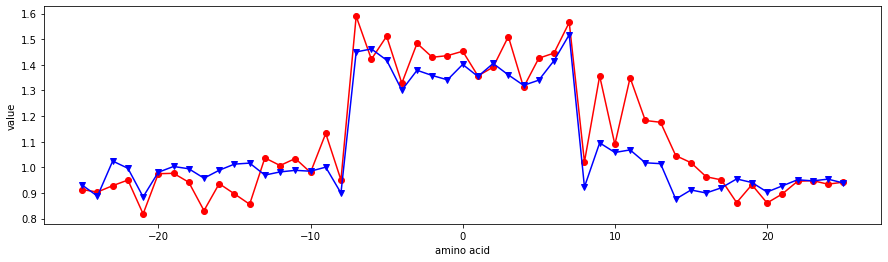

KARP850101


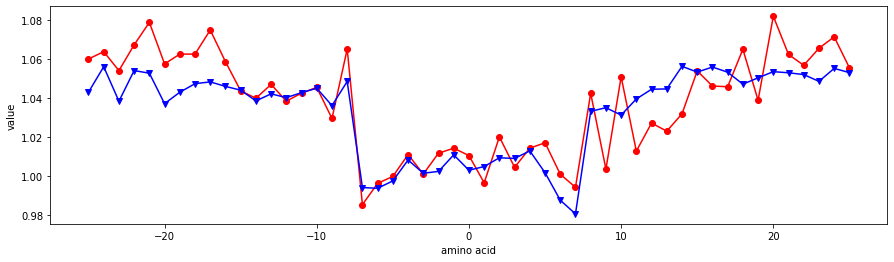

KARP850102


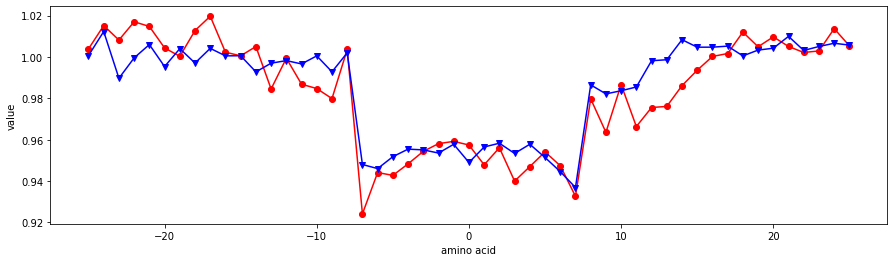

KARP850103


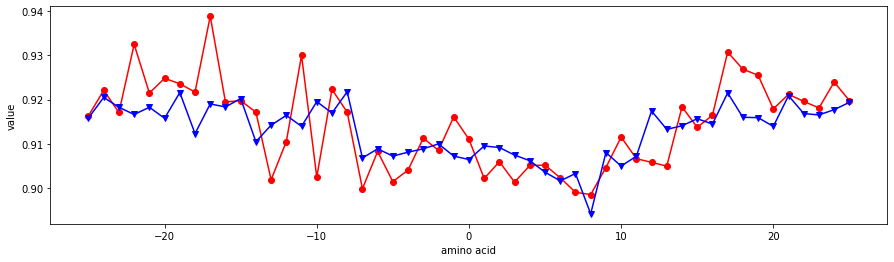

KHAG800101


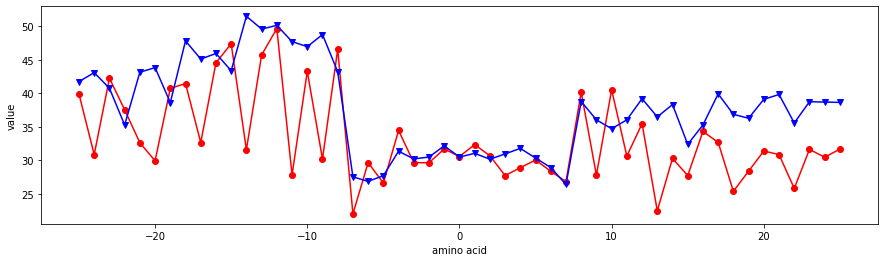

KLEP840101


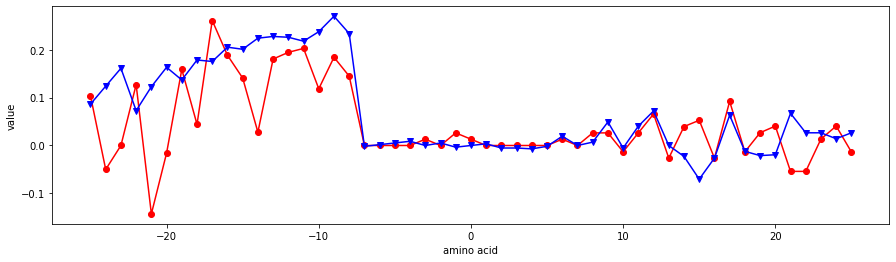

KRIW710101


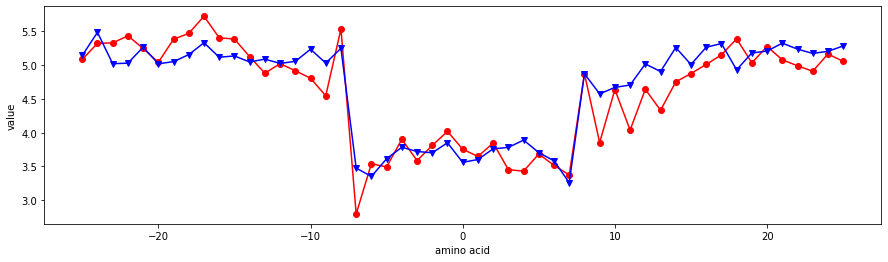

KRIW790101


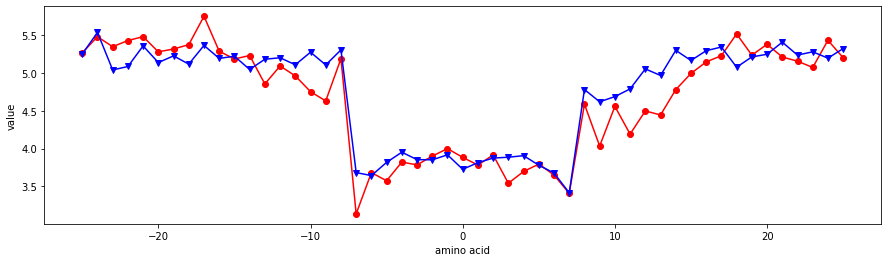

KRIW790102


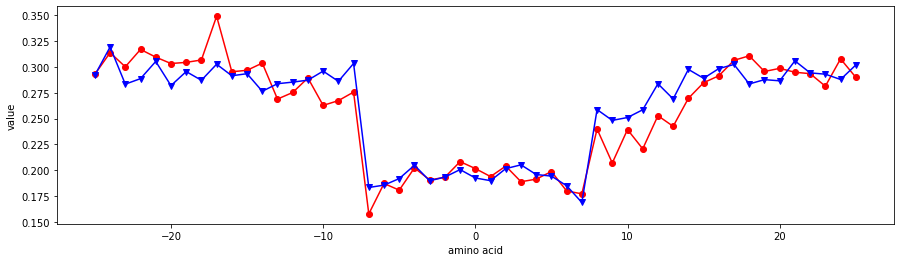

KRIW790103


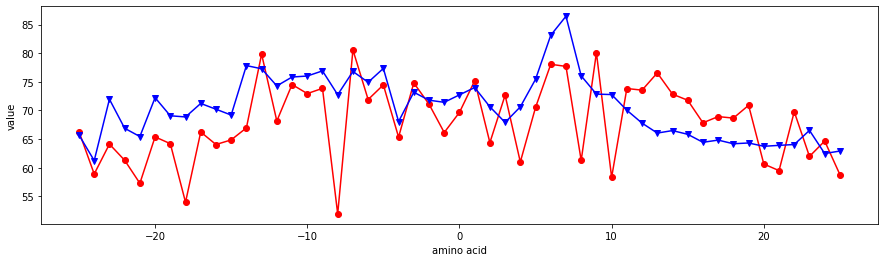

KYTJ820101


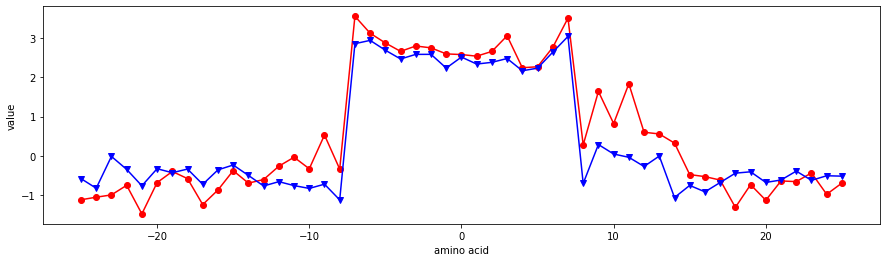

LAWE840101


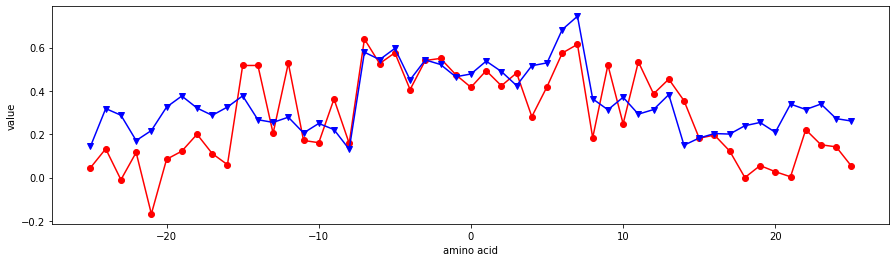

LEVM760101


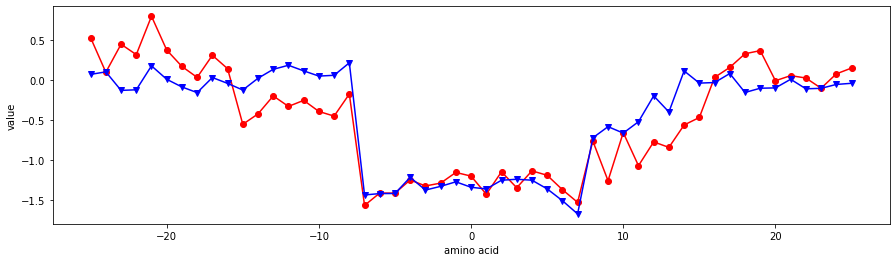

LEVM760102


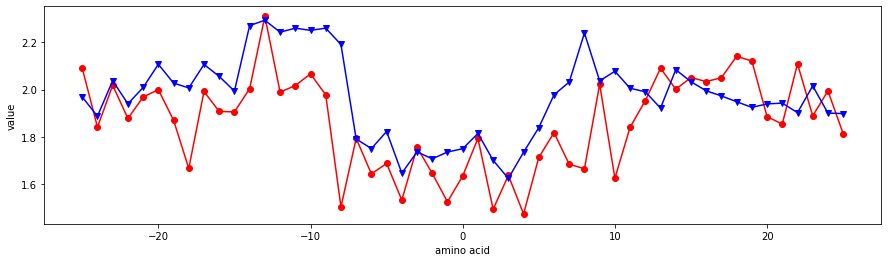

LEVM760103


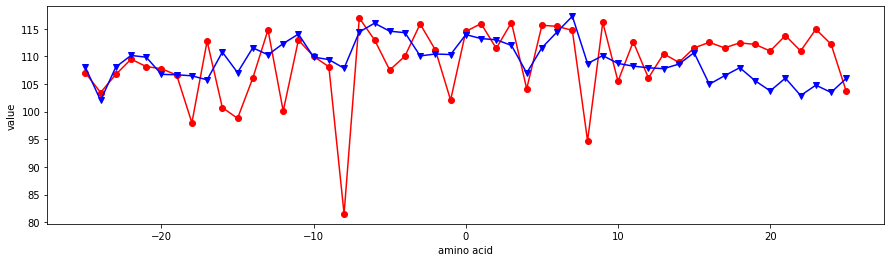

LEVM760104


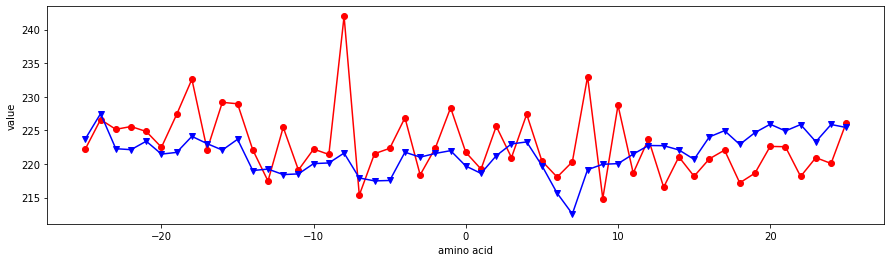

LEVM760105


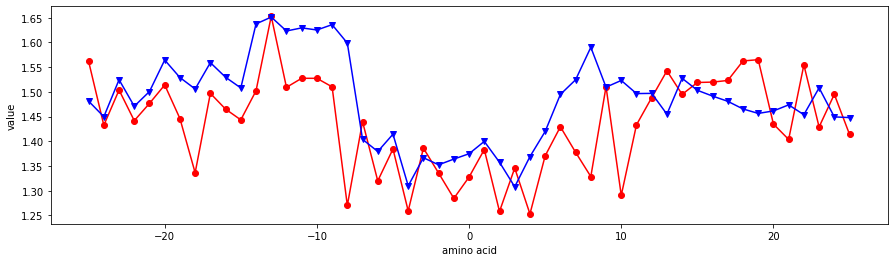

LEVM760106


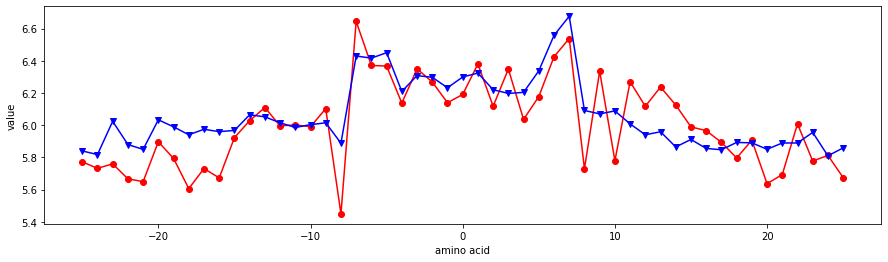

LEVM760107


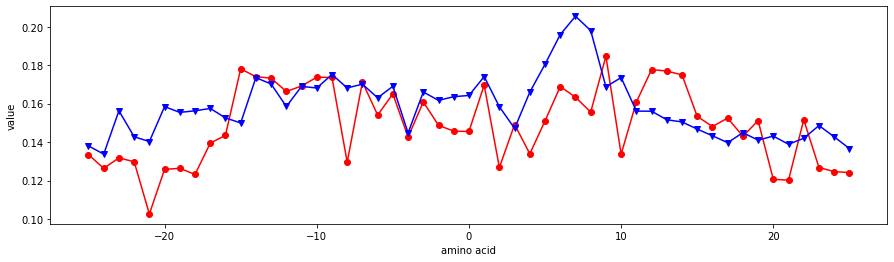

LEVM780101


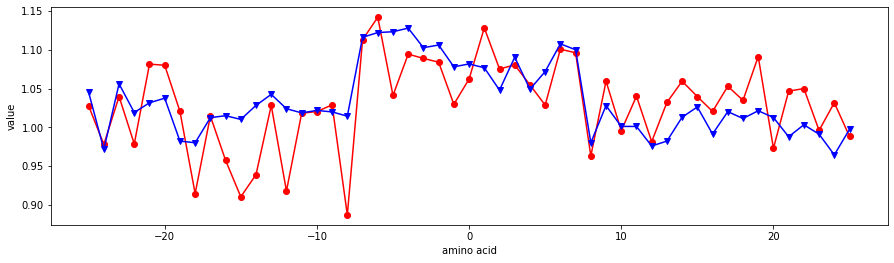

LEVM780102


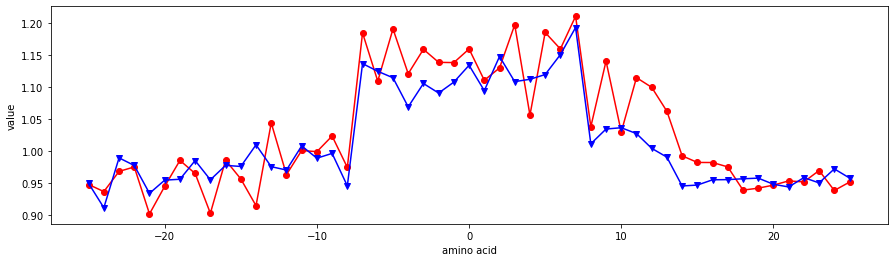

LEVM780103


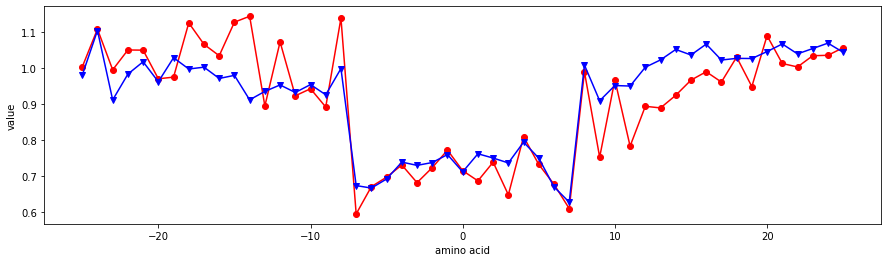

LEVM780104


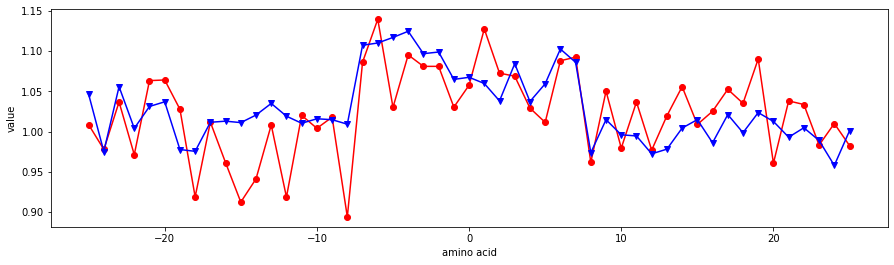

LEVM780105


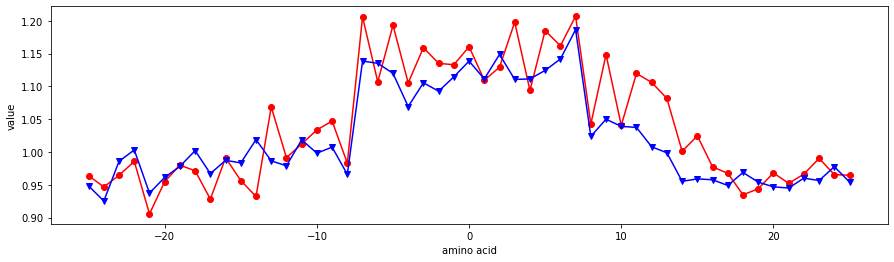

LEVM780106


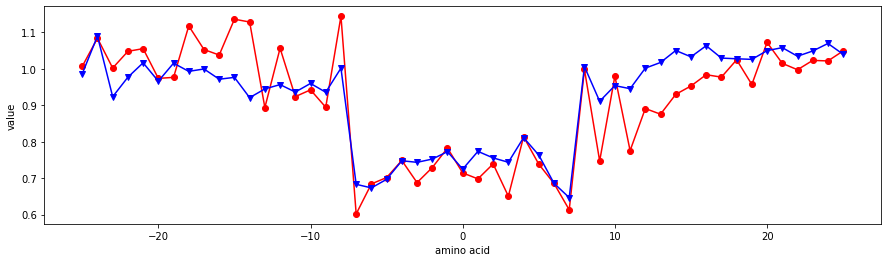

LEWP710101


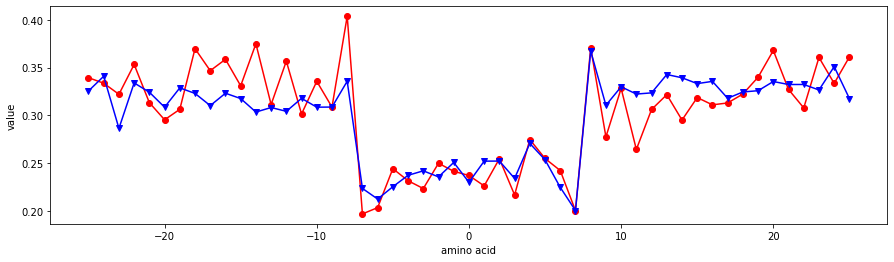

LIFS790101


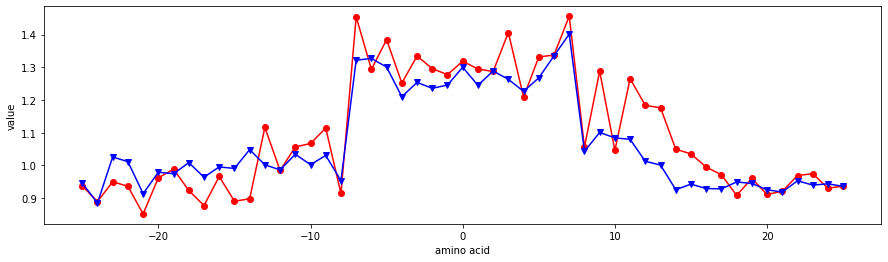

LIFS790102


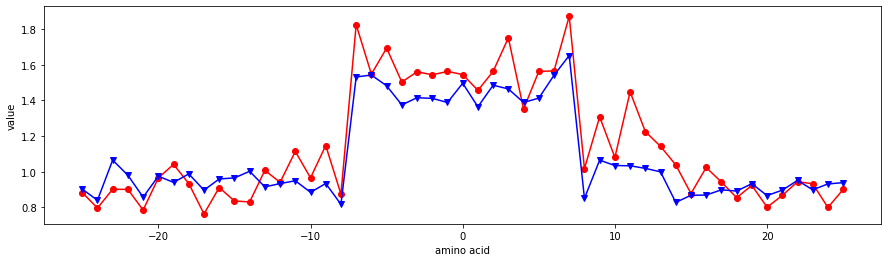

LIFS790103


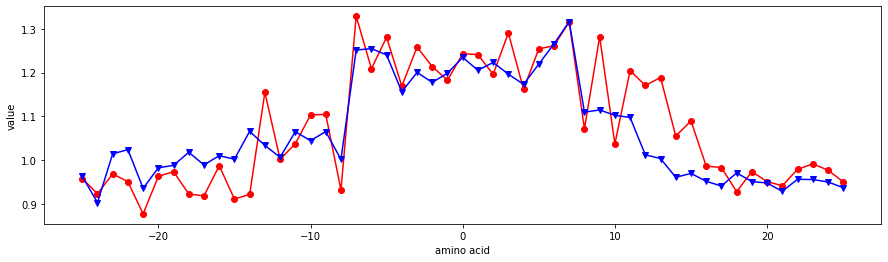

MANP780101


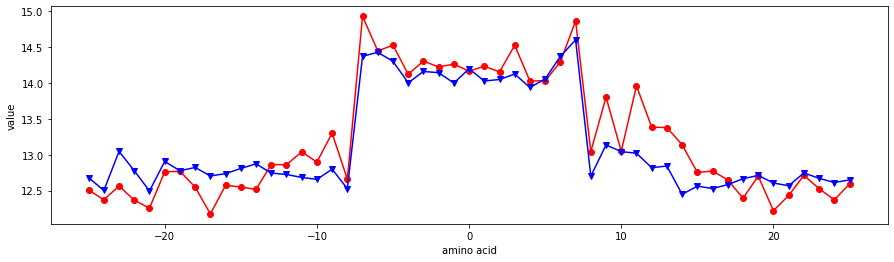

MAXF760101


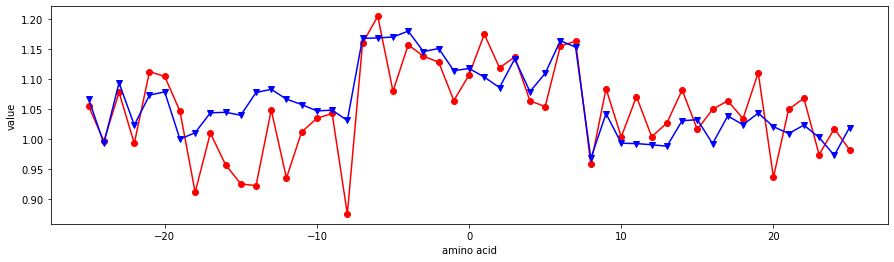

MAXF760102


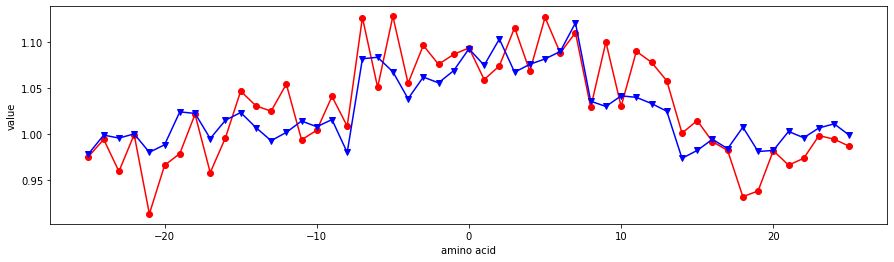

MAXF760103


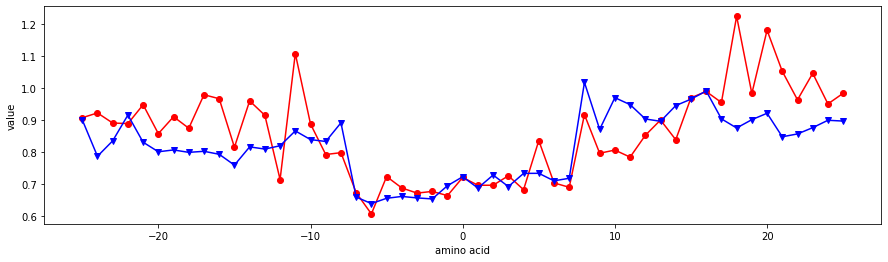

MAXF760104


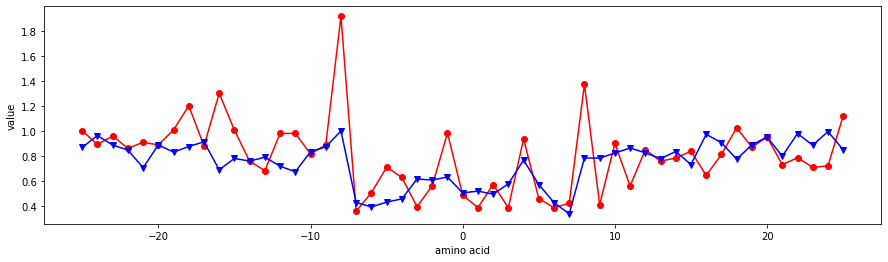

MAXF760105


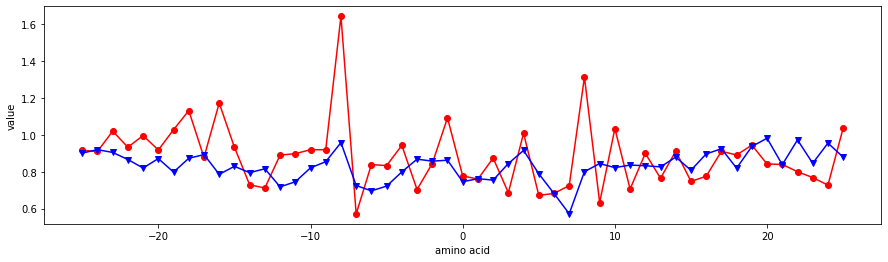

MAXF760106


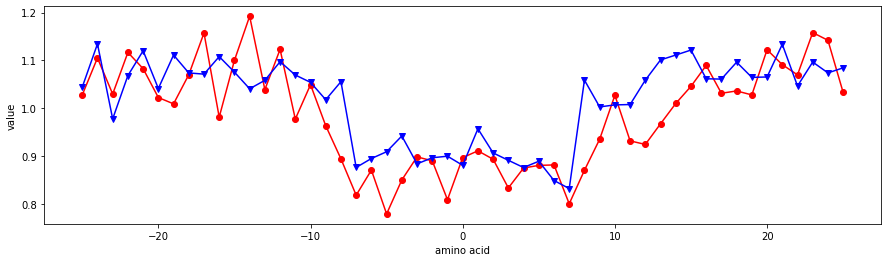

MCMT640101


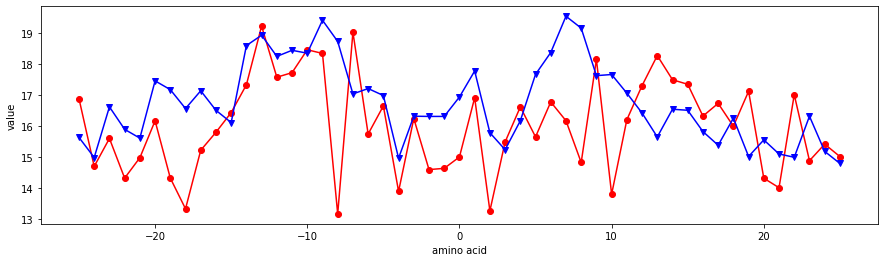

MEEJ800101


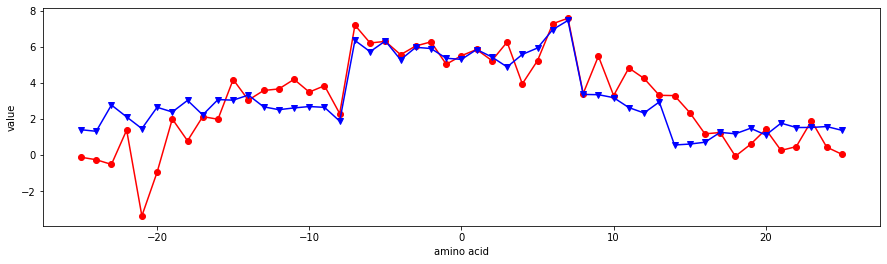

MEEJ800102


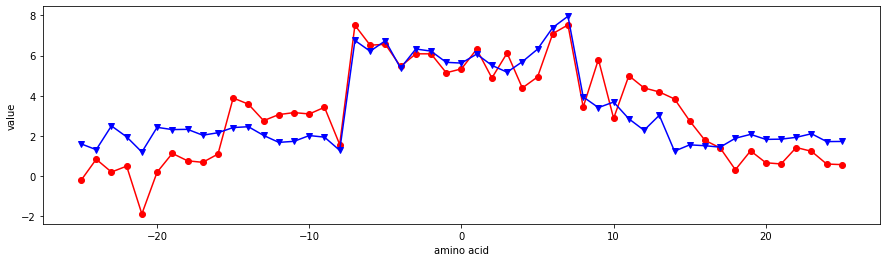

MEEJ810101


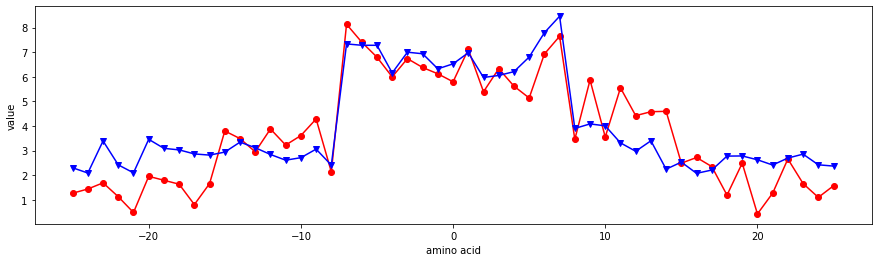

MEEJ810102


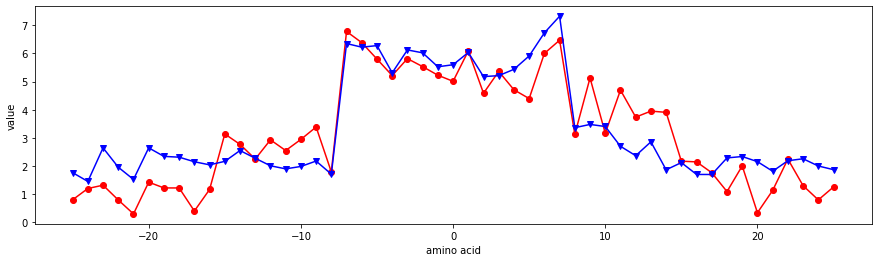

MEIH800101


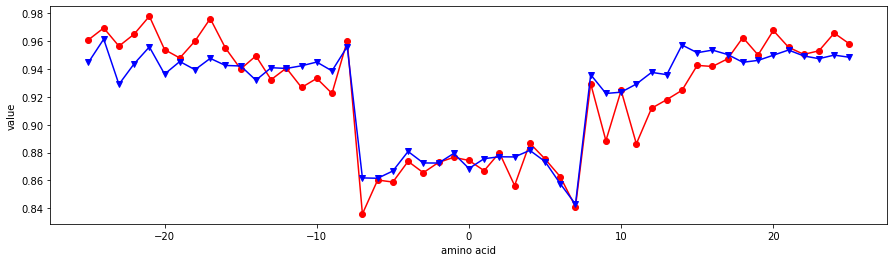

MEIH800102


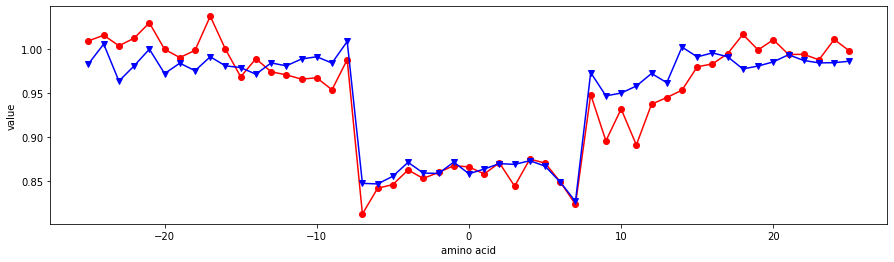

MEIH800103


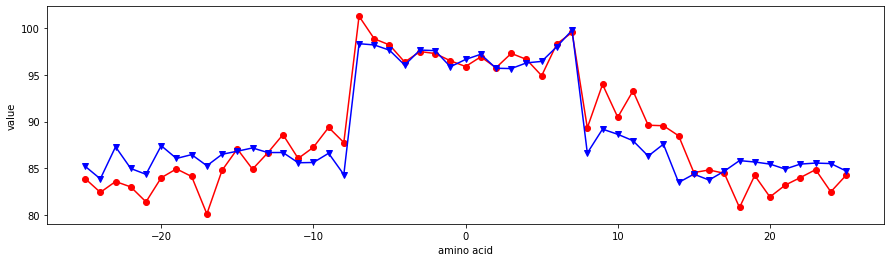

MIYS850101


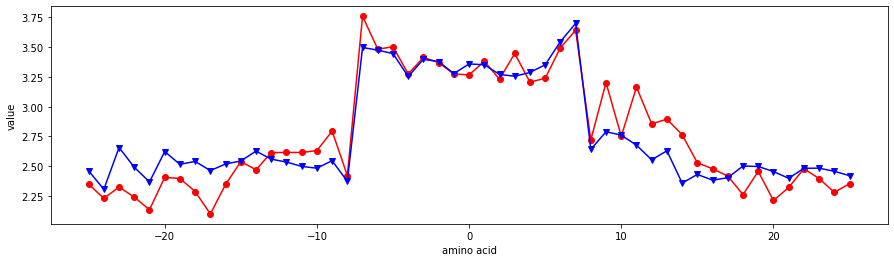

NAGK730101


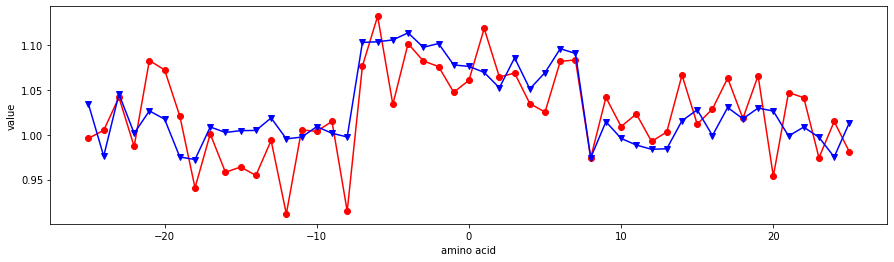

NAGK730102


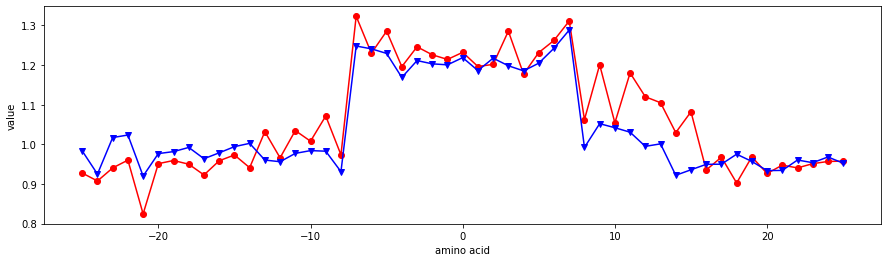

NAGK730103


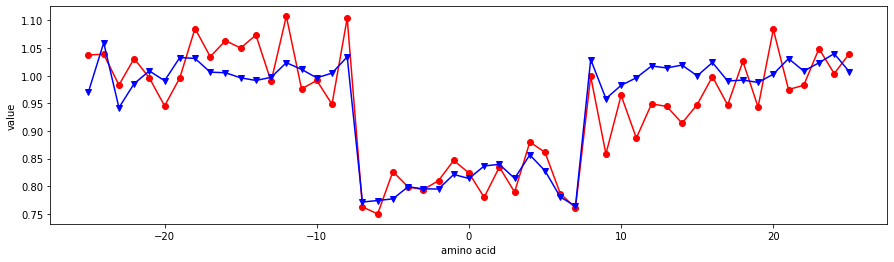

NAKH900101


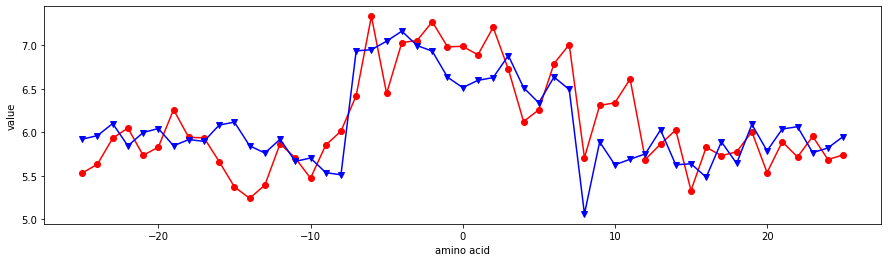

NAKH900102


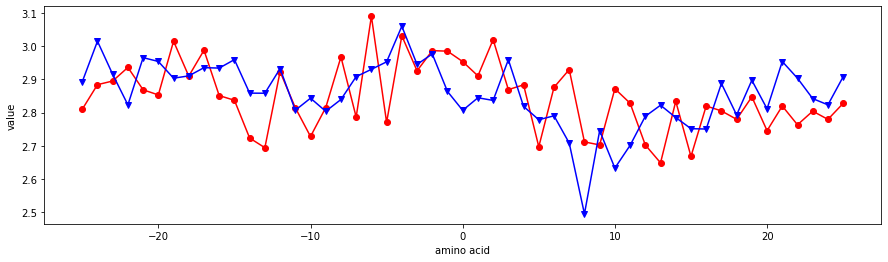

NAKH900103


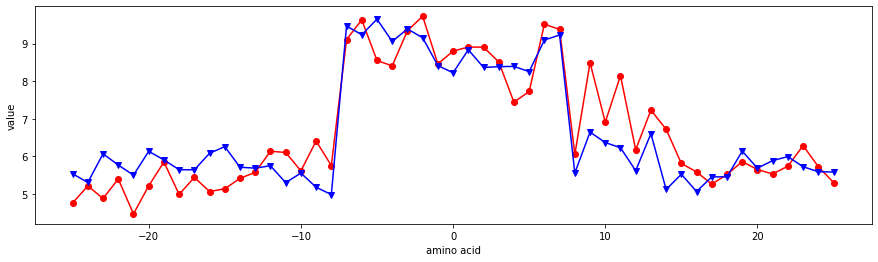

NAKH900104


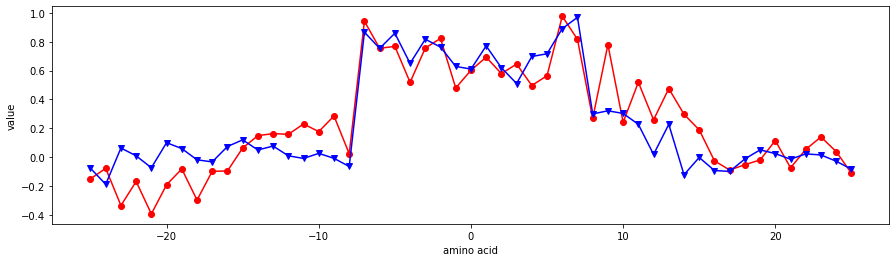

NAKH900105


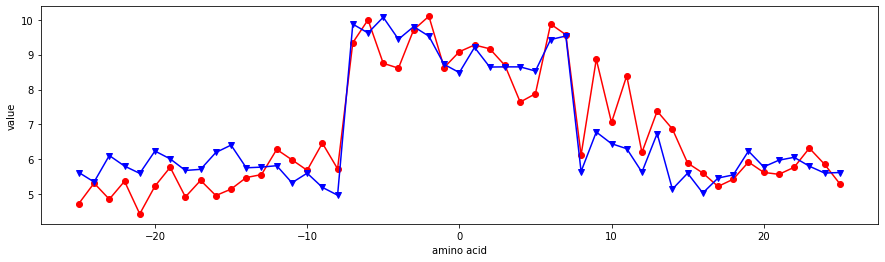

NAKH900106


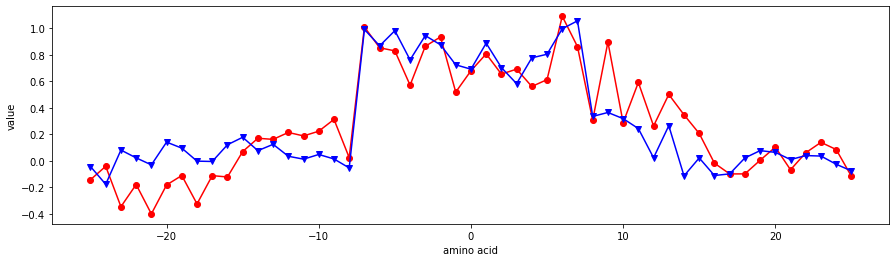

NAKH900107


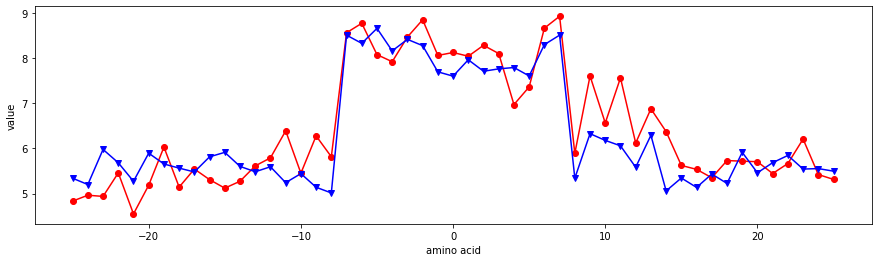

NAKH900108


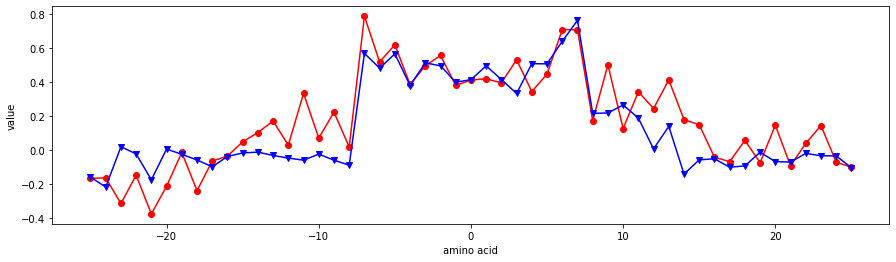

NAKH900109


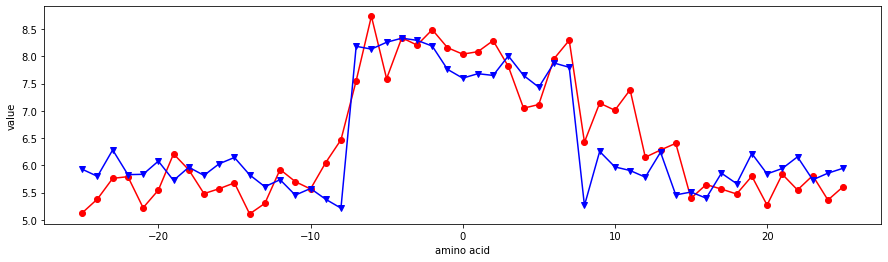

NAKH900110


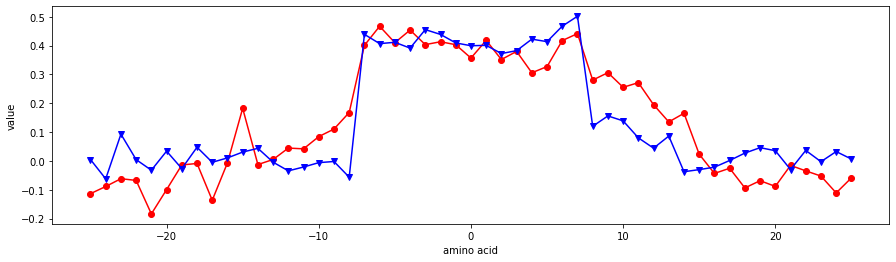

NAKH900111


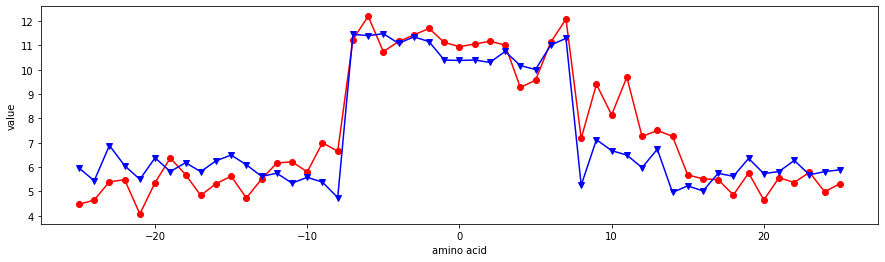

NAKH900112


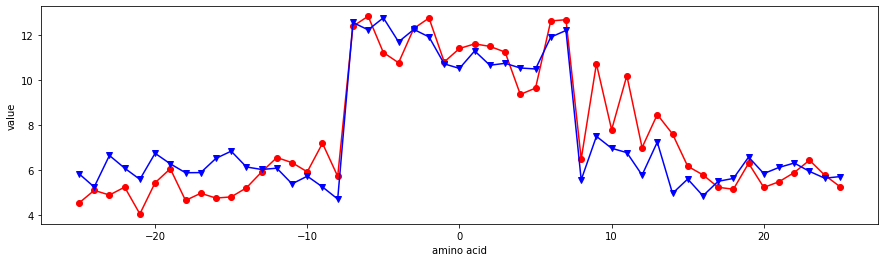

NAKH900113


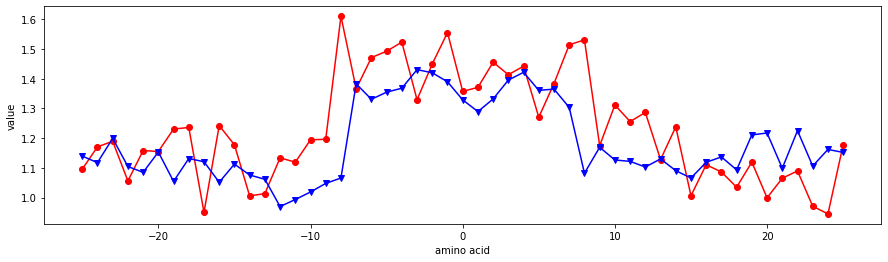

NAKH920101


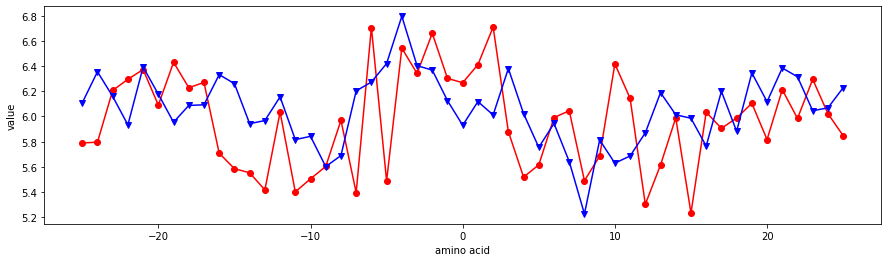

NAKH920102


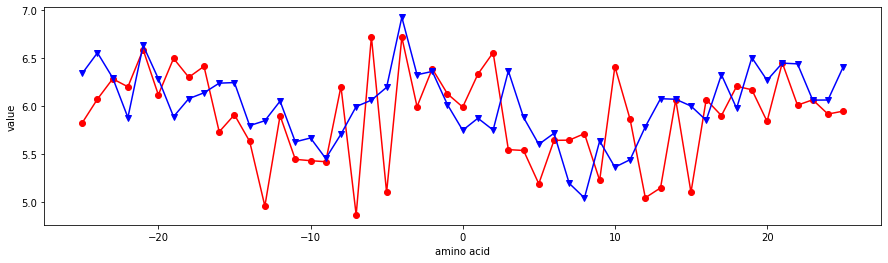

NAKH920103


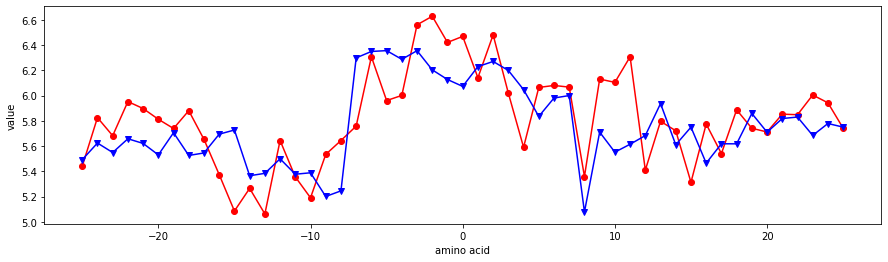

NAKH920104


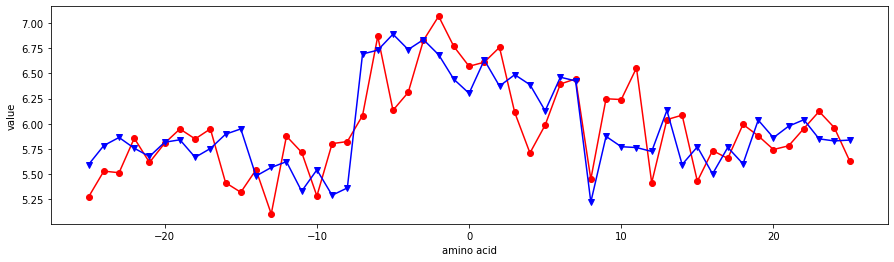

NAKH920105


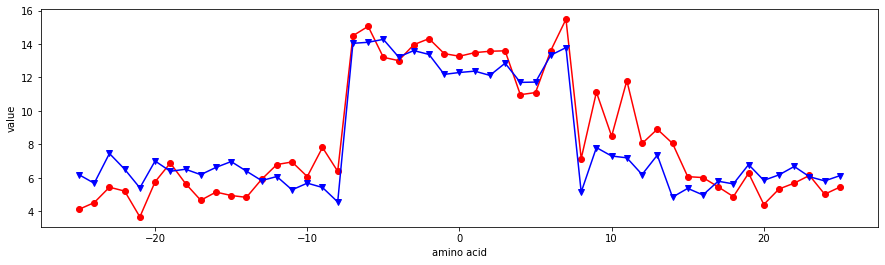

NAKH920106


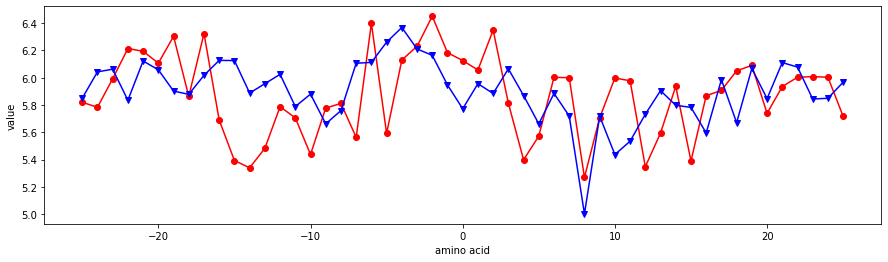

NAKH920107


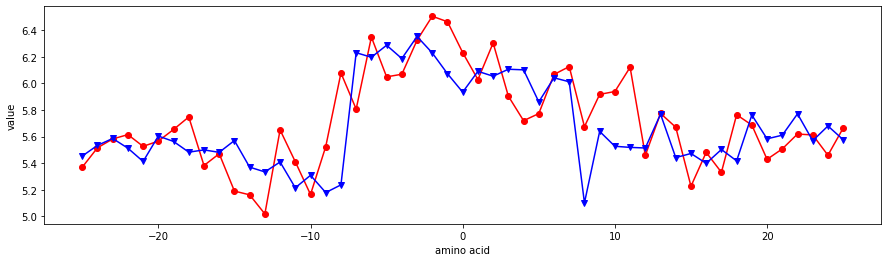

NAKH920108


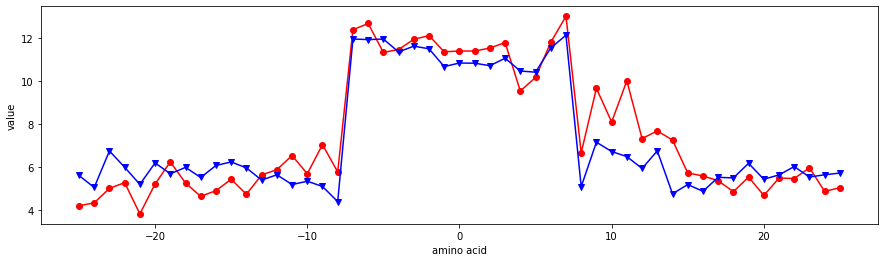

NISK800101


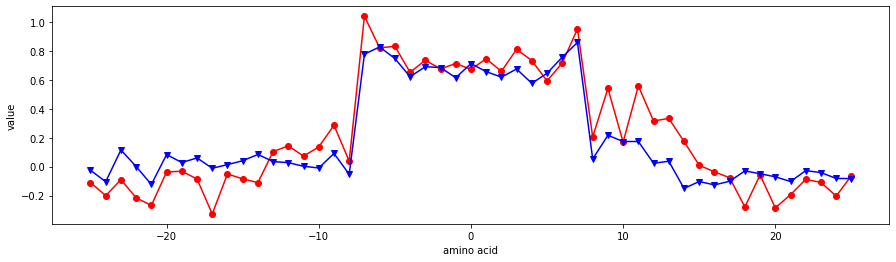

NISK860101


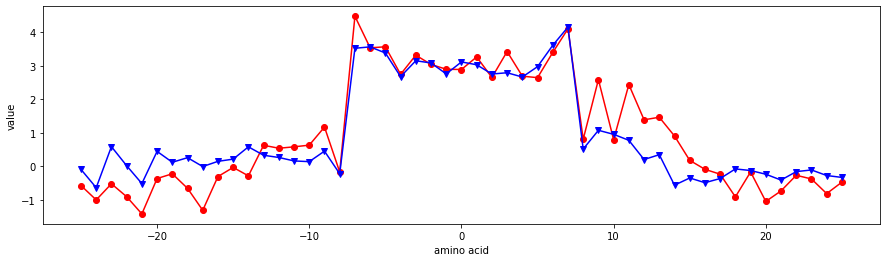

NOZY710101


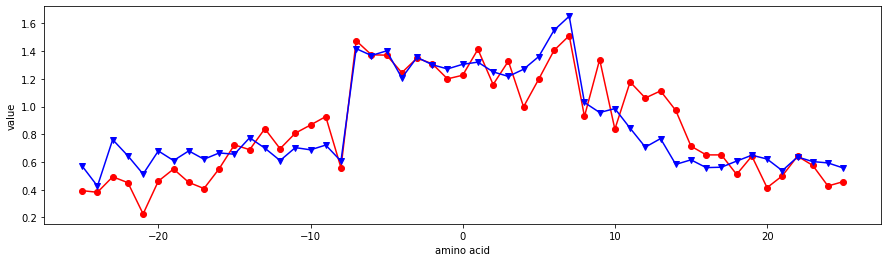

OOBM770101


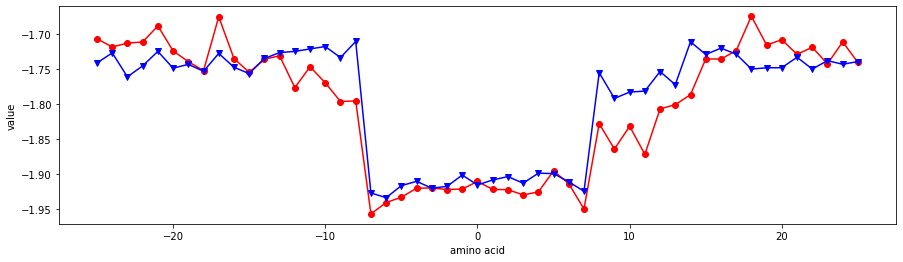

OOBM770102


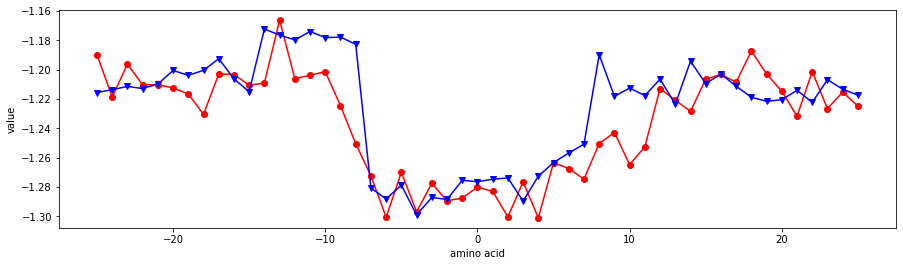

OOBM770103


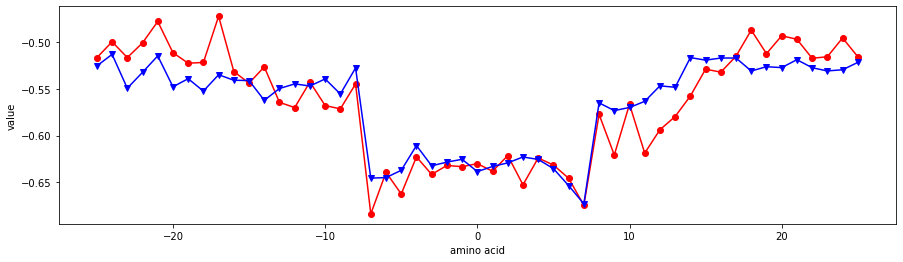

OOBM770104


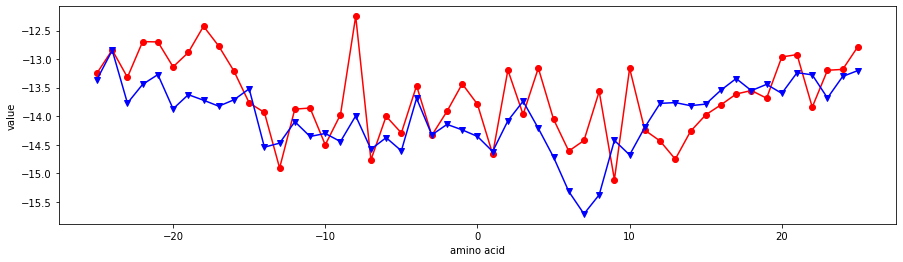

OOBM770105


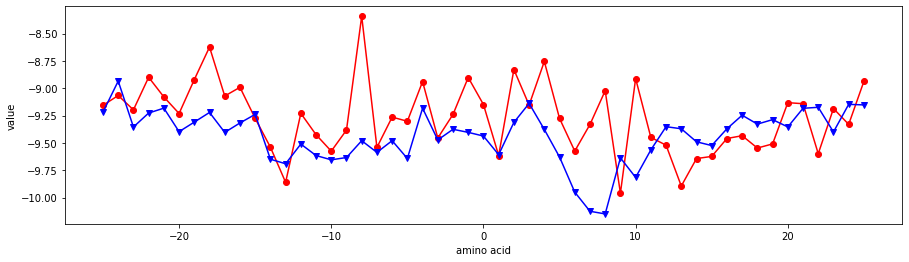

OOBM850101


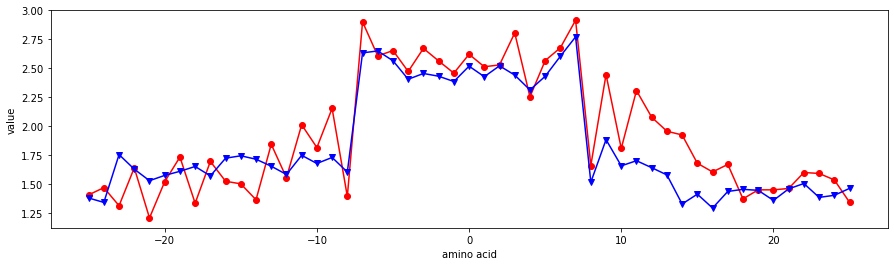

OOBM850102


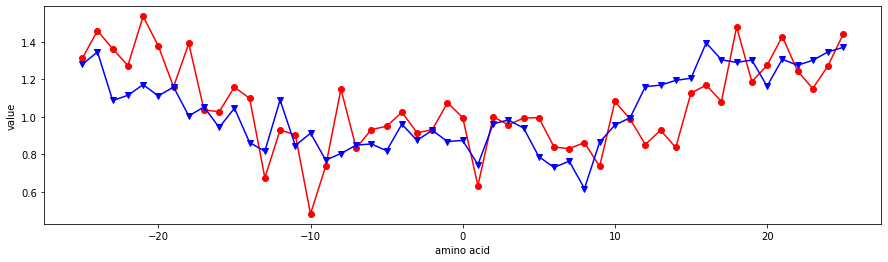

OOBM850103


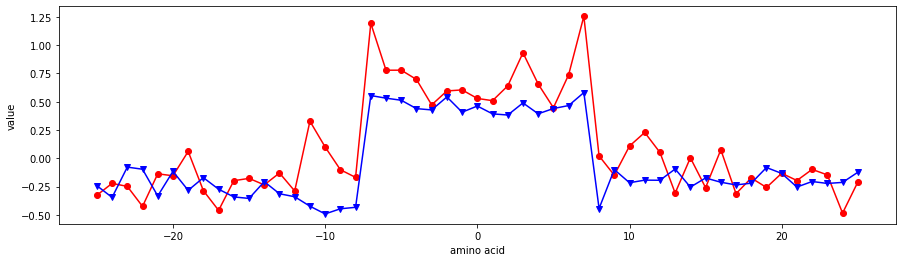

OOBM850104


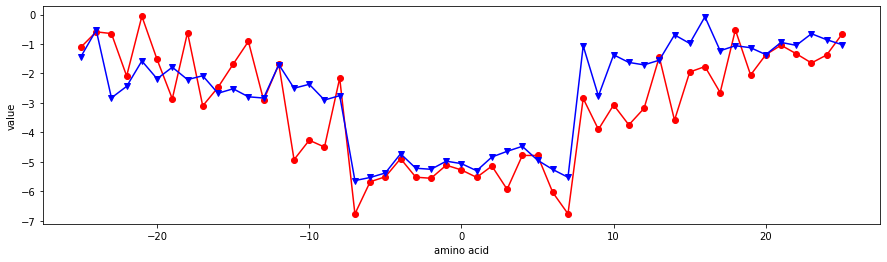

OOBM850105


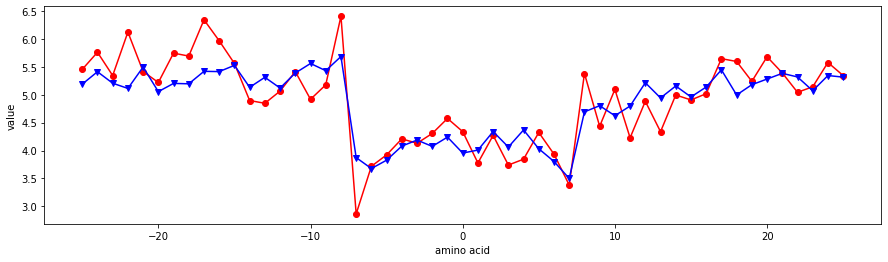

PALJ810101


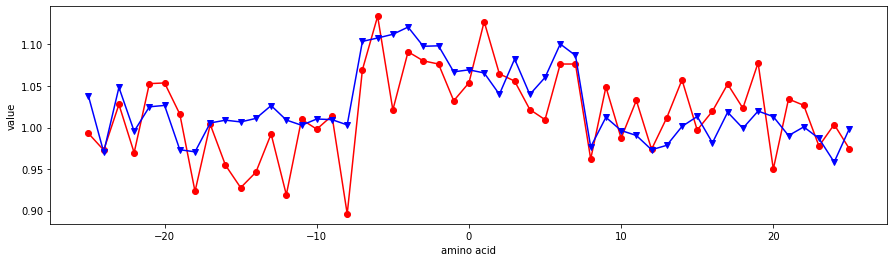

PALJ810102


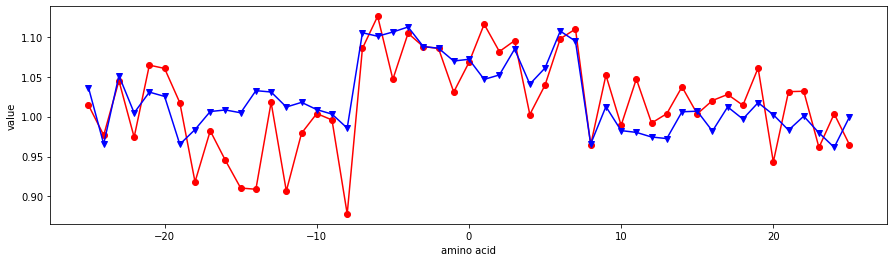

PALJ810103


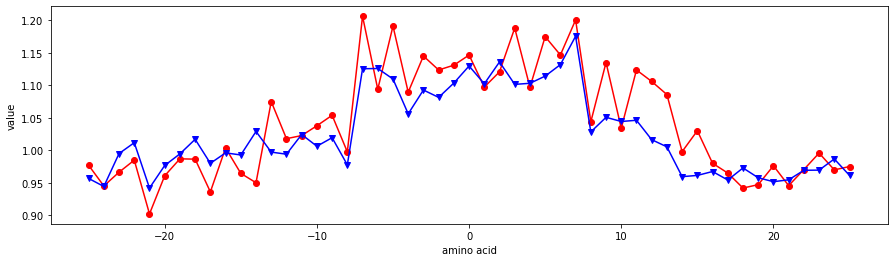

PALJ810104


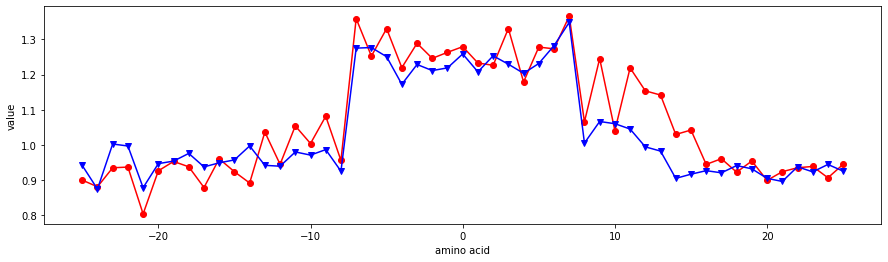

PALJ810105


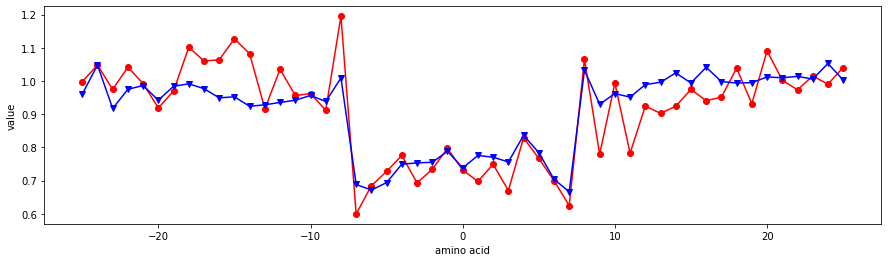

PALJ810106


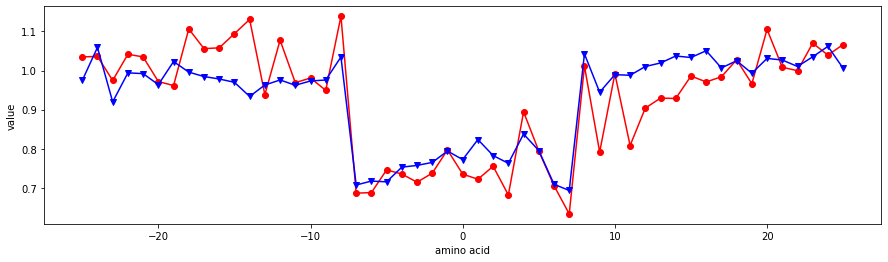

PALJ810107


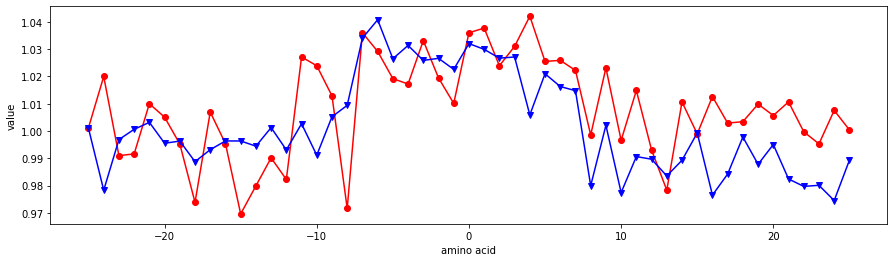

PALJ810108


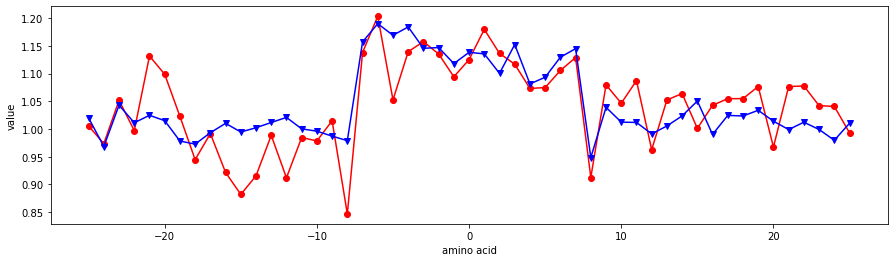

PALJ810109


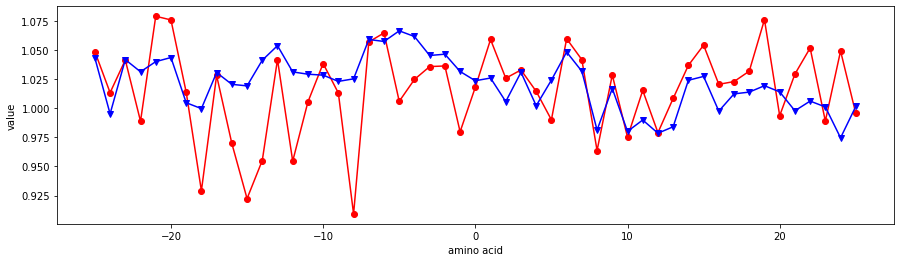

PALJ810110


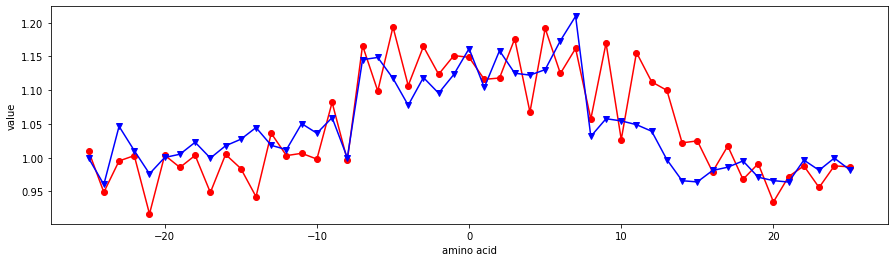

PALJ810111


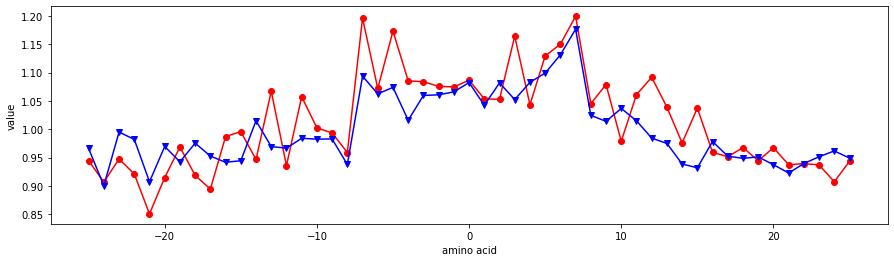

PALJ810112


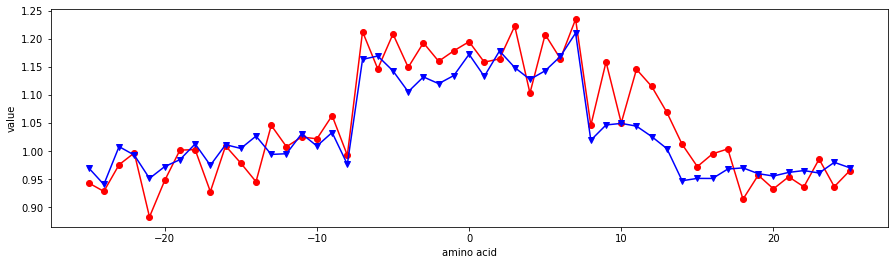

PALJ810113


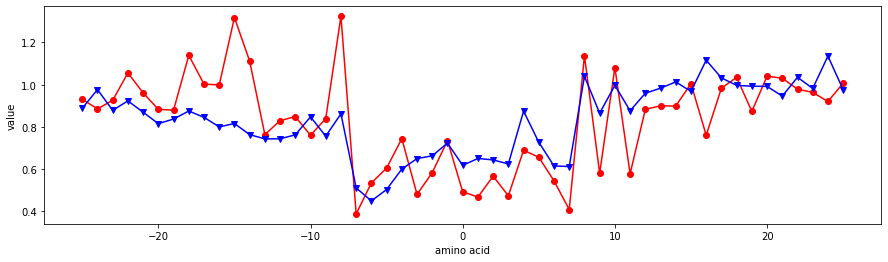

PALJ810114


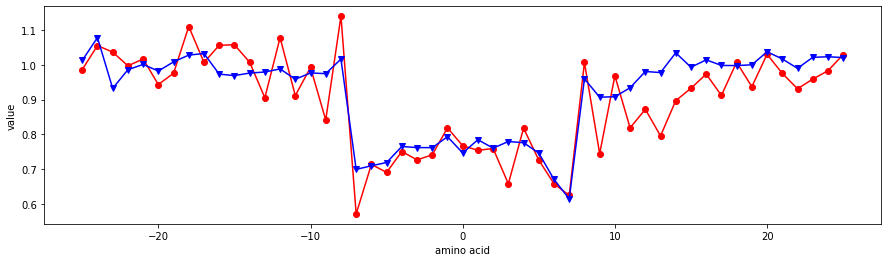

PALJ810115


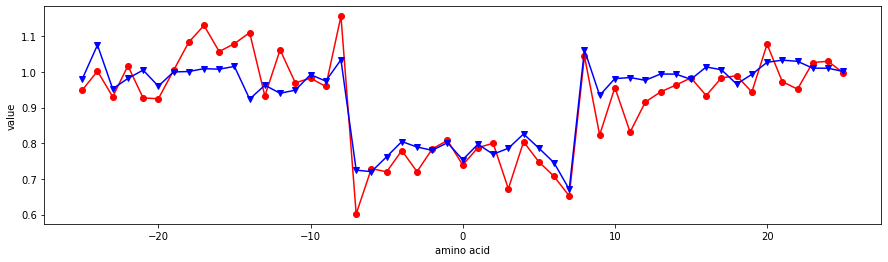

PALJ810116


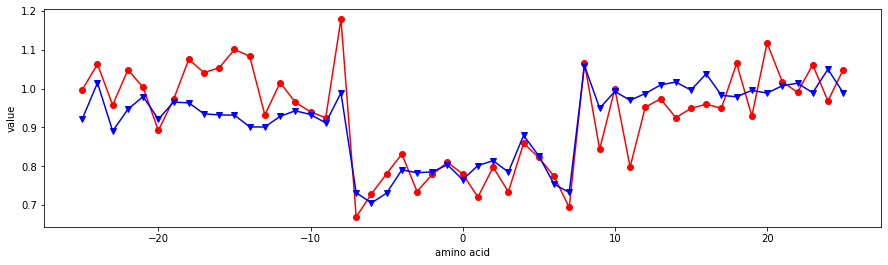

PARJ860101


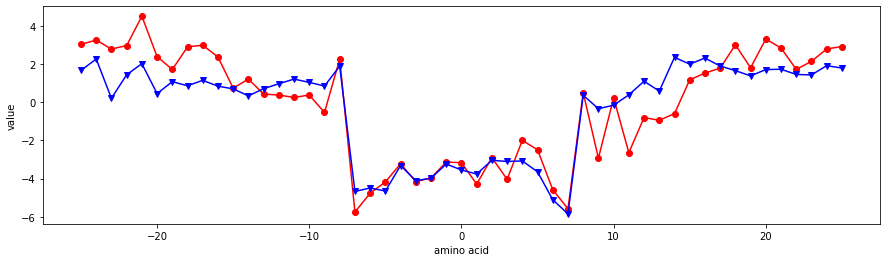

PLIV810101


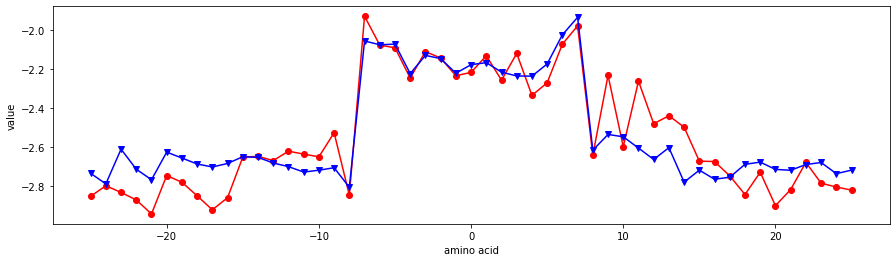

PONP800101


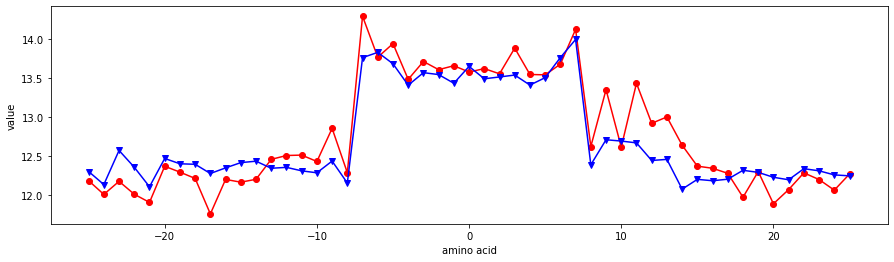

PONP800102


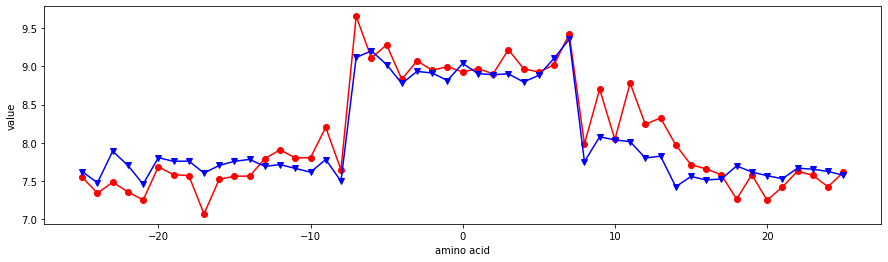

PONP800103


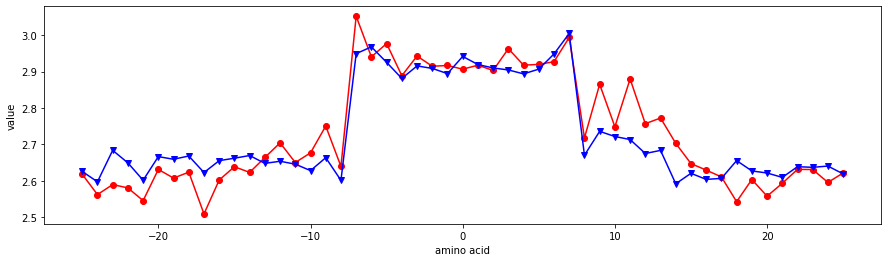

PONP800104


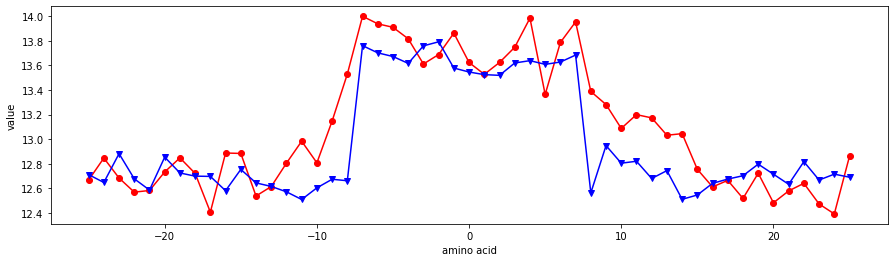

PONP800105


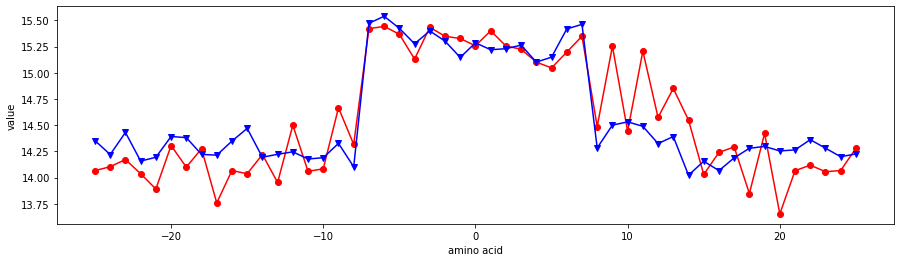

PONP800106


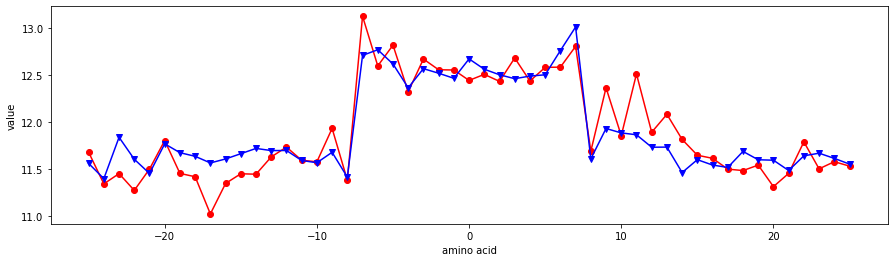

PONP800107


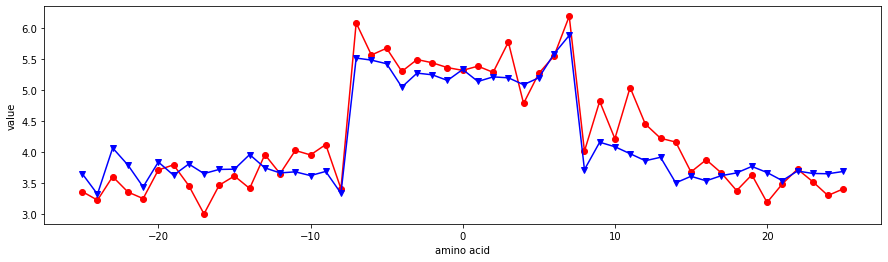

PONP800108


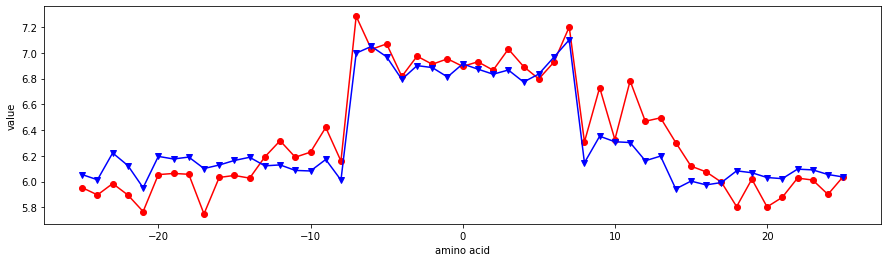

PRAM820101


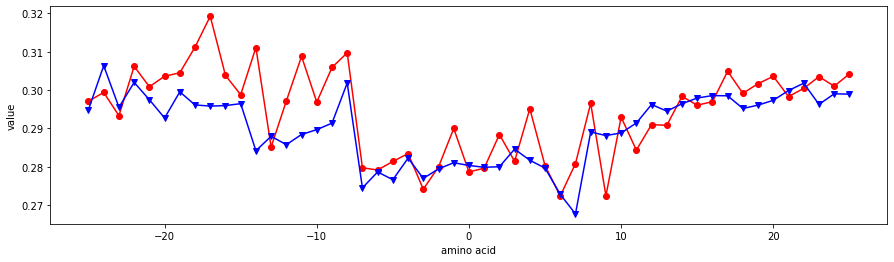

PRAM820102


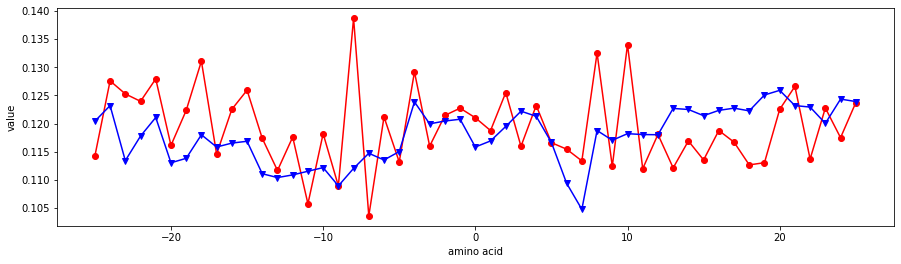

PRAM820103


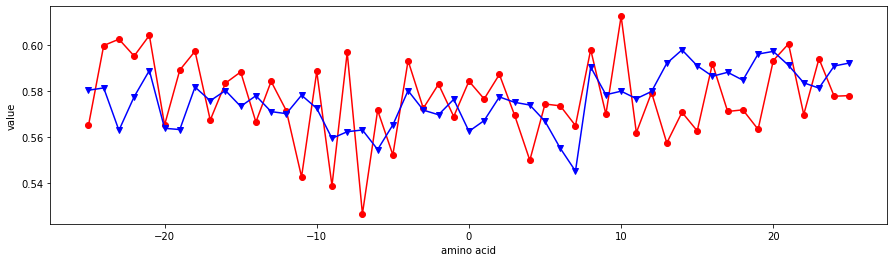

PRAM900101


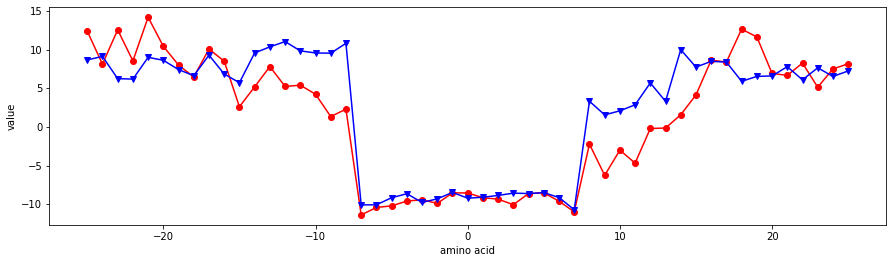

PRAM900102


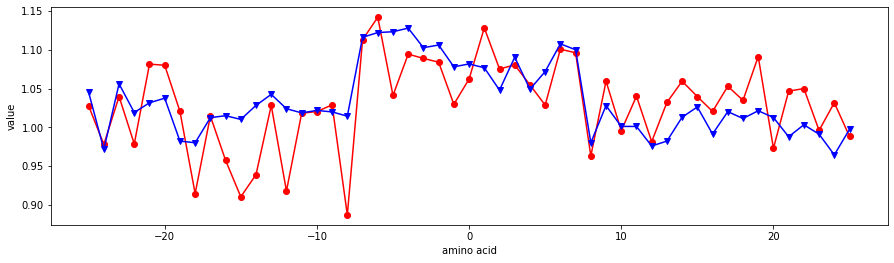

PRAM900103


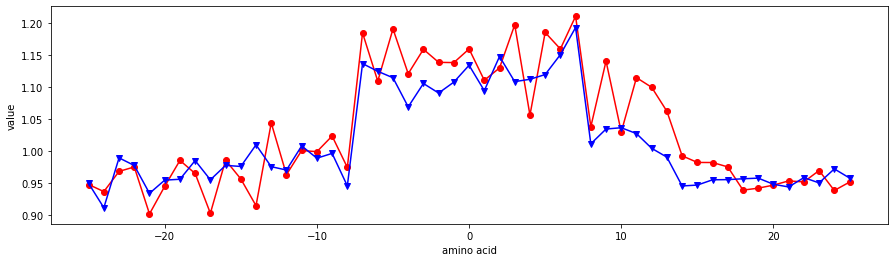

PRAM900104


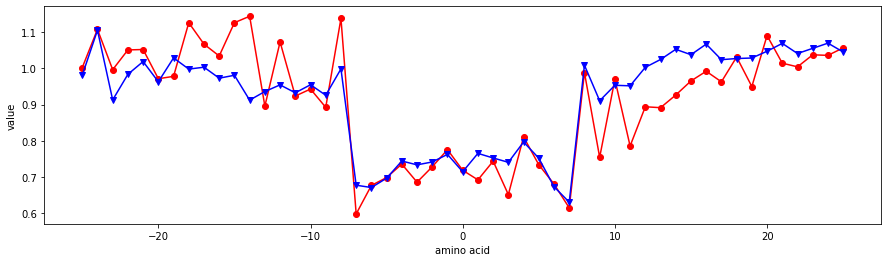

PTIO830101


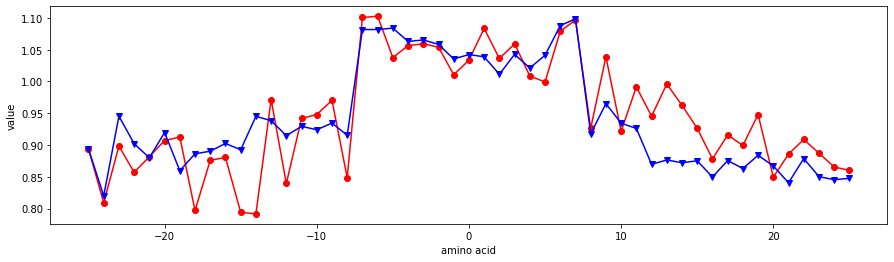

PTIO830102


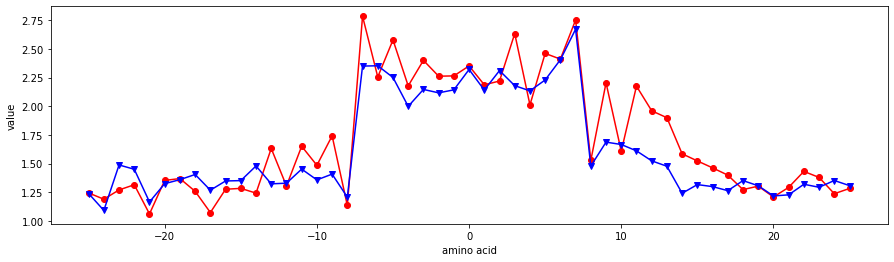

QIAN880101


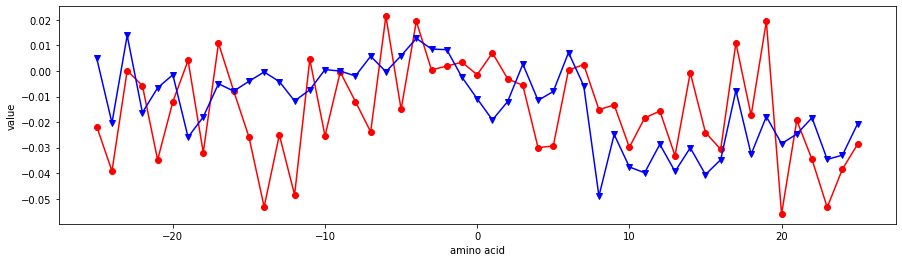

QIAN880102


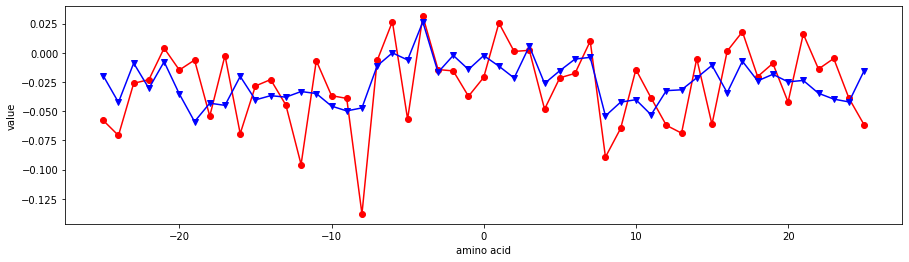

QIAN880103


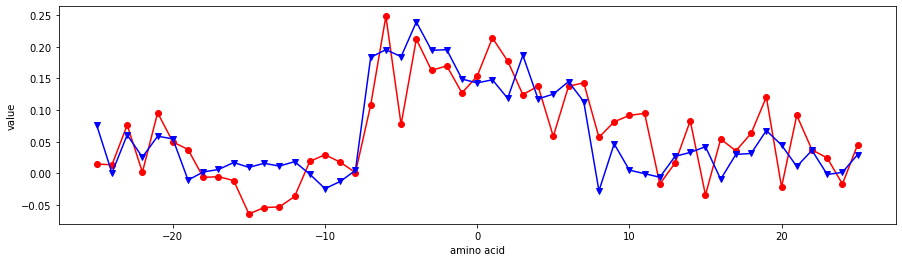

QIAN880104


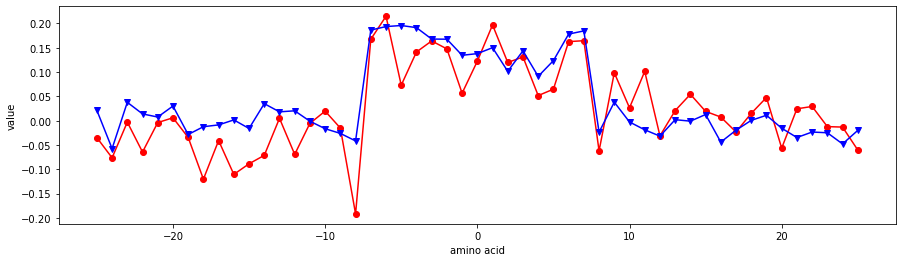

QIAN880105


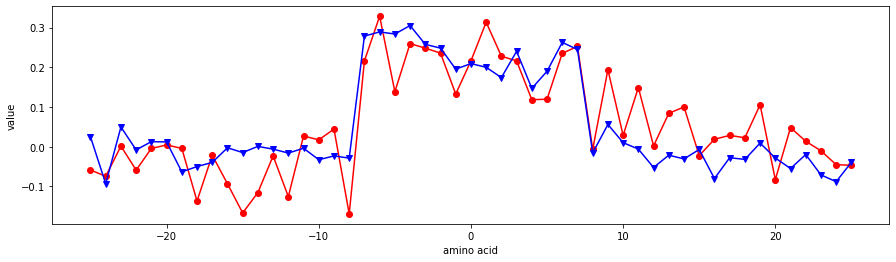

QIAN880106


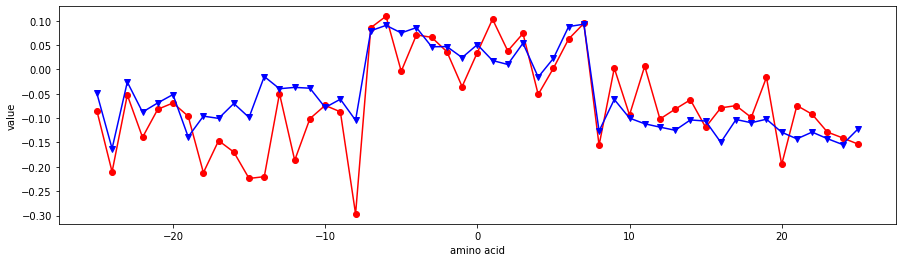

QIAN880107


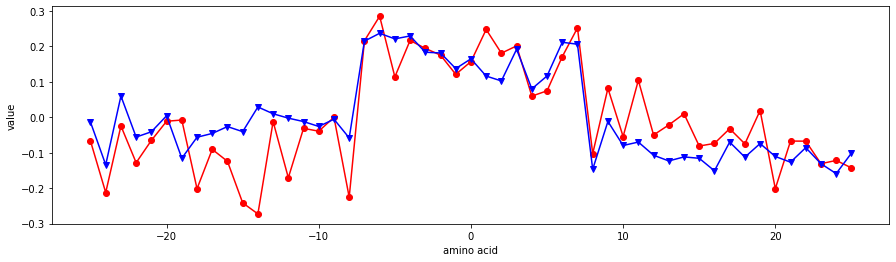

QIAN880108


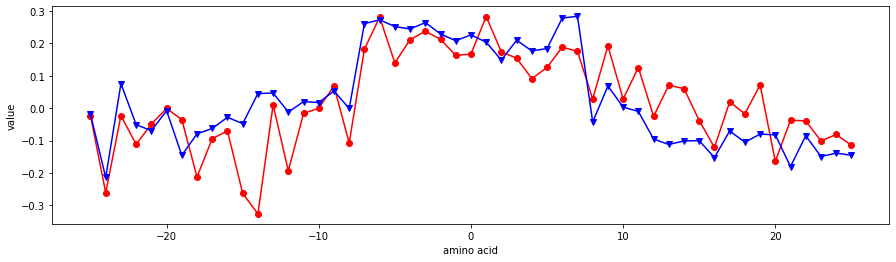

QIAN880109


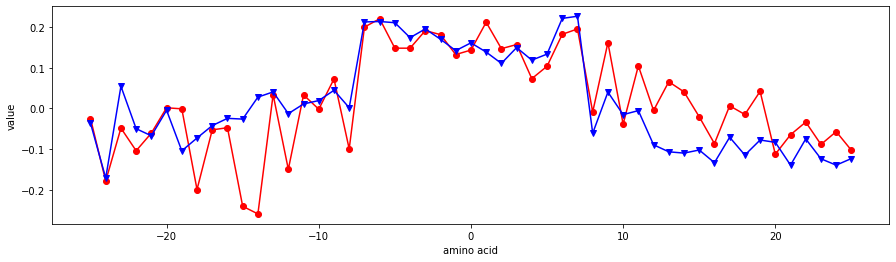

QIAN880110


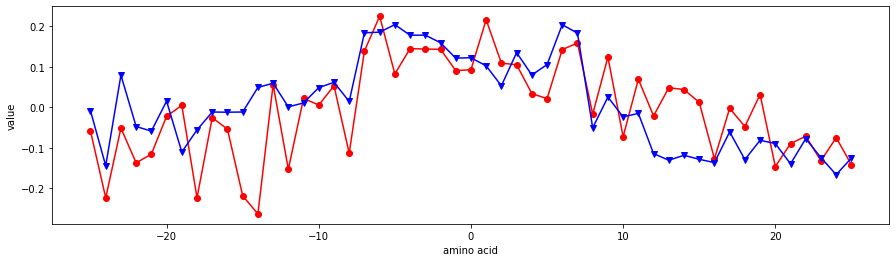

QIAN880111


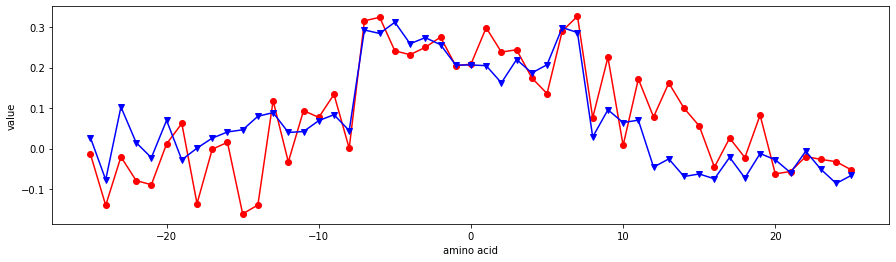

QIAN880112


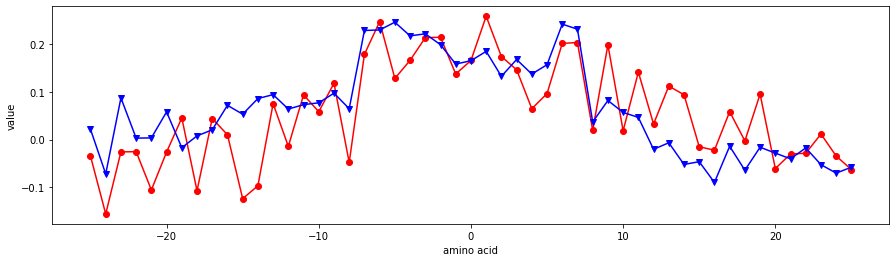

QIAN880113


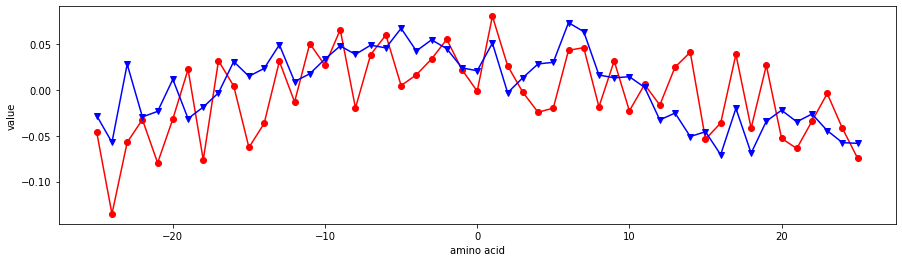

QIAN880114


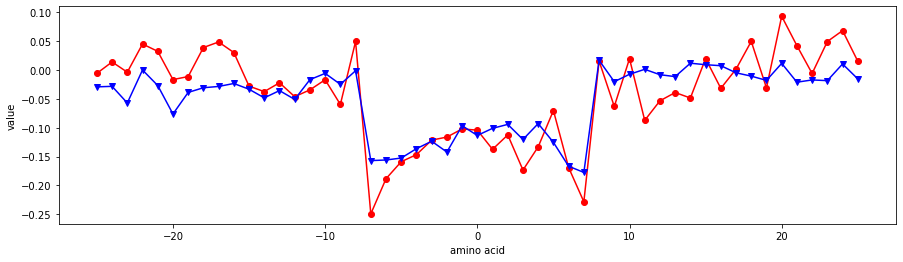

QIAN880115


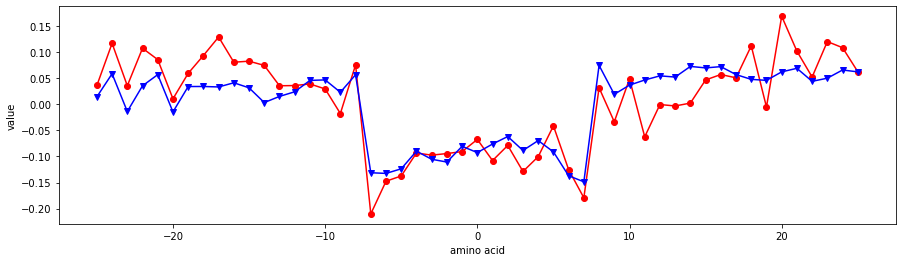

QIAN880116


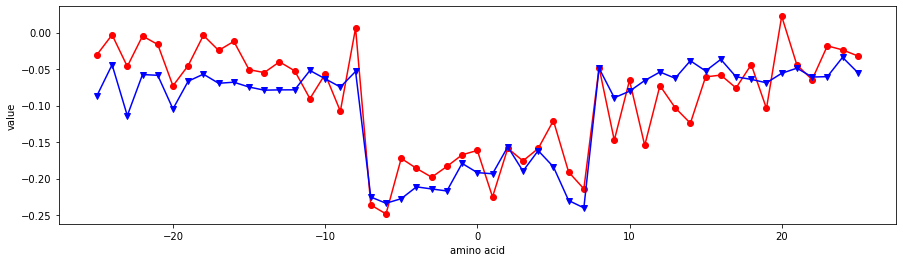

QIAN880117


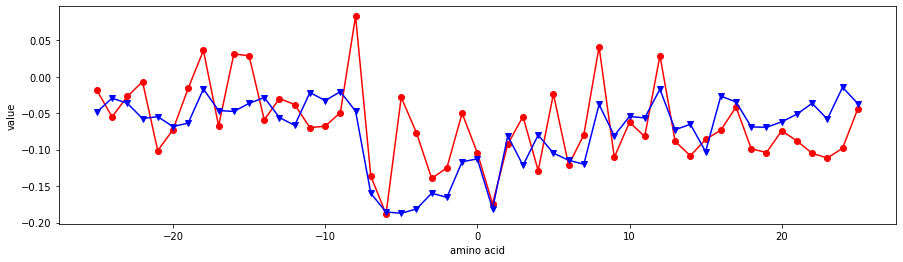

QIAN880118


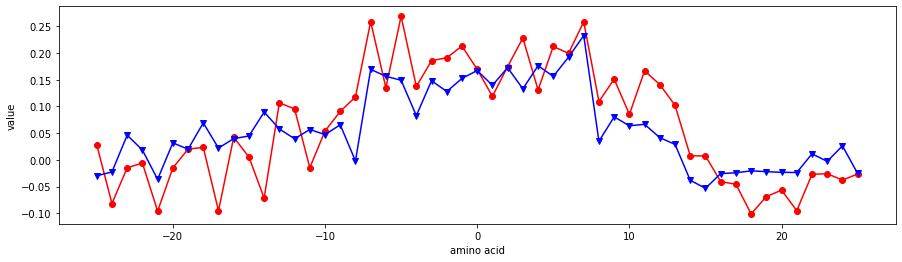

QIAN880119


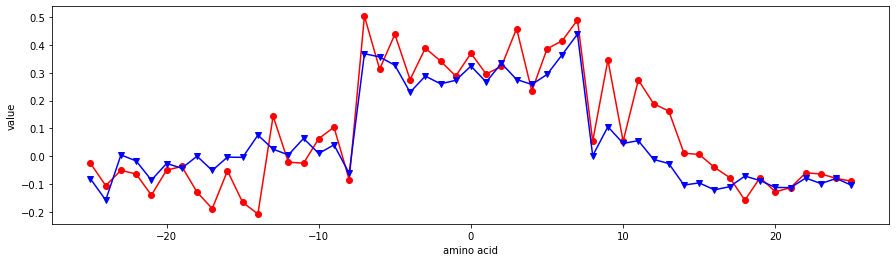

QIAN880120


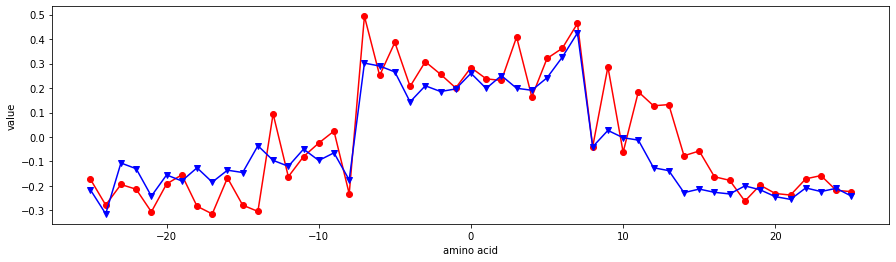

QIAN880121


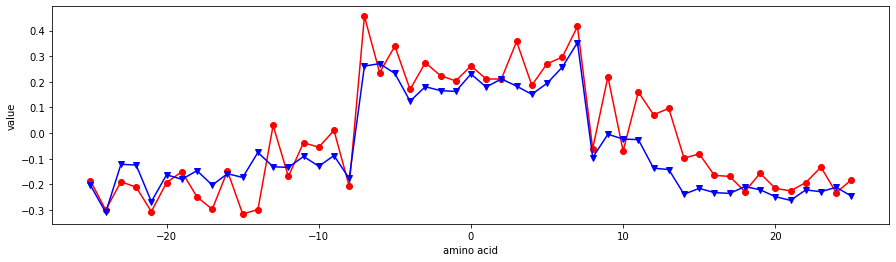

QIAN880122


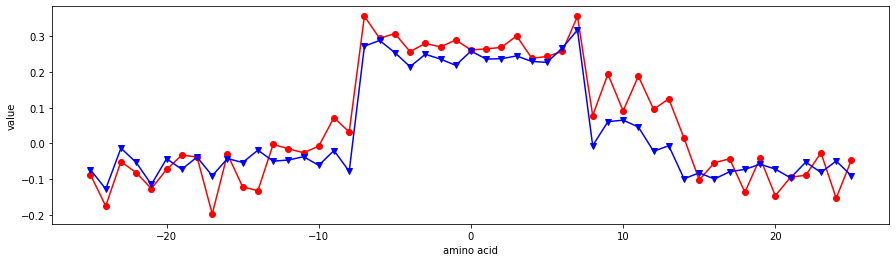

QIAN880123


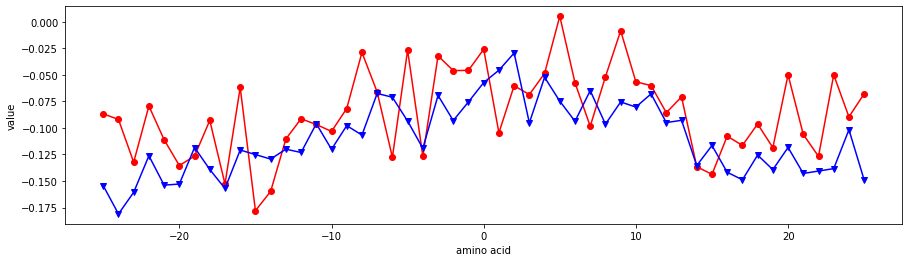

QIAN880124


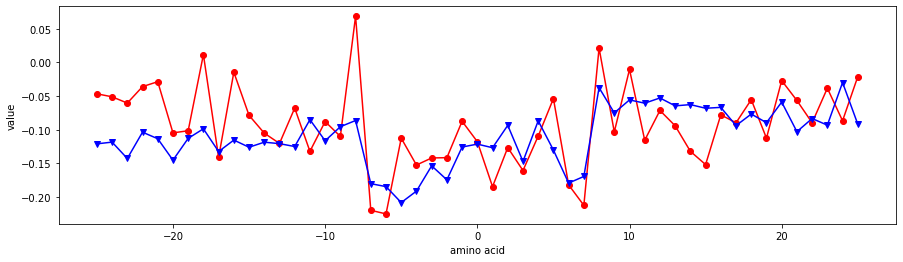

QIAN880125


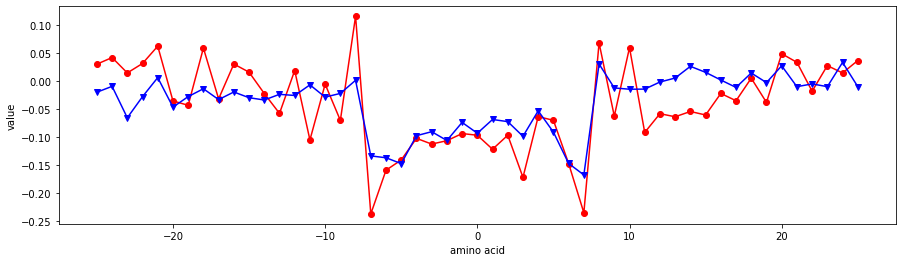

QIAN880126


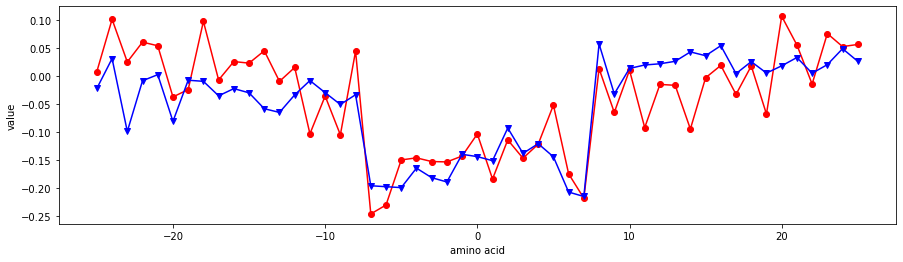

QIAN880127


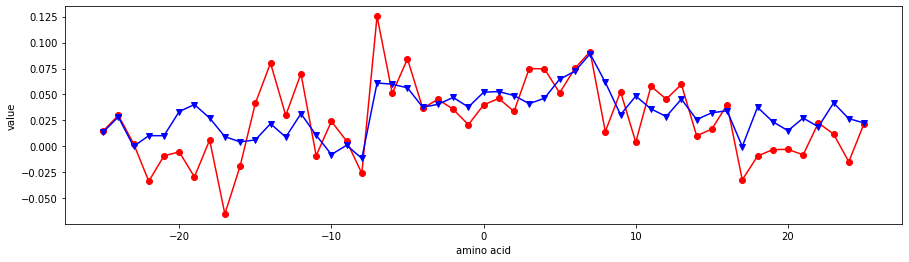

QIAN880128


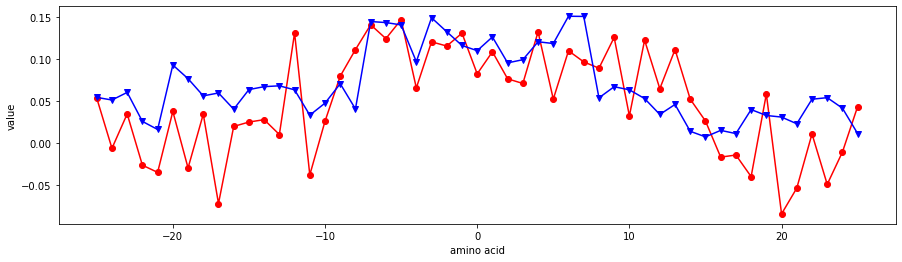

QIAN880129


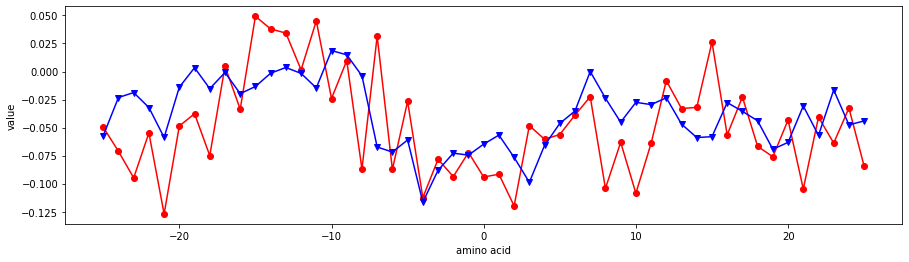

QIAN880130


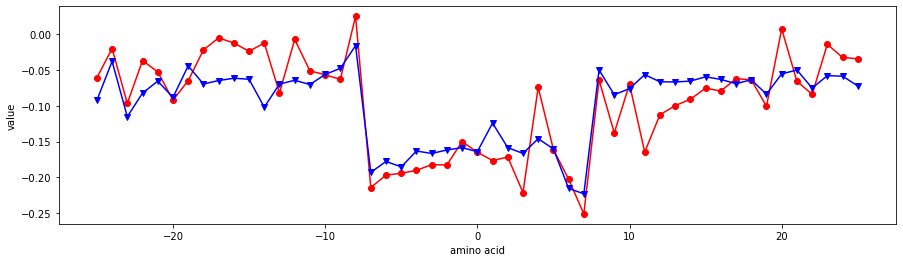

QIAN880131


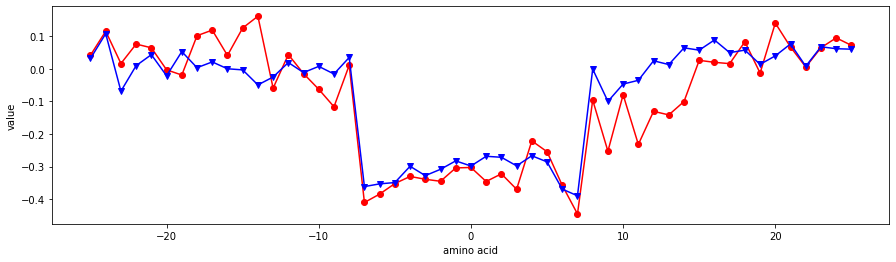

QIAN880132


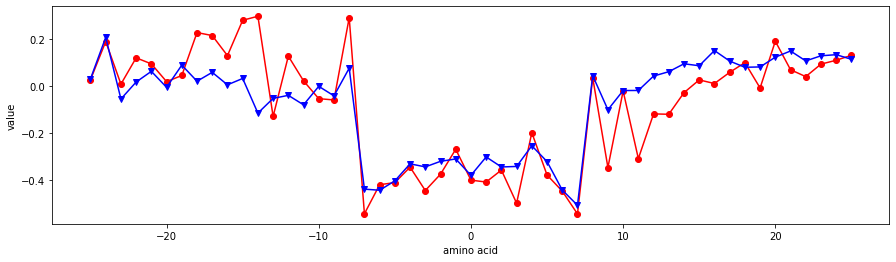

QIAN880133


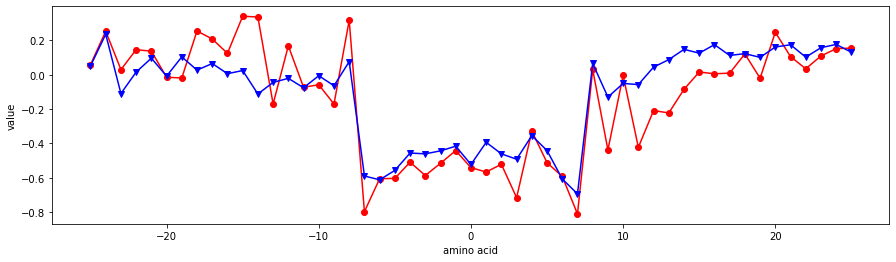

QIAN880134


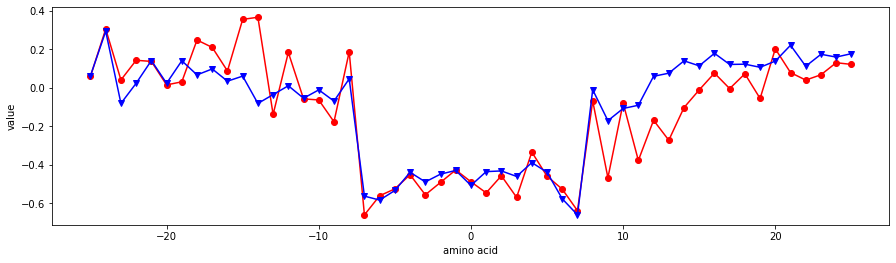

QIAN880135


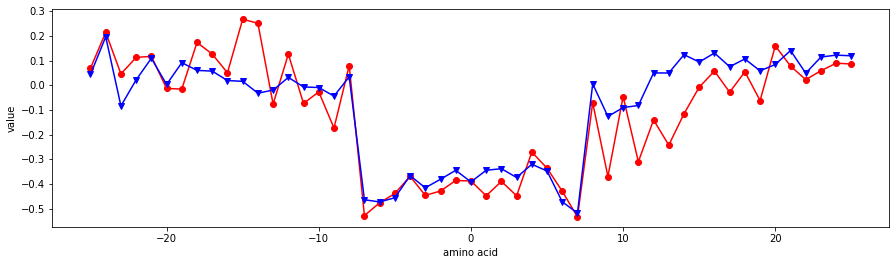

QIAN880136


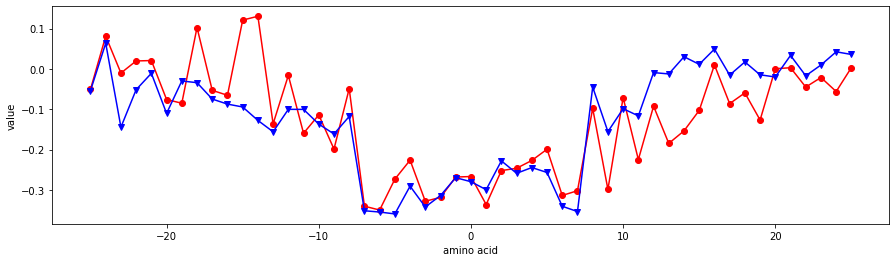

QIAN880137


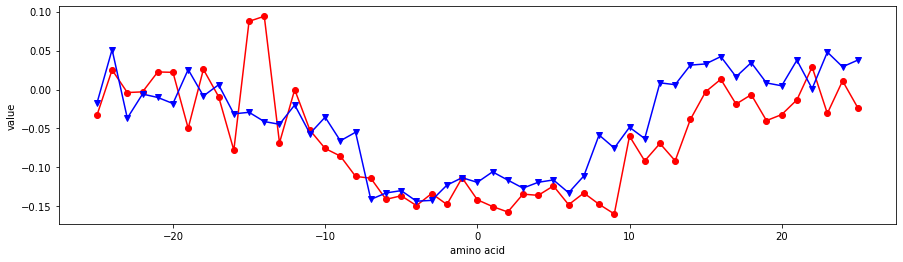

QIAN880138


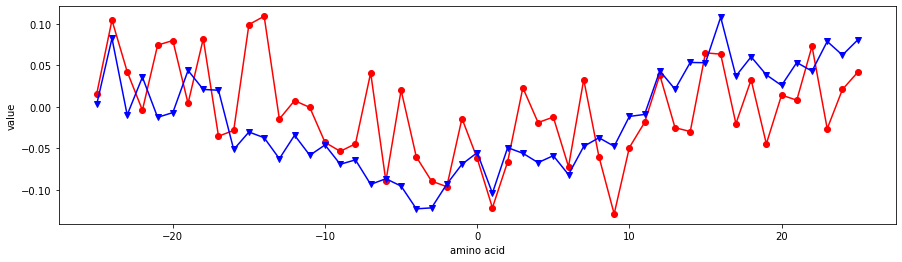

QIAN880139


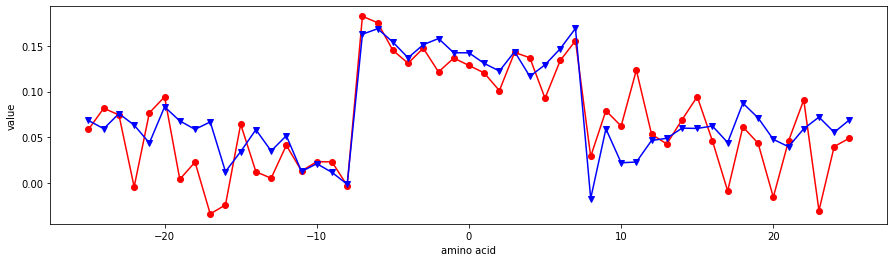

RACS770101


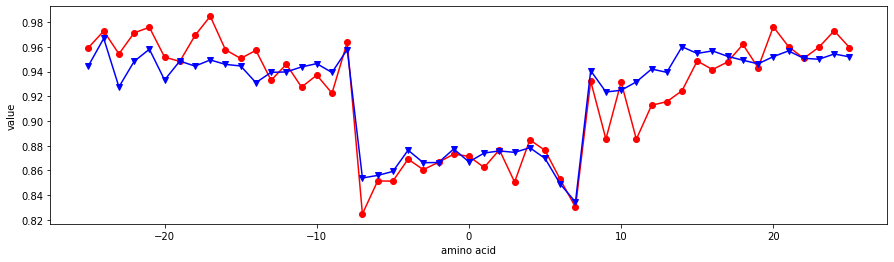

RACS770102


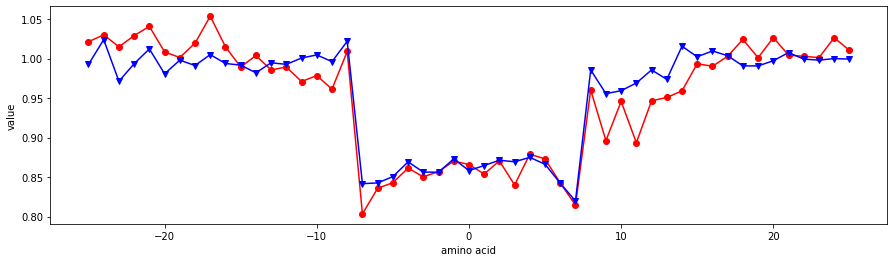

RACS770103


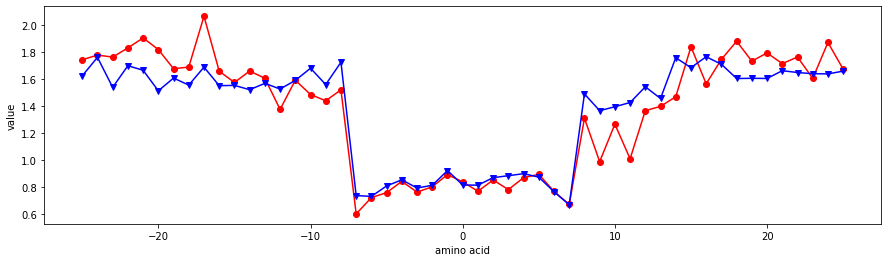

RACS820101


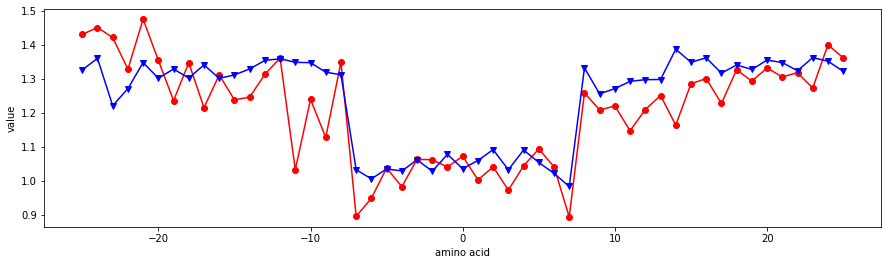

RACS820102


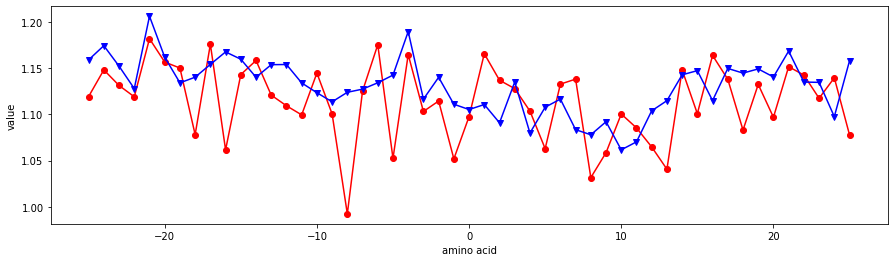

RACS820103


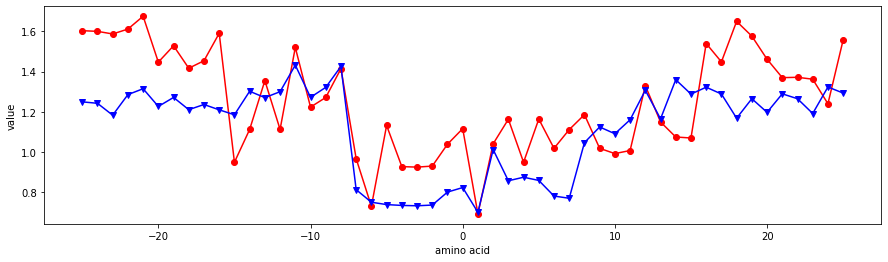

RACS820104


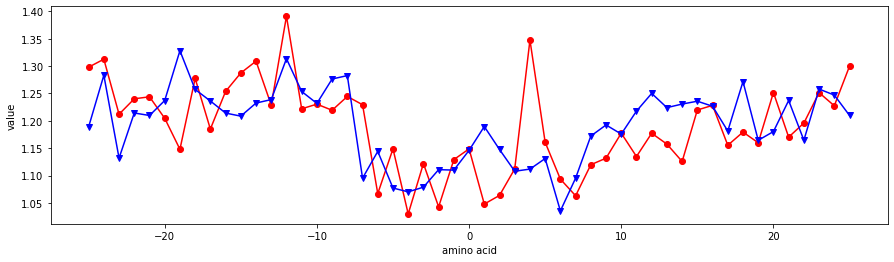

RACS820105


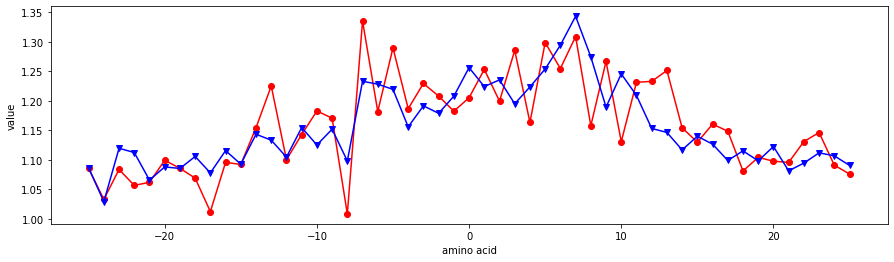

RACS820106


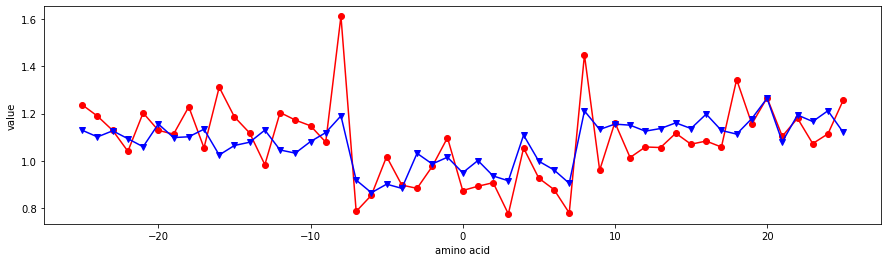

RACS820107


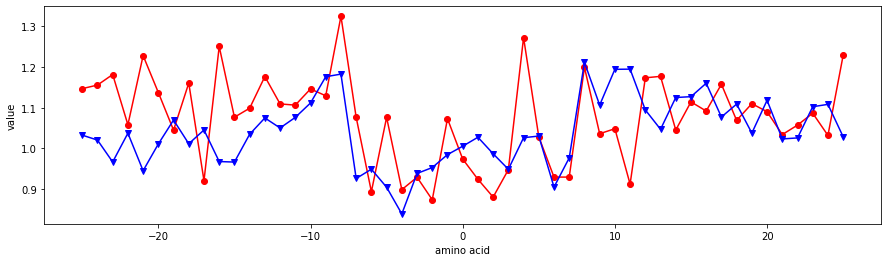

RACS820108


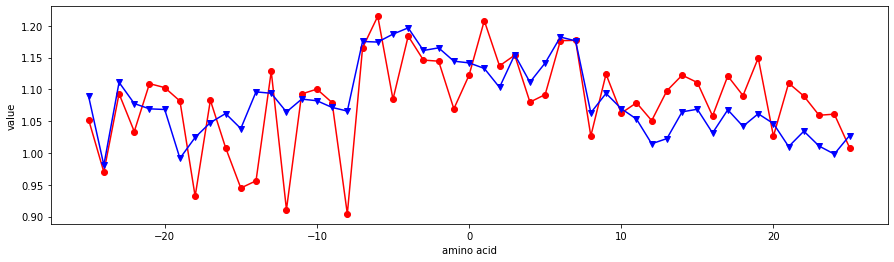

RACS820109


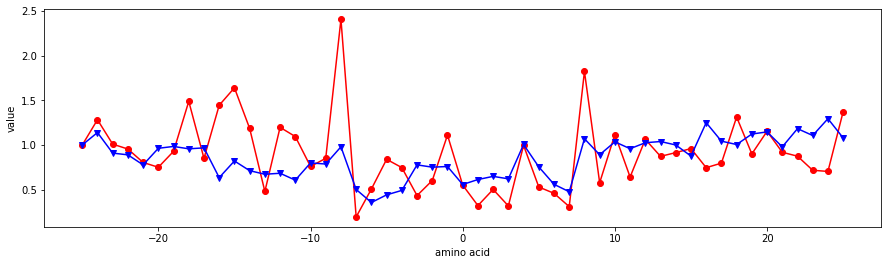

RACS820110


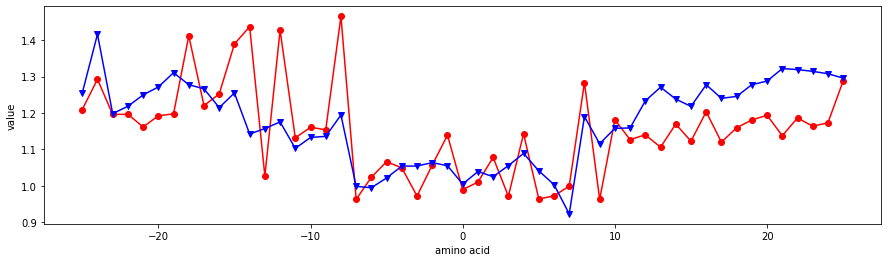

RACS820111


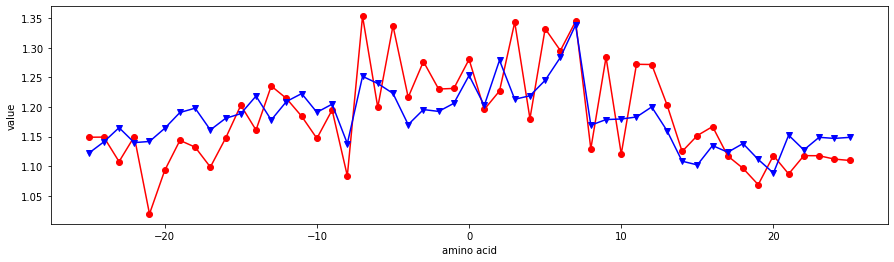

RACS820112


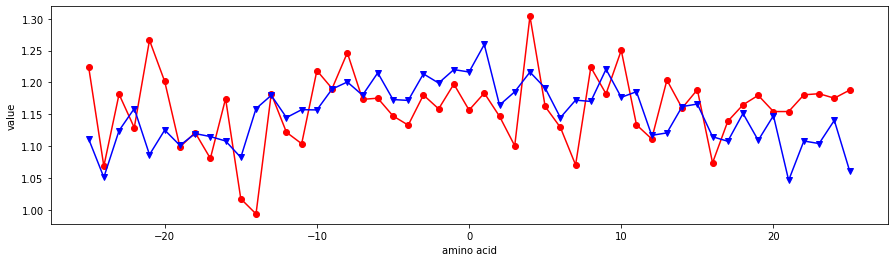

RACS820113


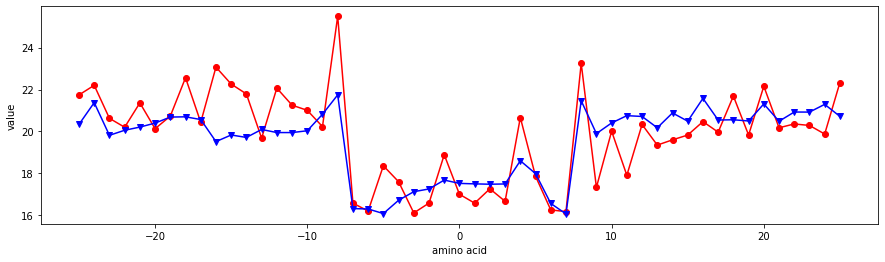

RACS820114


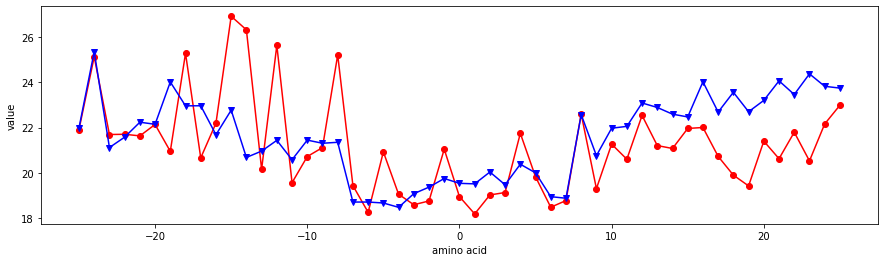

RADA880101


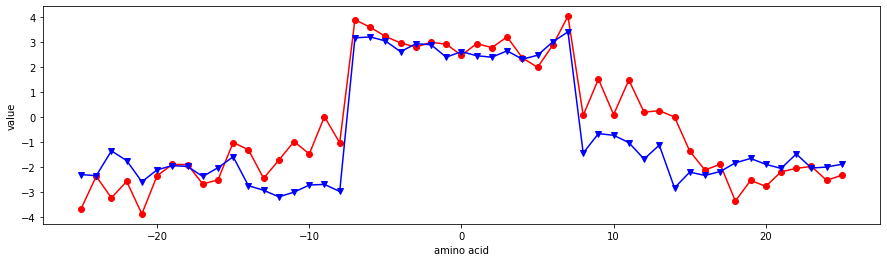

RADA880102


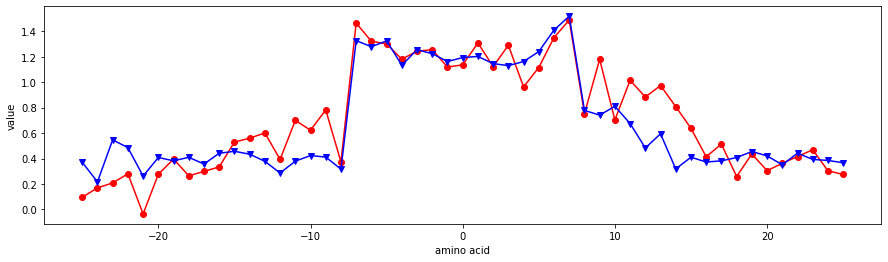

RADA880103


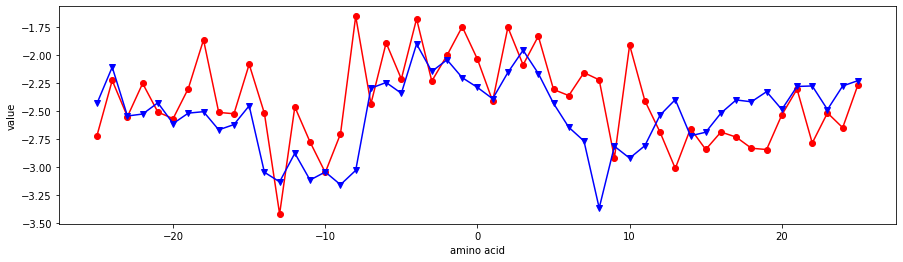

RADA880104


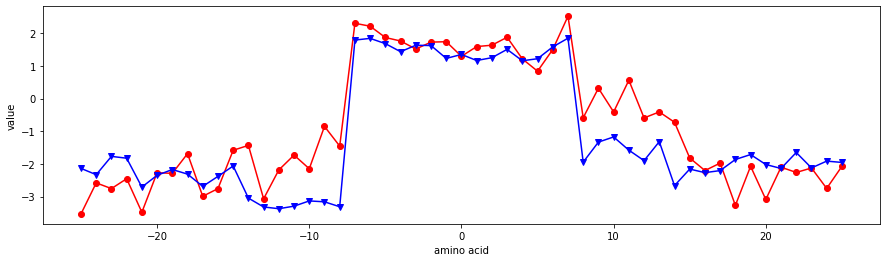

RADA880105


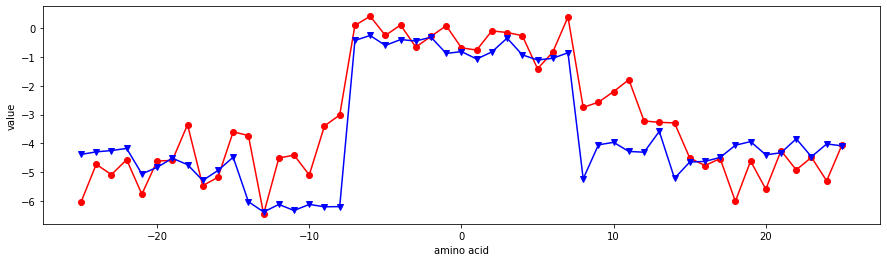

RADA880106


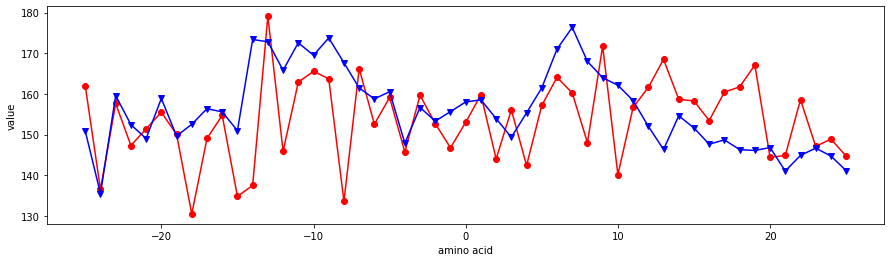

RADA880107


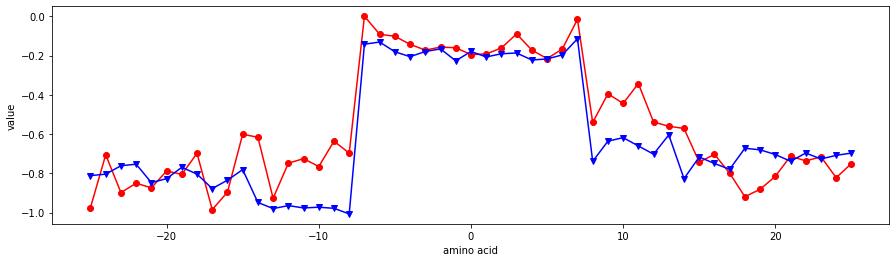

RADA880108


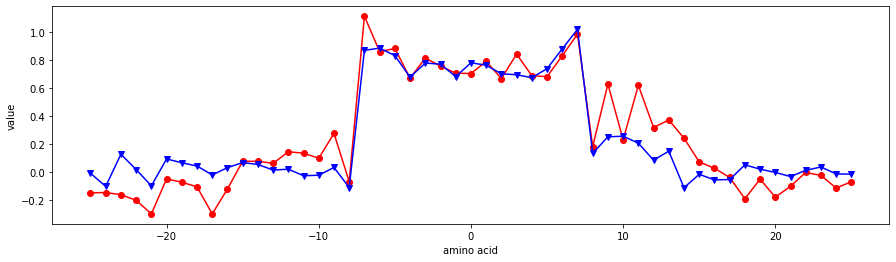

RICJ880101


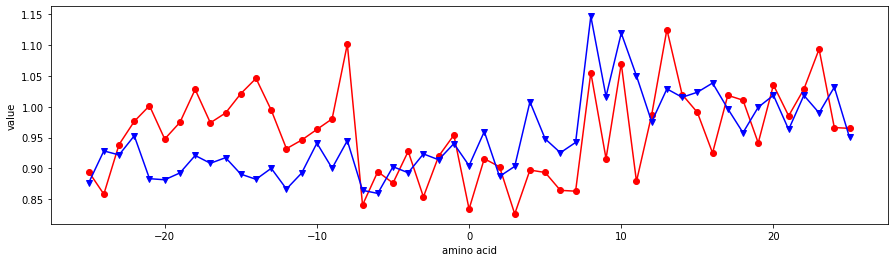

RICJ880102


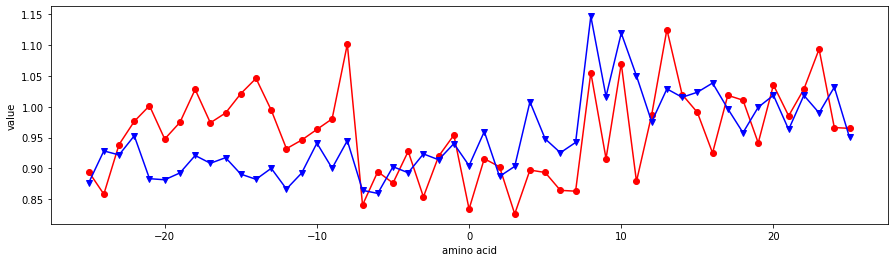

RICJ880103


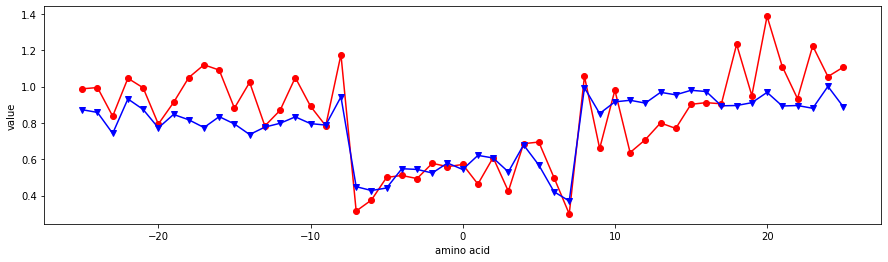

RICJ880104


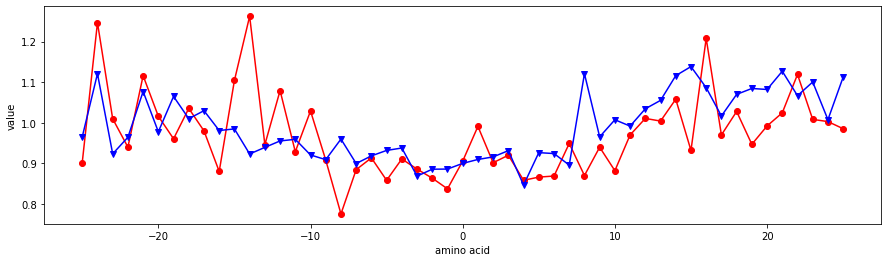

RICJ880105


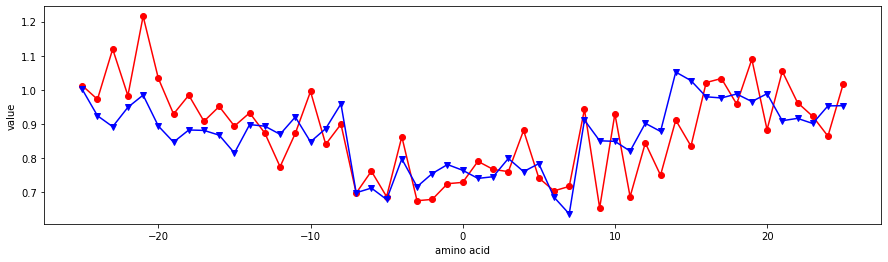

RICJ880106


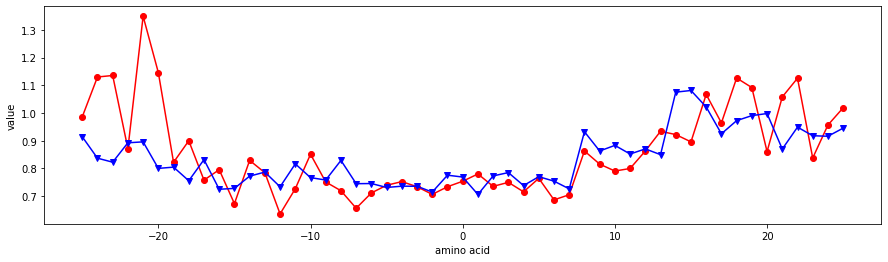

RICJ880107


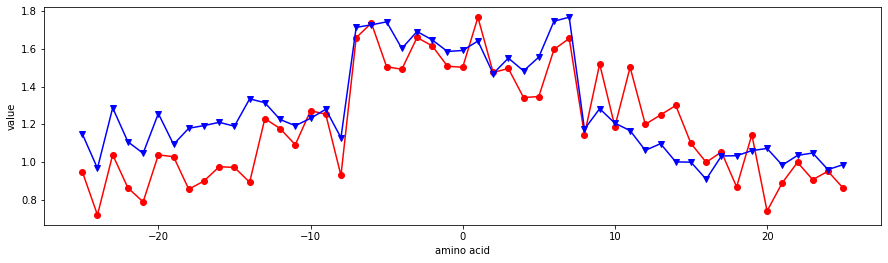

RICJ880108


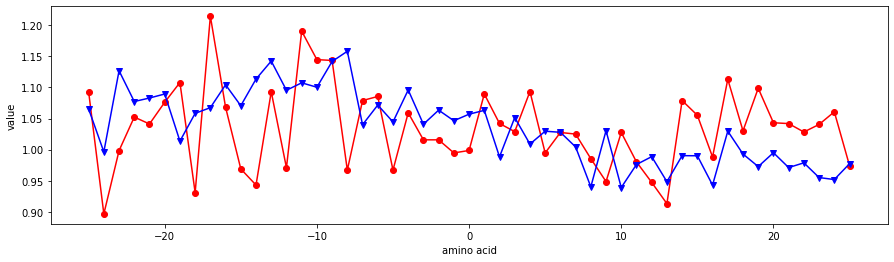

RICJ880109


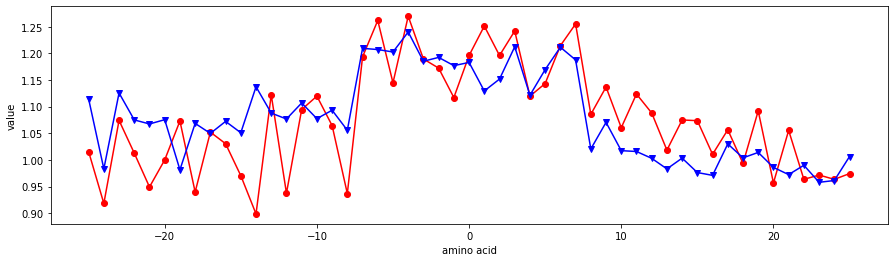

RICJ880110


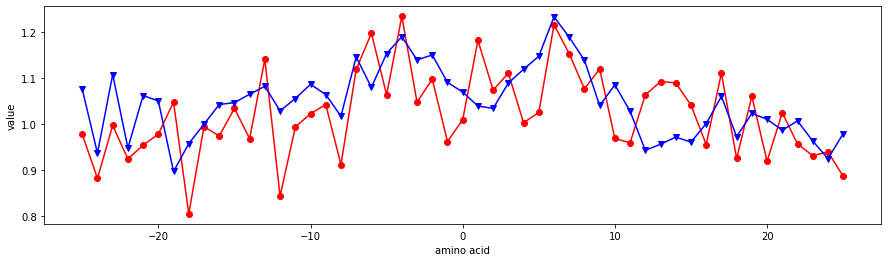

RICJ880111


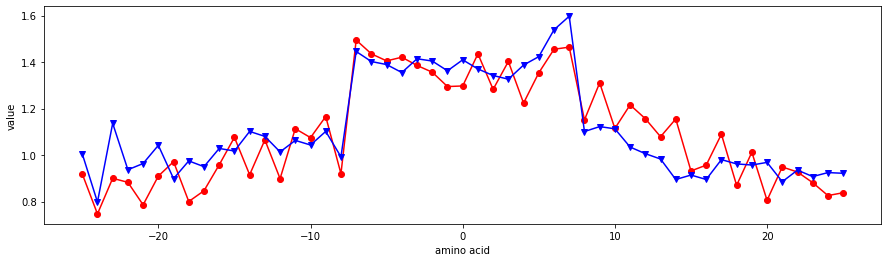

RICJ880112


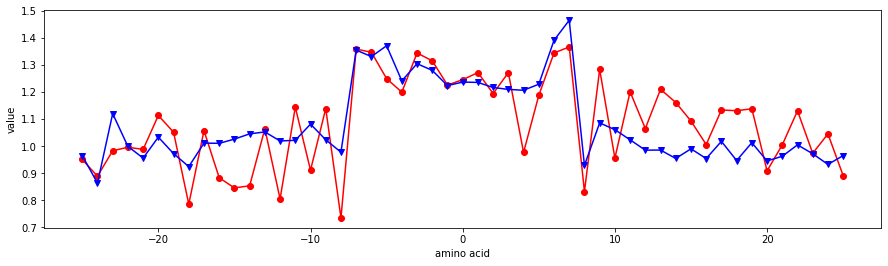

RICJ880113


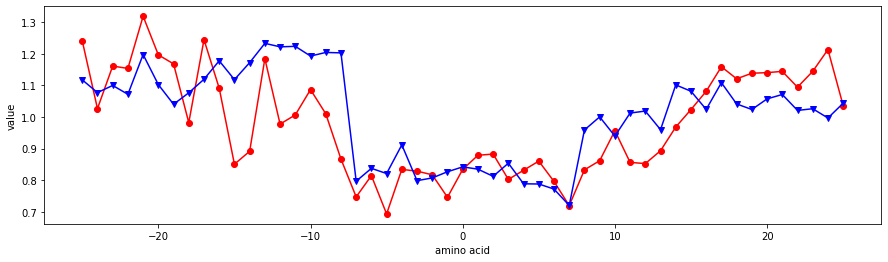

RICJ880114


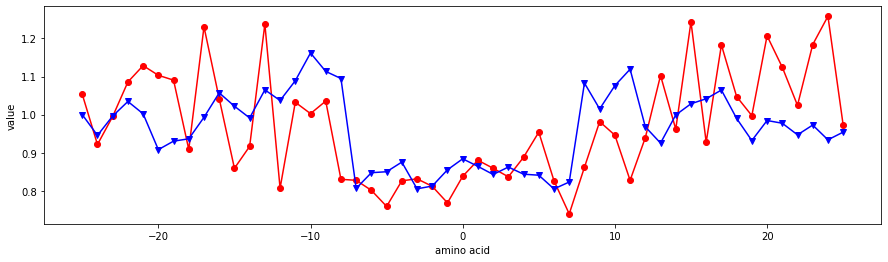

RICJ880115


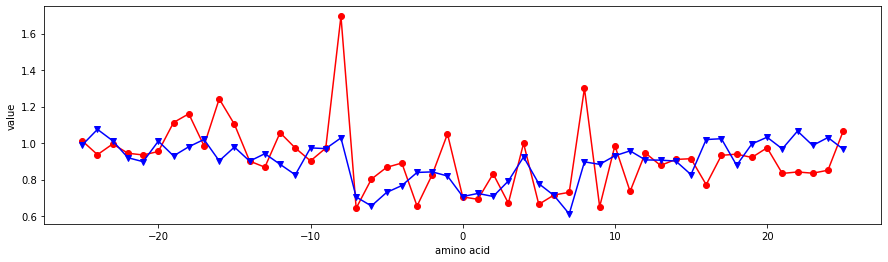

RICJ880116


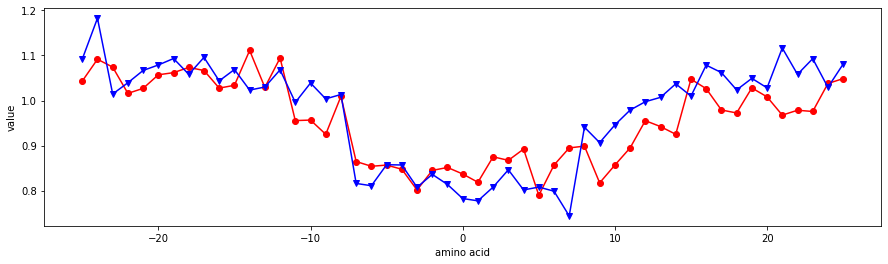

RICJ880117


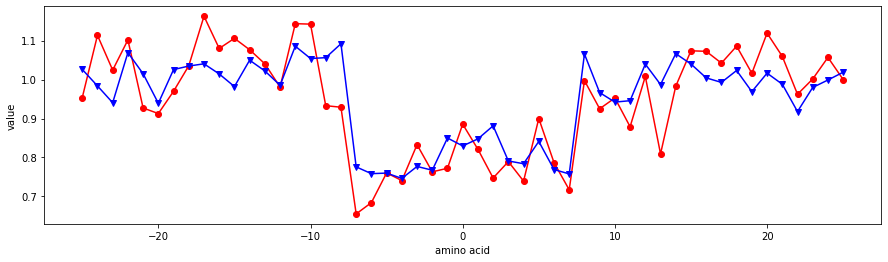

ROBB760101


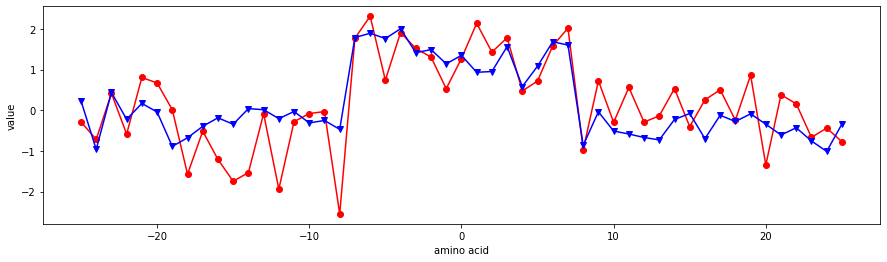

ROBB760102


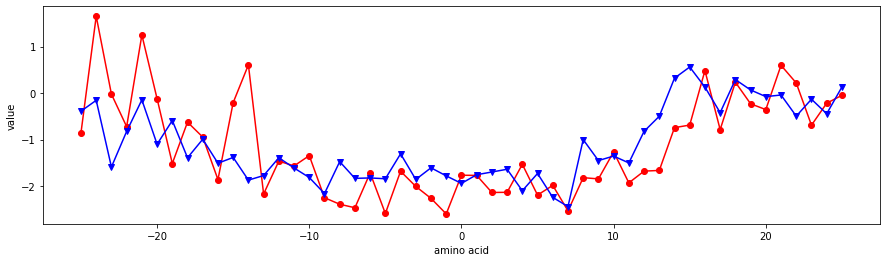

ROBB760103


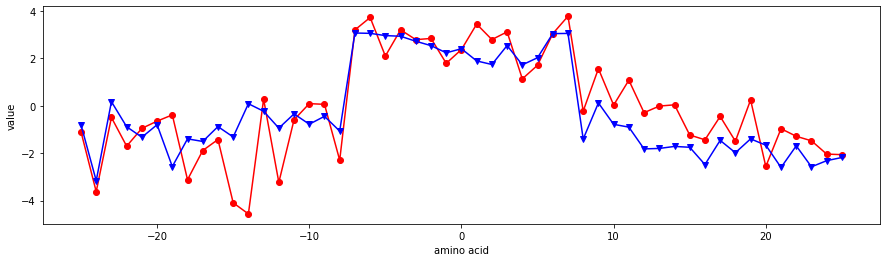

ROBB760104


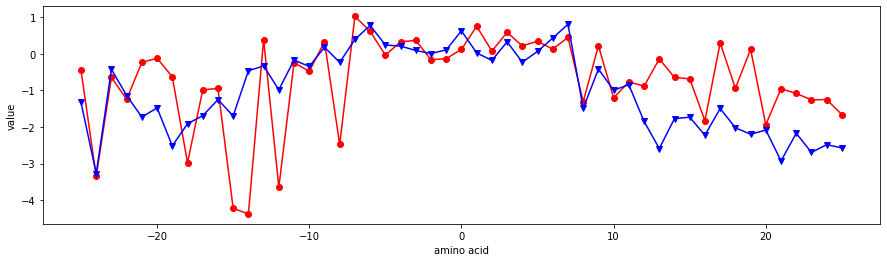

ROBB760105


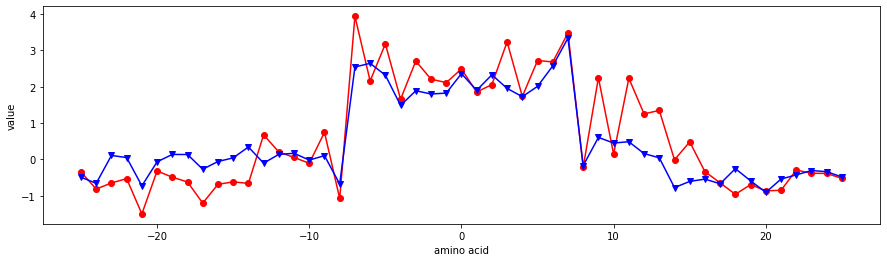

ROBB760106


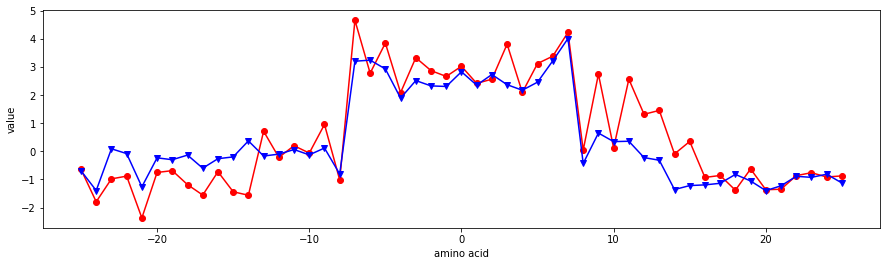

ROBB760107


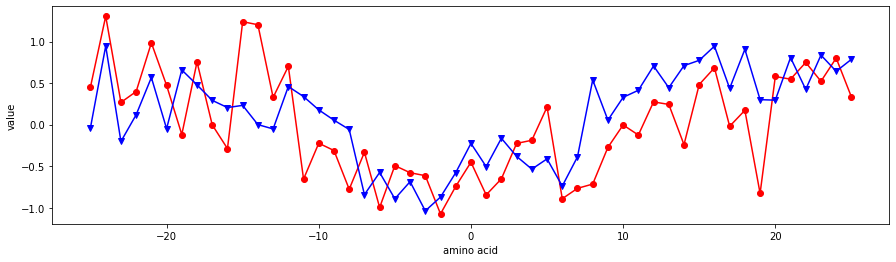

ROBB760108


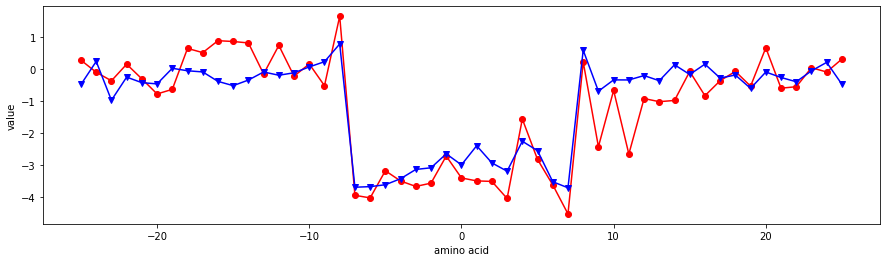

ROBB760109


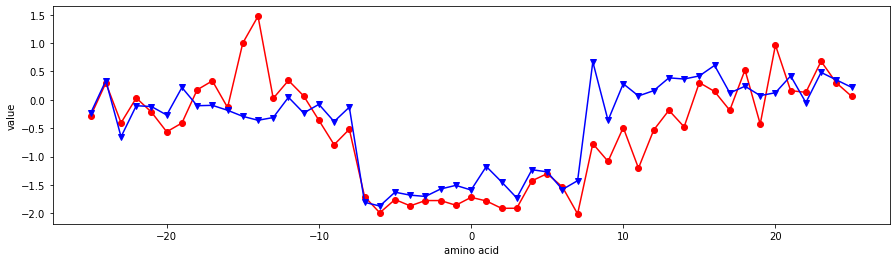

ROBB760110


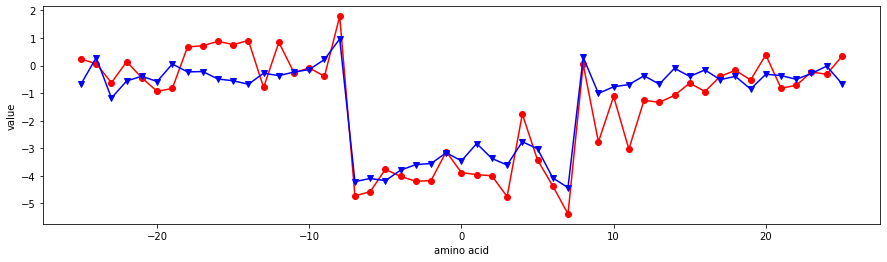

ROBB760111


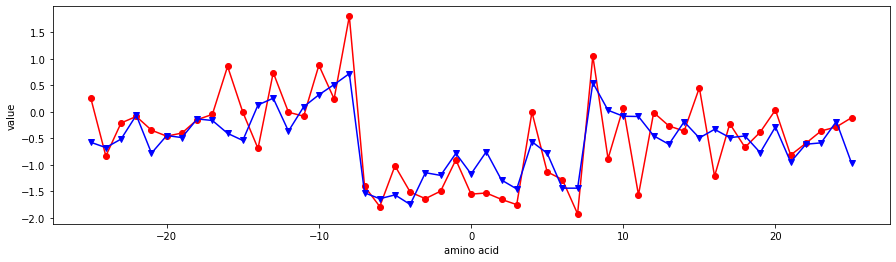

ROBB760112


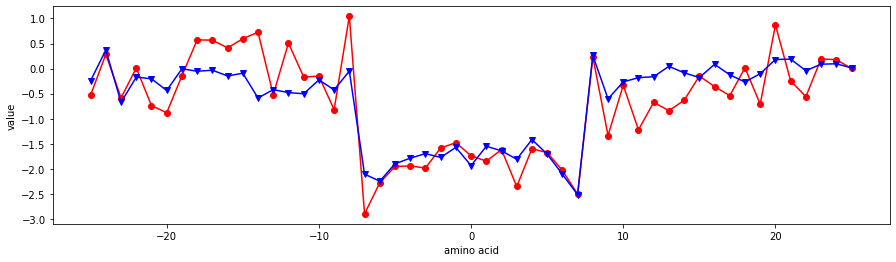

ROBB760113


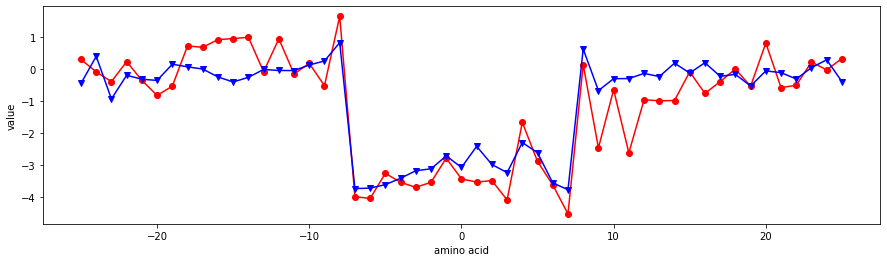

ROBB790101


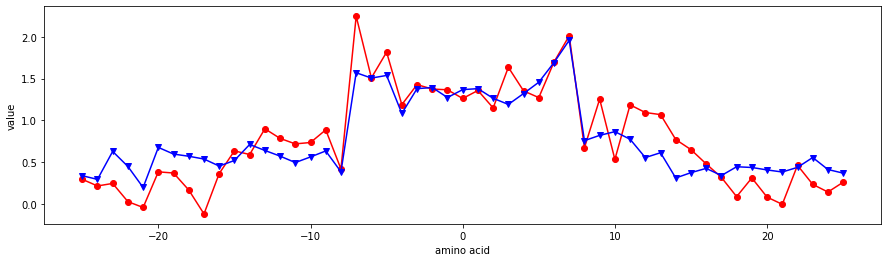

ROSG850101


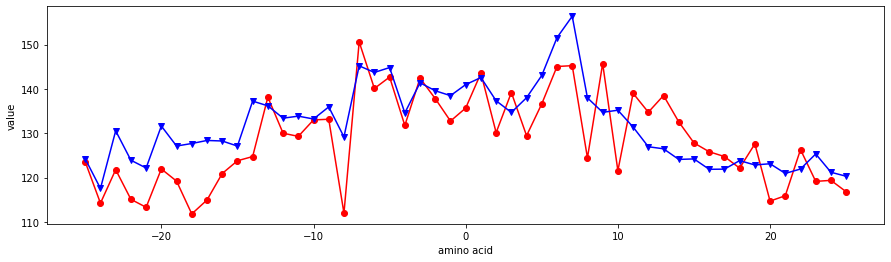

ROSG850102


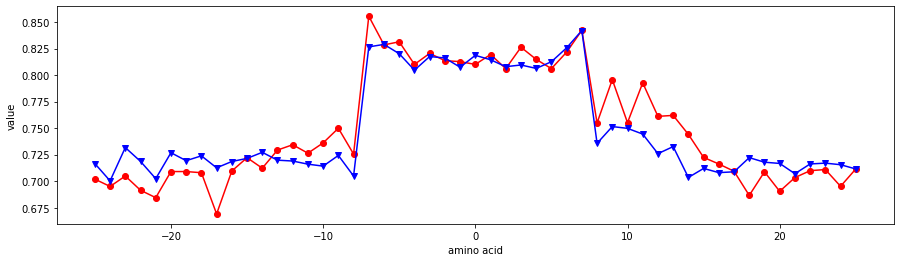

ROSM880101


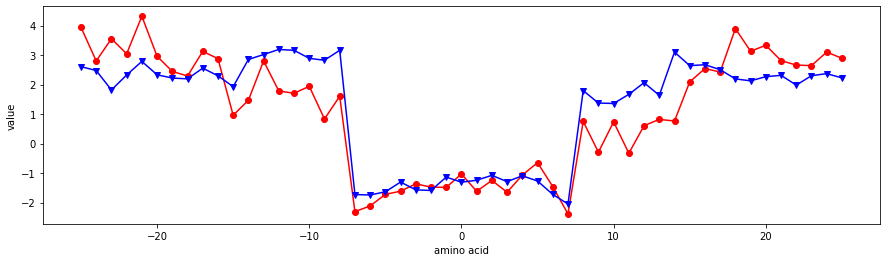

ROSM880102


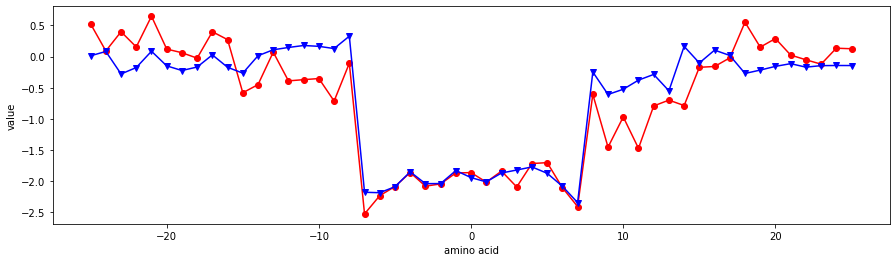

ROSM880103


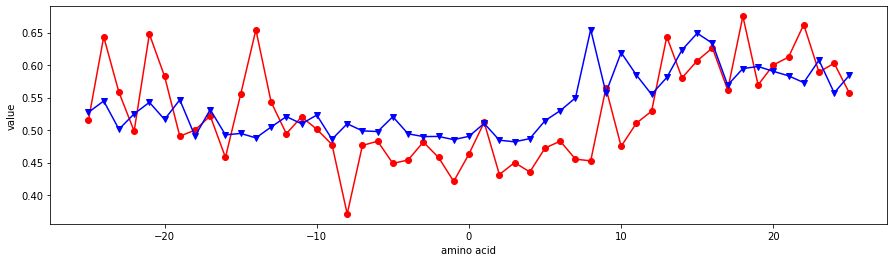

SIMZ760101


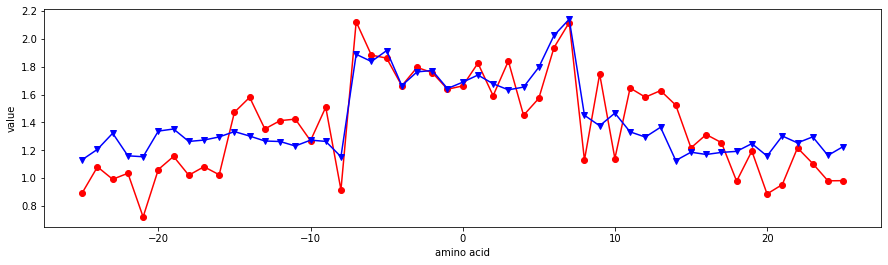

SNEP660101


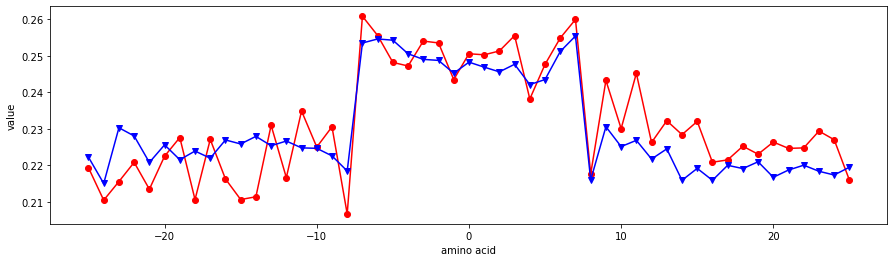

SNEP660102


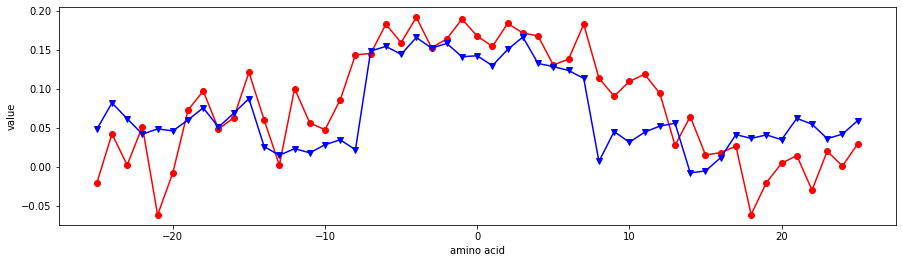

SNEP660103


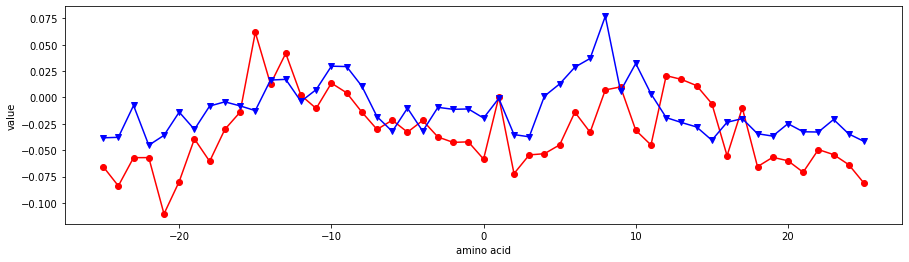

SNEP660104


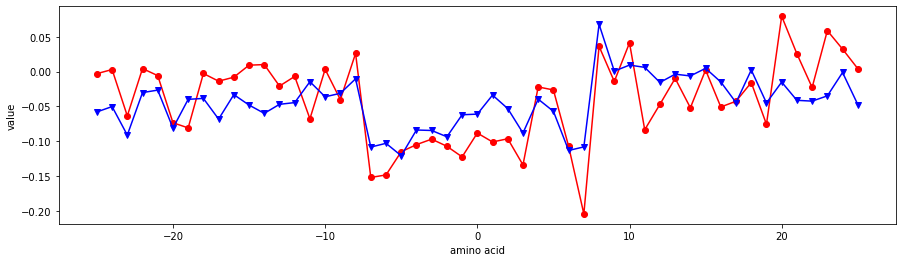

SUEM840101


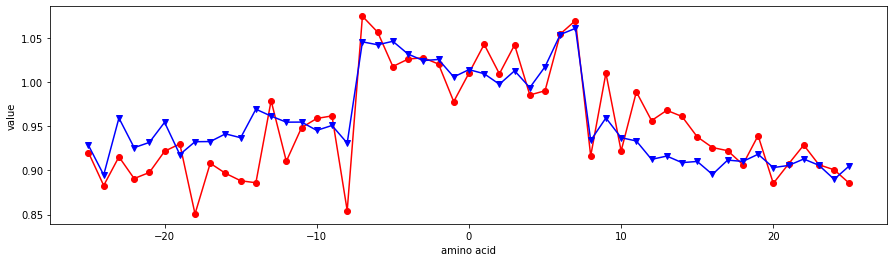

SUEM840102


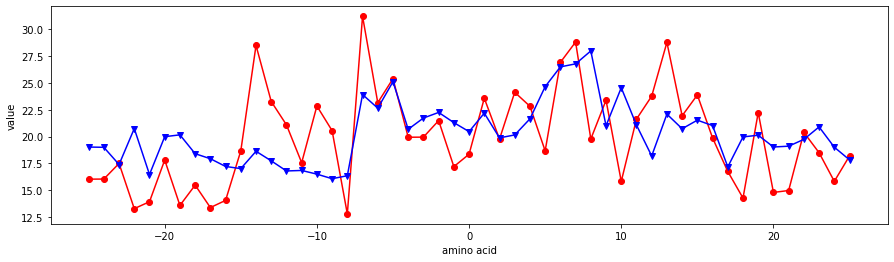

SWER830101


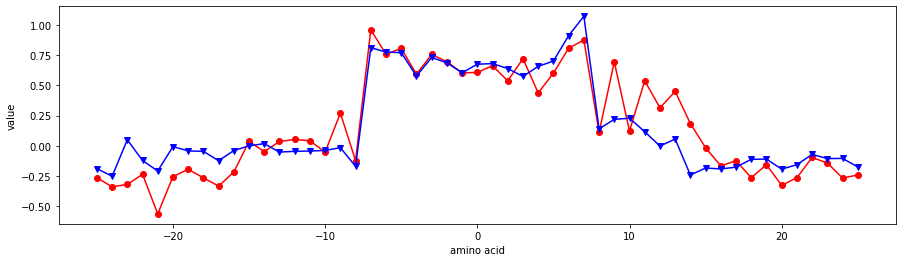

TANS770101


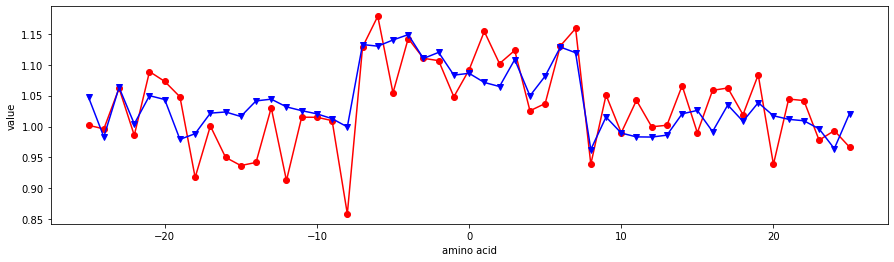

TANS770102


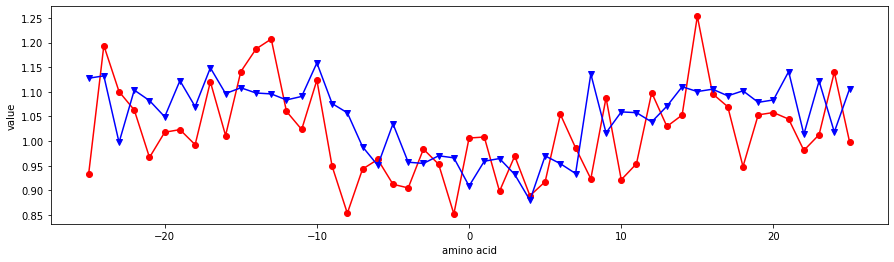

TANS770103


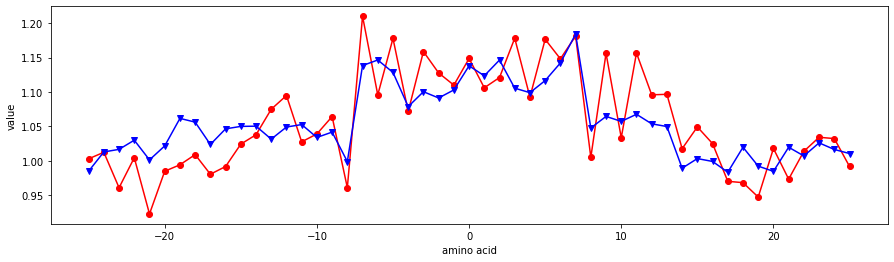

TANS770104


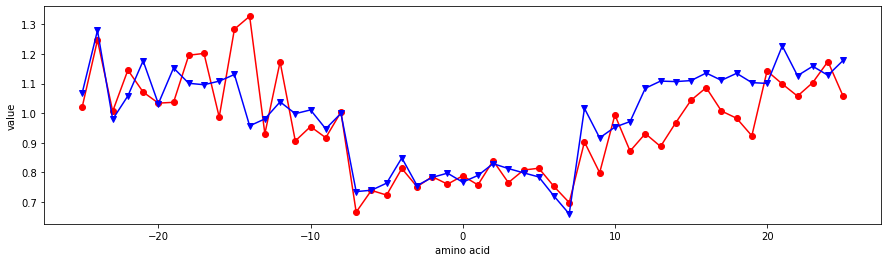

TANS770105


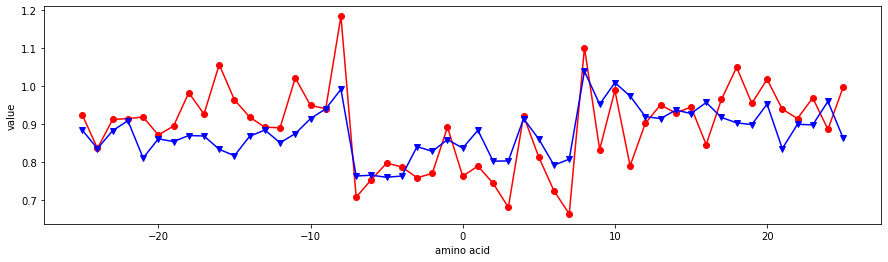

TANS770106


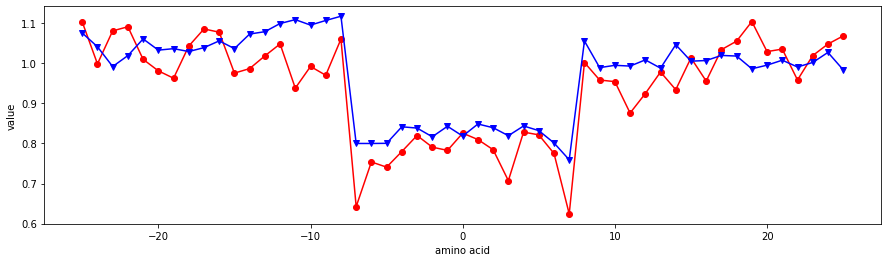

TANS770107


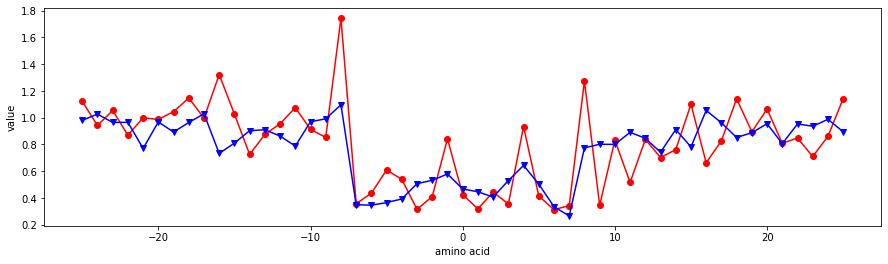

TANS770108


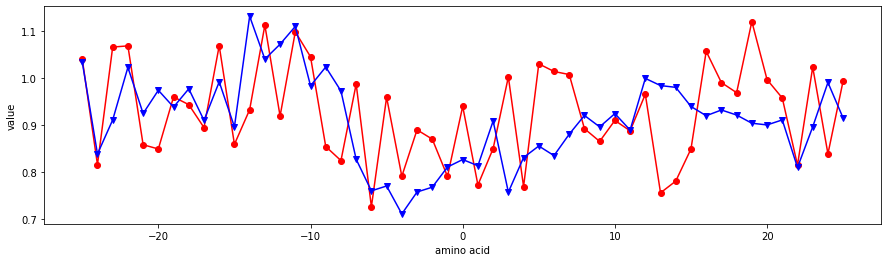

TANS770109


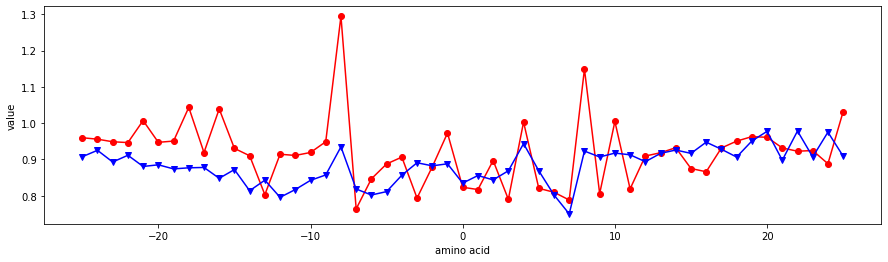

TANS770110


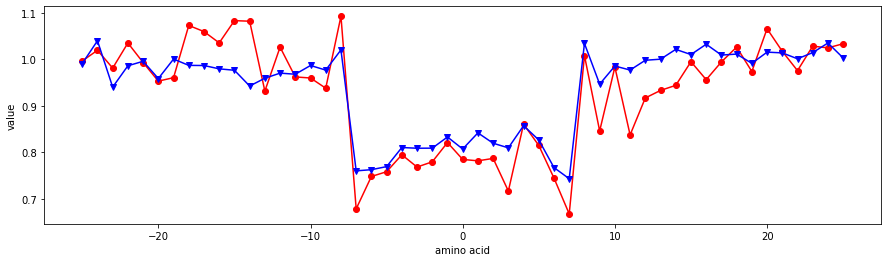

VASM830101


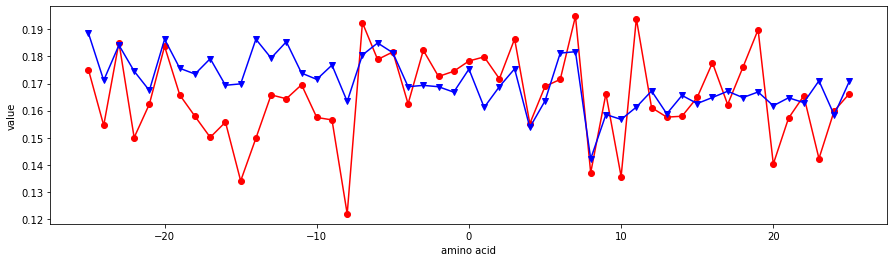

VASM830102


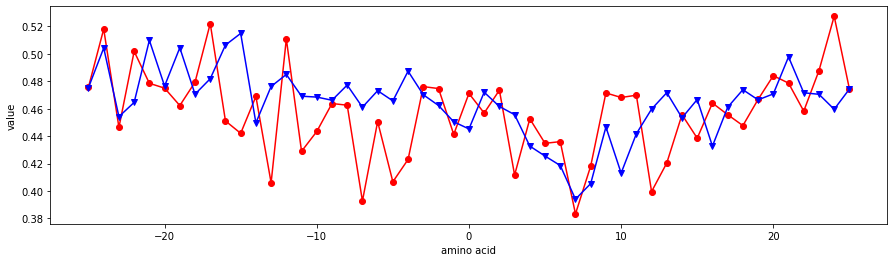

VASM830103


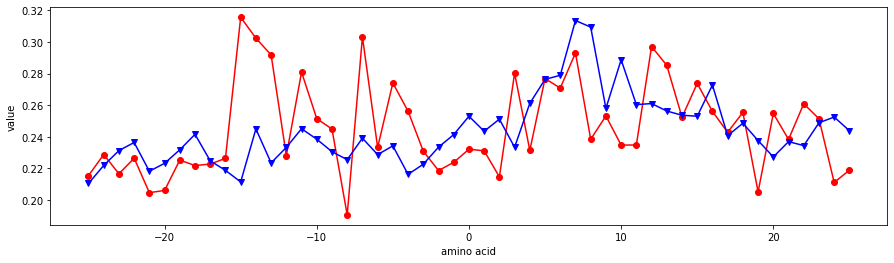

VELV850101


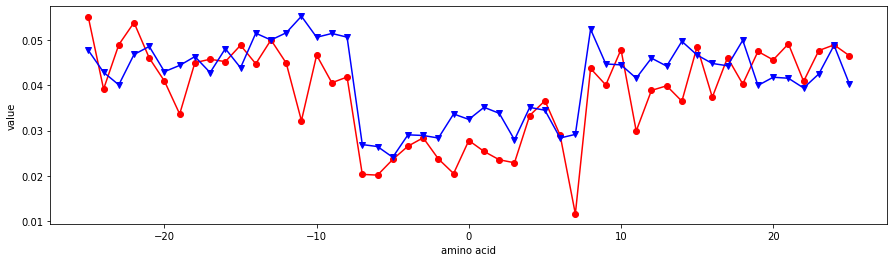

VENT840101


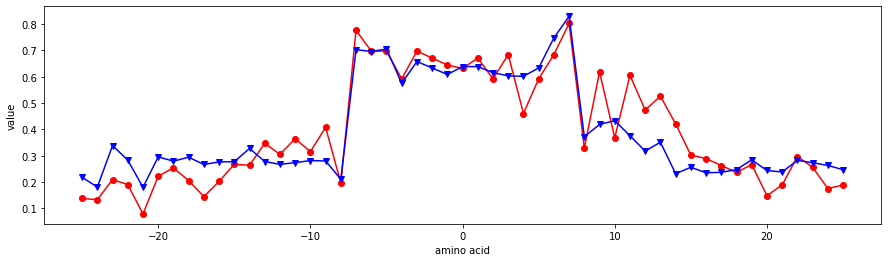

VHEG790101


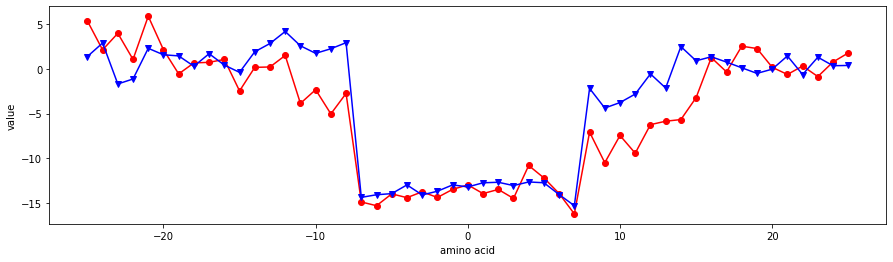

WARP780101


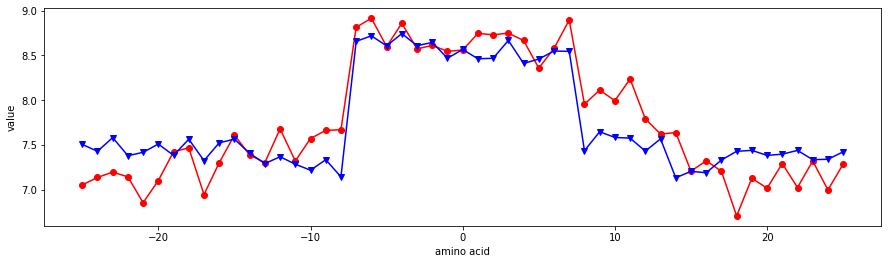

WEBA780101


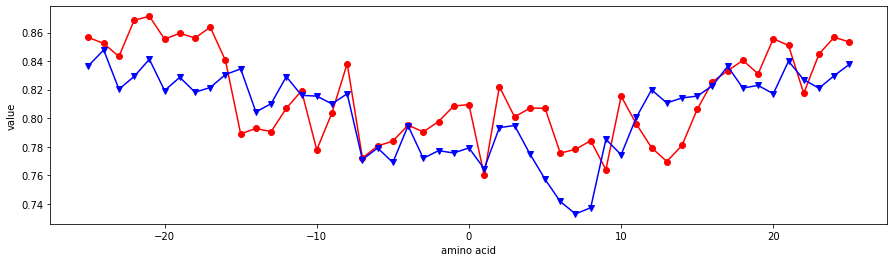

WERD780101


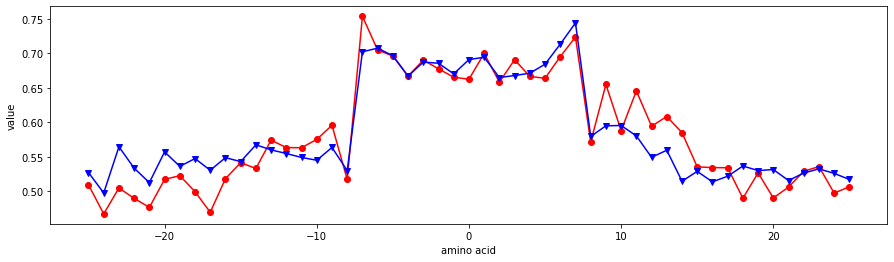

WERD780102


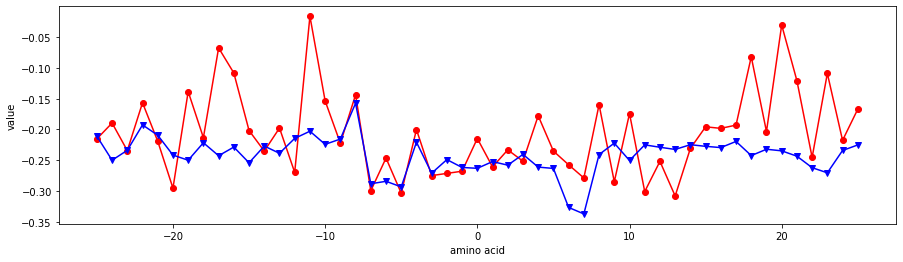

WERD780103


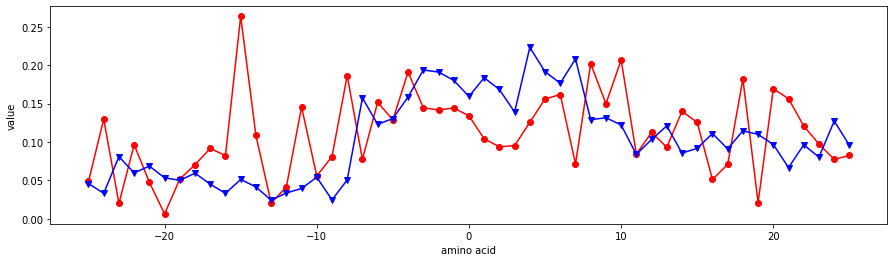

WERD780104


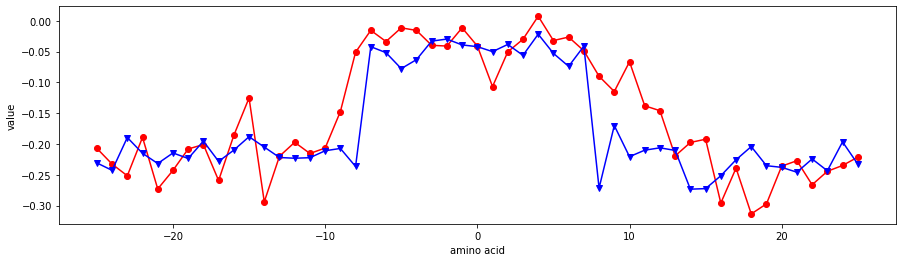

WOEC730101


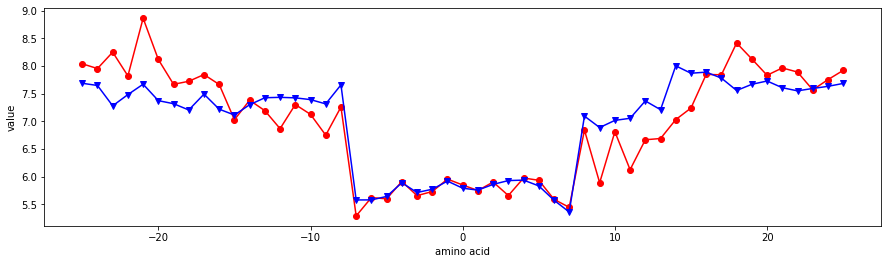

WOLR810101


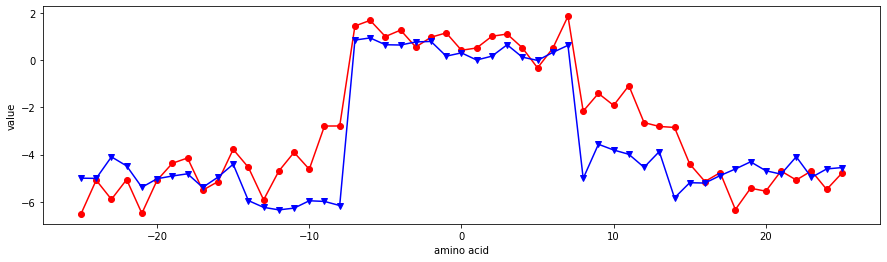

WOLS870101


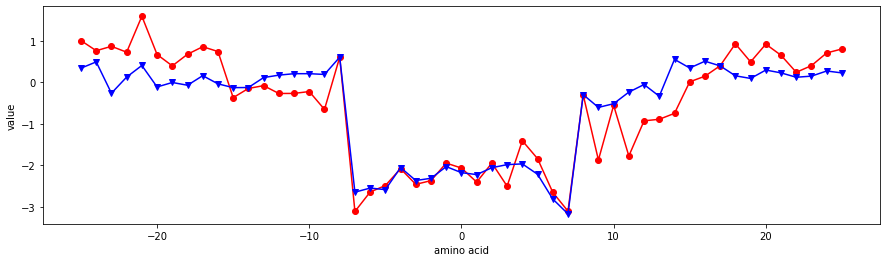

WOLS870102


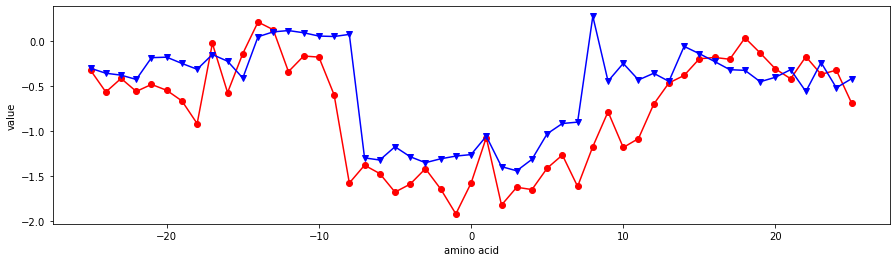

WOLS870103


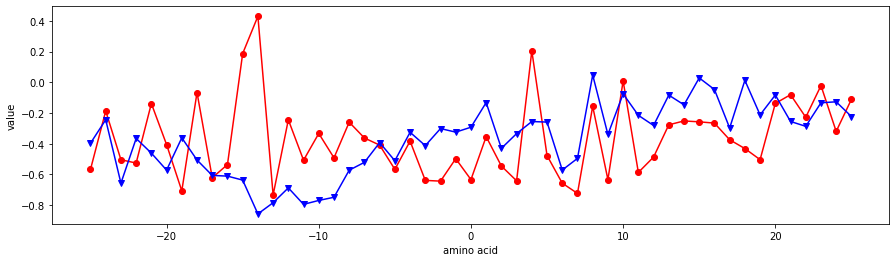

YUTK870101


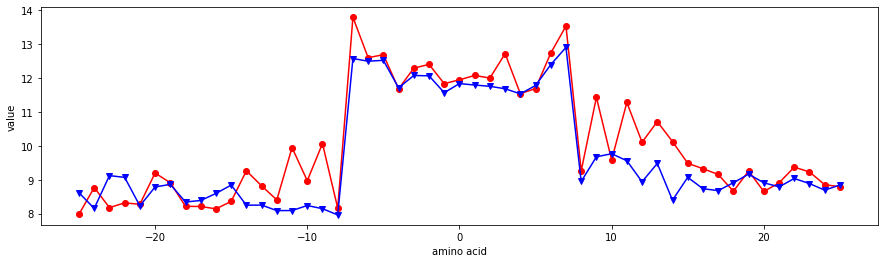

YUTK870102


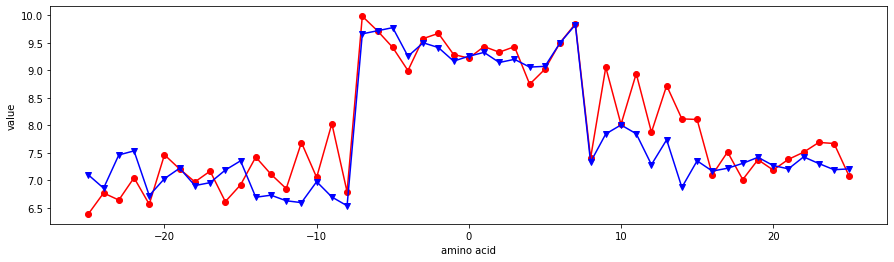

YUTK870103


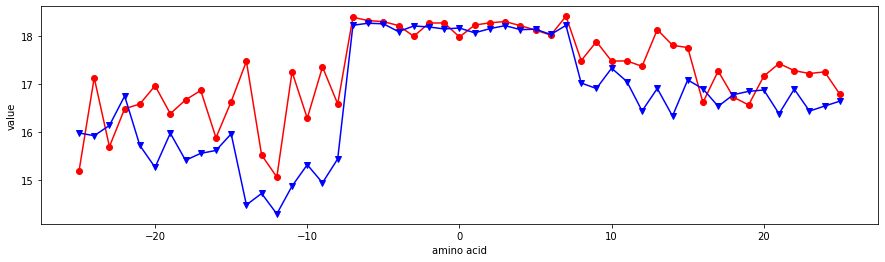

YUTK870104


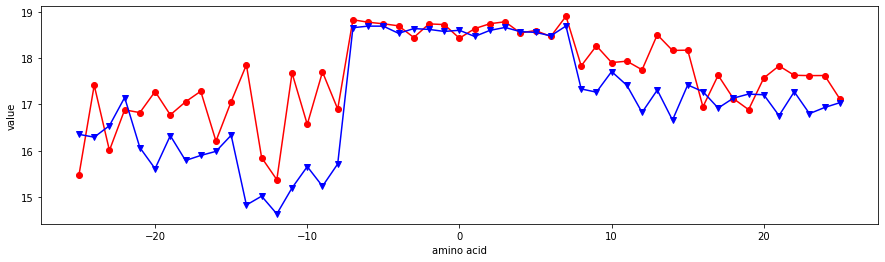

ZASB820101


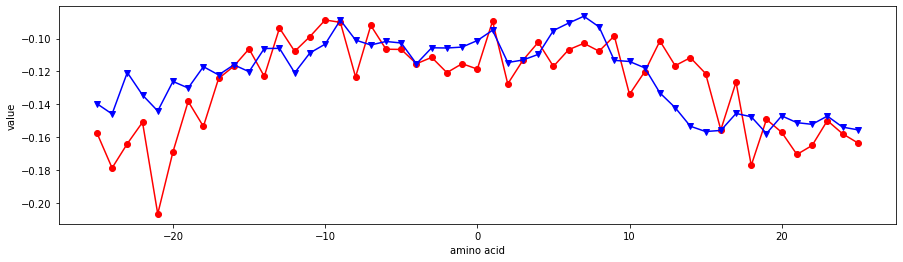

ZIMJ680101


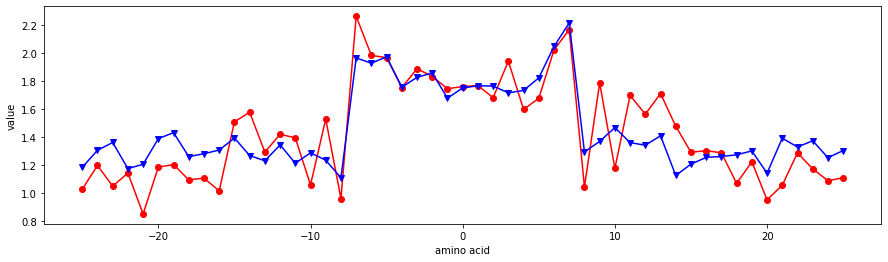

ZIMJ680102


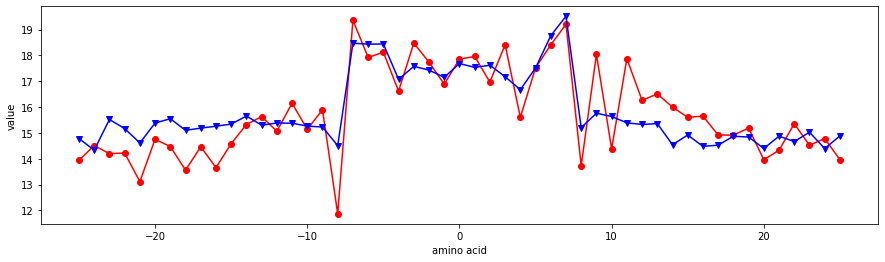

ZIMJ680103


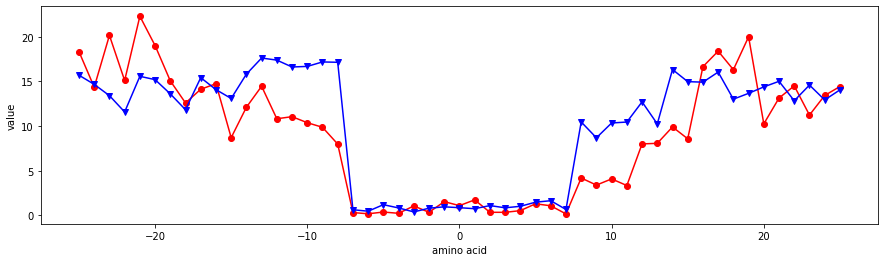

ZIMJ680104


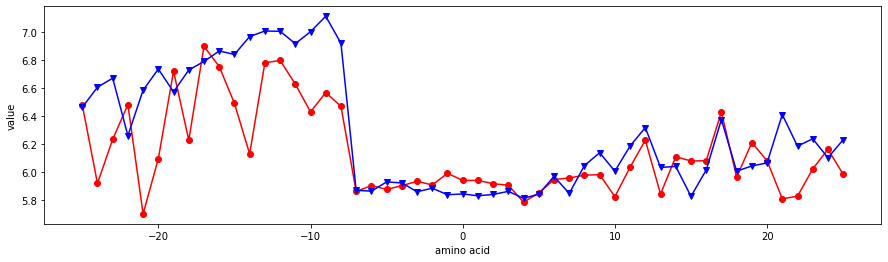

ZIMJ680105


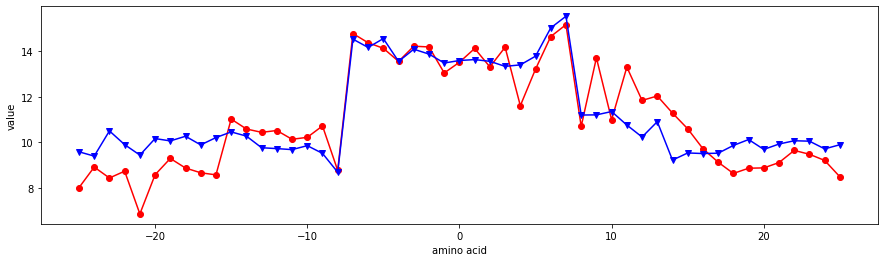

AURR980101


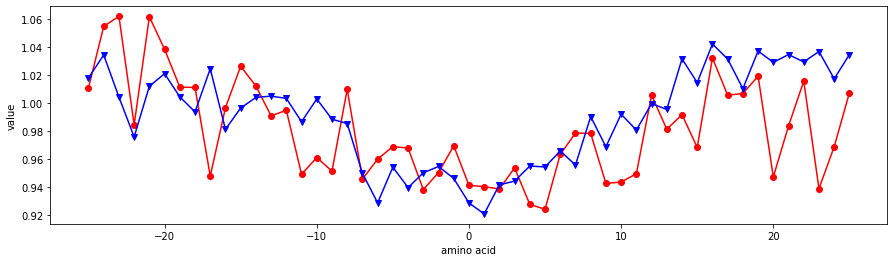

AURR980102


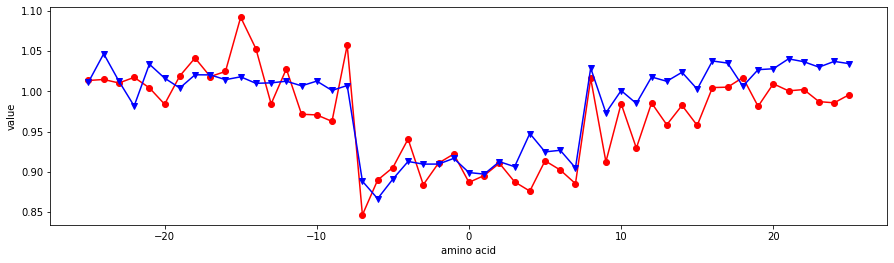

AURR980103


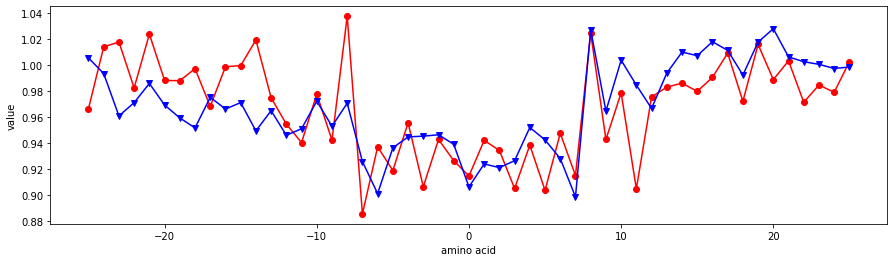

AURR980104


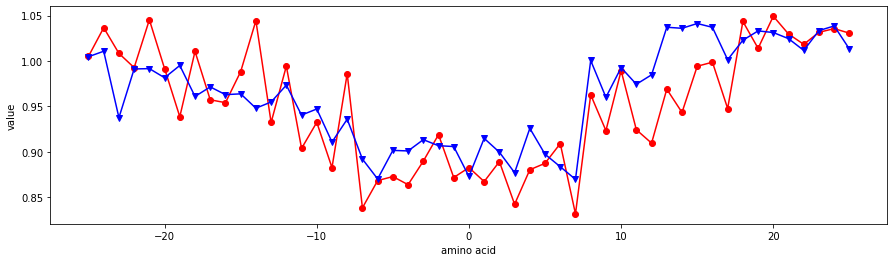

AURR980105


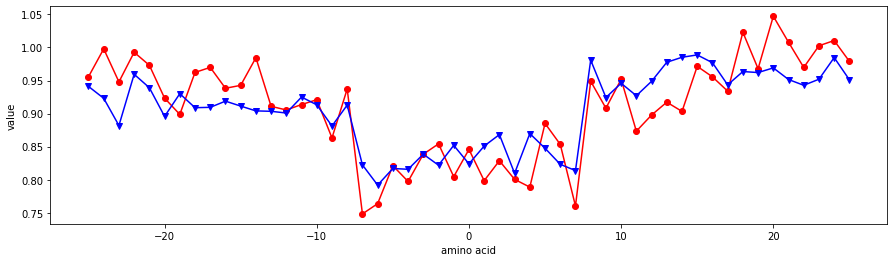

AURR980106


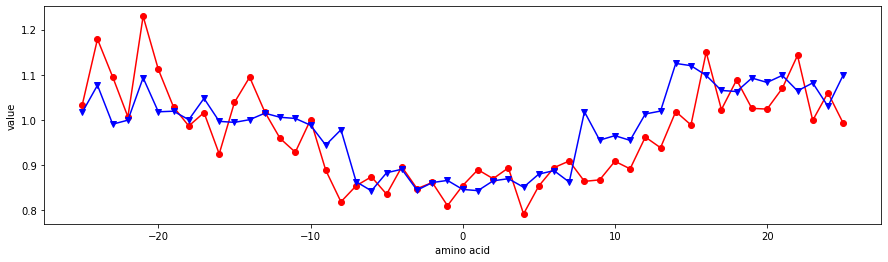

AURR980107


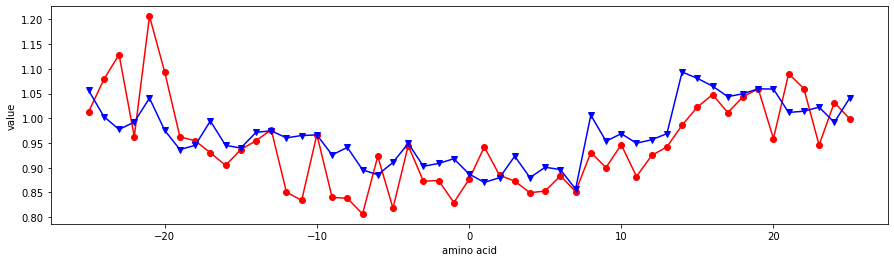

AURR980108


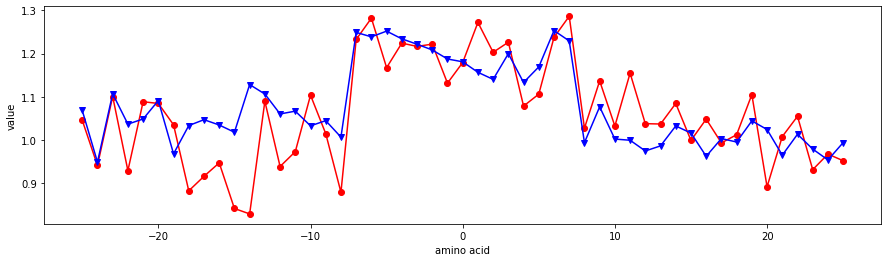

AURR980109


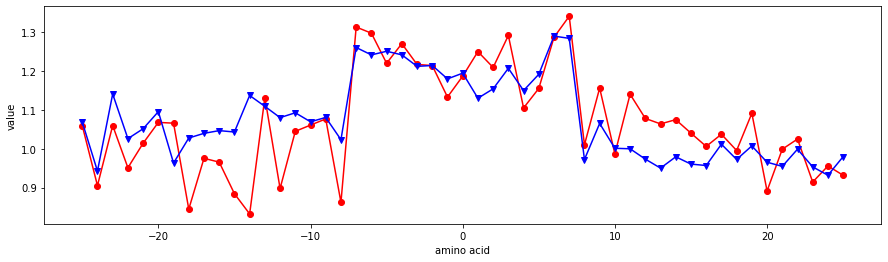

AURR980110


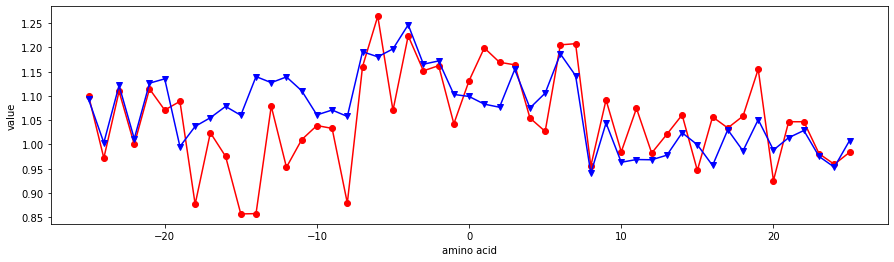

AURR980111


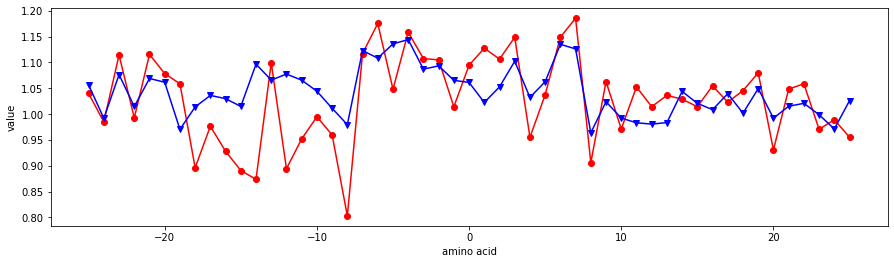

AURR980112


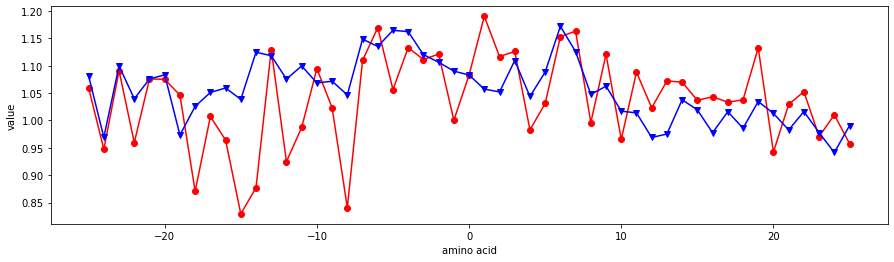

AURR980113


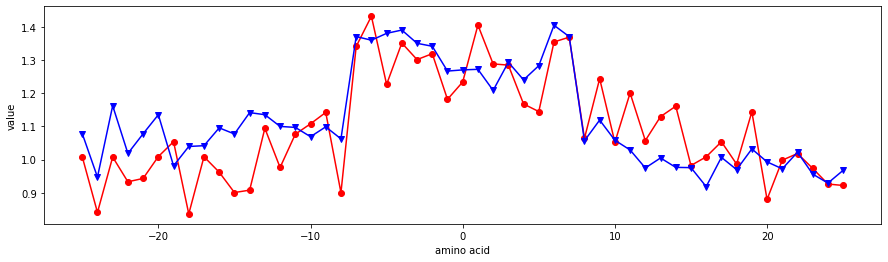

AURR980114


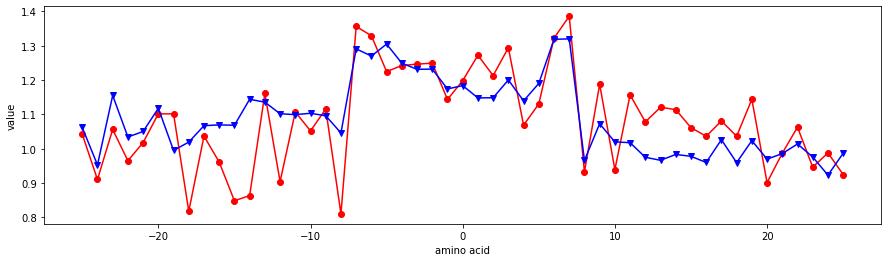

AURR980115


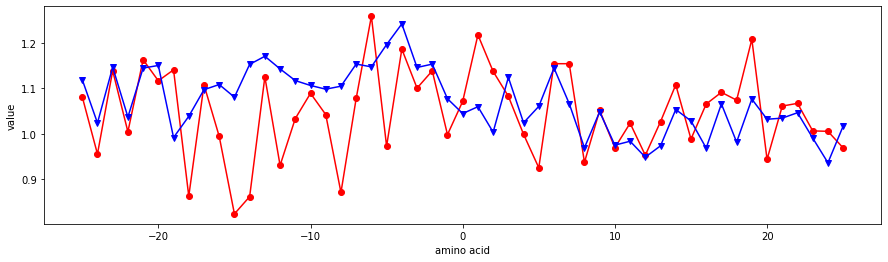

AURR980116


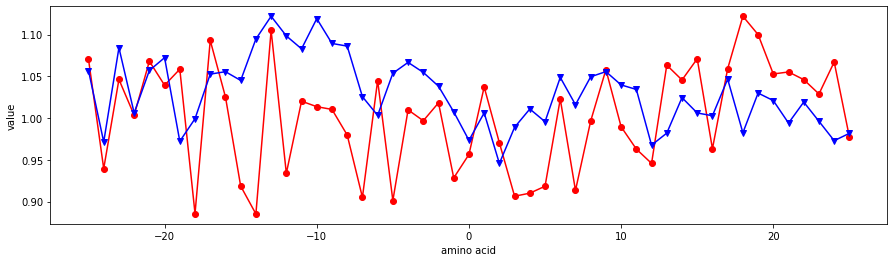

AURR980117


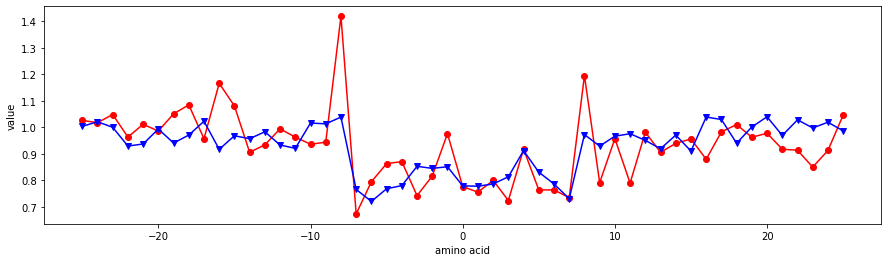

AURR980118


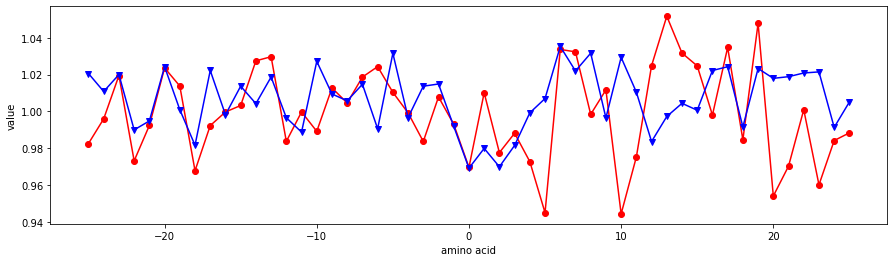

AURR980119


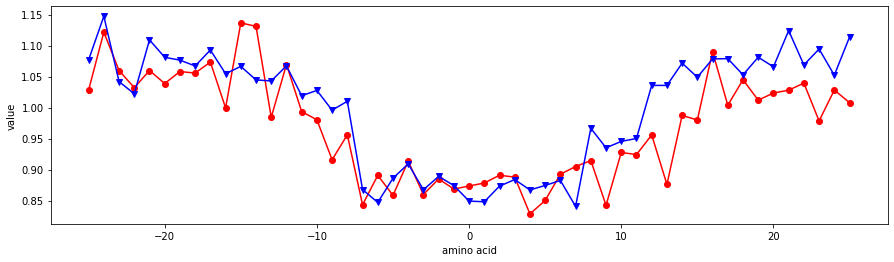

AURR980120


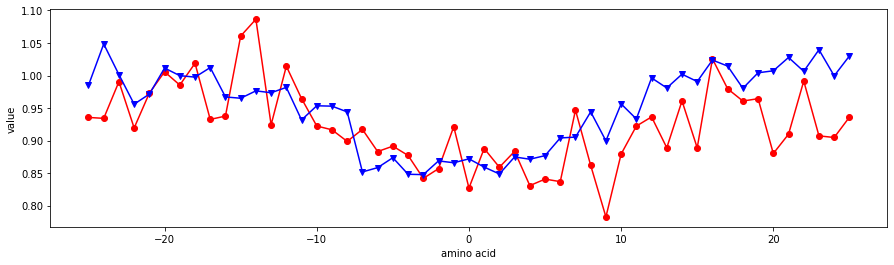

ONEK900101


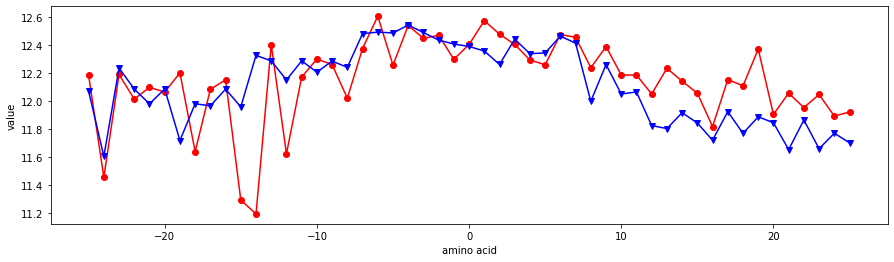

ONEK900102


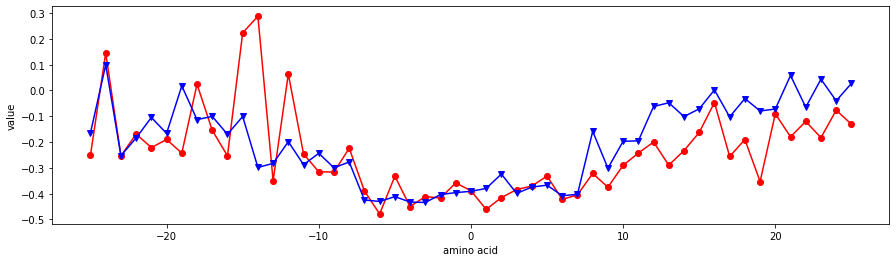

VINM940101


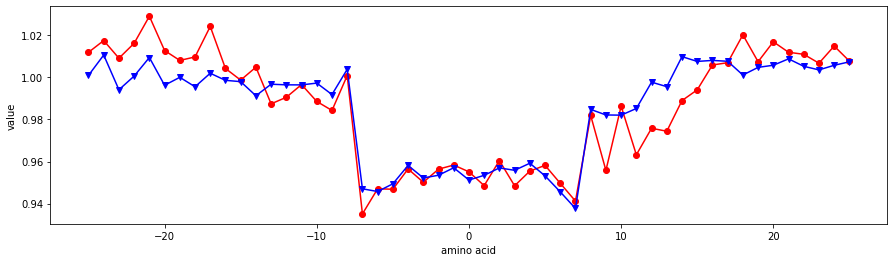

VINM940102


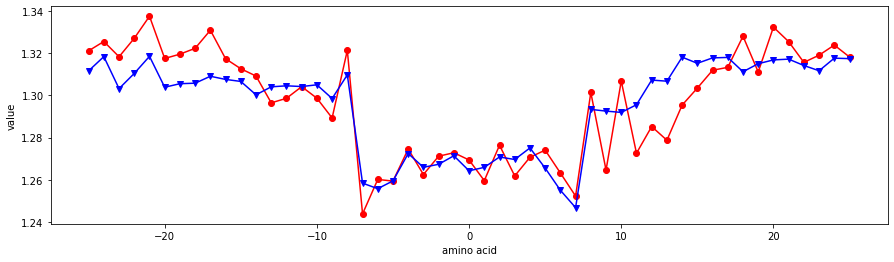

VINM940103


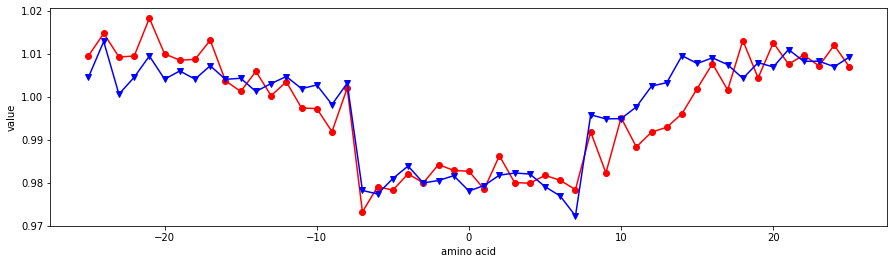

VINM940104


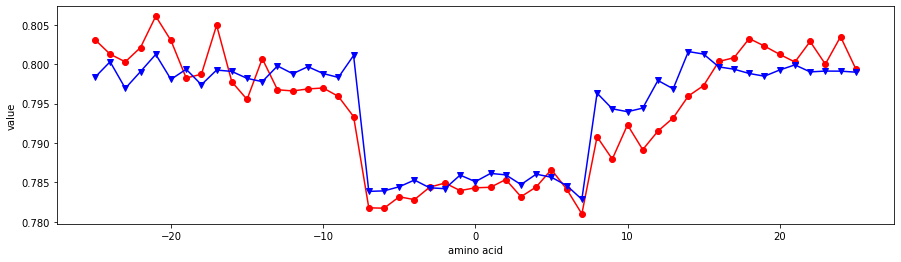

MUNV940101


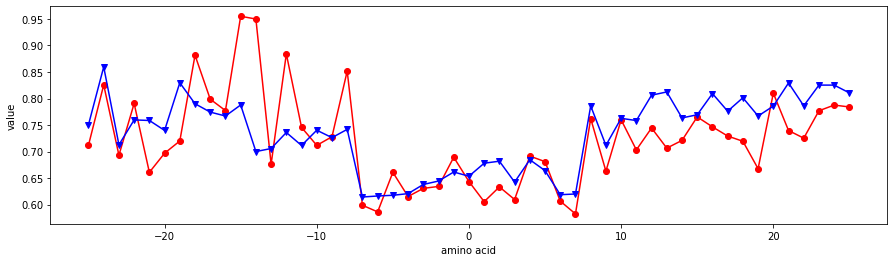

MUNV940102


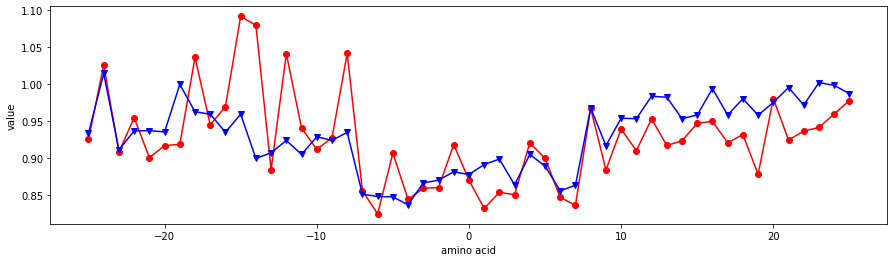

MUNV940103


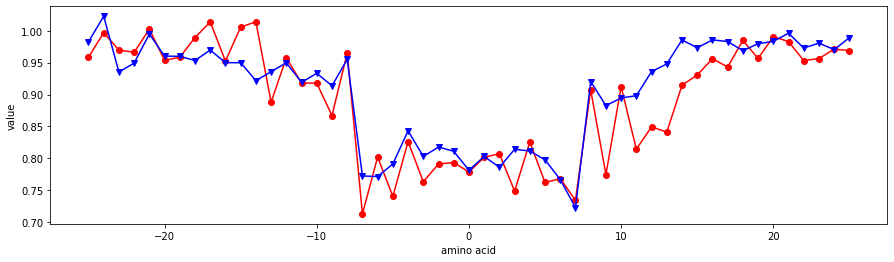

MUNV940104


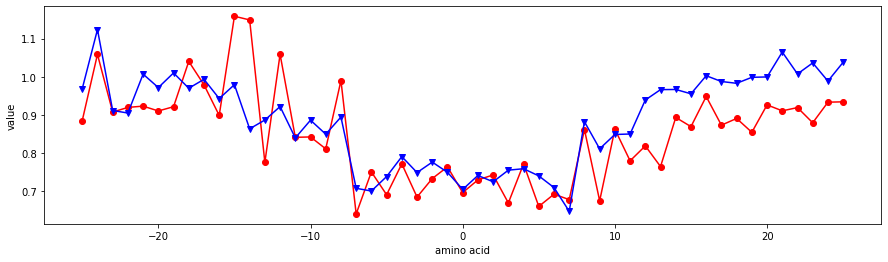

MUNV940105


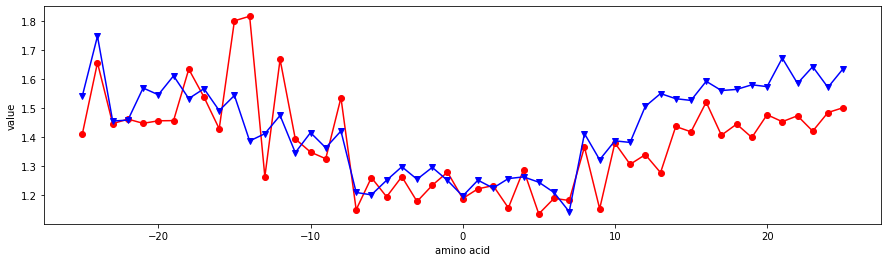

WIMW960101


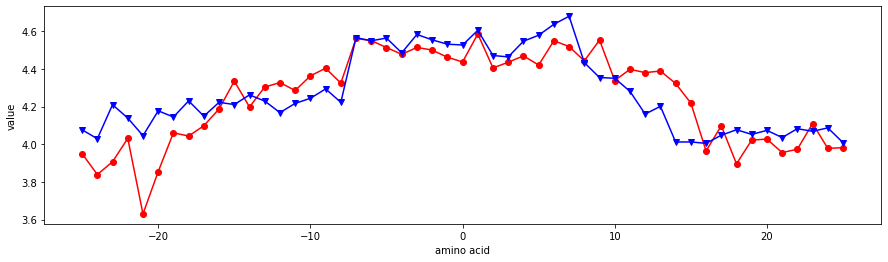

KIMC930101


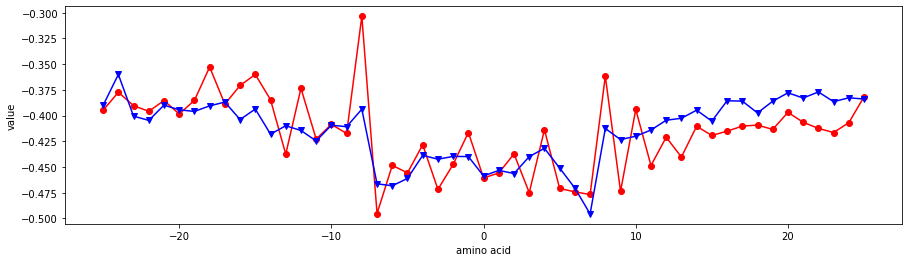

MONM990101


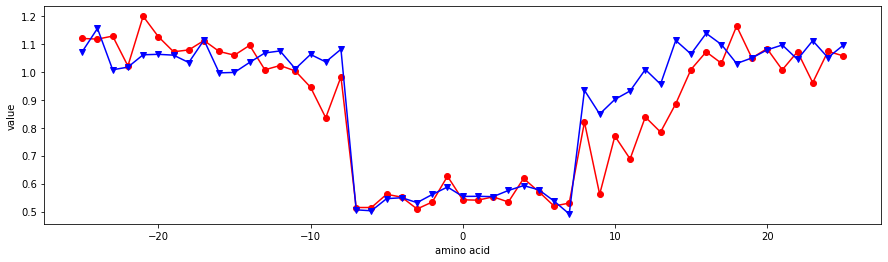

BLAM930101


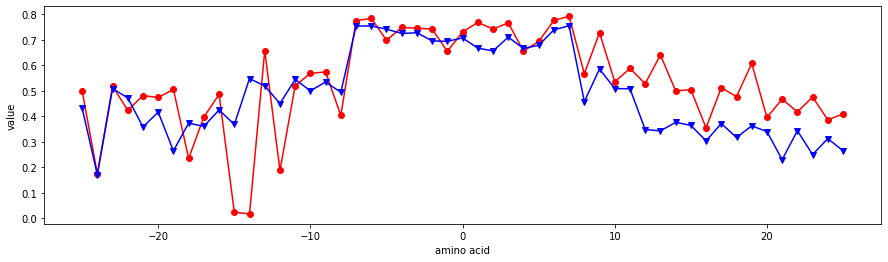

PARS000101


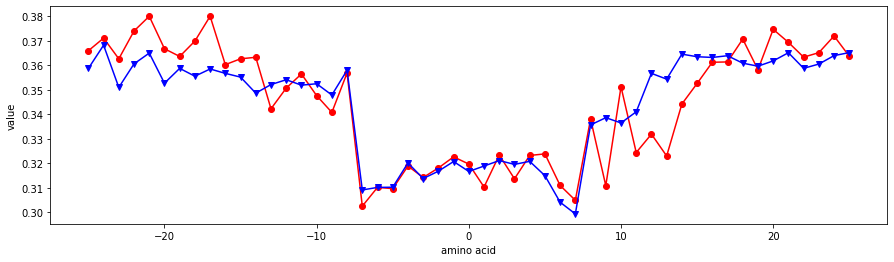

PARS000102


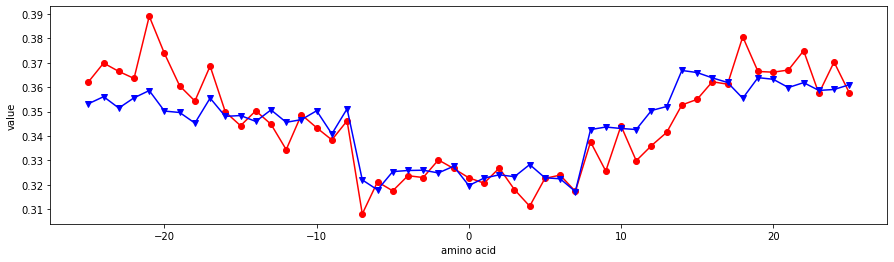

KUMS000101


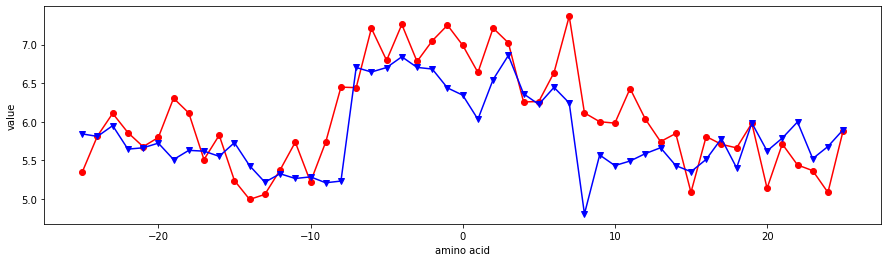

KUMS000102


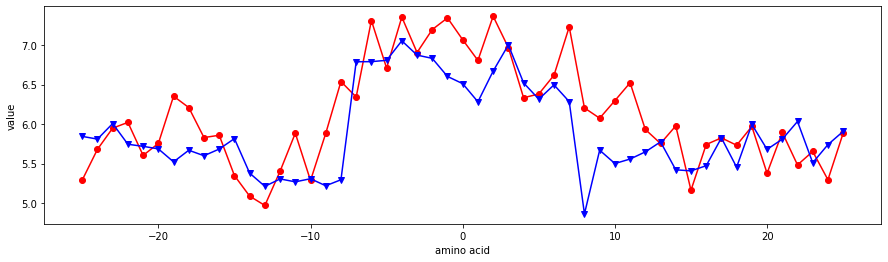

KUMS000103


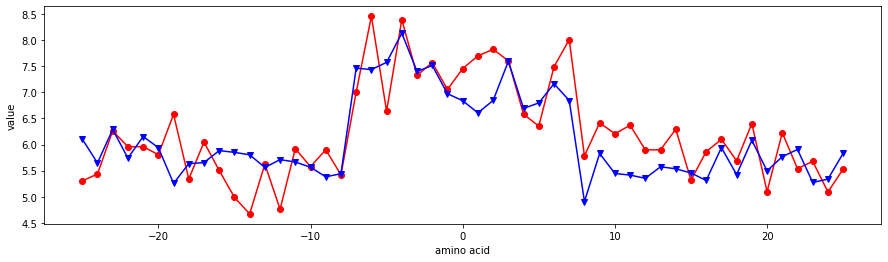

KUMS000104


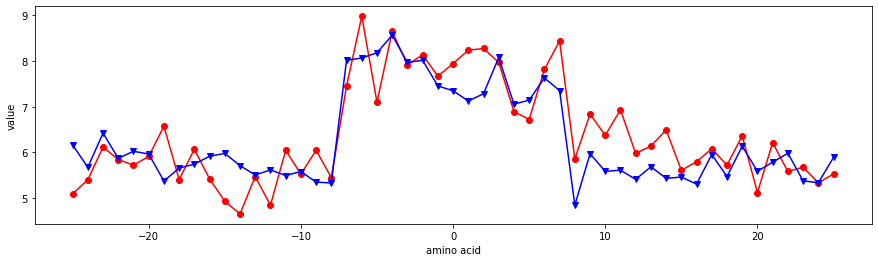

TAKK010101


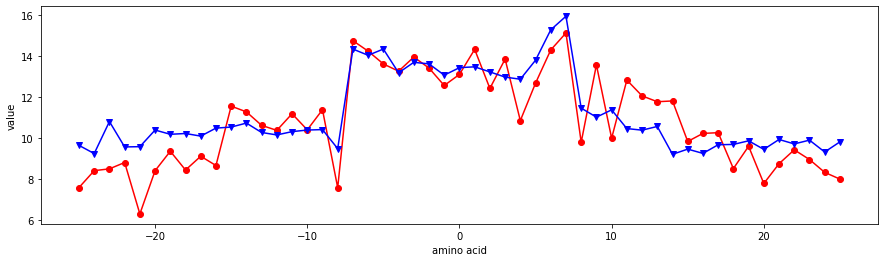

FODM020101


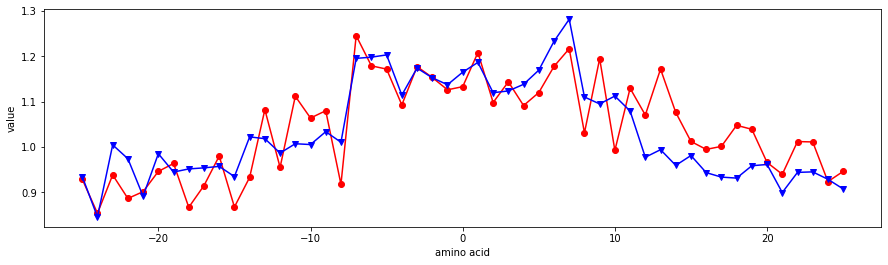

NADH010101


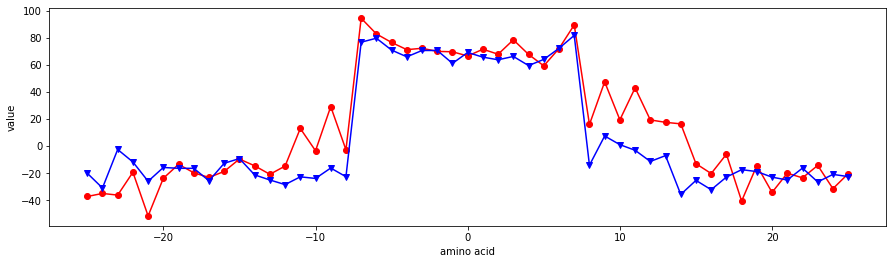

NADH010102


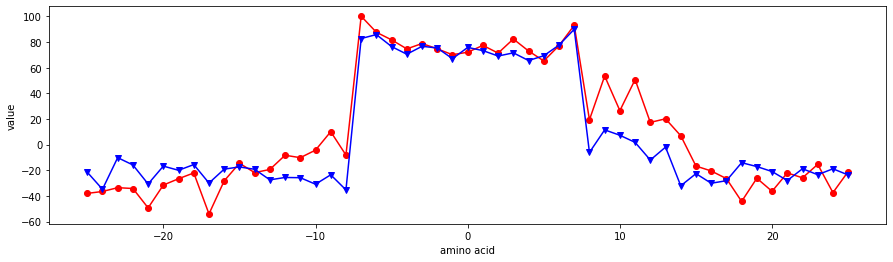

NADH010103


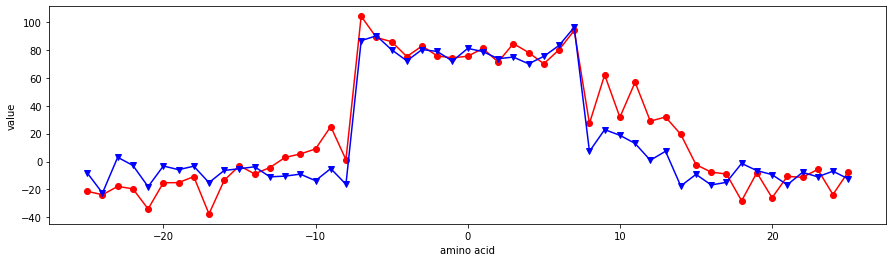

NADH010104


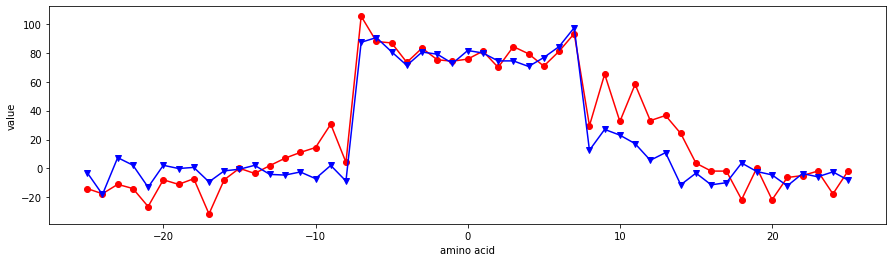

NADH010105


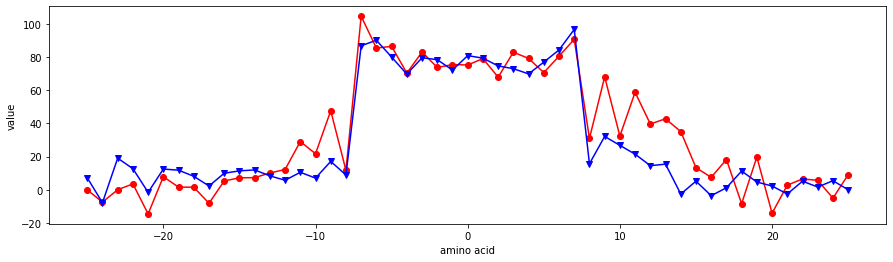

NADH010106


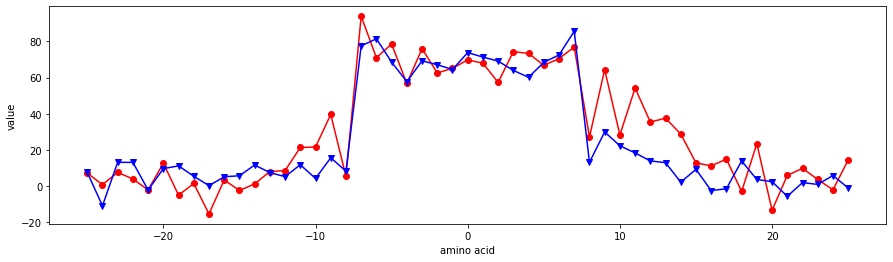

NADH010107


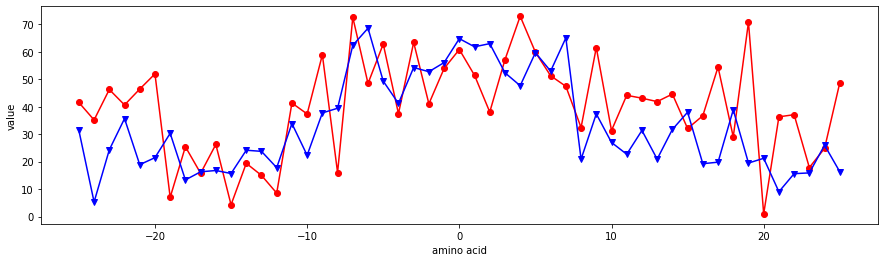

MONM990201


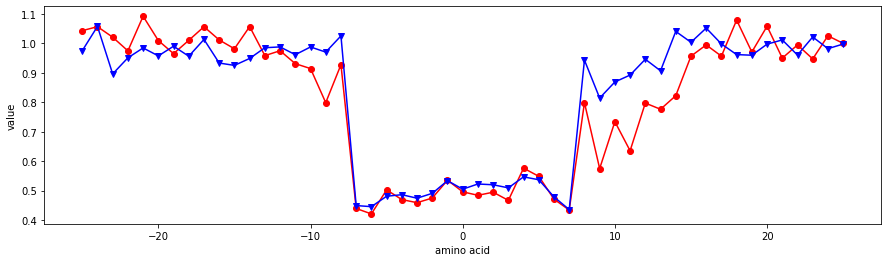

KOEP990101


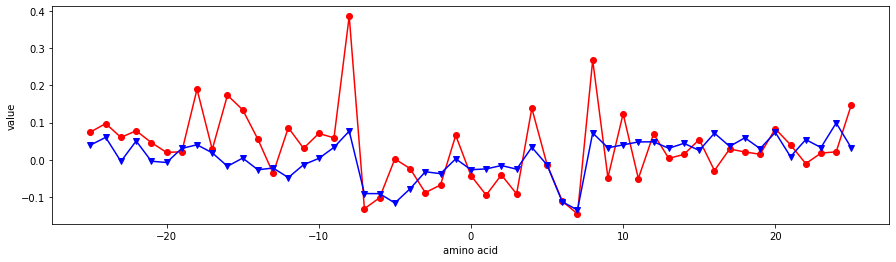

KOEP990102


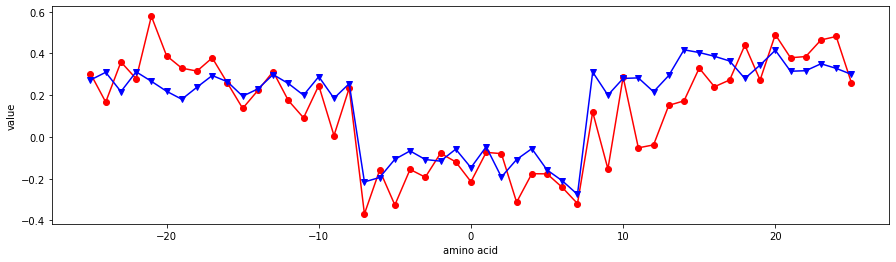

CEDJ970101


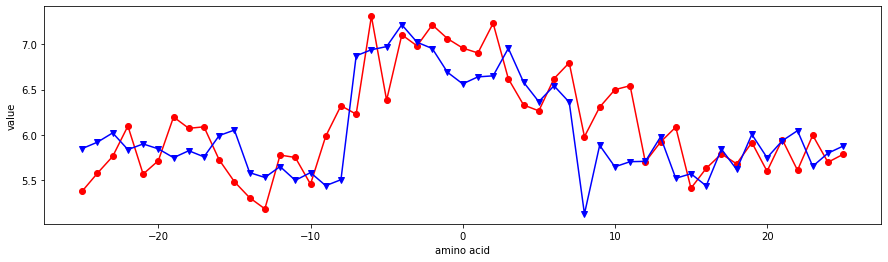

CEDJ970102


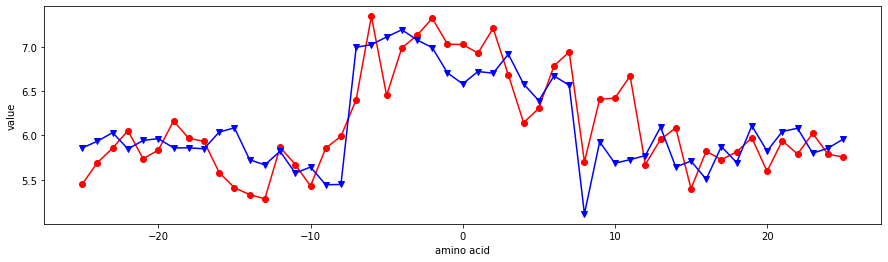

CEDJ970103


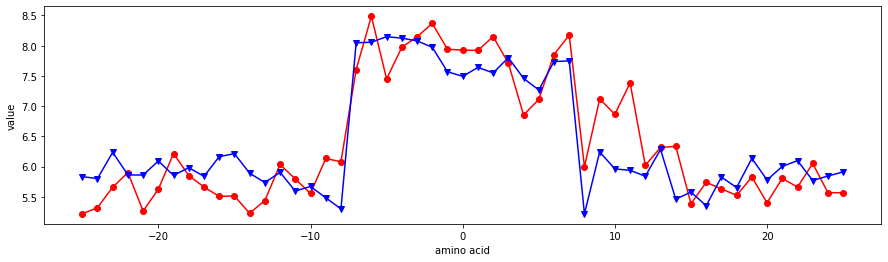

CEDJ970104


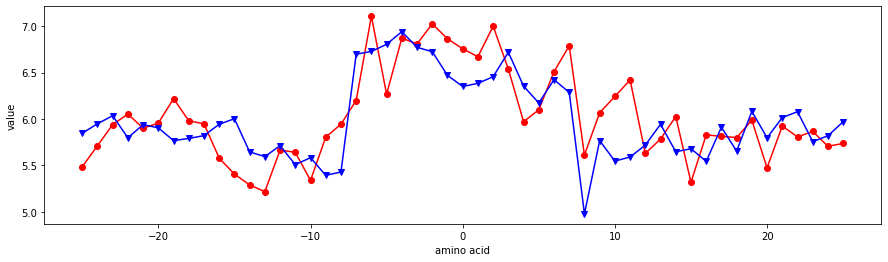

CEDJ970105


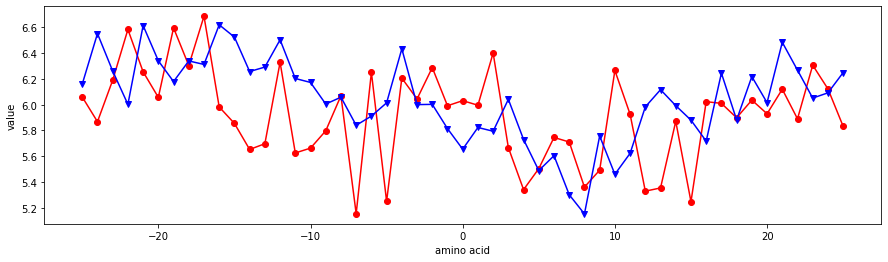

FUKS010101


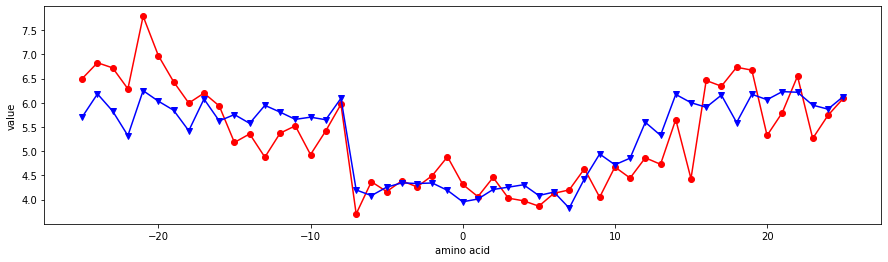

FUKS010102


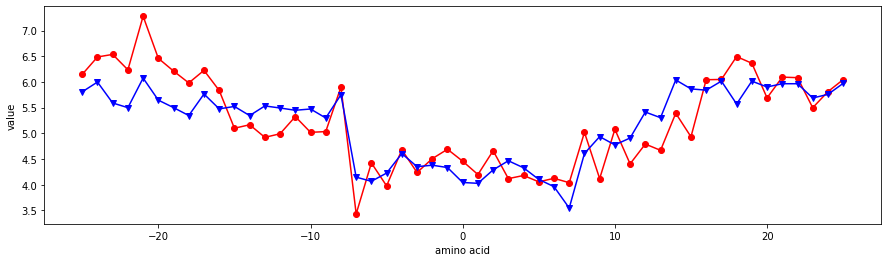

FUKS010103


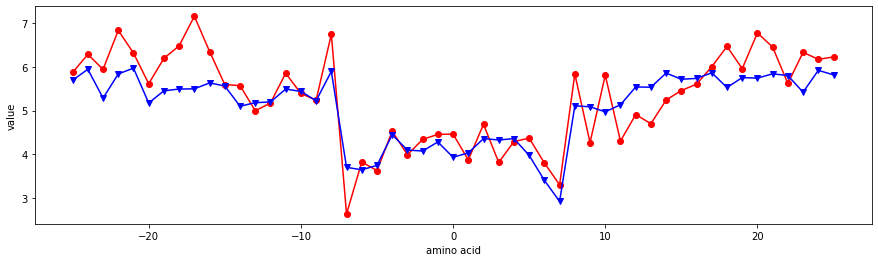

FUKS010104


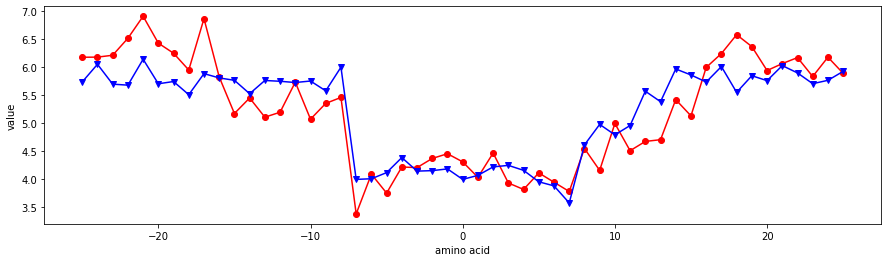

FUKS010105


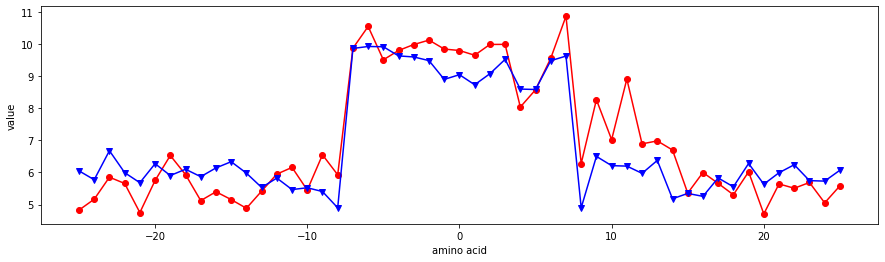

FUKS010106


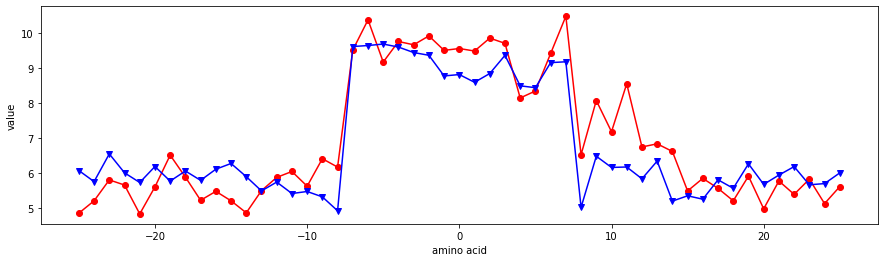

FUKS010107


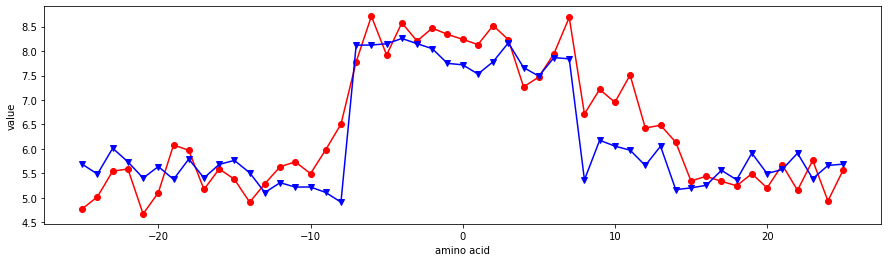

FUKS010108


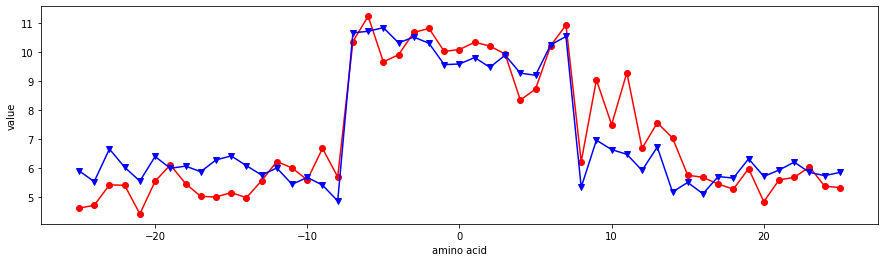

FUKS010109


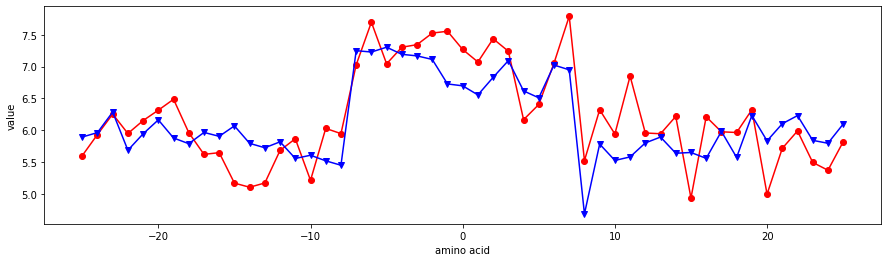

FUKS010110


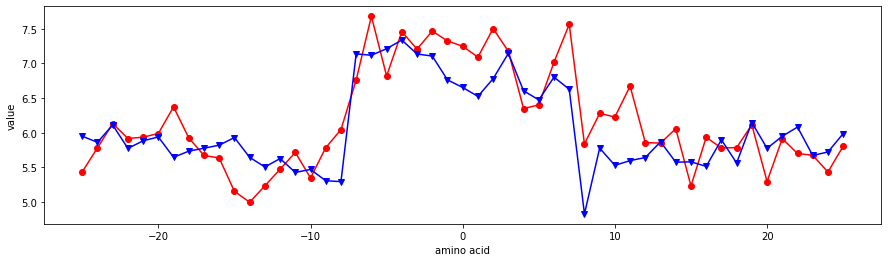

FUKS010111


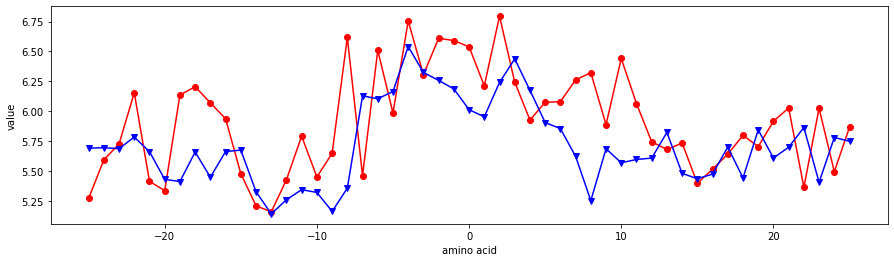

FUKS010112


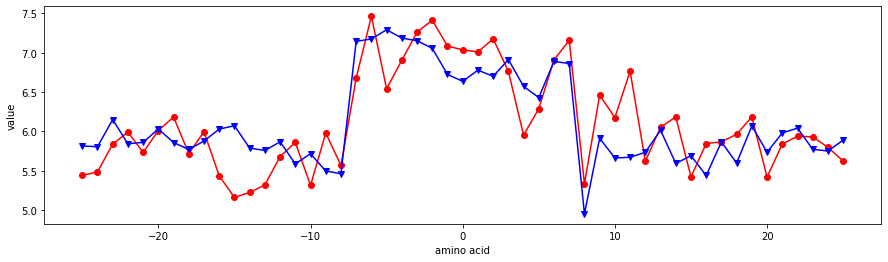

MITS020101


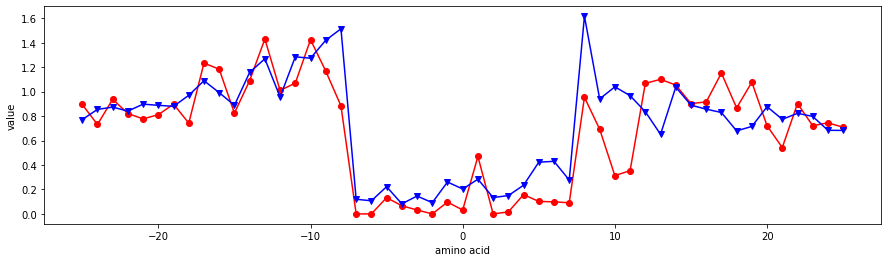

TSAJ990101


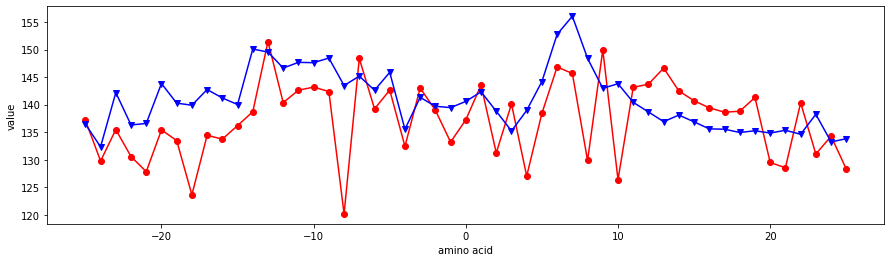

TSAJ990102


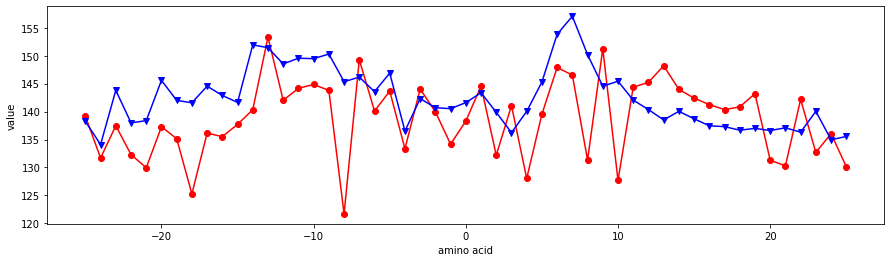

COSI940101


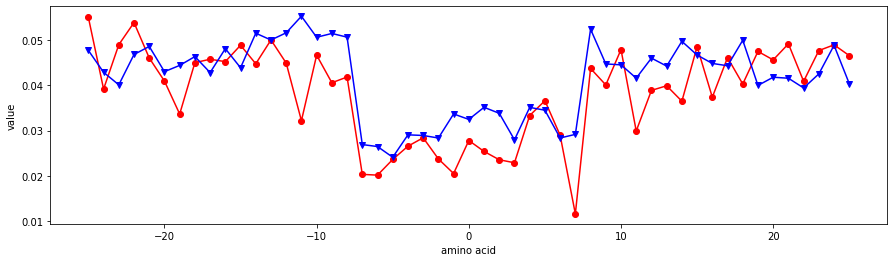

PONP930101


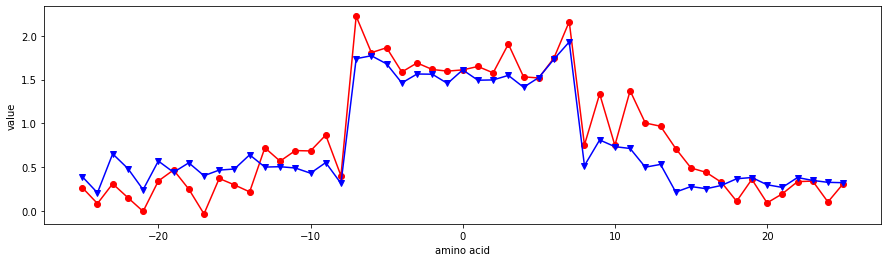

WILM950101


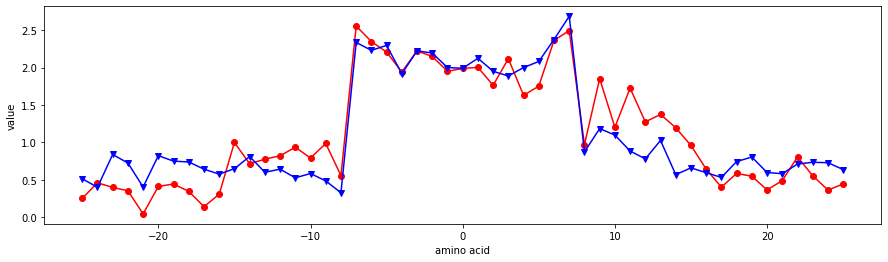

WILM950102


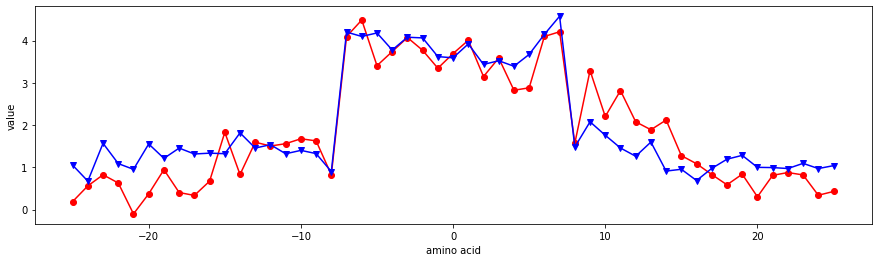

WILM950103


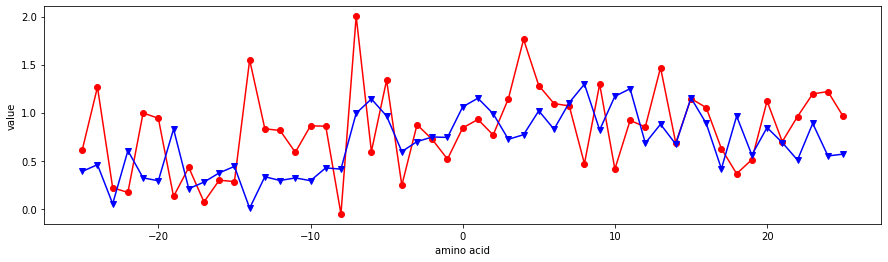

WILM950104


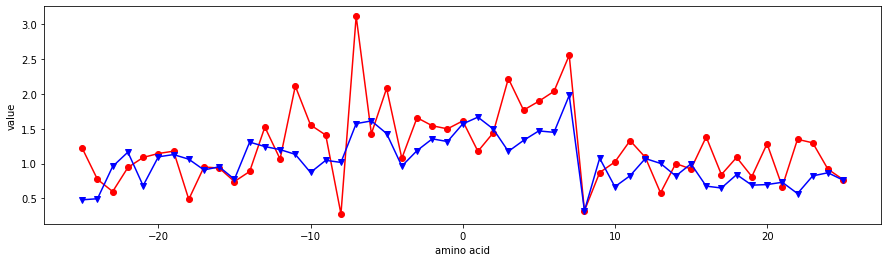

KUHL950101


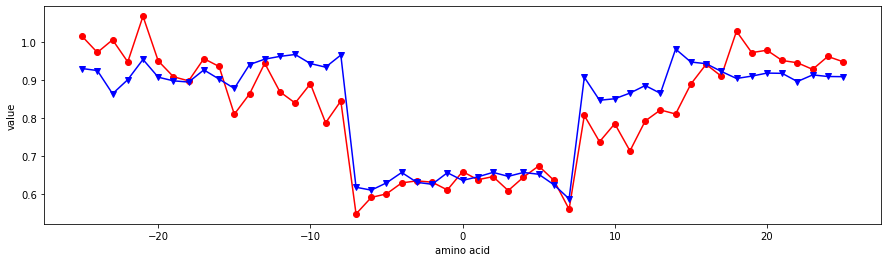

GUOD860101


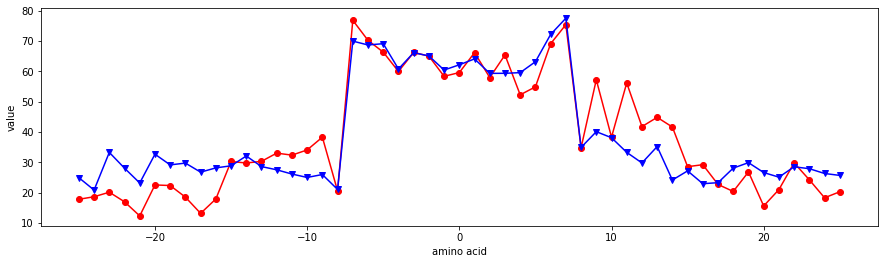

JURD980101


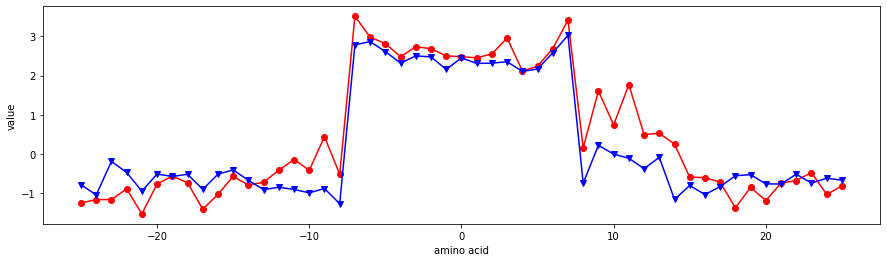

BASU050101


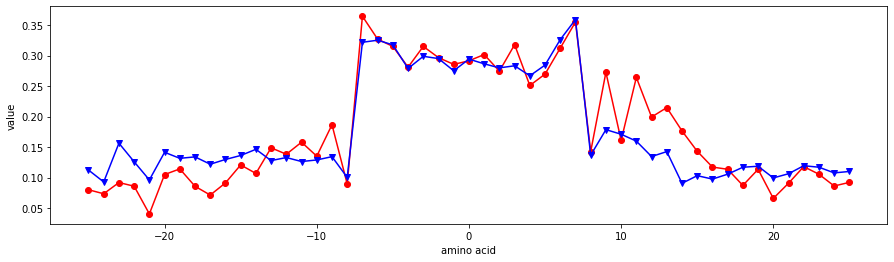

BASU050102


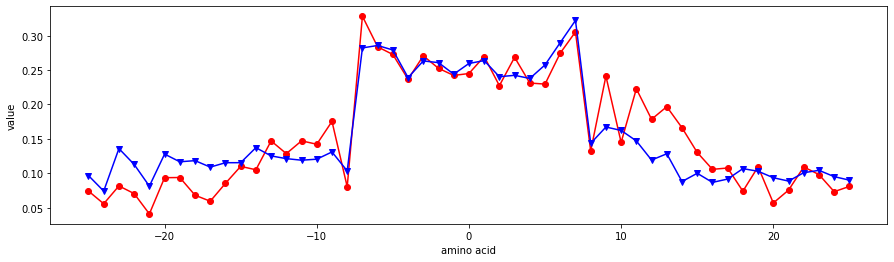

BASU050103


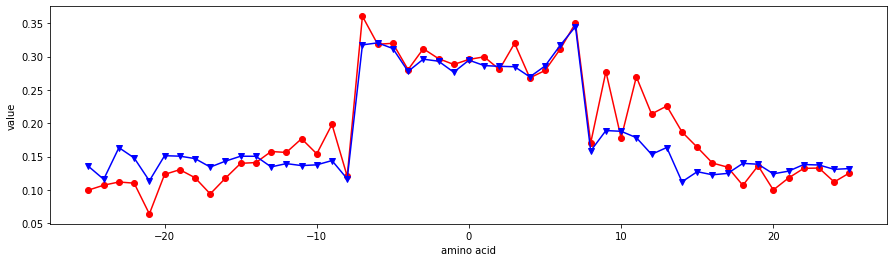

SUYM030101


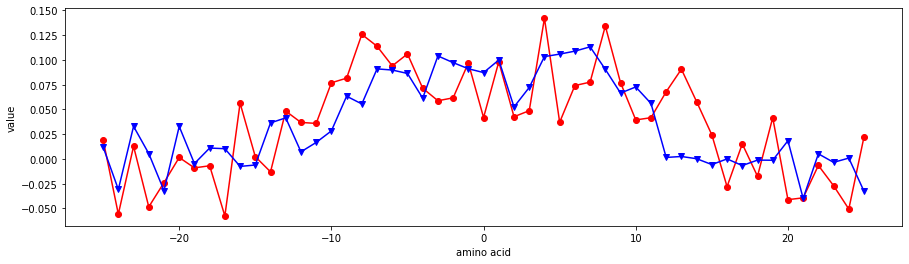

PUNT030101


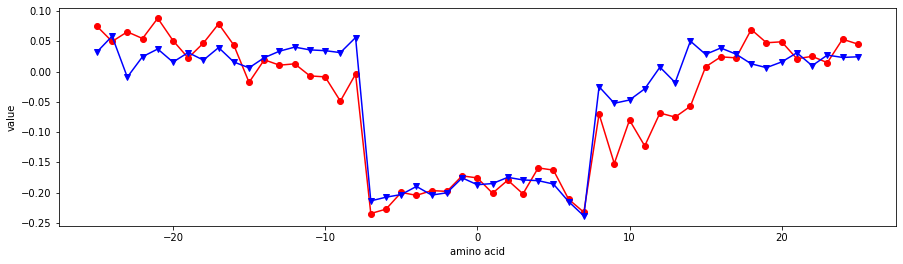

PUNT030102


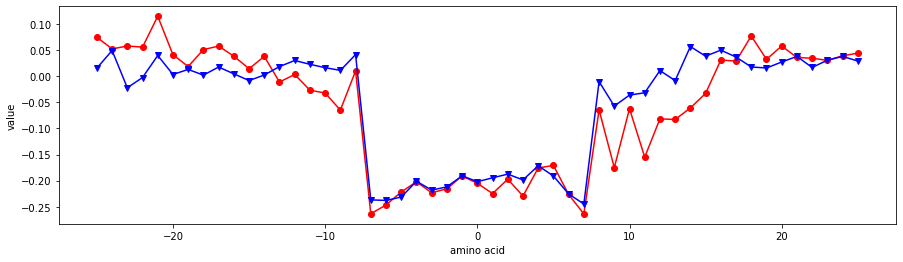

GEOR030101


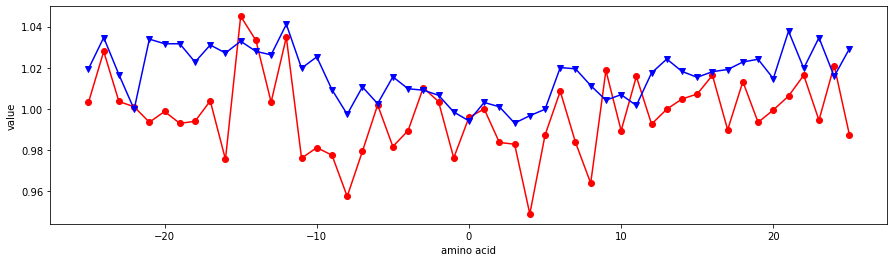

GEOR030102


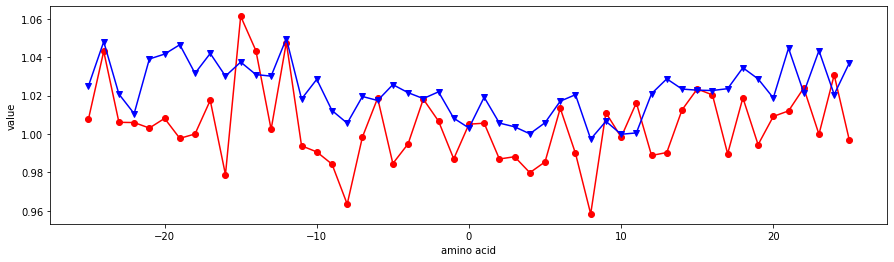

GEOR030103


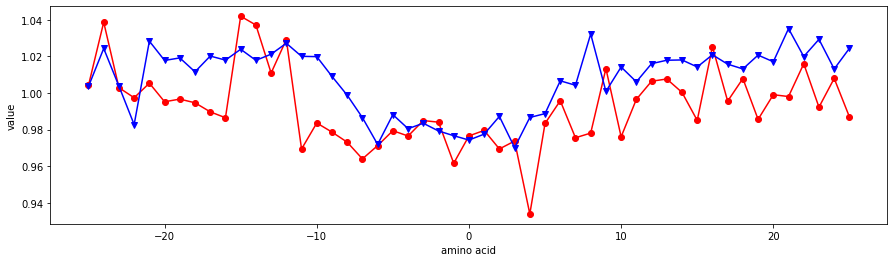

GEOR030104


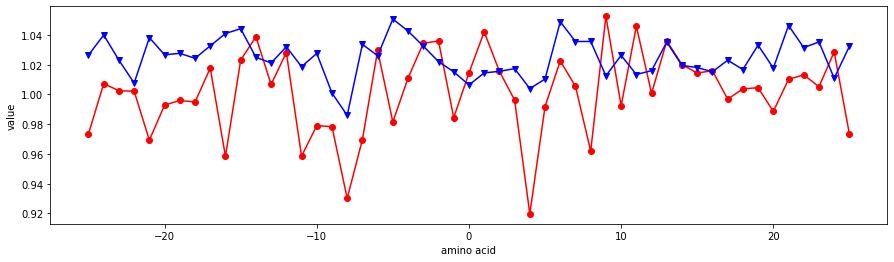

GEOR030105


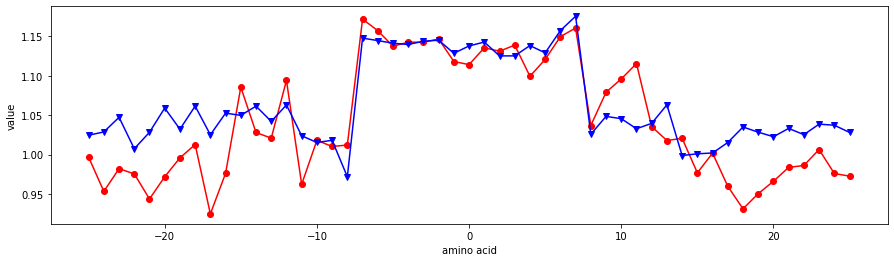

GEOR030106


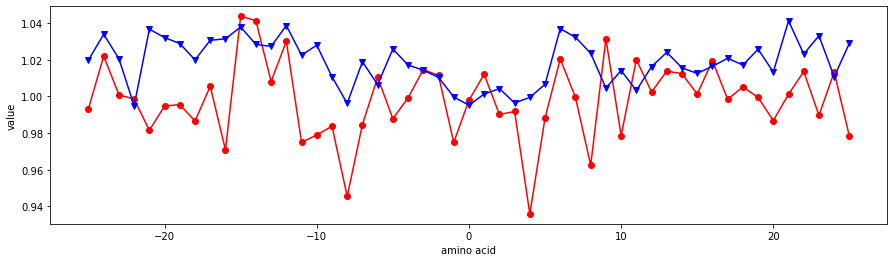

GEOR030107


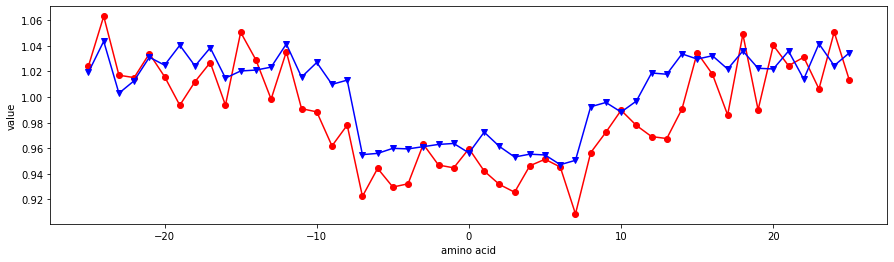

GEOR030108


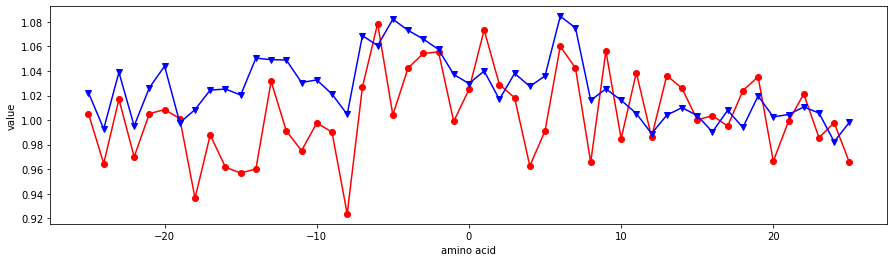

GEOR030109


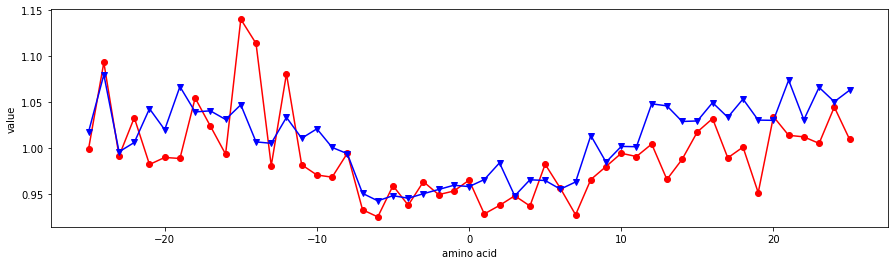

ZHOH040101


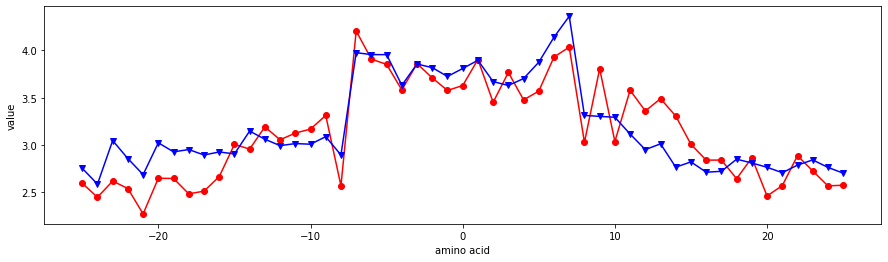

ZHOH040102


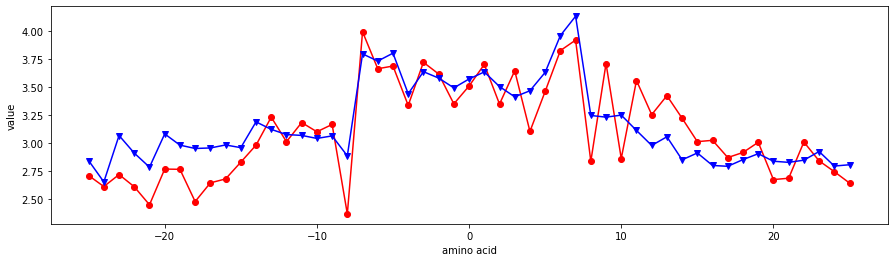

ZHOH040103


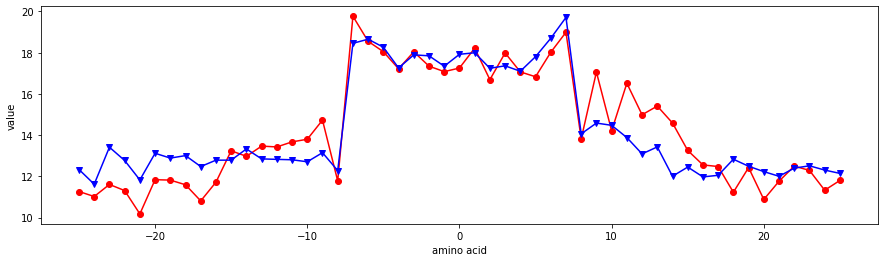

BAEK050101


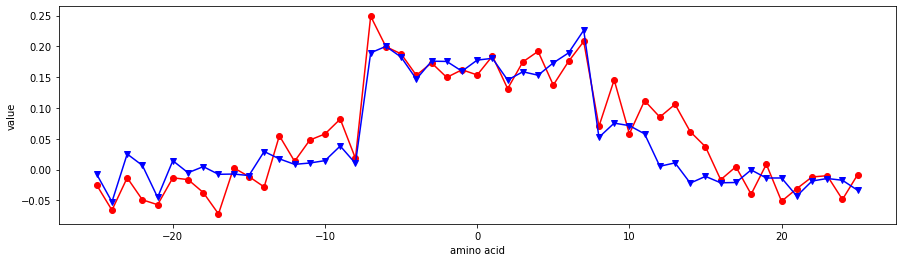

HARY940101


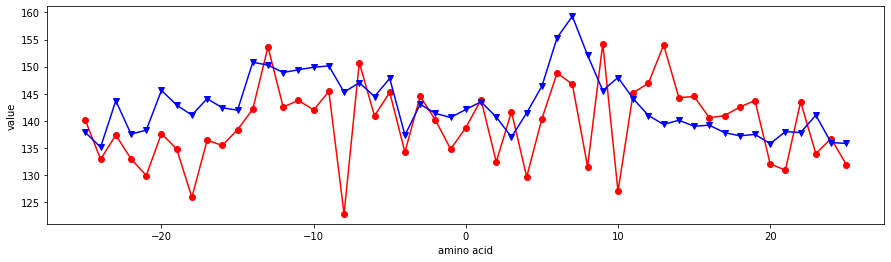

PONJ960101


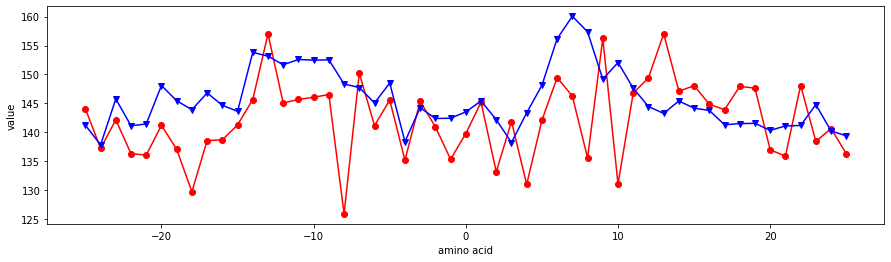

DIGM050101


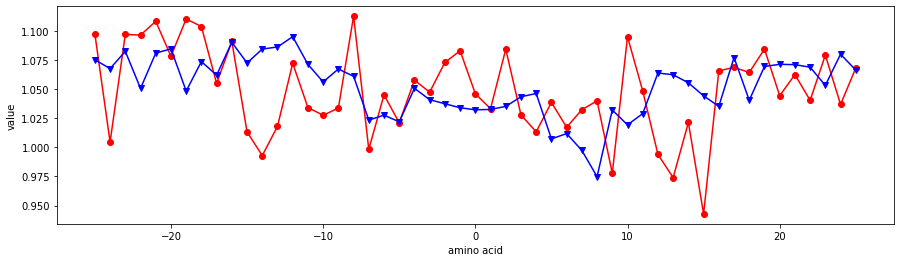

WOLR790101


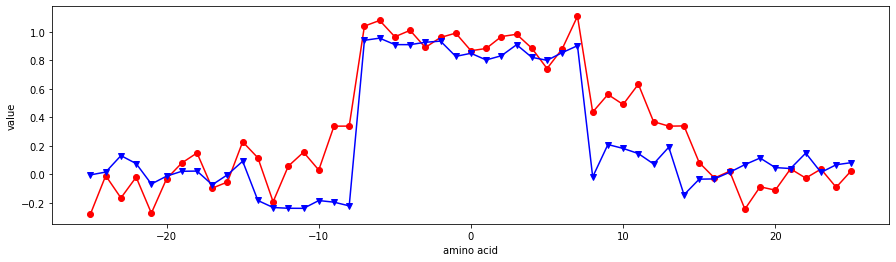

OLSK800101


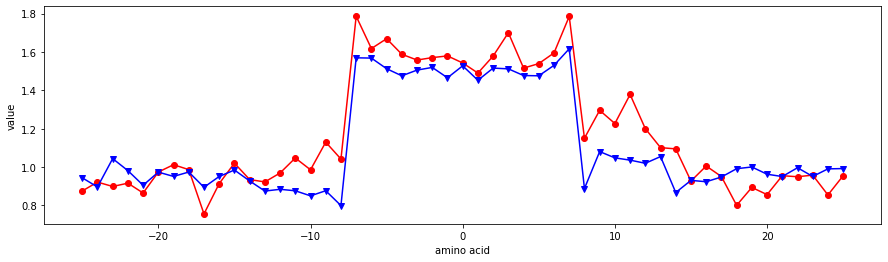

KIDA850101


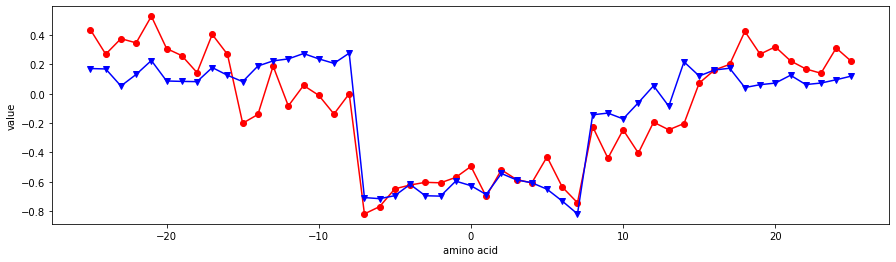

GUYH850102


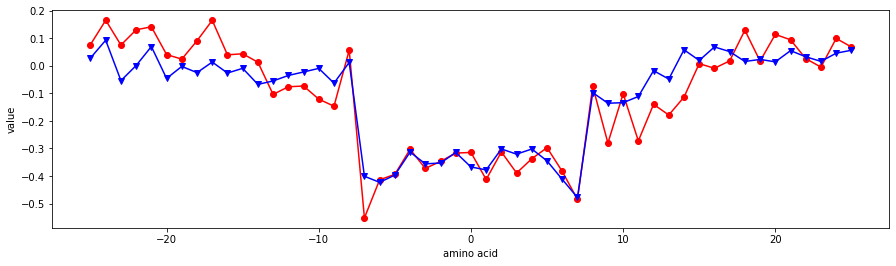

GUYH850104


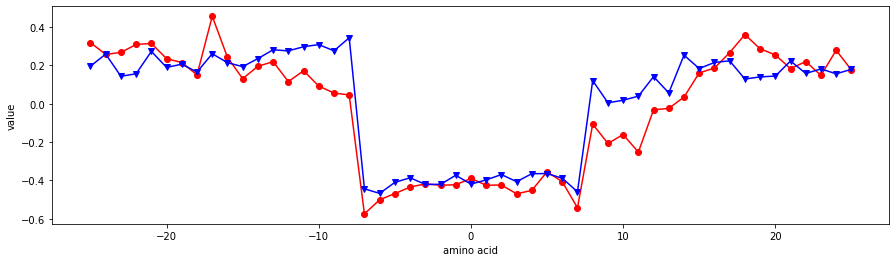

GUYH850105


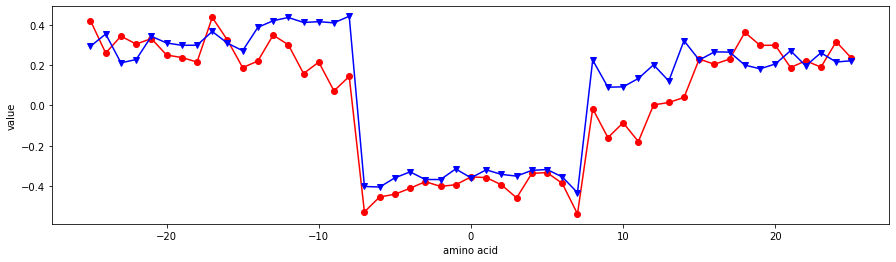

JACR890101


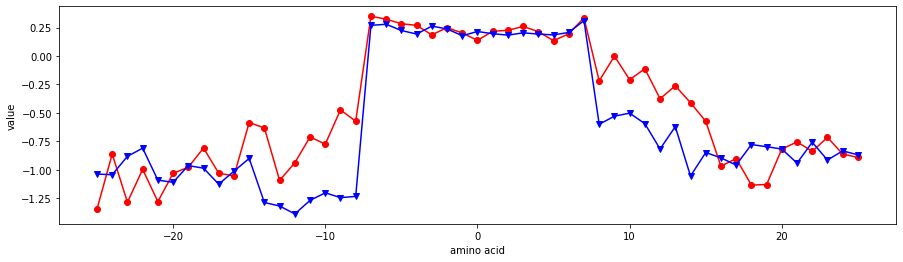

COWR900101


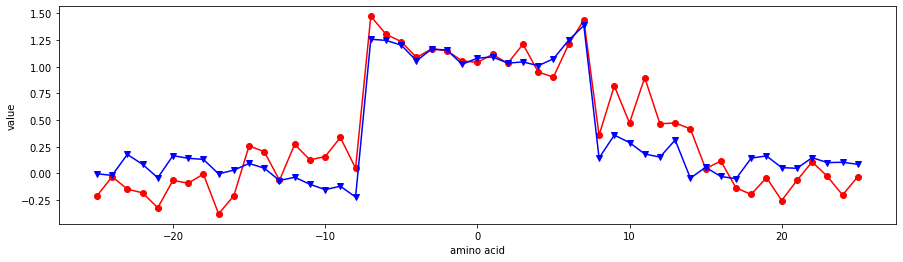

BLAS910101


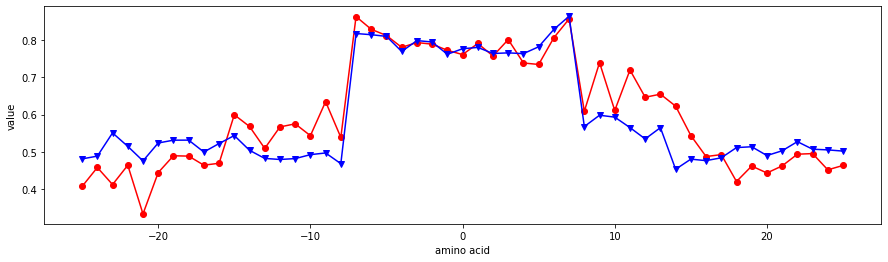

CASG920101


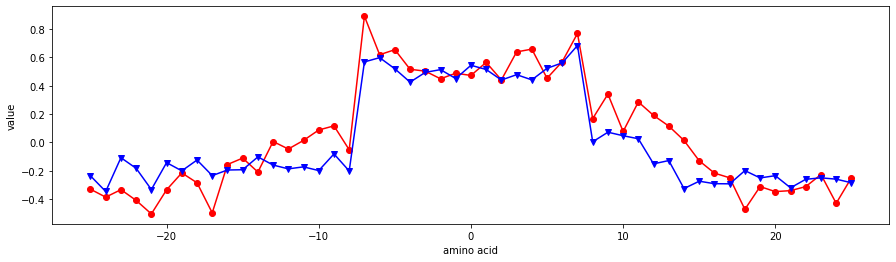

CORJ870101


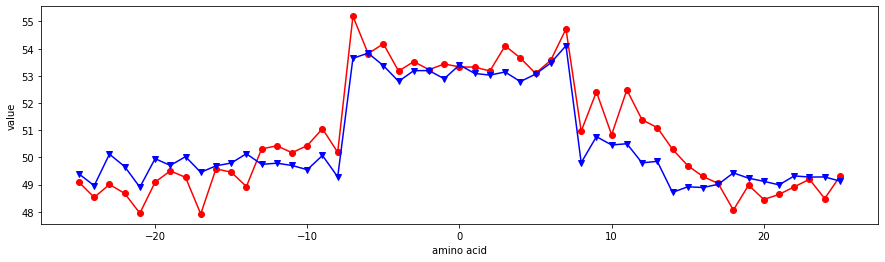

CORJ870102


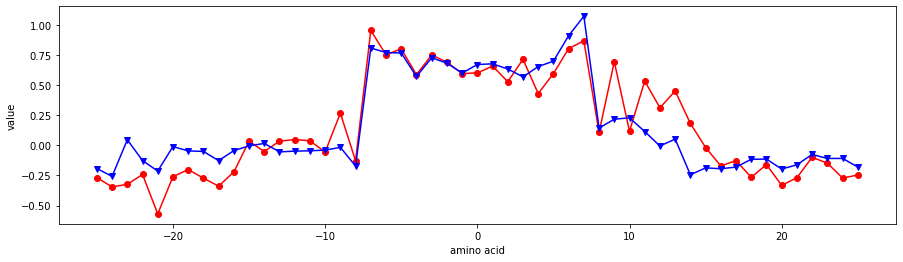

CORJ870103


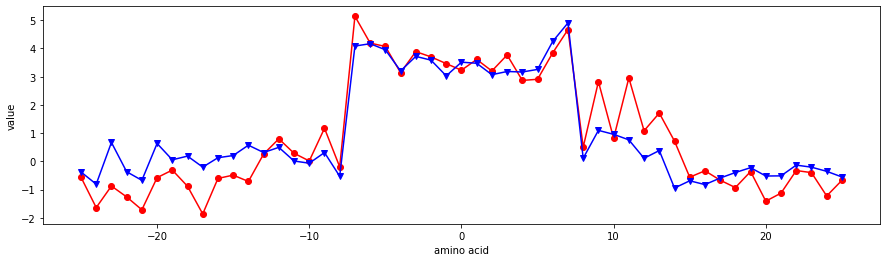

CORJ870104


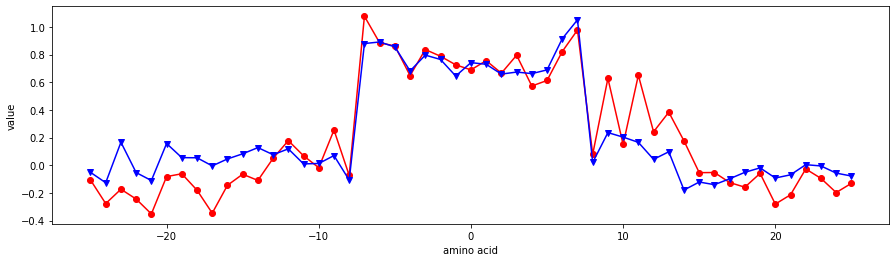

CORJ870105


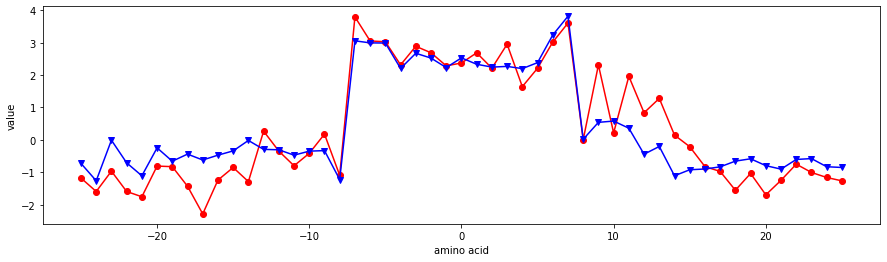

CORJ870106


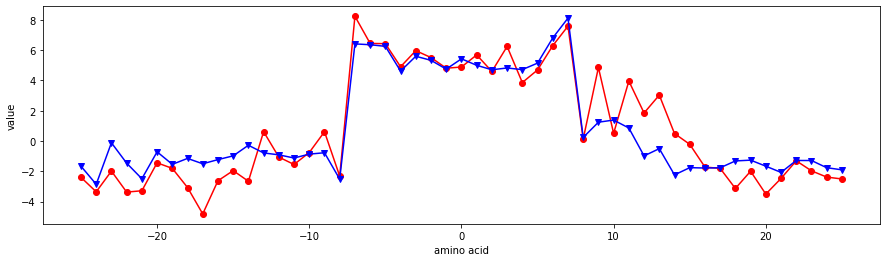

CORJ870107


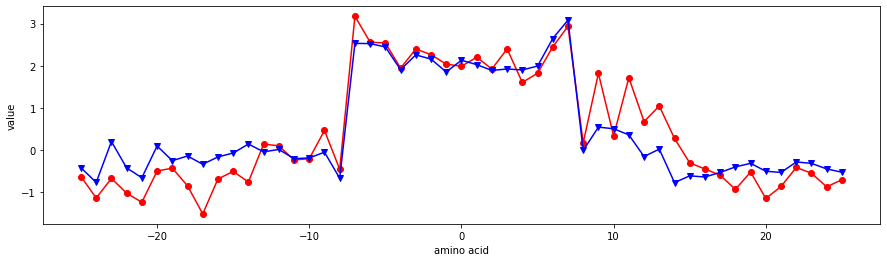

CORJ870108


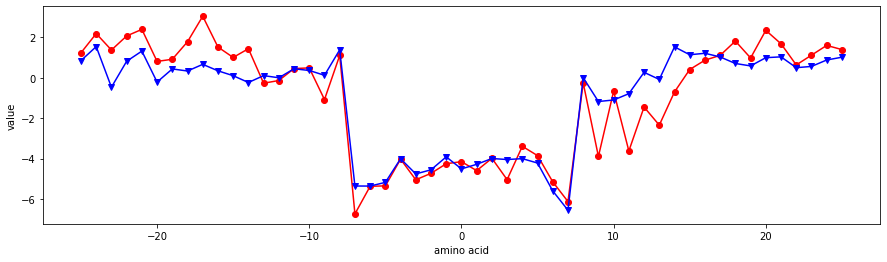

MIYS990101


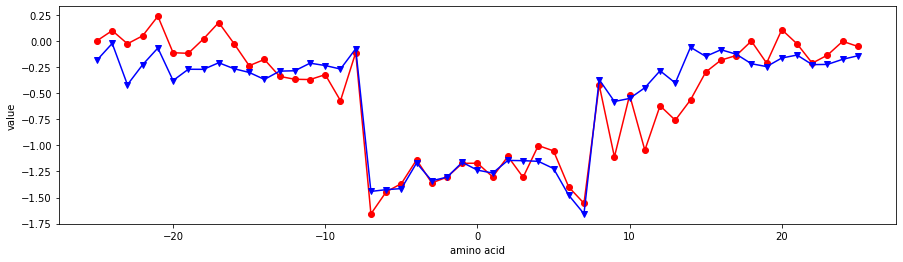

MIYS990102


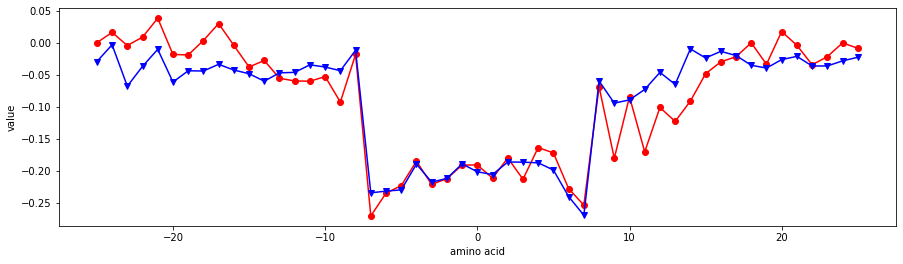

MIYS990103


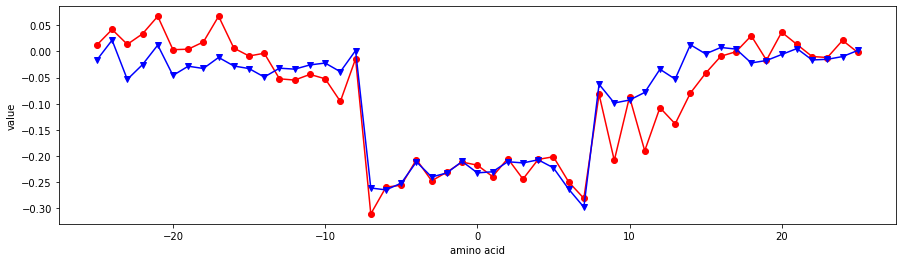

MIYS990104


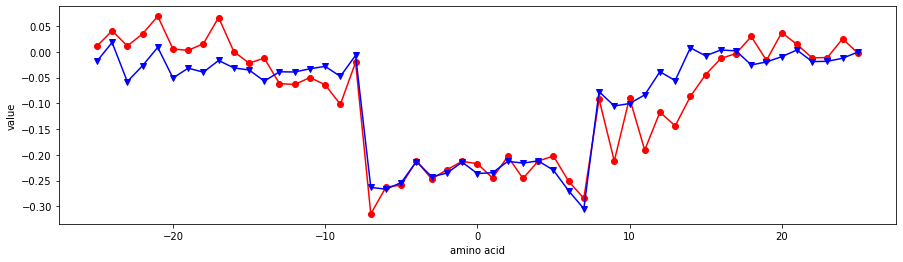

MIYS990105


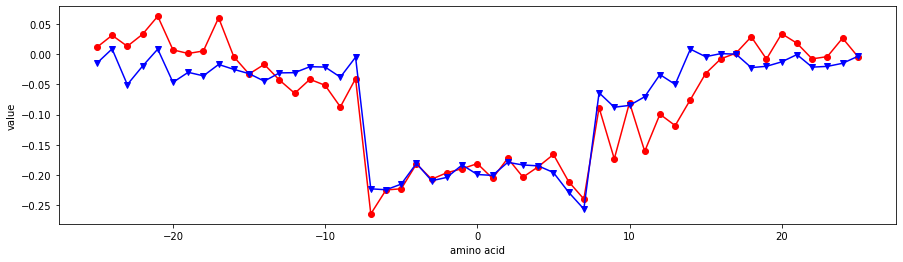

ENGD860101


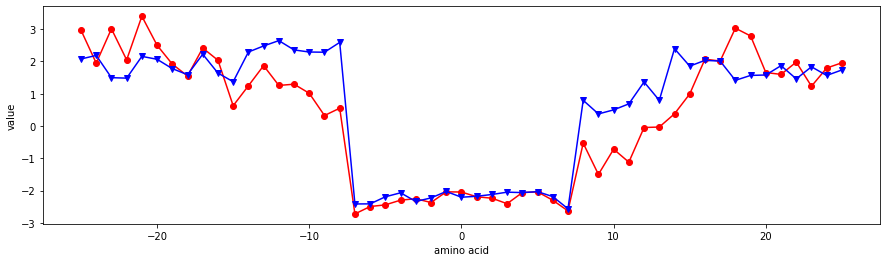

FASG890101


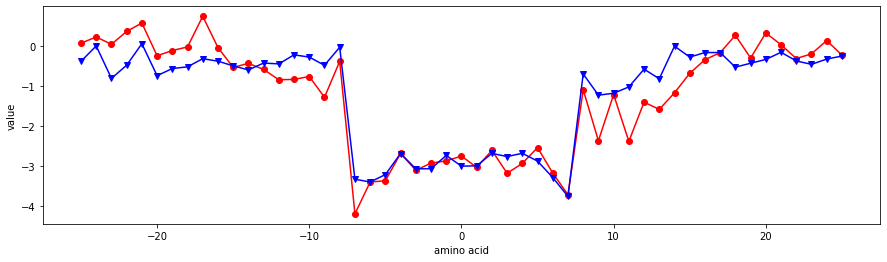

KARS160101


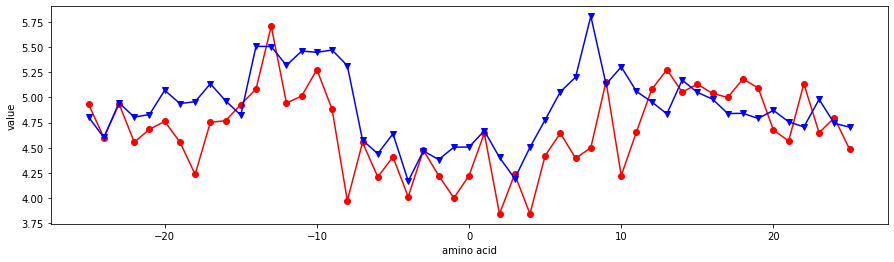

KARS160102


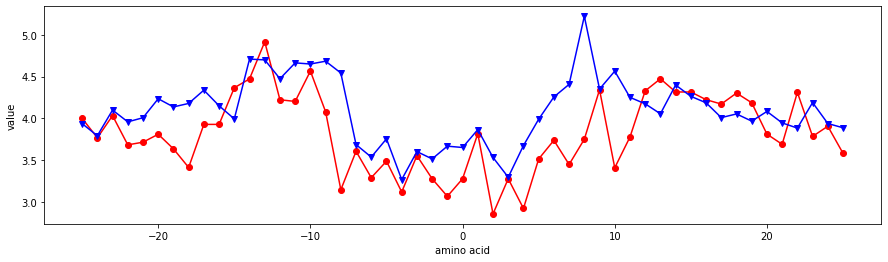

KARS160103


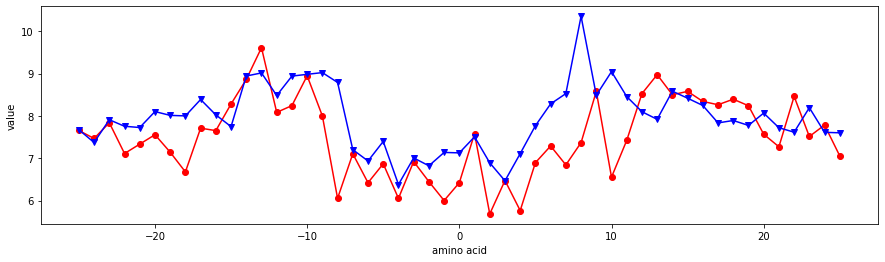

KARS160104


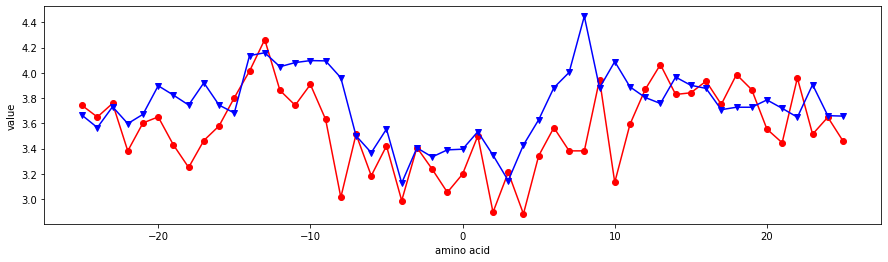

KARS160105


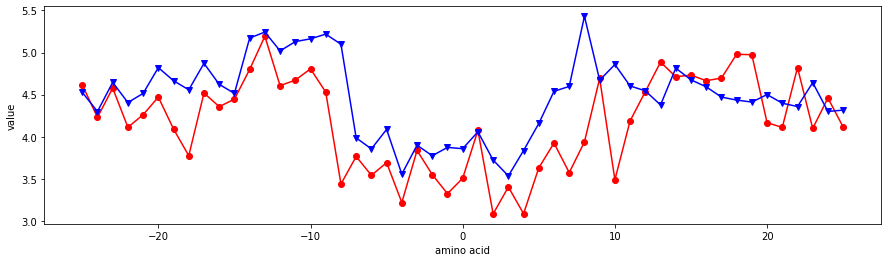

KARS160106


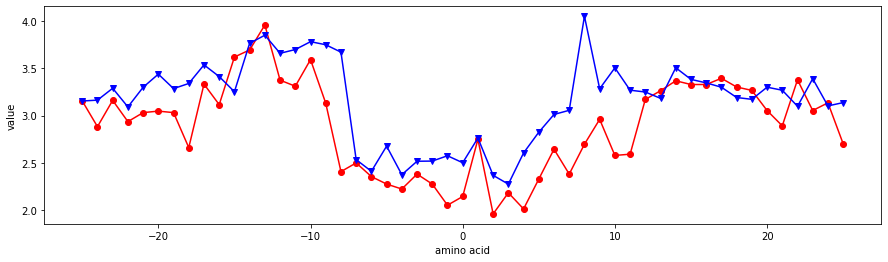

KARS160107


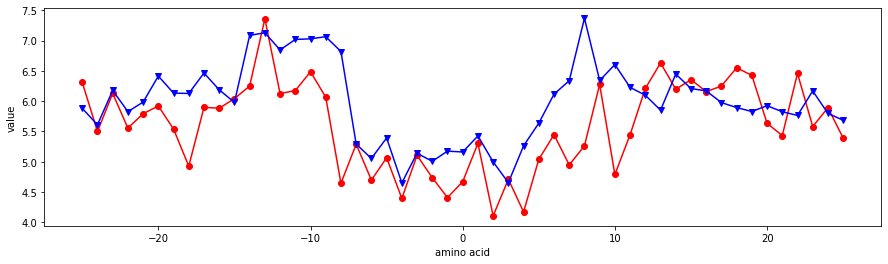

KARS160108


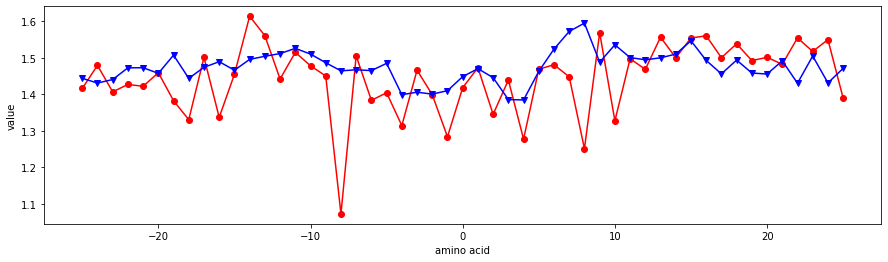

KARS160109


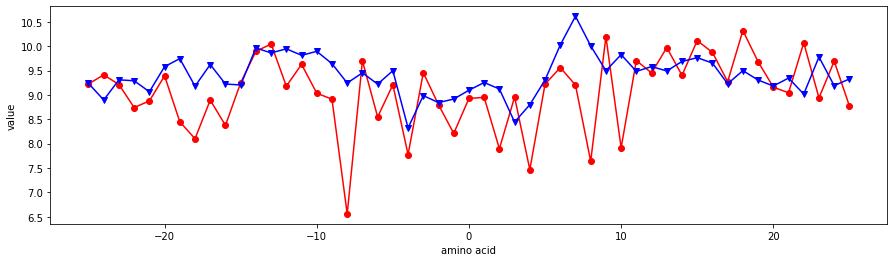

KARS160110


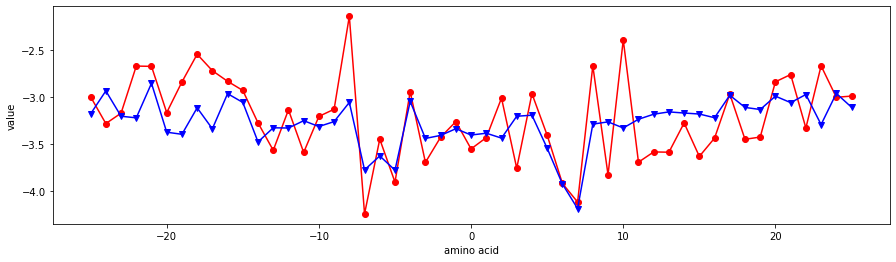

KARS160111


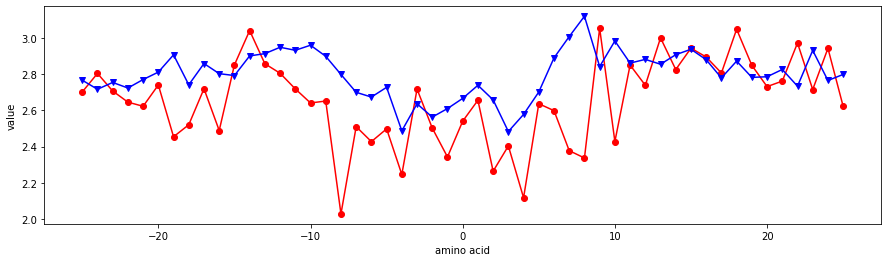

KARS160112


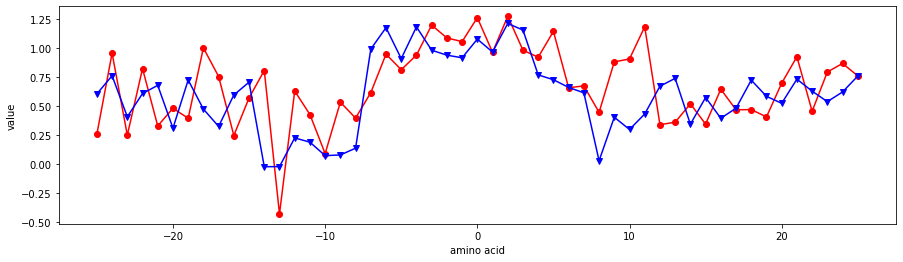

KARS160113


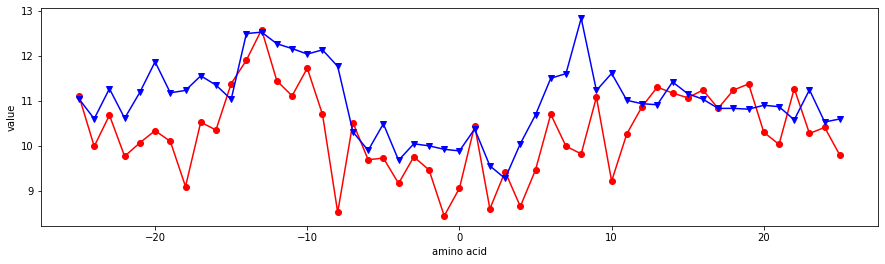

KARS160114


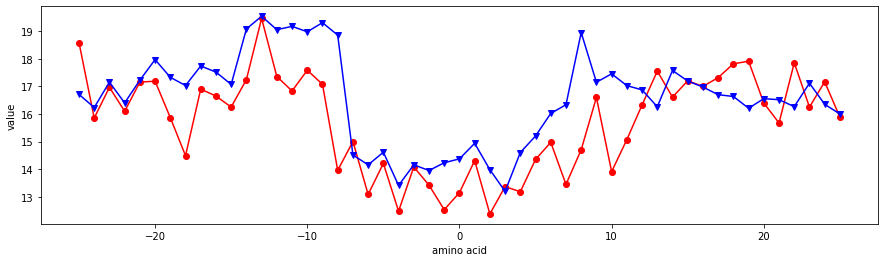

KARS160115


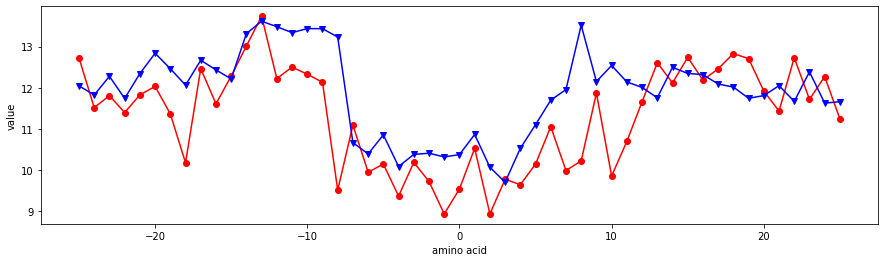

KARS160116


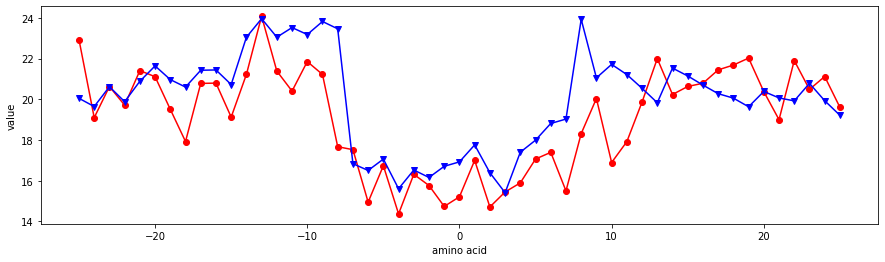

KARS160117


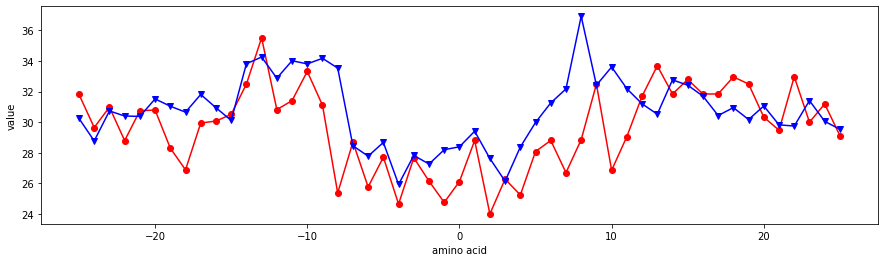

KARS160118


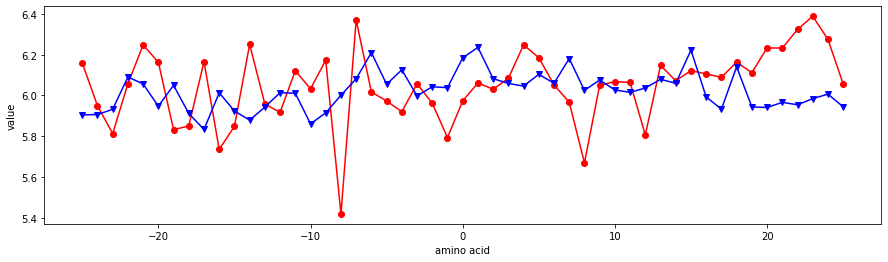

KARS160119


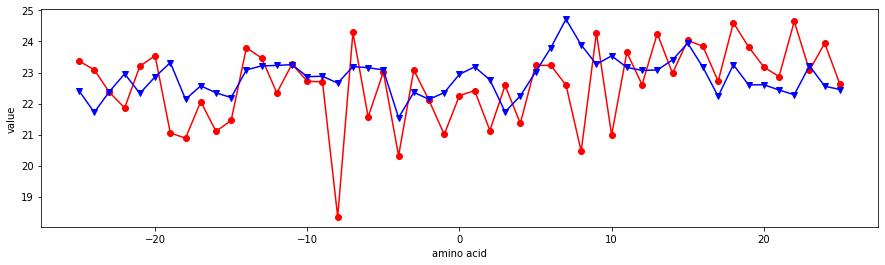

KARS160120


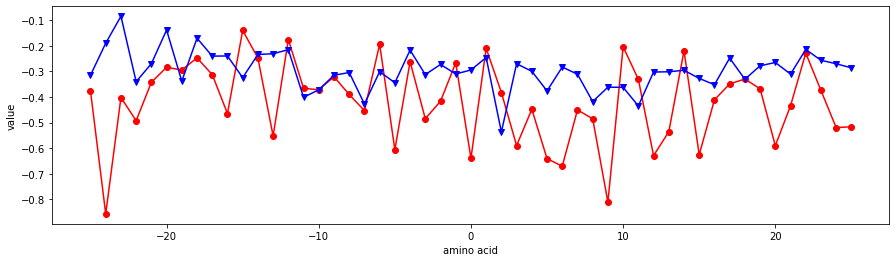

KARS160121


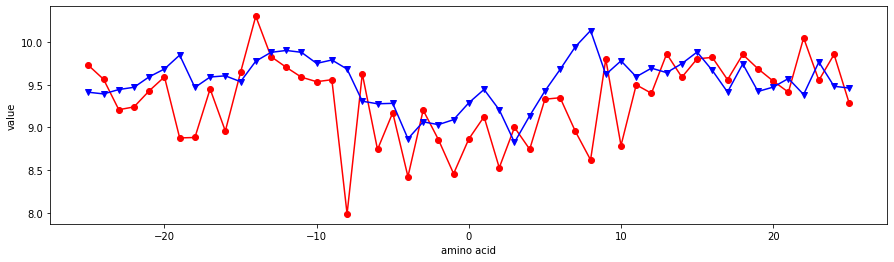

KARS160122


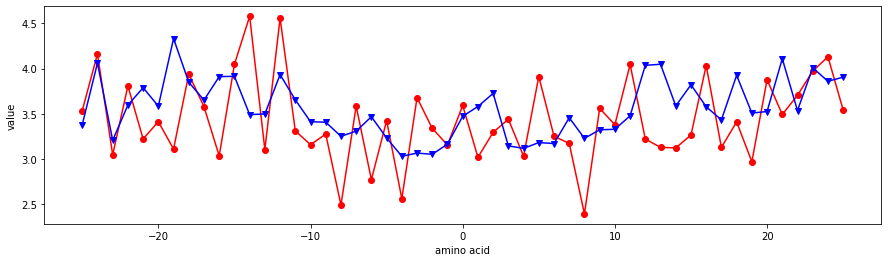

In [8]:
import matplotlib.pyplot as plt


for index_pm, row_pm in pmave.iterrows():
    for index_npm, row_npm in npmave.iterrows():
        if index_pm==index_npm:
            print (index_pm)
            plt.figure(figsize=(15,4))
            plt.plot(columns , row_pm  , color = 'red'  , marker = 'o' )
            plt.plot(columns , row_npm , color = 'blue' , marker = 'v' )
            plt.xlabel('amino acid')                    
            plt.ylabel('value')
            plt.show()
             